In [ ]:
!pip install tensorflow[and-cuda]

In [1]:
#setup

import cv2
import os
import sys
from glob import glob
import itertools

import matplotlib.pylab as plt
import numpy as np

import tensorflow as tf
import tensorflow_hub as hub

import random
import shutil

from GraphJigsaw.model_block_progressive import GJPN

In [20]:
print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)
print("GPU is", "available" if tf.config.list_physical_devices('GPU') else "NOT AVAILABLE")

print(tf.config.list_physical_devices())

BATCH_SIZE = 32
do_fine_tuning = False
dropout_rate = 0.8
model_name = "efficientnet_b7"


TF version: 2.8.4
Hub version: 0.15.0
GPU is available
[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [21]:

model_handle_map = {
    "inception_v3": "https://tfhub.dev/google/imagenet/inception_v3/feature_vector/5",
    "inception_resnet_v2": "https://tfhub.dev/google/imagenet/inception_resnet_v2/feature_vector/5",
    "mobilenet_v2_100_96": "https://tfhub.dev/google/imagenet/mobilenet_v2_100_96/feature_vector/5",
    "efficientnet_b7": "https://tfhub.dev/tensorflow/efficientnet/b7/feature-vector/1",
    "vit_b8_fe": "https://tfhub.dev/sayakpaul/vit_b8_fe/1",
}

model_image_size_map = {
    "inception_v3": 96,
    "inception_resnet_v2": 96,
    "mobilenet_v2_100_96": 96,
    "efficientnet_b7": 96,
    "vit_b8_fe": 224
}

model_handle = model_handle_map.get(model_name)
pixels = model_image_size_map.get(model_name, 96)

print(f"Selected model {model_name} : {model_handle}")

IMAGE_SIZE = (pixels,pixels)
print(f"Input size {IMAGE_SIZE}")

BATCH_SIZE = 32

Selected model efficientnet_b7 : https://tfhub.dev/tensorflow/efficientnet/b7/feature-vector/1
Input size (96, 96)


In [22]:
data_dir = "Dataset/dataset"

print(f"data dir: {data_dir}")

data dir: Dataset/dataset


In [5]:
def split_and_move_data(source_dir, dest_dir, split_ratio=0.2, random_seed=42):
    # 소스 디렉터리에서 파일 목록 가져오기
    folder_list = os.listdir(source_dir)
    for folder in folder_list:
        file_list = os.listdir(os.path.join(source_dir, folder))
        print(f"folder: {folder}, file count: {len(file_list)}")

        # 랜덤 시드 설정
        random.seed(random_seed)

        # 테스트 데이터셋의 크기 계산
        test_size = int(split_ratio * len(file_list))

        # 랜덤하게 파일 선택
        test_files = random.sample(file_list, test_size)

        # 선택된 파일을 테스트 데이터셋 폴더로 이동
        for file_name in test_files:
            source_path = os.path.join(os.path.join(source_dir, folder), file_name)
            dest_subdir = os.path.join(dest_dir, folder)
            dest_path = os.path.join(dest_subdir, file_name)
            # 폴더가 없다면 생성
            if not os.path.exists(dest_subdir):
                os.makedirs(dest_subdir)

            shutil.move(source_path, dest_path)
            print(f"Moved: {file_name}")

# 소스 디렉터리와 대상 디렉터리 설정
source_directory = data_dir
test_directory = 'Dataset/test'

# 데이터 이동
split_and_move_data(source_directory, test_directory, split_ratio=0.1, random_seed=42)


folder: abigail_williams_(fate), file count: 75
Moved: 3588061.jpg
Moved: 2956134.jpg
Moved: 4368022.jpg
Moved: 4352004.jpg
Moved: 4343061.jpg
Moved: 3834035.jpg
Moved: 3543035.jpg
folder: aegis_(persona), file count: 75
Moved: 1592094.jpg
Moved: 1126113.jpg
Moved: 3431007.jpg
Moved: 2661047.jpg
Moved: 2354043.jpg
Moved: 1742001.jpg
Moved: 1579001.jpg
folder: aisaka_taiga, file count: 75
Moved: 2816152.jpg
Moved: 1239012.jpg
Moved: 396012.jpg
Moved: 374067.jpg
Moved: 3624014.jpg
Moved: 324138.jpg
Moved: 2512148.jpg
folder: albedo, file count: 75
Moved: 2462132.jpg
Moved: 2088146.jpg
Moved: 3043031.jpg
Moved: 3030162.jpg
Moved: 3027044.jpg
Moved: 2637137.jpg
Moved: 2453111.jpg
folder: anastasia_(idolmaster), file count: 75
Moved: 1976010.jpg
Moved: 1632149.jpg
Moved: 2497058.jpg
Moved: 2330146.jpg
Moved: 2254147.jpg
Moved: 2010040.jpg
Moved: 1964127.jpg
folder: aqua_(konosuba), file count: 75
Moved: 2837082.jpg
Moved: 2295098.jpg
Moved: 3568018.jpg
Moved: 3499101.jpg
Moved: 34270958957.

In [23]:
def build_dataset(subset, validation_split=.18):
  return tf.keras.preprocessing.image_dataset_from_directory(
      data_dir,
      validation_split=validation_split,
      subset=subset,
      label_mode="categorical",
      
      seed=321,
      image_size=IMAGE_SIZE,
      batch_size=1)

In [24]:
train_ds = build_dataset("training")
class_names = tuple(train_ds.class_names)
train_size = train_ds.cardinality().numpy()
train_ds = train_ds.unbatch().batch(BATCH_SIZE)
train_ds = train_ds.repeat()

normalization_layer = tf.keras.layers.Rescaling(1. / 255)
preprocessing_model = tf.keras.Sequential([normalization_layer])
do_data_augmentation = True #@param {type:"boolean"}
if do_data_augmentation:
  preprocessing_model.add(
      tf.keras.layers.RandomRotation(40))
  preprocessing_model.add(
      tf.keras.layers.RandomRotation(0.4))
  preprocessing_model.add(
      tf.keras.layers.RandomTranslation(0, 0.2))
  preprocessing_model.add(
      tf.keras.layers.RandomTranslation(0.2, 0))
  preprocessing_model.add(
      tf.keras.layers.RandomZoom(0.2, 0.2))
  preprocessing_model.add(
      tf.keras.layers.RandomFlip(mode="horizontal_and_vertical"))
  preprocessing_model.add(
      tf.keras.layers.RandomContrast(0.2))
train_ds = train_ds.map(lambda images, labels:
                        (preprocessing_model(images), labels))

val_ds = build_dataset("validation")
val_ds_all = val_ds
valid_size = val_ds.cardinality().numpy()
val_ds = val_ds.unbatch().batch(BATCH_SIZE)
val_ds = val_ds.map(lambda images, labels:
                    (normalization_layer(images), labels))

Found 9150 files belonging to 131 classes.
Using 7503 files for training.
Found 9150 files belonging to 131 classes.
Using 1647 files for validation.


In [25]:
print("Building model with", model_handle)
model = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=IMAGE_SIZE + (3,)),
    hub.KerasLayer(model_handle, trainable=do_fine_tuning),
    tf.keras.layers.Dropout(rate=dropout_rate),
    tf.keras.layers.Dense(len(class_names), 
                          kernel_regularizer=tf.keras.regularizers.l2(0.0001))
])
model.build((None,)+IMAGE_SIZE+(3,))
model.summary()

Building model with https://tfhub.dev/tensorflow/efficientnet/b7/feature-vector/1
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_1 (KerasLayer)  (None, 2560)              64097680  
                                                                 
 dropout_1 (Dropout)         (None, 2560)              0         
                                                                 
 dense_1 (Dense)             (None, 131)               335491    
                                                                 
Total params: 64,433,171
Trainable params: 335,491
Non-trainable params: 64,097,680
_________________________________________________________________


In [26]:
epoch = 100
lr = 0.005
decay_rate = lr / epoch

model.compile(
  optimizer=tf.keras.optimizers.SGD(learning_rate=lr, momentum=0.9, nesterov=False, decay=decay_rate), 
  loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True, label_smoothing=0.1),
  metrics=['accuracy',tf.keras.metrics.TopKCategoricalAccuracy(name='top-5-accuracy')],)

In [27]:
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=6)

In [28]:
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=3, min_lr=0.00001)

In [29]:
checkpoint_filepath = f"/tmp/{model_name}/cp"

checkpoint_filepath_end = f"/tmp/{model_name}"

if not os.path.exists(checkpoint_filepath_end):
            os.makedirs(checkpoint_filepath_end)
        
print(os.path.abspath(checkpoint_filepath_end))

f:\tmp\efficientnet_b7


In [30]:
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    checkpoint_filepath,
    monitor="val_accuracy",
    save_best_only=True,
    save_weights_only=True,
)

In [31]:
steps_per_epoch = train_size // BATCH_SIZE
validation_steps = valid_size // BATCH_SIZE
hist = model.fit(
    train_ds,
    epochs=epoch, steps_per_epoch=steps_per_epoch,
    validation_data=val_ds,
    validation_steps=validation_steps,
    callbacks=[reduce_lr, checkpoint_callback, callback]).history

Epoch 1/100


234/234 [==============================] - 35s 68ms/step - loss: 4.9261 - accuracy: 0.0370 - top-5-accuracy: 0.0911 - val_loss: 4.5418 - val_accuracy: 0.1036 - val_top-5-accuracy: 0.2788 - lr: 0.0050
Epoch 2/100
234/234 [==============================] - 13s 55ms/step - loss: 4.5570 - accuracy: 0.0853 - top-5-accuracy: 0.1986 - val_loss: 4.2943 - val_accuracy: 0.1863 - val_top-5-accuracy: 0.4062 - lr: 0.0050
Epoch 3/100
234/234 [==============================] - 13s 58ms/step - loss: 4.3365 - accuracy: 0.1202 - top-5-accuracy: 0.2868 - val_loss: 4.1118 - val_accuracy: 0.2347 - val_top-5-accuracy: 0.4737 - lr: 0.0050
Epoch 4/100
234/234 [==============================] - 13s 55ms/step - loss: 4.1585 - accuracy: 0.1562 - top-5-accuracy: 0.3519 - val_loss: 3.9677 - val_accuracy: 0.2776 - val_top-5-accuracy: 0.5165 - lr: 0.0050
Epoch 5/100
234/234 [==============================] - 13s 55ms/step - loss: 4.0137 - accuracy: 0.1923 - top-5-accuracy: 0.3963 - val_loss: 3.8493 - val_accuracy: 0

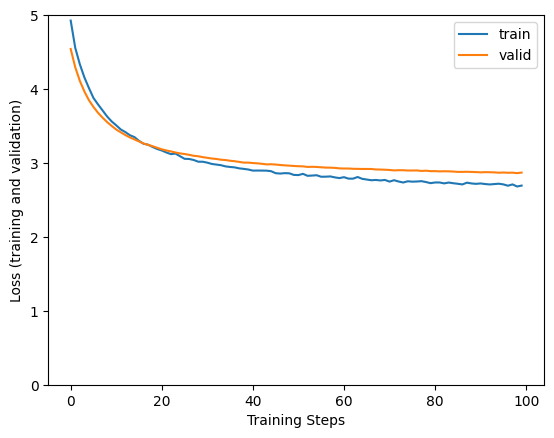

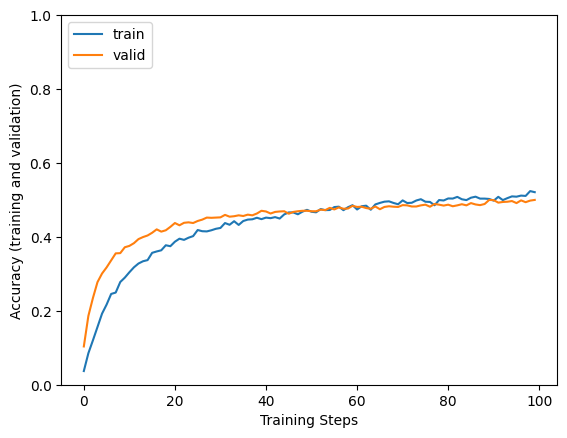

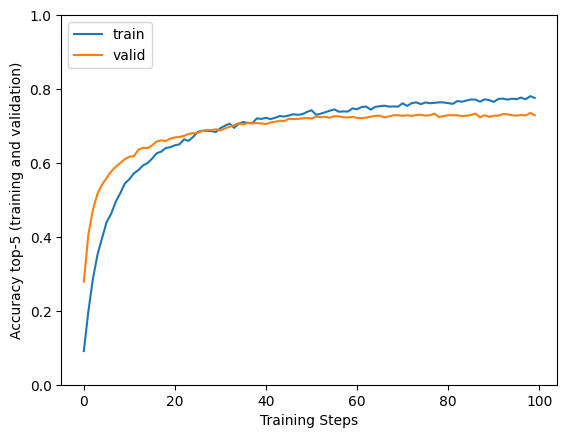

In [40]:
plt.figure()
plt.ylabel("Loss (training and validation)")
plt.xlabel("Training Steps")
plt.ylim([0,5])
plt.plot(hist["loss"])
plt.plot(hist["val_loss"])
plt.legend(['train', 'valid'], loc='upper right')

plt.figure()
plt.ylabel("Accuracy (training and validation)")
plt.xlabel("Training Steps")
plt.ylim([0,1])
plt.plot(hist["accuracy"])
plt.plot(hist["val_accuracy"])
plt.legend(['train', 'valid'], loc='upper left')

plt.figure()
plt.ylabel("Accuracy top-5 (training and validation)")
plt.xlabel("Training Steps")
plt.ylim([0,1])
plt.plot(hist["top-5-accuracy"])
plt.plot(hist["val_top-5-accuracy"])
plt.legend(['train', 'valid'], loc='upper left')

plt.show()

In [33]:
test_data_dir = "Dataset/test"

print(f"tets_data dir: {test_data_dir}")

tets_data dir: Dataset/test


In [34]:
#evaluate
model.load_weights(checkpoint_filepath)
test_ds = tf.keras.utils.image_dataset_from_directory(
  test_data_dir,
  image_size=IMAGE_SIZE,
  label_mode="categorical",
  batch_size=1)

test_ds = test_ds.map(lambda images, labels:
                    (normalization_layer(images), labels))

Found 945 files belonging to 131 classes.


In [35]:
_, accuracy, top_5_accuracy = model.evaluate(test_ds)
print(f"Test accuracy: {round(accuracy * 100, 2)}%")
print(f"Test top 5 accuracy: {round(top_5_accuracy * 100, 2)}%")

945/945 [==============================] - 28s 30ms/step - loss: 2.8939 - accuracy: 0.4825 - top-5-accuracy: 0.7365
Test accuracy: 48.25%
Test top 5 accuracy: 73.65%


In [36]:
def scan_predict(src):
    characters = os.listdir(src)
    for character in characters:
        files = os.listdir(src + '/' + character)
        for image_file in files:
            img_f = src + '/' + character + '/' + image_file
            img = tf.keras.utils.load_img(
                img_f , target_size=IMAGE_SIZE
            )
            img_array = tf.keras.utils.img_to_array(img)
            img_array = tf.expand_dims(img_array, 0) # Create a batch

            img_array = normalization_layer(img_array)

            image = img_array[0,:,:,:]
            plt.imshow(image)
            plt.axis('off')
            plt.show()
            
            print(f"True Label: {character}")
            
            print("This image is likely belongs to:")
            predictions = model.predict(img_array)

            score = tf.nn.softmax(predictions[0])

            predicted_index = np.argsort(score)[-5:][::-1]
            
            for idx in predicted_index:
                prediction_score = (100 * score[idx])

                print(
                    f"> {class_names[idx]} : {prediction_score:.2f} % confidence."
                )

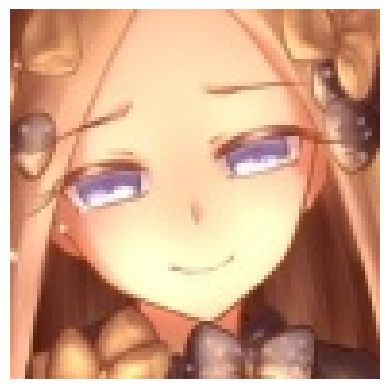

True Label: abigail_williams_(fate)
This image is likely belongs to:
> abigail_williams_(fate) : 10.28 % confidence.
> irisviel_von_einzbern : 7.33 % confidence.
> enterprise_(azur_lane) : 5.92 % confidence.
> semiramis_(fate) : 5.09 % confidence.
> ishtar_(fate_grand_order) : 3.46 % confidence.


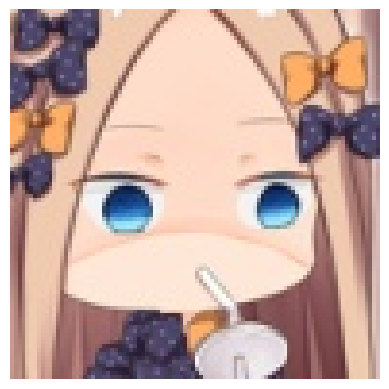

True Label: abigail_williams_(fate)
This image is likely belongs to:
> abigail_williams_(fate) : 94.70 % confidence.
> rider : 1.57 % confidence.
> irisviel_von_einzbern : 1.41 % confidence.
> illyasviel_von_einzbern : 0.22 % confidence.
> takagi-san : 0.18 % confidence.


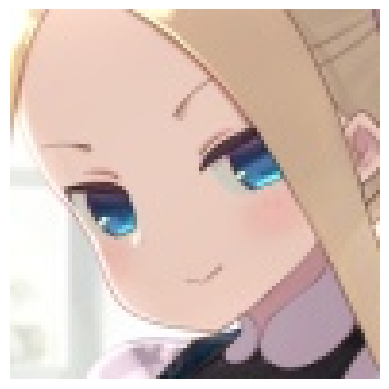

True Label: abigail_williams_(fate)
This image is likely belongs to:
> abigail_williams_(fate) : 16.17 % confidence.
> fujiwara_chika : 7.11 % confidence.
> kochou_shinobu : 6.58 % confidence.
> waver_velvet : 5.37 % confidence.
> shinomiya_kaguya : 4.30 % confidence.


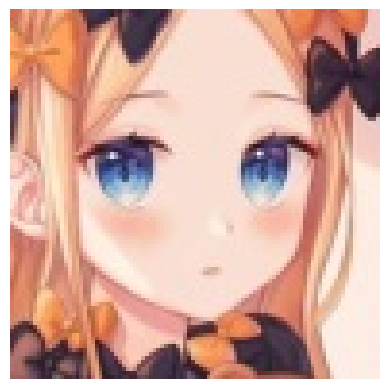

True Label: abigail_williams_(fate)
This image is likely belongs to:
> abigail_williams_(fate) : 34.39 % confidence.
> nishikino_maki : 5.24 % confidence.
> unicorn_(azur_lane) : 4.56 % confidence.
> nakano_itsuki : 4.09 % confidence.
> fujiwara_chika : 2.96 % confidence.


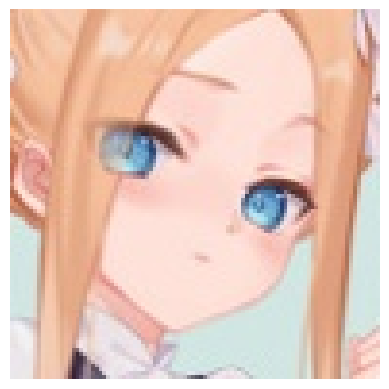

True Label: abigail_williams_(fate)
This image is likely belongs to:
> kizuna_ai : 12.20 % confidence.
> fujiwara_chika : 10.80 % confidence.
> sakurauchi_riko : 10.46 % confidence.
> nakano_miku : 9.87 % confidence.
> abigail_williams_(fate) : 7.54 % confidence.


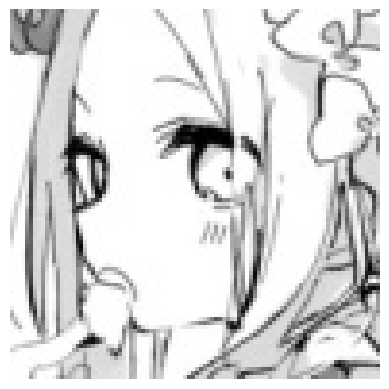

True Label: abigail_williams_(fate)
This image is likely belongs to:
> suzuhara_lulu : 4.96 % confidence.
> anastasia_(idolmaster) : 4.05 % confidence.
> takagi-san : 3.47 % confidence.
> suzumiya_haruhi : 3.25 % confidence.
> senjougahara_hitagi : 2.91 % confidence.


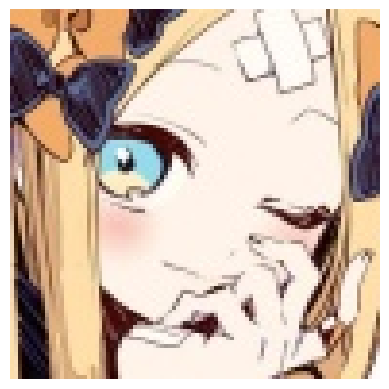

True Label: abigail_williams_(fate)
This image is likely belongs to:
> abigail_williams_(fate) : 23.25 % confidence.
> nami_(one_piece) : 15.82 % confidence.
> asuna_(sao) : 8.38 % confidence.
> cleveland_(azur_lane) : 3.40 % confidence.
> takagi-san : 2.91 % confidence.


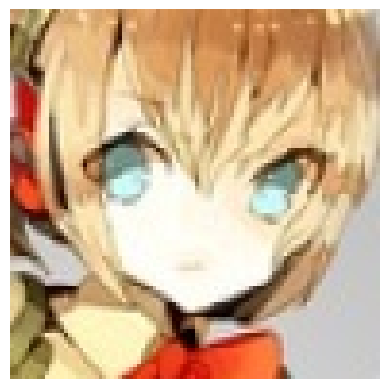

True Label: aegis_(persona)
This image is likely belongs to:
> aegis_(persona) : 12.14 % confidence.
> satonaka_chie : 10.46 % confidence.
> oshino_shinobu : 7.26 % confidence.
> isshiki_iroha : 5.88 % confidence.
> ayanami_rei : 5.66 % confidence.


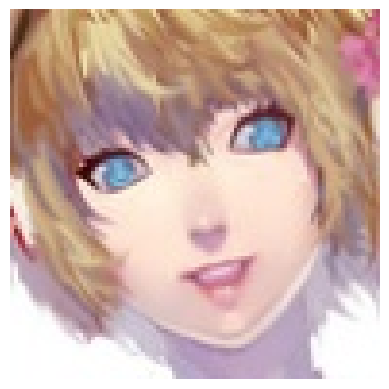

True Label: aegis_(persona)
This image is likely belongs to:
> satonaka_chie : 20.92 % confidence.
> aegis_(persona) : 14.46 % confidence.
> shibuya_rin : 13.21 % confidence.
> gilgamesh : 12.23 % confidence.
> arcueid_brunestud : 6.20 % confidence.


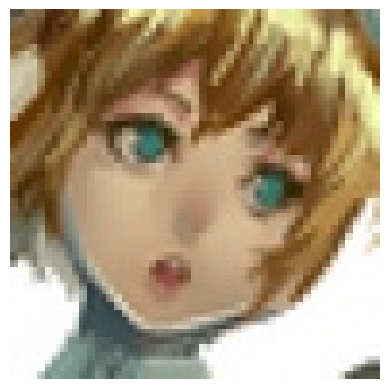

True Label: aegis_(persona)
This image is likely belongs to:
> aegis_(persona) : 72.48 % confidence.
> satonaka_chie : 3.53 % confidence.
> gilgamesh : 2.60 % confidence.
> ayanami_rei : 2.31 % confidence.
> watson_amelia : 1.02 % confidence.


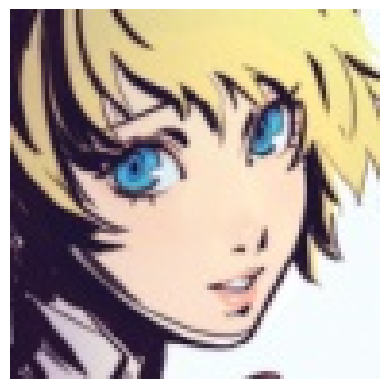

True Label: aegis_(persona)
This image is likely belongs to:
> aegis_(persona) : 22.65 % confidence.
> satonaka_chie : 5.99 % confidence.
> ayanami_rei : 4.71 % confidence.
> shirogane_naoto : 4.31 % confidence.
> fubuki_(one-punch_man) : 4.30 % confidence.


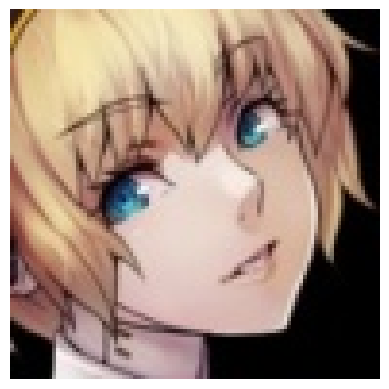

True Label: aegis_(persona)
This image is likely belongs to:
> aegis_(persona) : 23.61 % confidence.
> gilgamesh : 4.12 % confidence.
> souryuu_asuka_langley : 3.76 % confidence.
> oshino_shinobu : 3.45 % confidence.
> nami_(one_piece) : 3.18 % confidence.


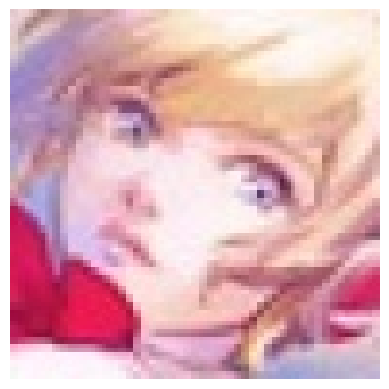

True Label: aegis_(persona)
This image is likely belongs to:
> aegis_(persona) : 24.67 % confidence.
> gilgamesh : 22.19 % confidence.
> arcueid_brunestud : 7.01 % confidence.
> d.va_(overwatch) : 6.72 % confidence.
> ayanami_rei : 5.01 % confidence.


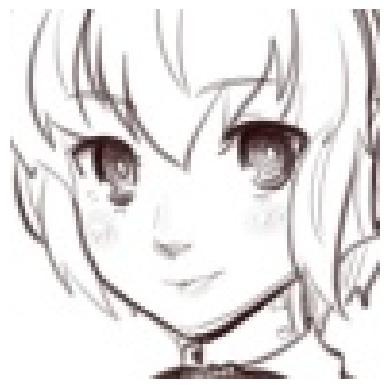

True Label: aegis_(persona)
This image is likely belongs to:
> kaname_madoka : 14.99 % confidence.
> super_sonico : 6.52 % confidence.
> zero_two_(darling_in_the_franxx) : 3.63 % confidence.
> astolfo_(fate) : 3.31 % confidence.
> shirakami_fubuki : 3.14 % confidence.


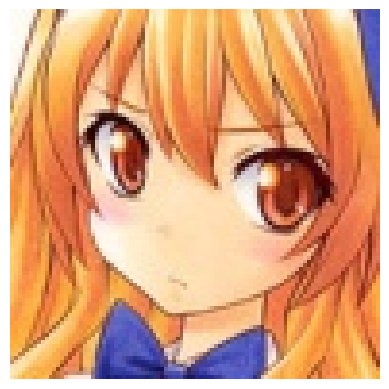

True Label: aisaka_taiga
This image is likely belongs to:
> nami_(one_piece) : 22.37 % confidence.
> miyazono_kawori : 10.58 % confidence.
> aisaka_taiga : 5.04 % confidence.
> raphtalia : 4.64 % confidence.
> asuna_(sao) : 3.85 % confidence.


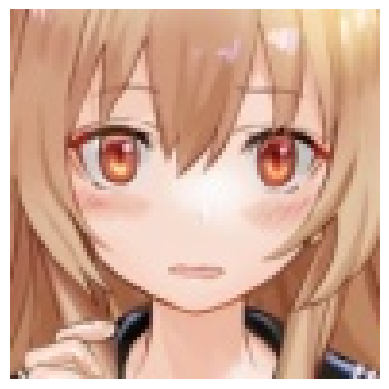

True Label: aisaka_taiga
This image is likely belongs to:
> formidable_(azur_lane) : 12.43 % confidence.
> megumin : 8.19 % confidence.
> aisaka_taiga : 7.71 % confidence.
> cleveland_(azur_lane) : 7.17 % confidence.
> isshiki_iroha : 4.85 % confidence.


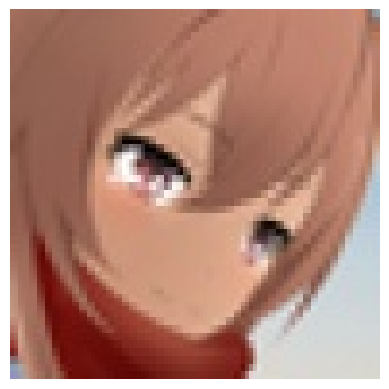

True Label: aisaka_taiga
This image is likely belongs to:
> takagi-san : 18.59 % confidence.
> nakano_yotsuba : 16.68 % confidence.
> okita_souji_(fate) : 8.69 % confidence.
> asuna_(sao) : 4.80 % confidence.
> aisaka_taiga : 4.61 % confidence.


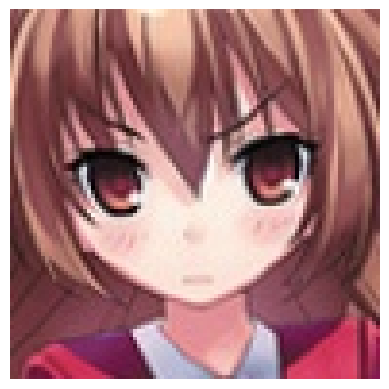

True Label: aisaka_taiga
This image is likely belongs to:
> aisaka_taiga : 27.35 % confidence.
> raphtalia : 7.77 % confidence.
> cleveland_(azur_lane) : 6.57 % confidence.
> isshiki_iroha : 4.62 % confidence.
> yuigahama_yui : 4.35 % confidence.


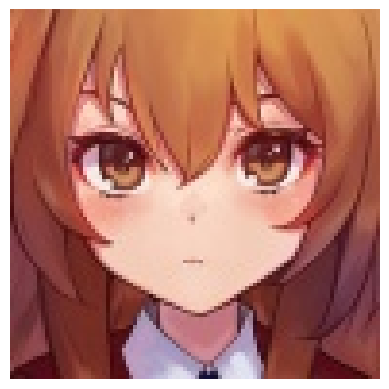

True Label: aisaka_taiga
This image is likely belongs to:
> raphtalia : 49.62 % confidence.
> aisaka_taiga : 21.20 % confidence.
> isshiki_iroha : 3.67 % confidence.
> yui_(angel_beats!) : 1.71 % confidence.
> shishiro_botan : 1.35 % confidence.


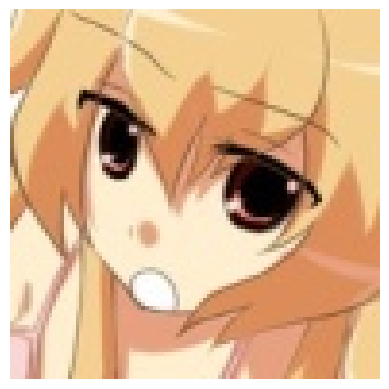

True Label: aisaka_taiga
This image is likely belongs to:
> aisaka_taiga : 12.15 % confidence.
> hatsune_miku : 12.13 % confidence.
> sinon : 8.27 % confidence.
> nakano_yotsuba : 6.97 % confidence.
> hirasawa_yui : 4.51 % confidence.


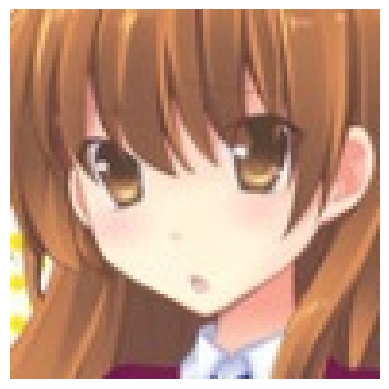

True Label: aisaka_taiga
This image is likely belongs to:
> furukawa_nagisa : 16.54 % confidence.
> aisaka_taiga : 8.68 % confidence.
> isshiki_iroha : 8.62 % confidence.
> takao_(azur_lane) : 5.24 % confidence.
> megumin : 5.00 % confidence.


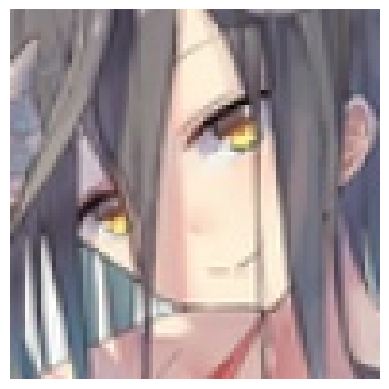

True Label: albedo
This image is likely belongs to:
> albedo : 21.36 % confidence.
> irisviel_von_einzbern : 9.46 % confidence.
> semiramis_(fate) : 7.49 % confidence.
> rider : 7.08 % confidence.
> abigail_williams_(fate) : 5.15 % confidence.


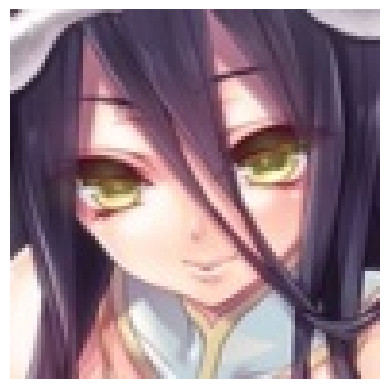

True Label: albedo
This image is likely belongs to:
> nakano_miku : 6.09 % confidence.
> st_ar-15_(girls_frontline) : 5.64 % confidence.
> suzuhara_lulu : 5.62 % confidence.
> nishikino_maki : 3.37 % confidence.
> rider : 3.25 % confidence.


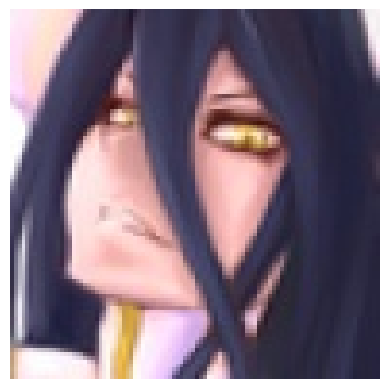

True Label: albedo
This image is likely belongs to:
> albedo : 73.35 % confidence.
> nakano_miku : 3.39 % confidence.
> rider : 1.83 % confidence.
> hayasaka_ai : 1.13 % confidence.
> bremerton_(azur_lane) : 1.11 % confidence.


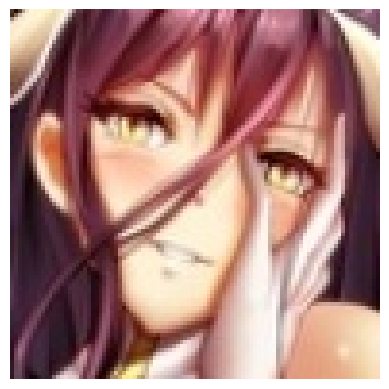

True Label: albedo
This image is likely belongs to:
> albedo : 50.67 % confidence.
> okita_souji_(fate) : 9.69 % confidence.
> bremerton_(azur_lane) : 3.35 % confidence.
> sakurauchi_riko : 2.75 % confidence.
> sinon : 2.19 % confidence.


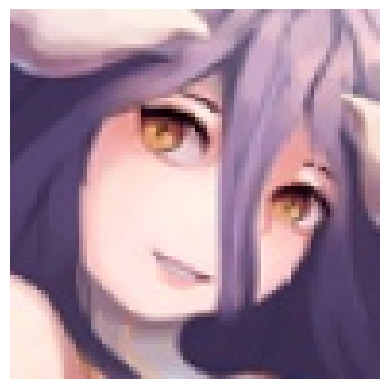

True Label: albedo
This image is likely belongs to:
> nishikino_maki : 4.65 % confidence.
> unicorn_(azur_lane) : 4.61 % confidence.
> senjougahara_hitagi : 3.89 % confidence.
> meltlilith : 3.40 % confidence.
> nakano_miku : 3.25 % confidence.


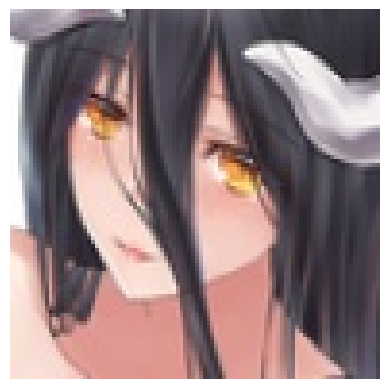

True Label: albedo
This image is likely belongs to:
> albedo : 82.31 % confidence.
> karna_(fate) : 3.47 % confidence.
> semiramis_(fate) : 1.26 % confidence.
> laffey_(azur_lane) : 0.71 % confidence.
> shinomiya_kaguya : 0.59 % confidence.


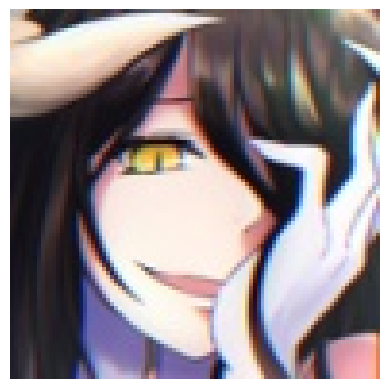

True Label: albedo
This image is likely belongs to:
> albedo : 41.71 % confidence.
> ryougi_shiki : 4.91 % confidence.
> sengoku_nadeko : 2.19 % confidence.
> sakura_futaba : 2.05 % confidence.
> shuten_douji_(fate) : 2.02 % confidence.


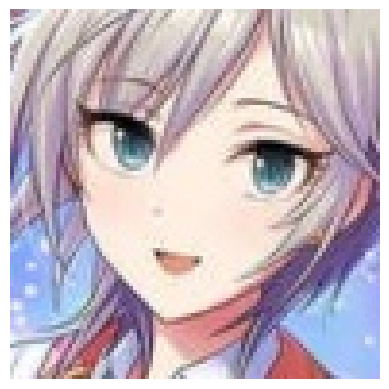

True Label: anastasia_(idolmaster)
This image is likely belongs to:
> anastasia_(idolmaster) : 38.92 % confidence.
> shidare_hotaru : 5.84 % confidence.
> yukinoshita_yukino : 2.44 % confidence.
> misaka_mikoto : 2.42 % confidence.
> kirito : 2.09 % confidence.


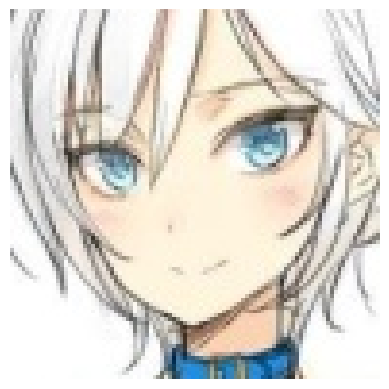

True Label: anastasia_(idolmaster)
This image is likely belongs to:
> anastasia_(idolmaster) : 41.18 % confidence.
> sakurajima_mai : 5.13 % confidence.
> nagato_yuki : 4.72 % confidence.
> toujou_nozomi : 3.17 % confidence.
> ayanami_rei : 3.01 % confidence.


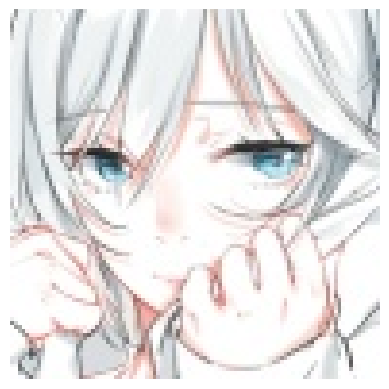

True Label: anastasia_(idolmaster)
This image is likely belongs to:
> kaname_madoka : 14.24 % confidence.
> anastasia_(idolmaster) : 12.88 % confidence.
> rem_rezero : 5.30 % confidence.
> nakano_miku : 3.61 % confidence.
> shishiro_botan : 3.45 % confidence.


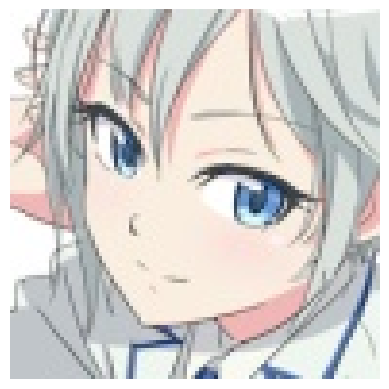

True Label: anastasia_(idolmaster)
This image is likely belongs to:
> sinon : 6.94 % confidence.
> anastasia_(idolmaster) : 6.92 % confidence.
> shirakami_fubuki : 5.63 % confidence.
> hayasaka_ai : 5.35 % confidence.
> shishiro_botan : 5.16 % confidence.


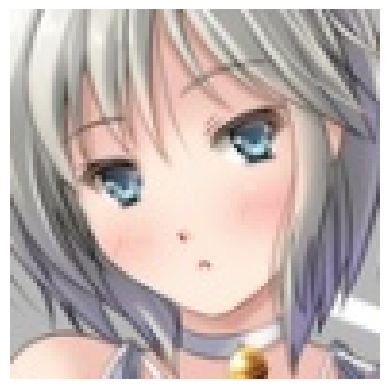

True Label: anastasia_(idolmaster)
This image is likely belongs to:
> nishikino_maki : 9.06 % confidence.
> shinomiya_kaguya : 6.01 % confidence.
> watson_amelia : 5.16 % confidence.
> sakurajima_mai : 4.21 % confidence.
> aegis_(persona) : 2.90 % confidence.


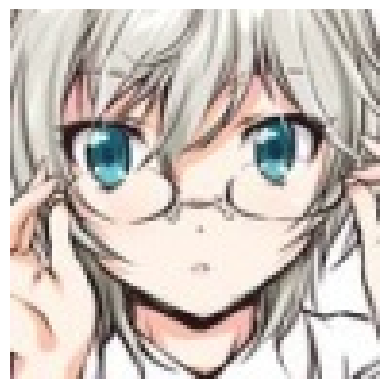

True Label: anastasia_(idolmaster)
This image is likely belongs to:
> shirakami_fubuki : 11.72 % confidence.
> arcueid_brunestud : 7.34 % confidence.
> anastasia_(idolmaster) : 7.04 % confidence.
> gilgamesh : 5.67 % confidence.
> illyasviel_von_einzbern : 4.13 % confidence.


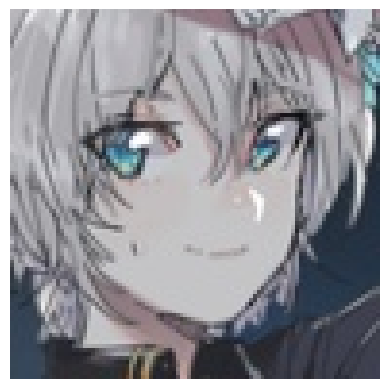

True Label: anastasia_(idolmaster)
This image is likely belongs to:
> keqing_(genshin_impact) : 4.67 % confidence.
> okita_souji_(fate) : 4.57 % confidence.
> anastasia_(idolmaster) : 4.43 % confidence.
> shishiro_botan : 4.41 % confidence.
> ishtar_(fate_grand_order) : 4.18 % confidence.


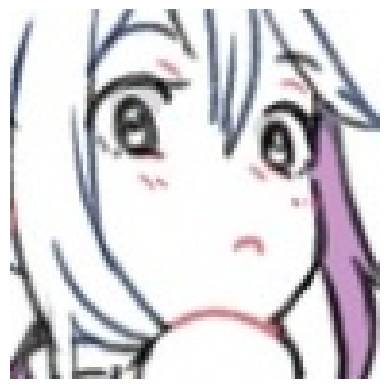

True Label: aqua_(konosuba)
This image is likely belongs to:
> ayanami_rei : 10.10 % confidence.
> irisviel_von_einzbern : 7.64 % confidence.
> shirakami_fubuki : 7.21 % confidence.
> gawr_gura : 5.16 % confidence.
> sinon : 4.50 % confidence.


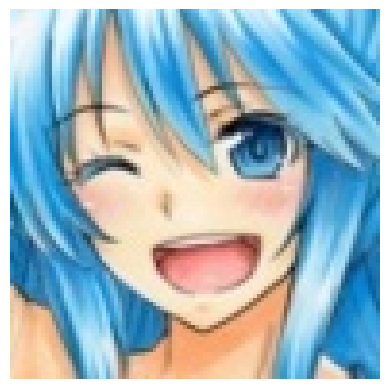

True Label: aqua_(konosuba)
This image is likely belongs to:
> aqua_(konosuba) : 23.89 % confidence.
> ayanami_rei : 15.11 % confidence.
> sinon : 5.11 % confidence.
> chloe_von_einzbern : 4.72 % confidence.
> nami_(one_piece) : 3.09 % confidence.


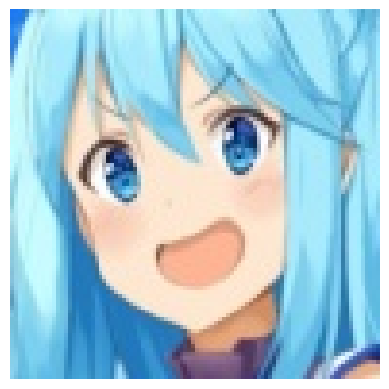

True Label: aqua_(konosuba)
This image is likely belongs to:
> aqua_(konosuba) : 23.94 % confidence.
> miyazono_kawori : 4.76 % confidence.
> yuigahama_yui : 3.46 % confidence.
> gawr_gura : 3.40 % confidence.
> nami_(one_piece) : 3.14 % confidence.


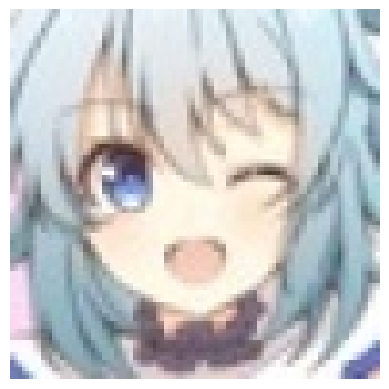

True Label: aqua_(konosuba)
This image is likely belongs to:
> ayanami_rei : 8.63 % confidence.
> gawr_gura : 8.17 % confidence.
> astolfo_(fate) : 7.10 % confidence.
> aegis_(persona) : 6.06 % confidence.
> arcueid_brunestud : 5.75 % confidence.


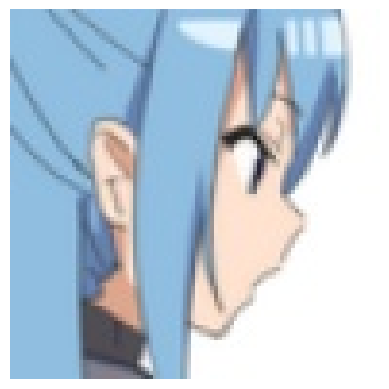

True Label: aqua_(konosuba)
This image is likely belongs to:
> aqua_(konosuba) : 12.13 % confidence.
> hatsune_miku : 9.74 % confidence.
> ichigo_(darling_in_the_franxx) : 8.64 % confidence.
> sinon : 6.38 % confidence.
> hirasawa_yui : 5.10 % confidence.


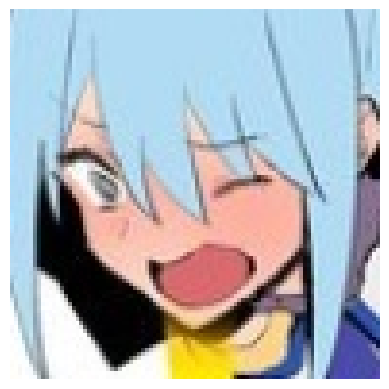

True Label: aqua_(konosuba)
This image is likely belongs to:
> aqua_(konosuba) : 5.14 % confidence.
> shirakami_fubuki : 4.84 % confidence.
> paimon_(genshin_impact) : 4.53 % confidence.
> shidare_hotaru : 4.06 % confidence.
> gawr_gura : 3.86 % confidence.


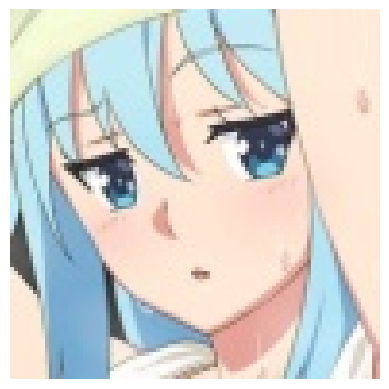

True Label: aqua_(konosuba)
This image is likely belongs to:
> yukinoshita_yukino : 12.77 % confidence.
> ouro_kronii : 9.55 % confidence.
> enterprise_(azur_lane) : 6.70 % confidence.
> ninomae_ina'nis : 5.02 % confidence.
> utsumi_erise : 4.77 % confidence.


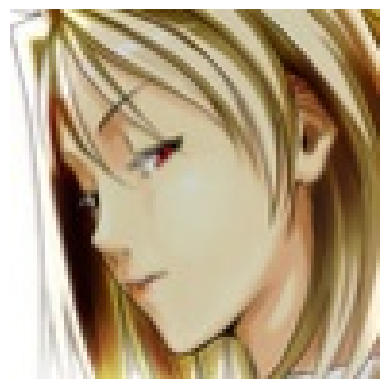

True Label: arcueid_brunestud
This image is likely belongs to:
> ram_rezero : 4.38 % confidence.
> asuna_(sao) : 4.19 % confidence.
> arcueid_brunestud : 3.99 % confidence.
> karin_(blue_archive) : 3.82 % confidence.
> kaname_madoka : 3.00 % confidence.


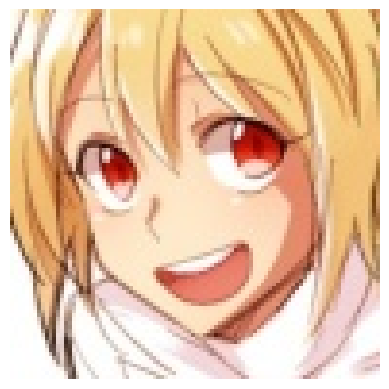

True Label: arcueid_brunestud
This image is likely belongs to:
> arcueid_brunestud : 27.44 % confidence.
> aegis_(persona) : 10.71 % confidence.
> miyazono_kawori : 3.49 % confidence.
> watson_amelia : 3.36 % confidence.
> gawr_gura : 2.98 % confidence.


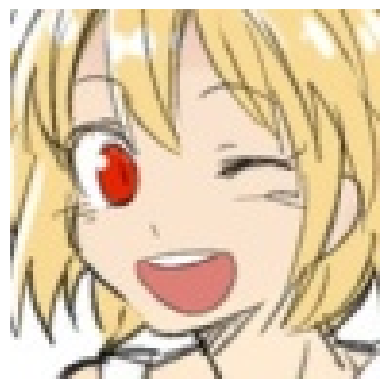

True Label: arcueid_brunestud
This image is likely belongs to:
> arcueid_brunestud : 28.06 % confidence.
> cleveland_(azur_lane) : 11.92 % confidence.
> miyazono_kawori : 8.91 % confidence.
> aegis_(persona) : 6.24 % confidence.
> watson_amelia : 5.63 % confidence.


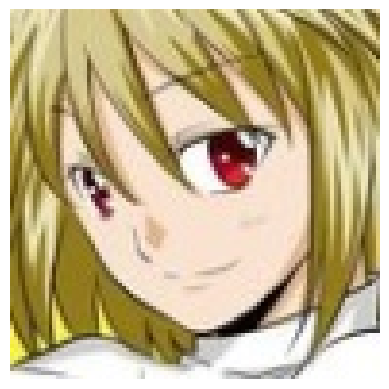

True Label: arcueid_brunestud
This image is likely belongs to:
> arcueid_brunestud : 48.92 % confidence.
> gilgamesh : 3.33 % confidence.
> shirogane_noel : 2.24 % confidence.
> watson_amelia : 1.66 % confidence.
> nekomata_okayu : 1.64 % confidence.


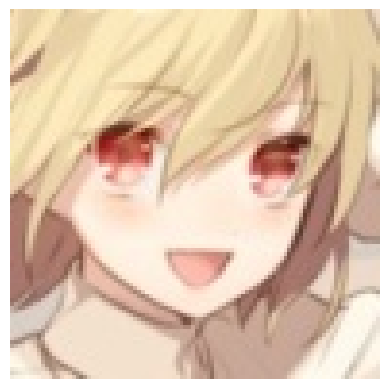

True Label: arcueid_brunestud
This image is likely belongs to:
> arcueid_brunestud : 24.99 % confidence.
> illyasviel_von_einzbern : 21.80 % confidence.
> shirakami_fubuki : 3.14 % confidence.
> irisviel_von_einzbern : 3.01 % confidence.
> laffey_(azur_lane) : 2.92 % confidence.


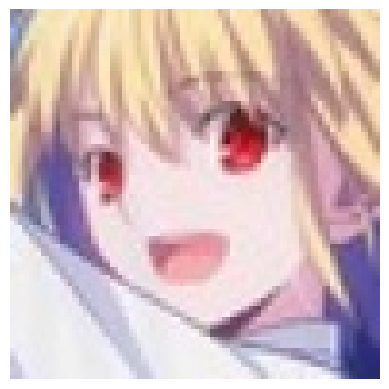

True Label: arcueid_brunestud
This image is likely belongs to:
> arcueid_brunestud : 75.98 % confidence.
> illyasviel_von_einzbern : 3.75 % confidence.
> shirakami_fubuki : 1.88 % confidence.
> gilgamesh : 1.59 % confidence.
> oshino_shinobu : 1.19 % confidence.


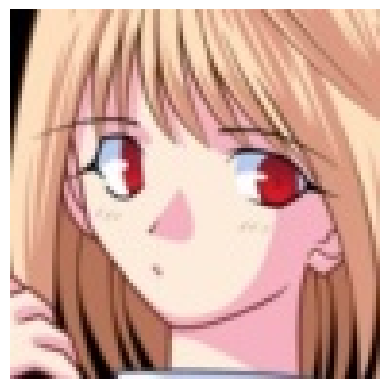

True Label: arcueid_brunestud
This image is likely belongs to:
> arcueid_brunestud : 9.17 % confidence.
> kiryu_coco : 6.68 % confidence.
> suzumiya_haruhi : 6.44 % confidence.
> watson_amelia : 5.38 % confidence.
> kizuna_ai : 4.53 % confidence.


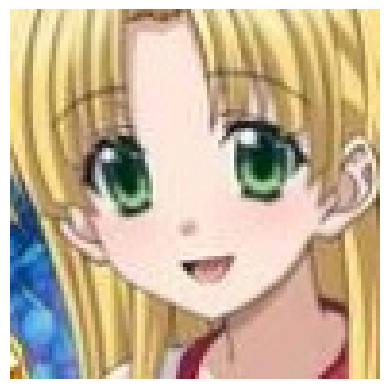

True Label: asia_argento
This image is likely belongs to:
> asia_argento : 65.34 % confidence.
> oshino_shinobu : 3.20 % confidence.
> rem_rezero : 2.81 % confidence.
> nishikino_maki : 2.39 % confidence.
> kiryu_coco : 2.35 % confidence.


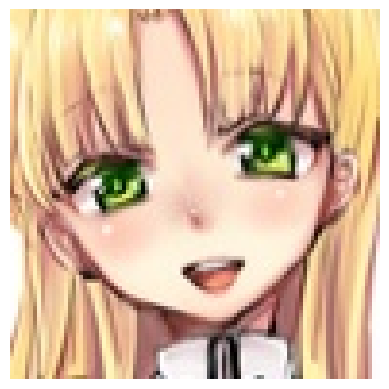

True Label: asia_argento
This image is likely belongs to:
> cleveland_(azur_lane) : 24.98 % confidence.
> belfast_(azur_lane) : 9.79 % confidence.
> formidable_(azur_lane) : 3.93 % confidence.
> tsushima_yoshiko : 3.55 % confidence.
> super_sonico : 3.13 % confidence.


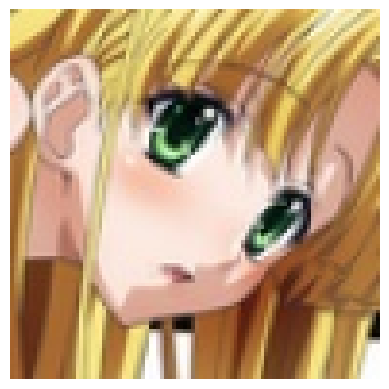

True Label: asia_argento
This image is likely belongs to:
> asia_argento : 74.02 % confidence.
> souryuu_asuka_langley : 2.93 % confidence.
> platelet_(hataraku_saibou) : 1.71 % confidence.
> aisaka_taiga : 1.62 % confidence.
> watson_amelia : 1.20 % confidence.


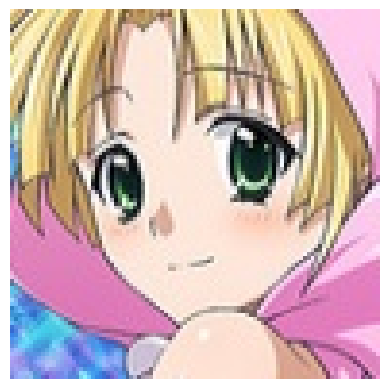

True Label: asia_argento
This image is likely belongs to:
> satonaka_chie : 14.38 % confidence.
> kirito : 6.18 % confidence.
> unicorn_(azur_lane) : 5.72 % confidence.
> nakano_azusa : 3.27 % confidence.
> ayanami_rei : 3.24 % confidence.


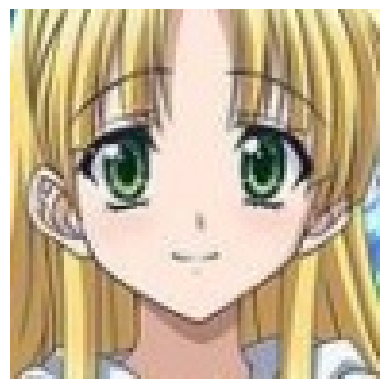

True Label: asia_argento
This image is likely belongs to:
> asia_argento : 50.98 % confidence.
> asuna_(sao) : 6.95 % confidence.
> isshiki_iroha : 3.83 % confidence.
> aisaka_taiga : 2.14 % confidence.
> nami_(one_piece) : 1.97 % confidence.


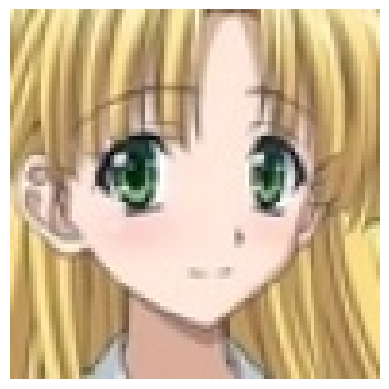

True Label: asia_argento
This image is likely belongs to:
> asia_argento : 50.40 % confidence.
> miyazono_kawori : 6.42 % confidence.
> nishikino_maki : 5.14 % confidence.
> watson_amelia : 3.98 % confidence.
> nakano_itsuki : 2.61 % confidence.


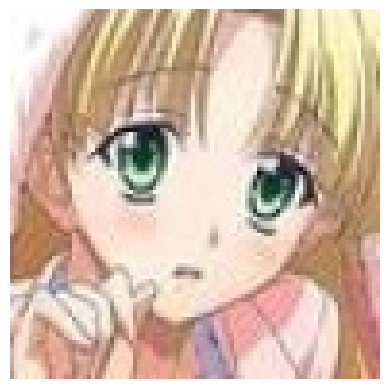

True Label: asia_argento
This image is likely belongs to:
> asia_argento : 36.15 % confidence.
> yuigahama_yui : 6.98 % confidence.
> isshiki_iroha : 5.15 % confidence.
> nishikino_maki : 3.11 % confidence.
> fujiwara_chika : 2.88 % confidence.


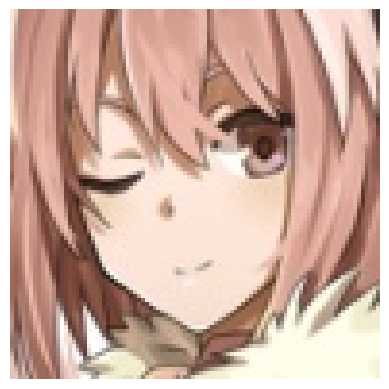

True Label: astolfo_(fate)
This image is likely belongs to:
> mash_kyrielight : 7.02 % confidence.
> kaname_madoka : 5.76 % confidence.
> suzuhara_lulu : 4.74 % confidence.
> ram_rezero : 4.39 % confidence.
> yuigahama_yui : 3.47 % confidence.


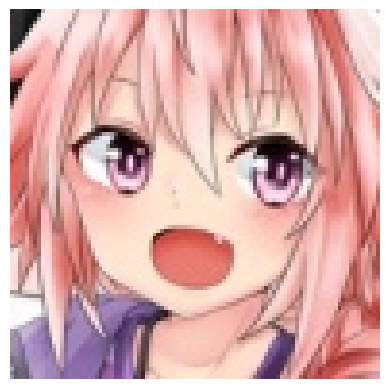

True Label: astolfo_(fate)
This image is likely belongs to:
> astolfo_(fate) : 31.38 % confidence.
> yuigahama_yui : 15.66 % confidence.
> miyazono_kawori : 2.88 % confidence.
> nakano_itsuki : 2.86 % confidence.
> aqua_(konosuba) : 2.64 % confidence.


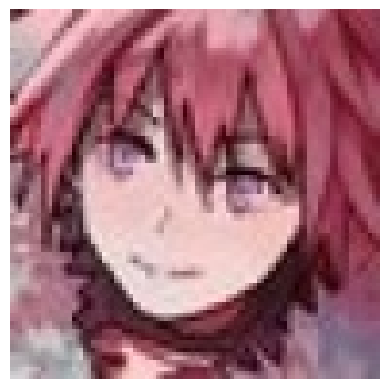

True Label: astolfo_(fate)
This image is likely belongs to:
> fubuki_(one-punch_man) : 10.32 % confidence.
> karna_(fate) : 3.44 % confidence.
> st_ar-15_(girls_frontline) : 3.30 % confidence.
> oshino_ougi : 3.24 % confidence.
> dido_(azur_lane) : 2.81 % confidence.


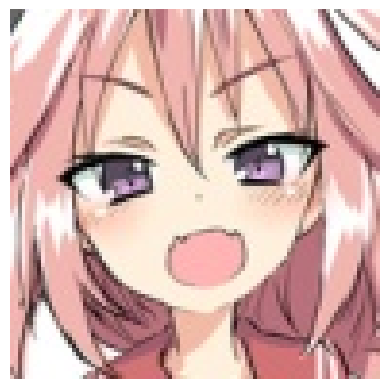

True Label: astolfo_(fate)
This image is likely belongs to:
> astolfo_(fate) : 7.32 % confidence.
> zero_two_(darling_in_the_franxx) : 6.90 % confidence.
> makise_kurisu : 4.66 % confidence.
> yuigahama_yui : 4.21 % confidence.
> nakano_itsuki : 4.13 % confidence.


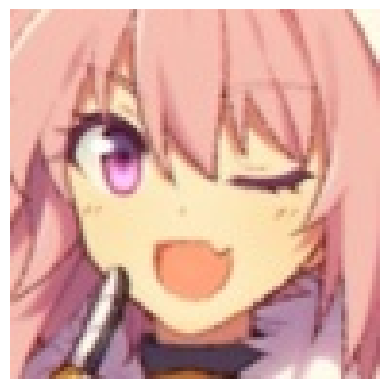

True Label: astolfo_(fate)
This image is likely belongs to:
> fujibayashi_kyou : 8.25 % confidence.
> gawr_gura : 6.53 % confidence.
> aqua_(konosuba) : 6.45 % confidence.
> nakano_azusa : 4.71 % confidence.
> suzumiya_haruhi : 4.42 % confidence.


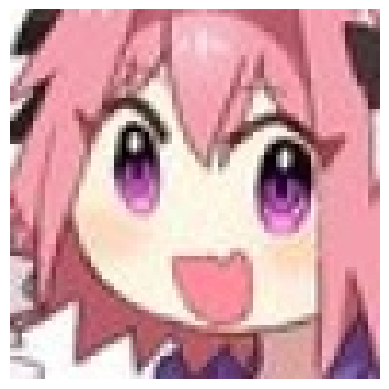

True Label: astolfo_(fate)
This image is likely belongs to:
> mei_(pokemon) : 10.05 % confidence.
> hatsune_miku : 9.69 % confidence.
> hirasawa_yui : 9.33 % confidence.
> astolfo_(fate) : 6.84 % confidence.
> kiryu_coco : 6.15 % confidence.


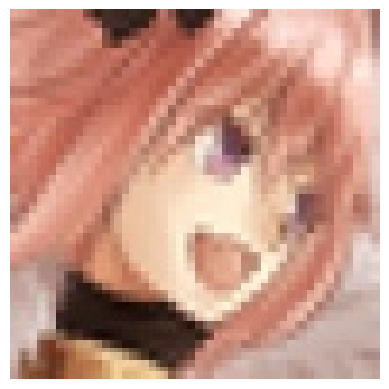

True Label: astolfo_(fate)
This image is likely belongs to:
> mei_(pokemon) : 13.89 % confidence.
> souryuu_asuka_langley : 12.47 % confidence.
> hatsune_miku : 8.33 % confidence.
> astolfo_(fate) : 7.03 % confidence.
> oshino_shinobu : 3.77 % confidence.


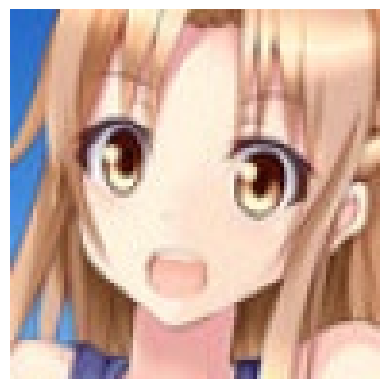

True Label: asuna_(sao)
This image is likely belongs to:
> asuna_(sao) : 27.35 % confidence.
> ninomae_ina'nis : 13.03 % confidence.
> asia_argento : 10.67 % confidence.
> takagi-san : 6.43 % confidence.
> cleveland_(azur_lane) : 4.04 % confidence.


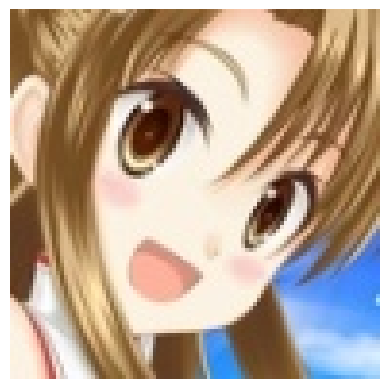

True Label: asuna_(sao)
This image is likely belongs to:
> takagi-san : 29.88 % confidence.
> asia_argento : 8.88 % confidence.
> suzumiya_haruhi : 5.63 % confidence.
> waver_velvet : 2.98 % confidence.
> asuna_(sao) : 2.49 % confidence.


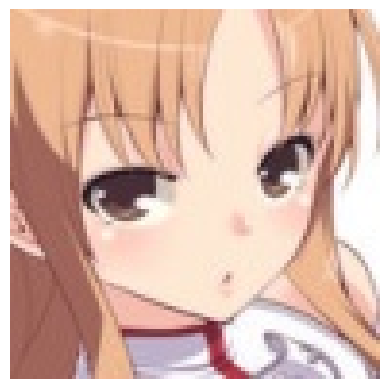

True Label: asuna_(sao)
This image is likely belongs to:
> misaka_mikoto : 7.09 % confidence.
> belfast_(azur_lane) : 5.59 % confidence.
> asuna_(sao) : 5.26 % confidence.
> takarada_rikka : 2.99 % confidence.
> takamaki_anne : 2.94 % confidence.


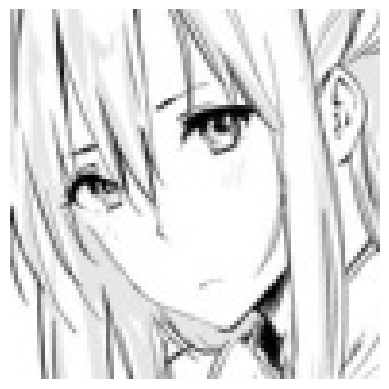

True Label: asuna_(sao)
This image is likely belongs to:
> mash_kyrielight : 6.86 % confidence.
> suzuhara_lulu : 6.52 % confidence.
> semiramis_(fate) : 4.30 % confidence.
> shirakami_fubuki : 3.24 % confidence.
> shuten_douji_(fate) : 2.73 % confidence.


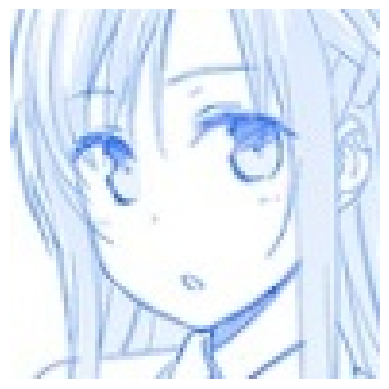

True Label: asuna_(sao)
This image is likely belongs to:
> asuna_(sao) : 6.55 % confidence.
> toosaka_rin : 5.58 % confidence.
> chitanda_eru : 4.91 % confidence.
> irisviel_von_einzbern : 4.82 % confidence.
> emilia_rezero : 4.00 % confidence.


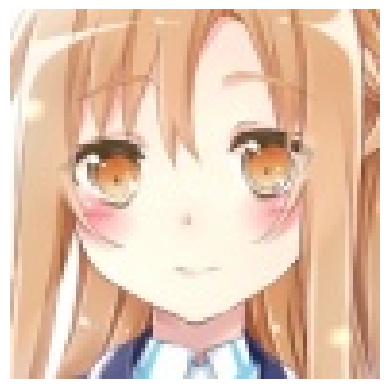

True Label: asuna_(sao)
This image is likely belongs to:
> cleveland_(azur_lane) : 18.53 % confidence.
> kiryu_coco : 9.22 % confidence.
> asuna_(sao) : 4.24 % confidence.
> sakurauchi_riko : 3.51 % confidence.
> miyazono_kawori : 3.21 % confidence.


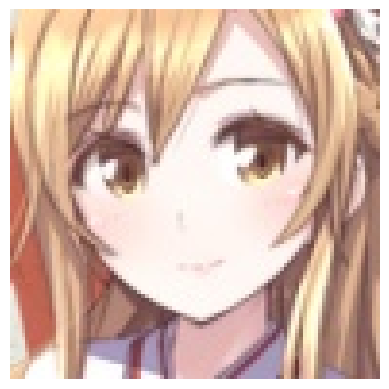

True Label: asuna_(sao)
This image is likely belongs to:
> asuna_(sao) : 28.28 % confidence.
> kiryu_coco : 5.57 % confidence.
> platelet_(hataraku_saibou) : 5.06 % confidence.
> isshiki_iroha : 4.14 % confidence.
> cleveland_(azur_lane) : 3.37 % confidence.


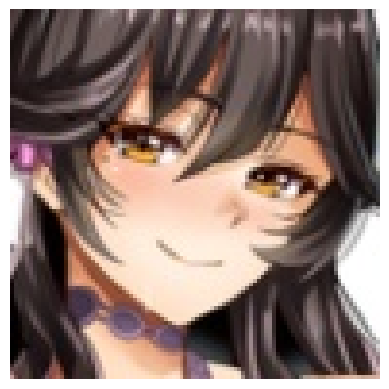

True Label: atago_(azur_lane)
This image is likely belongs to:
> takao_(azur_lane) : 26.97 % confidence.
> keqing_(genshin_impact) : 4.50 % confidence.
> gilgamesh : 3.82 % confidence.
> atago_(azur_lane) : 3.74 % confidence.
> furukawa_nagisa : 3.65 % confidence.


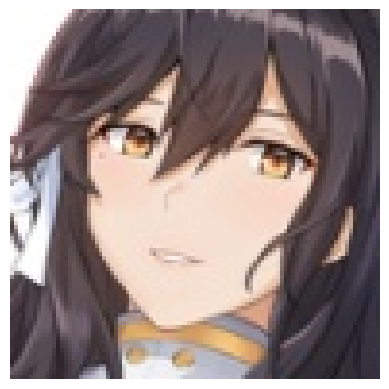

True Label: atago_(azur_lane)
This image is likely belongs to:
> suzumiya_haruhi : 9.88 % confidence.
> takarada_rikka : 9.24 % confidence.
> fujibayashi_kyou : 7.73 % confidence.
> takao_(azur_lane) : 4.92 % confidence.
> megumin : 4.01 % confidence.


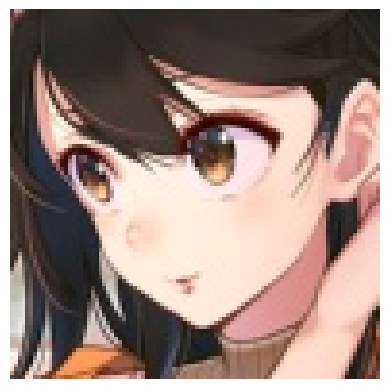

True Label: atago_(azur_lane)
This image is likely belongs to:
> sakurauchi_riko : 12.40 % confidence.
> takamaki_anne : 10.03 % confidence.
> bremerton_(azur_lane) : 3.93 % confidence.
> ookami_mio : 3.80 % confidence.
> platelet_(hataraku_saibou) : 2.74 % confidence.


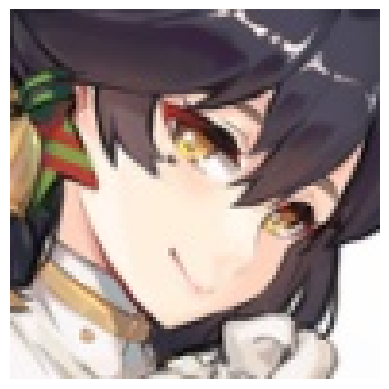

True Label: atago_(azur_lane)
This image is likely belongs to:
> takao_(azur_lane) : 38.02 % confidence.
> shirogane_naoto : 13.85 % confidence.
> katsuragi_misato : 6.10 % confidence.
> lancer : 5.25 % confidence.
> atago_(azur_lane) : 4.77 % confidence.


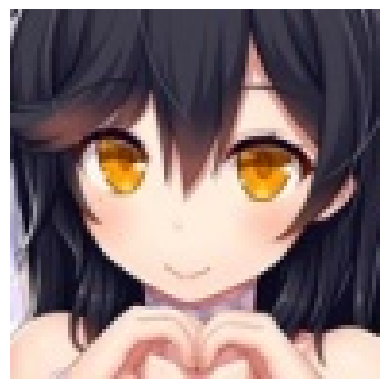

True Label: atago_(azur_lane)
This image is likely belongs to:
> aisaka_taiga : 13.31 % confidence.
> nakano_azusa : 10.07 % confidence.
> nakano_itsuki : 8.45 % confidence.
> shirogane_naoto : 5.31 % confidence.
> ishtar_(fate_grand_order) : 4.85 % confidence.


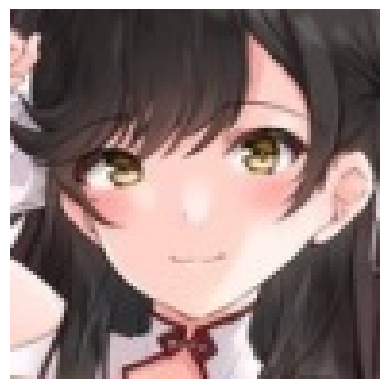

True Label: atago_(azur_lane)
This image is likely belongs to:
> sakurajima_mai : 7.67 % confidence.
> atago_(azur_lane) : 7.57 % confidence.
> sakurauchi_riko : 5.18 % confidence.
> d.va_(overwatch) : 4.46 % confidence.
> ookami_mio : 4.45 % confidence.


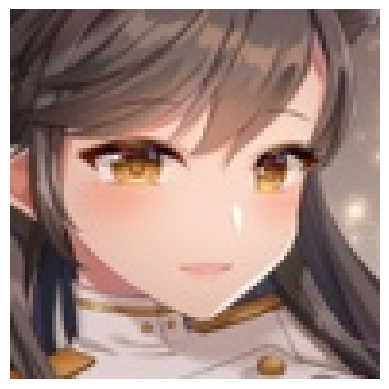

True Label: atago_(azur_lane)
This image is likely belongs to:
> atago_(azur_lane) : 18.26 % confidence.
> takao_(azur_lane) : 7.61 % confidence.
> ishtar_(fate_grand_order) : 6.61 % confidence.
> semiramis_(fate) : 5.75 % confidence.
> formidable_(azur_lane) : 4.95 % confidence.


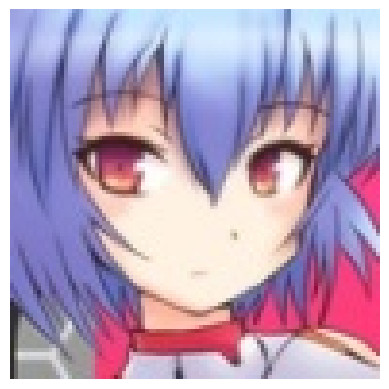

True Label: ayanami_rei
This image is likely belongs to:
> nakano_azusa : 12.44 % confidence.
> yui_(angel_beats!) : 11.82 % confidence.
> laffey_(azur_lane) : 6.04 % confidence.
> aisaka_taiga : 4.43 % confidence.
> matou_sakura : 3.59 % confidence.


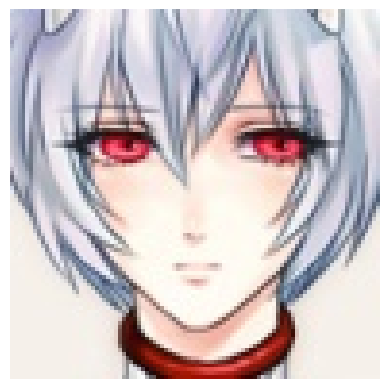

True Label: ayanami_rei
This image is likely belongs to:
> ayanami_rei : 42.95 % confidence.
> laffey_(azur_lane) : 12.32 % confidence.
> nagato_yuki : 3.68 % confidence.
> shishiro_botan : 3.08 % confidence.
> nekomata_okayu : 2.99 % confidence.


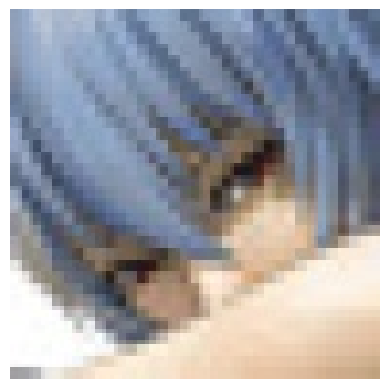

True Label: ayanami_rei
This image is likely belongs to:
> ayanami_rei : 26.07 % confidence.
> karin_(blue_archive) : 18.30 % confidence.
> c.c : 6.32 % confidence.
> meltlilith : 6.04 % confidence.
> komi_shouko : 3.48 % confidence.


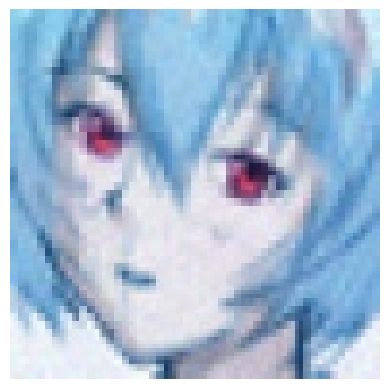

True Label: ayanami_rei
This image is likely belongs to:
> ayanami_rei : 72.21 % confidence.
> sinon : 1.35 % confidence.
> anastasia_(idolmaster) : 1.35 % confidence.
> keqing_(genshin_impact) : 1.26 % confidence.
> lancer : 1.10 % confidence.


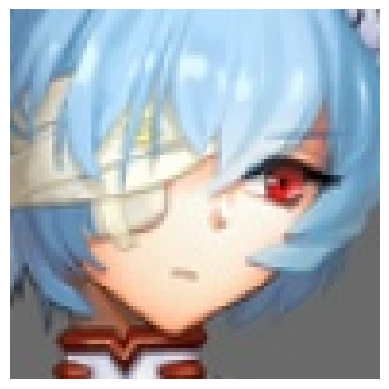

True Label: ayanami_rei
This image is likely belongs to:
> ayanami_rei : 30.62 % confidence.
> ram_rezero : 3.60 % confidence.
> aegis_(persona) : 3.24 % confidence.
> keqing_(genshin_impact) : 2.61 % confidence.
> laffey_(azur_lane) : 2.59 % confidence.


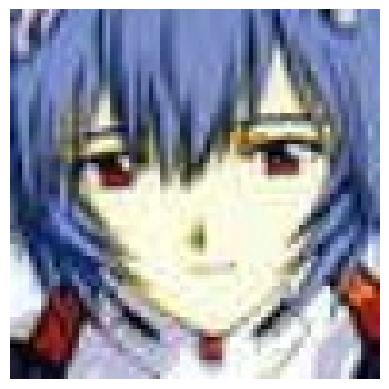

True Label: ayanami_rei
This image is likely belongs to:
> ayanami_rei : 35.76 % confidence.
> shirogane_naoto : 19.54 % confidence.
> tsushima_yoshiko : 4.73 % confidence.
> keqing_(genshin_impact) : 3.58 % confidence.
> takao_(azur_lane) : 3.49 % confidence.


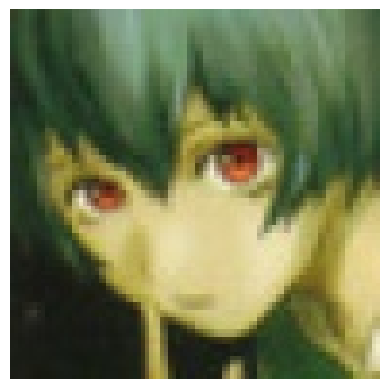

True Label: ayanami_rei
This image is likely belongs to:
> c.c : 61.61 % confidence.
> satonaka_chie : 6.06 % confidence.
> meltlilith : 4.31 % confidence.
> ayanami_rei : 2.97 % confidence.
> gilgamesh : 1.33 % confidence.


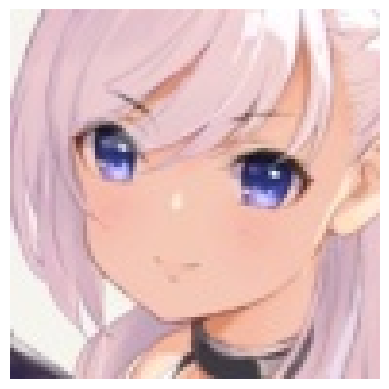

True Label: belfast_(azur_lane)
This image is likely belongs to:
> watson_amelia : 10.74 % confidence.
> isshiki_iroha : 9.43 % confidence.
> nishikino_maki : 8.01 % confidence.
> belfast_(azur_lane) : 5.49 % confidence.
> yuigahama_yui : 5.06 % confidence.


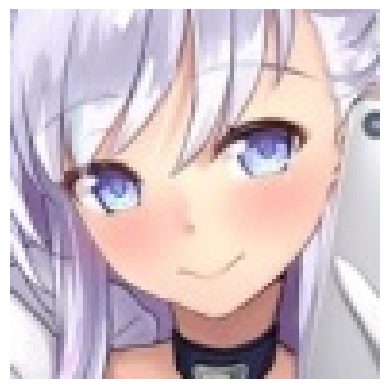

True Label: belfast_(azur_lane)
This image is likely belongs to:
> belfast_(azur_lane) : 44.88 % confidence.
> enterprise_(azur_lane) : 4.86 % confidence.
> yukinoshita_yukino : 4.38 % confidence.
> usada_pekora : 1.77 % confidence.
> sakurajima_mai : 1.69 % confidence.


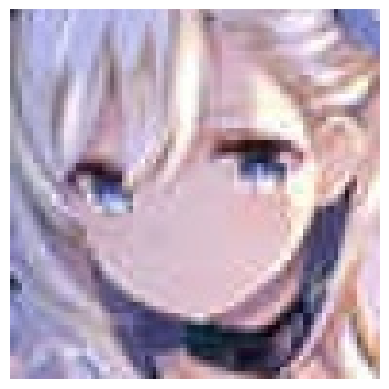

True Label: belfast_(azur_lane)
This image is likely belongs to:
> chloe_von_einzbern : 8.48 % confidence.
> belfast_(azur_lane) : 3.57 % confidence.
> asuna_(sao) : 3.48 % confidence.
> shishiro_botan : 3.35 % confidence.
> super_sonico : 3.13 % confidence.


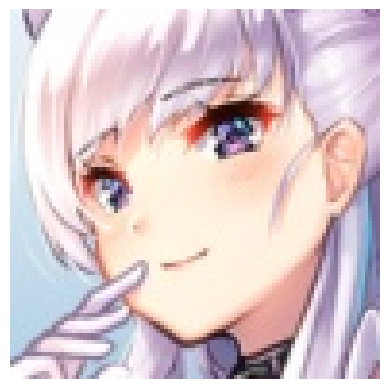

True Label: belfast_(azur_lane)
This image is likely belongs to:
> belfast_(azur_lane) : 34.82 % confidence.
> tsushima_yoshiko : 5.94 % confidence.
> minato_aqua : 3.69 % confidence.
> formidable_(azur_lane) : 3.08 % confidence.
> matou_sakura : 3.01 % confidence.


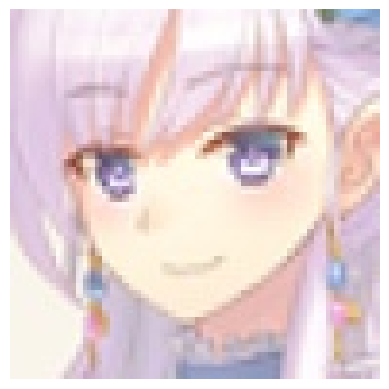

True Label: belfast_(azur_lane)
This image is likely belongs to:
> enterprise_(azur_lane) : 9.69 % confidence.
> platelet_(hataraku_saibou) : 7.65 % confidence.
> belfast_(azur_lane) : 7.28 % confidence.
> misaka_mikoto : 6.11 % confidence.
> matou_sakura : 4.49 % confidence.


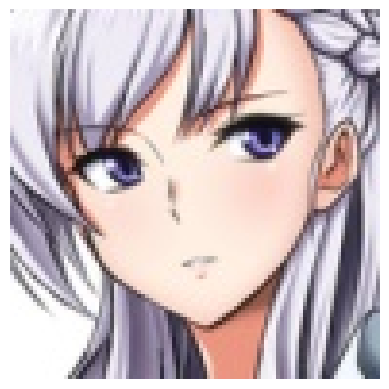

True Label: belfast_(azur_lane)
This image is likely belongs to:
> belfast_(azur_lane) : 24.47 % confidence.
> atago_(azur_lane) : 5.16 % confidence.
> sakurajima_mai : 3.40 % confidence.
> sakurauchi_riko : 3.10 % confidence.
> tsushima_yoshiko : 2.75 % confidence.


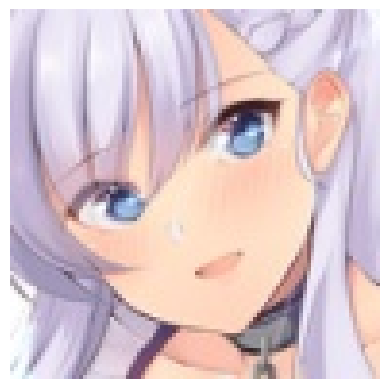

True Label: belfast_(azur_lane)
This image is likely belongs to:
> belfast_(azur_lane) : 20.70 % confidence.
> chloe_von_einzbern : 5.58 % confidence.
> aqua_(konosuba) : 4.74 % confidence.
> usada_pekora : 3.80 % confidence.
> hatsune_miku : 3.76 % confidence.


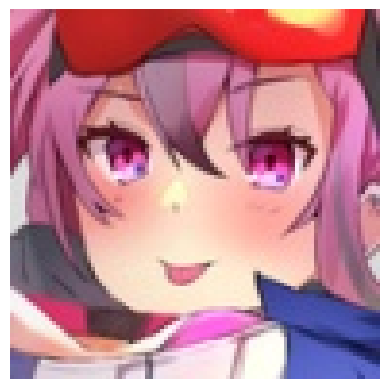

True Label: bremerton_(azur_lane)
This image is likely belongs to:
> platelet_(hataraku_saibou) : 13.43 % confidence.
> ookami_mio : 10.32 % confidence.
> mei_(pokemon) : 10.17 % confidence.
> sakurauchi_riko : 3.95 % confidence.
> d.va_(overwatch) : 3.91 % confidence.


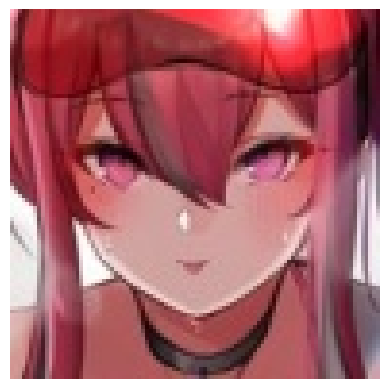

True Label: bremerton_(azur_lane)
This image is likely belongs to:
> bremerton_(azur_lane) : 28.80 % confidence.
> mori_calliope : 5.49 % confidence.
> shishiro_botan : 4.29 % confidence.
> sinon : 2.45 % confidence.
> karna_(fate) : 2.04 % confidence.


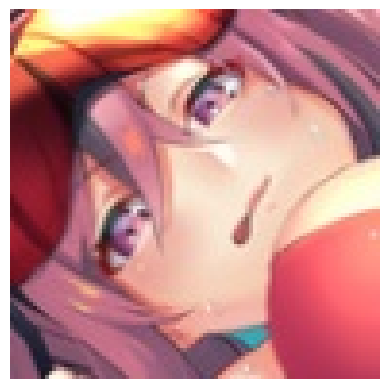

True Label: bremerton_(azur_lane)
This image is likely belongs to:
> nakano_miku : 18.99 % confidence.
> nishikino_maki : 8.61 % confidence.
> abigail_williams_(fate) : 5.24 % confidence.
> takamaki_anne : 5.02 % confidence.
> shuten_douji_(fate) : 3.59 % confidence.


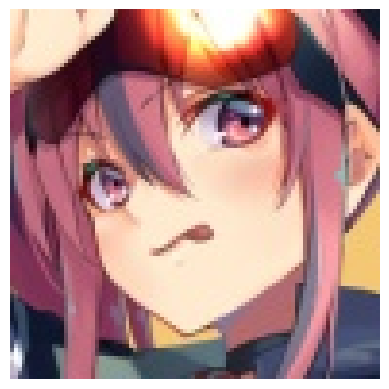

True Label: bremerton_(azur_lane)
This image is likely belongs to:
> sakurauchi_riko : 21.63 % confidence.
> bremerton_(azur_lane) : 19.21 % confidence.
> mei_(pokemon) : 8.05 % confidence.
> aegis_(persona) : 2.37 % confidence.
> hayasaka_ai : 1.86 % confidence.


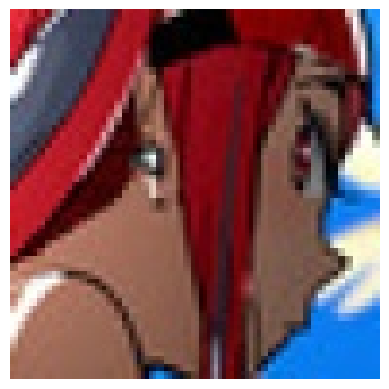

True Label: bremerton_(azur_lane)
This image is likely belongs to:
> albedo : 31.76 % confidence.
> takanashi_rikka : 12.50 % confidence.
> nakano_miku : 9.19 % confidence.
> souryuu_asuka_langley : 5.21 % confidence.
> utsumi_erise : 3.88 % confidence.


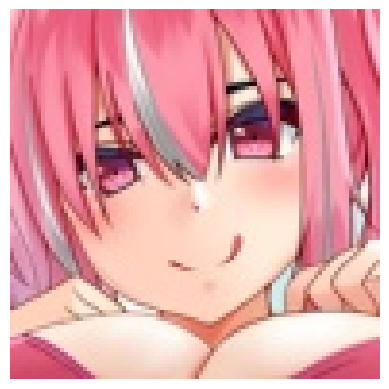

True Label: bremerton_(azur_lane)
This image is likely belongs to:
> bremerton_(azur_lane) : 10.69 % confidence.
> laffey_(azur_lane) : 6.19 % confidence.
> unicorn_(azur_lane) : 4.97 % confidence.
> kaname_madoka : 3.28 % confidence.
> ninomae_ina'nis : 2.55 % confidence.


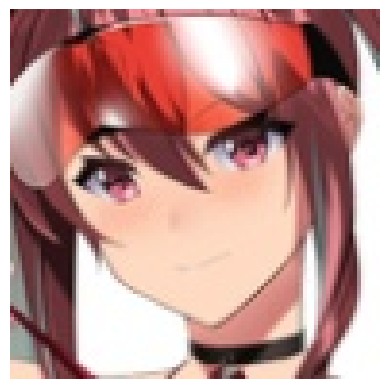

True Label: bremerton_(azur_lane)
This image is likely belongs to:
> bremerton_(azur_lane) : 17.37 % confidence.
> mei_(pokemon) : 6.91 % confidence.
> ookami_mio : 5.47 % confidence.
> megumin : 5.37 % confidence.
> sengoku_nadeko : 3.42 % confidence.


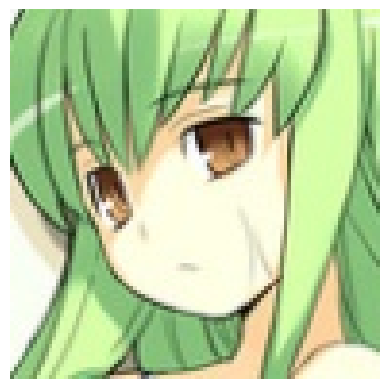

True Label: c.c
This image is likely belongs to:
> c.c : 11.17 % confidence.
> nakano_yotsuba : 10.23 % confidence.
> satonaka_chie : 6.94 % confidence.
> unicorn_(azur_lane) : 3.60 % confidence.
> laffey_(azur_lane) : 2.93 % confidence.


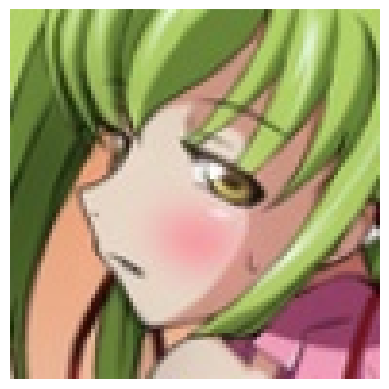

True Label: c.c
This image is likely belongs to:
> asia_argento : 6.47 % confidence.
> tokoyami_towa : 6.28 % confidence.
> nakano_itsuki : 5.99 % confidence.
> mash_kyrielight : 4.27 % confidence.
> yui_(angel_beats!) : 4.18 % confidence.


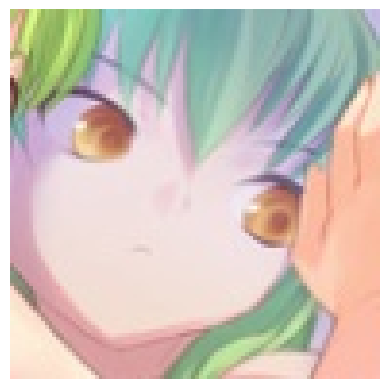

True Label: c.c
This image is likely belongs to:
> c.c : 17.01 % confidence.
> meltlilith : 4.45 % confidence.
> st_ar-15_(girls_frontline) : 4.17 % confidence.
> lancer : 3.88 % confidence.
> sinon : 3.86 % confidence.


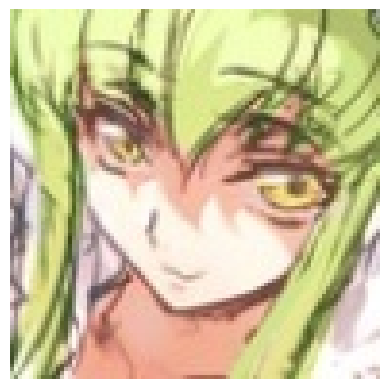

True Label: c.c
This image is likely belongs to:
> c.c : 19.65 % confidence.
> shirogane_naoto : 5.59 % confidence.
> karna_(fate) : 5.47 % confidence.
> okita_souji_(fate) : 3.26 % confidence.
> gilgamesh : 3.07 % confidence.


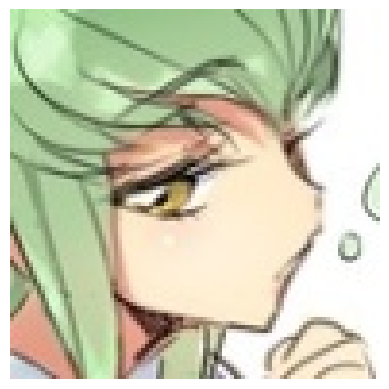

True Label: c.c
This image is likely belongs to:
> c.c : 32.92 % confidence.
> lancer : 8.79 % confidence.
> jonathan_joestar : 5.11 % confidence.
> nico_robin : 5.05 % confidence.
> giorno_giovanna : 4.01 % confidence.


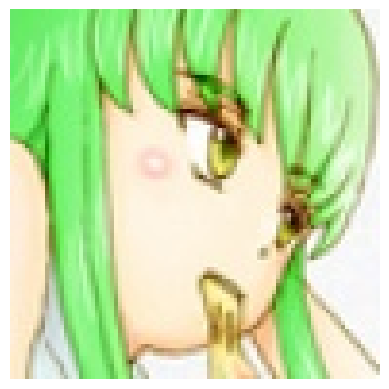

True Label: c.c
This image is likely belongs to:
> c.c : 26.91 % confidence.
> mori_calliope : 5.94 % confidence.
> usada_pekora : 5.29 % confidence.
> zero_two_(darling_in_the_franxx) : 5.21 % confidence.
> nakano_nino : 3.53 % confidence.


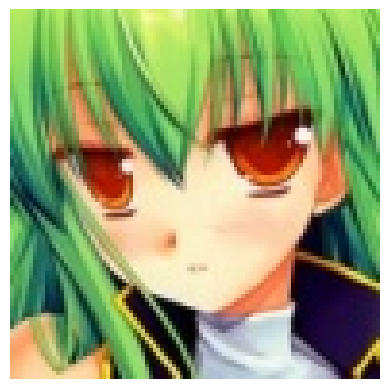

True Label: c.c
This image is likely belongs to:
> gilgamesh : 19.31 % confidence.
> c.c : 14.76 % confidence.
> fujibayashi_kyou : 3.35 % confidence.
> meltlilith : 3.15 % confidence.
> shirogane_noel : 3.05 % confidence.


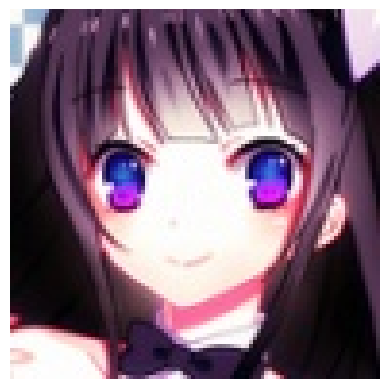

True Label: chitanda_eru
This image is likely belongs to:
> shibuya_rin : 32.29 % confidence.
> takarada_rikka : 5.94 % confidence.
> takimoto_hifumi : 3.81 % confidence.
> utsumi_erise : 3.27 % confidence.
> kizuna_ai : 3.22 % confidence.


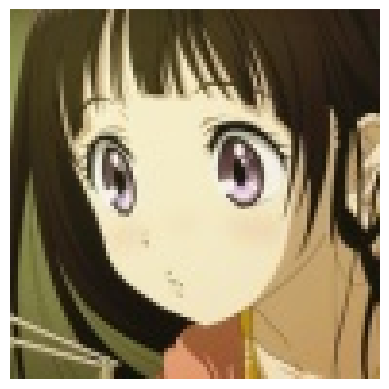

True Label: chitanda_eru
This image is likely belongs to:
> chitanda_eru : 21.01 % confidence.
> yukinoshita_yukino : 12.09 % confidence.
> tsushima_yoshiko : 5.32 % confidence.
> ishtar_(fate_grand_order) : 4.41 % confidence.
> toosaka_rin : 3.33 % confidence.


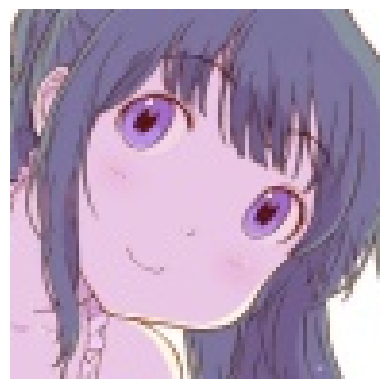

True Label: chitanda_eru
This image is likely belongs to:
> satonaka_chie : 9.36 % confidence.
> takarada_rikka : 6.70 % confidence.
> chitanda_eru : 5.47 % confidence.
> toujou_nozomi : 4.51 % confidence.
> kaname_madoka : 2.94 % confidence.


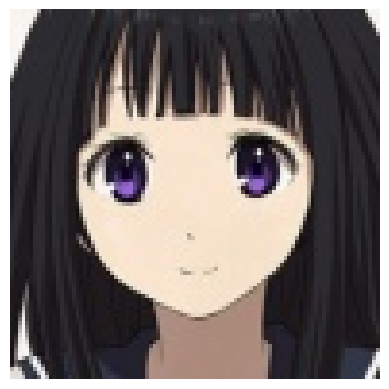

True Label: chitanda_eru
This image is likely belongs to:
> chitanda_eru : 50.21 % confidence.
> takarada_rikka : 14.18 % confidence.
> fujibayashi_kyou : 2.46 % confidence.
> ninomae_ina'nis : 2.40 % confidence.
> kizuna_ai : 2.22 % confidence.


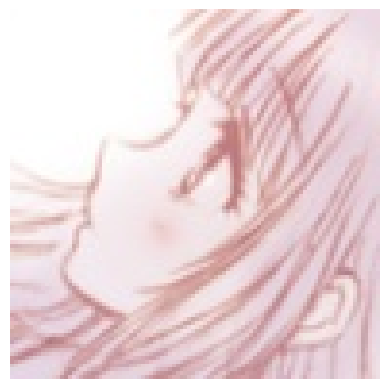

True Label: chitanda_eru
This image is likely belongs to:
> mash_kyrielight : 4.50 % confidence.
> kaname_madoka : 4.13 % confidence.
> fubuki_(one-punch_man) : 3.30 % confidence.
> nagato_yuki : 3.10 % confidence.
> mori_calliope : 2.73 % confidence.


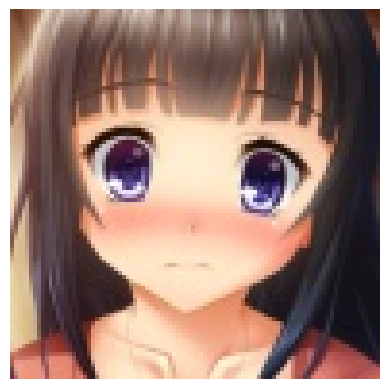

True Label: chitanda_eru
This image is likely belongs to:
> megumin : 15.41 % confidence.
> sakurajima_mai : 10.87 % confidence.
> chitanda_eru : 7.46 % confidence.
> kizuna_ai : 5.33 % confidence.
> yukinoshita_yukino : 4.55 % confidence.


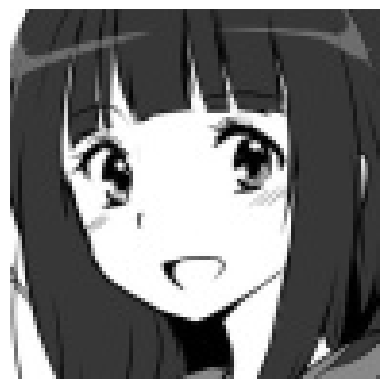

True Label: chitanda_eru
This image is likely belongs to:
> ninomae_ina'nis : 28.35 % confidence.
> tsushima_yoshiko : 7.19 % confidence.
> takagi-san : 5.45 % confidence.
> hyuuga_hinata : 5.18 % confidence.
> gawr_gura : 2.68 % confidence.


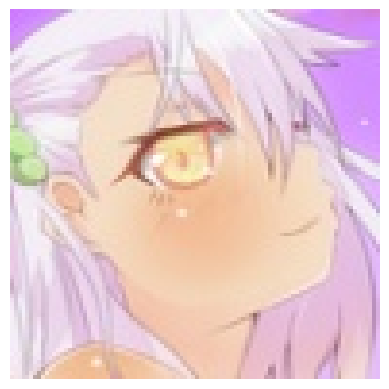

True Label: chloe_von_einzbern
This image is likely belongs to:
> enterprise_(azur_lane) : 5.78 % confidence.
> unicorn_(azur_lane) : 4.58 % confidence.
> laffey_(azur_lane) : 3.96 % confidence.
> kaname_madoka : 3.94 % confidence.
> meltlilith : 3.42 % confidence.


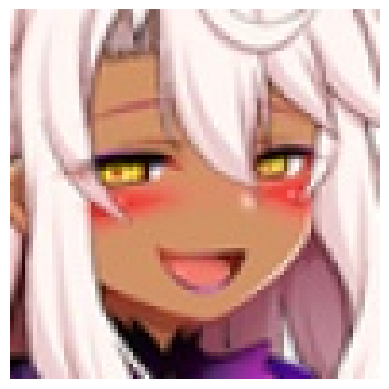

True Label: chloe_von_einzbern
This image is likely belongs to:
> shirakami_fubuki : 6.75 % confidence.
> chloe_von_einzbern : 6.51 % confidence.
> ouro_kronii : 5.80 % confidence.
> gawr_gura : 5.62 % confidence.
> shishiro_botan : 4.00 % confidence.


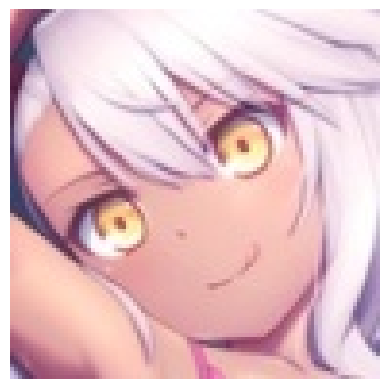

True Label: chloe_von_einzbern
This image is likely belongs to:
> chloe_von_einzbern : 13.28 % confidence.
> nishikino_maki : 9.58 % confidence.
> fujiwara_chika : 4.96 % confidence.
> sinon : 2.88 % confidence.
> takamaki_anne : 2.48 % confidence.


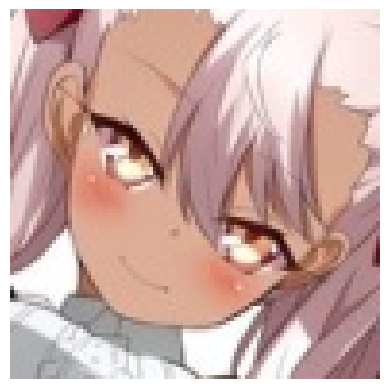

True Label: chloe_von_einzbern
This image is likely belongs to:
> chloe_von_einzbern : 15.43 % confidence.
> albedo : 6.00 % confidence.
> matou_sakura : 3.35 % confidence.
> sinon : 3.28 % confidence.
> shishiro_botan : 2.97 % confidence.


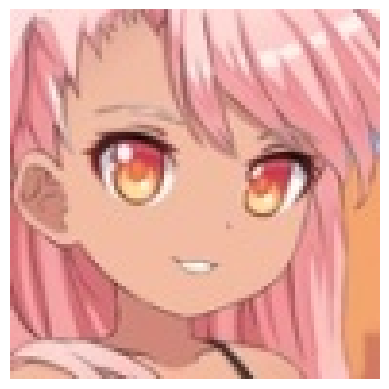

True Label: chloe_von_einzbern
This image is likely belongs to:
> chloe_von_einzbern : 15.15 % confidence.
> yuigahama_yui : 9.11 % confidence.
> fujiwara_chika : 6.07 % confidence.
> miyazono_kawori : 5.66 % confidence.
> suzuhara_lulu : 5.29 % confidence.


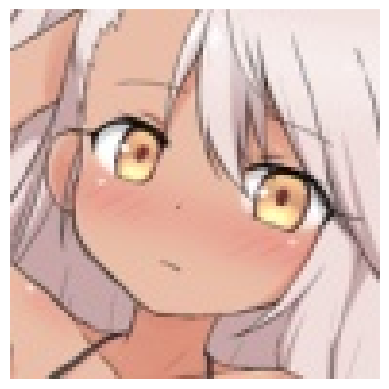

True Label: chloe_von_einzbern
This image is likely belongs to:
> belfast_(azur_lane) : 12.59 % confidence.
> unicorn_(azur_lane) : 11.54 % confidence.
> usada_pekora : 7.88 % confidence.
> chloe_von_einzbern : 6.95 % confidence.
> nakano_yotsuba : 3.28 % confidence.


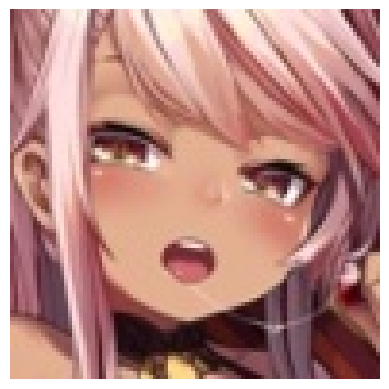

True Label: chloe_von_einzbern
This image is likely belongs to:
> yuigahama_yui : 7.71 % confidence.
> shidare_hotaru : 4.51 % confidence.
> shirogane_noel : 4.30 % confidence.
> chloe_von_einzbern : 3.63 % confidence.
> mori_calliope : 2.79 % confidence.


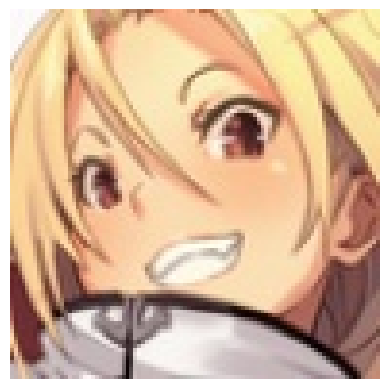

True Label: cleveland_(azur_lane)
This image is likely belongs to:
> sinon : 16.18 % confidence.
> aegis_(persona) : 13.82 % confidence.
> satonaka_chie : 8.01 % confidence.
> hatsune_miku : 5.70 % confidence.
> astolfo_(fate) : 3.68 % confidence.


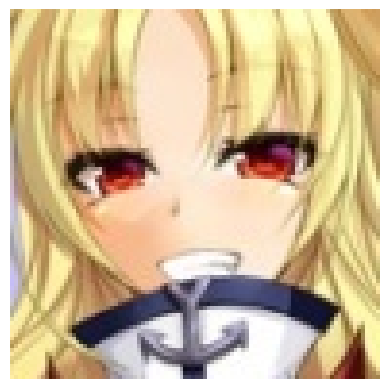

True Label: cleveland_(azur_lane)
This image is likely belongs to:
> cleveland_(azur_lane) : 12.11 % confidence.
> raphtalia : 7.15 % confidence.
> oshino_shinobu : 6.98 % confidence.
> nekomata_okayu : 4.80 % confidence.
> shishiro_botan : 3.50 % confidence.


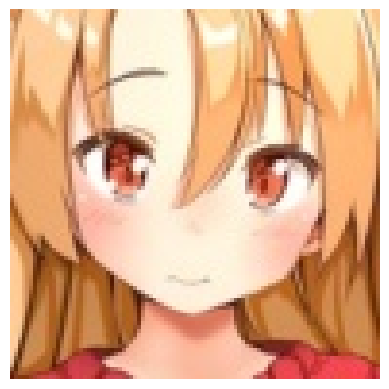

True Label: cleveland_(azur_lane)
This image is likely belongs to:
> cleveland_(azur_lane) : 17.88 % confidence.
> miyazono_kawori : 7.91 % confidence.
> arcueid_brunestud : 4.09 % confidence.
> illyasviel_von_einzbern : 3.91 % confidence.
> nami_(one_piece) : 3.56 % confidence.


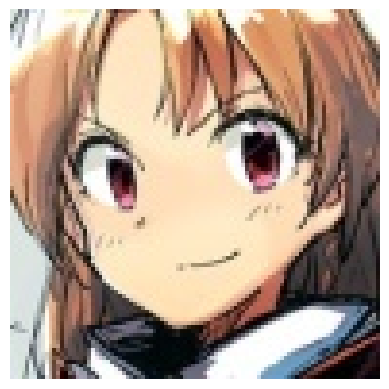

True Label: cleveland_(azur_lane)
This image is likely belongs to:
> misaka_mikoto : 9.06 % confidence.
> isshiki_iroha : 7.44 % confidence.
> asuna_(sao) : 6.02 % confidence.
> hirasawa_yui : 5.40 % confidence.
> ninomae_ina'nis : 5.17 % confidence.


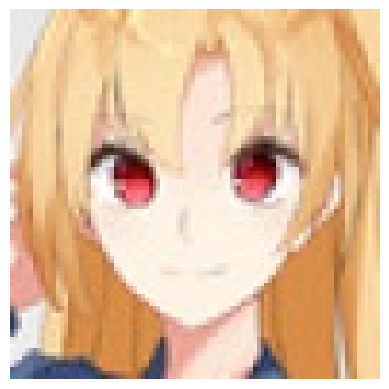

True Label: cleveland_(azur_lane)
This image is likely belongs to:
> cleveland_(azur_lane) : 28.27 % confidence.
> asuna_(sao) : 12.59 % confidence.
> platelet_(hataraku_saibou) : 12.20 % confidence.
> raphtalia : 11.44 % confidence.
> kiryu_coco : 6.92 % confidence.


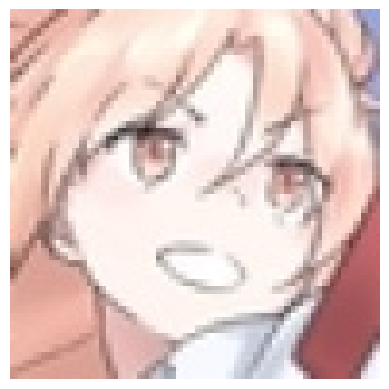

True Label: cleveland_(azur_lane)
This image is likely belongs to:
> astolfo_(fate) : 14.42 % confidence.
> hatsune_miku : 7.12 % confidence.
> suzumiya_haruhi : 6.26 % confidence.
> aqua_(konosuba) : 5.45 % confidence.
> rias_gremory : 5.30 % confidence.


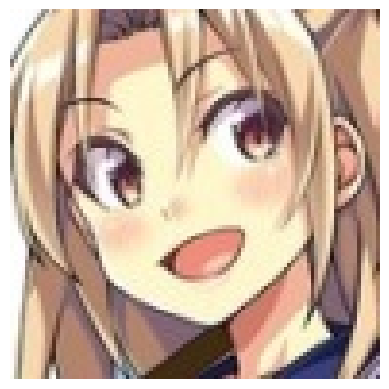

True Label: cleveland_(azur_lane)
This image is likely belongs to:
> shishiro_botan : 11.63 % confidence.
> cleveland_(azur_lane) : 9.03 % confidence.
> platelet_(hataraku_saibou) : 8.86 % confidence.
> asuna_(sao) : 5.15 % confidence.
> super_sonico : 4.88 % confidence.


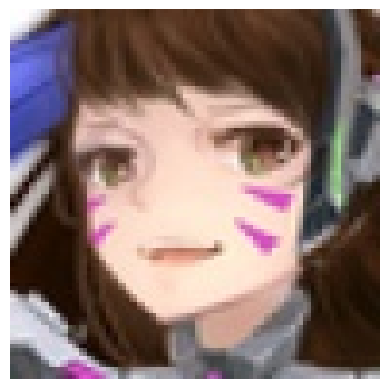

True Label: d.va_(overwatch)
This image is likely belongs to:
> d.va_(overwatch) : 56.51 % confidence.
> atago_(azur_lane) : 2.76 % confidence.
> shinomiya_kaguya : 2.17 % confidence.
> yukinoshita_yukino : 2.13 % confidence.
> ishtar_(fate_grand_order) : 2.12 % confidence.


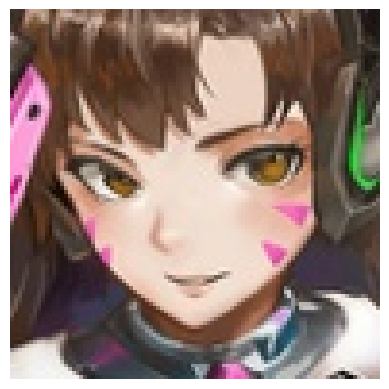

True Label: d.va_(overwatch)
This image is likely belongs to:
> d.va_(overwatch) : 51.82 % confidence.
> tsushima_yoshiko : 13.26 % confidence.
> satonaka_chie : 3.69 % confidence.
> nakano_azusa : 3.34 % confidence.
> ishtar_(fate_grand_order) : 2.44 % confidence.


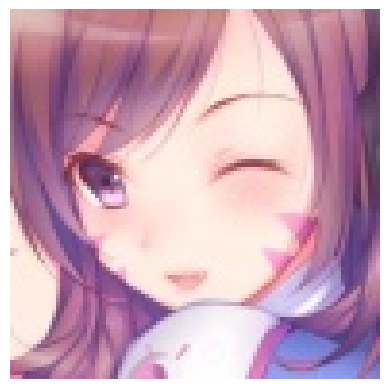

True Label: d.va_(overwatch)
This image is likely belongs to:
> kochou_shinobu : 8.40 % confidence.
> anastasia_(idolmaster) : 6.88 % confidence.
> emilia_rezero : 3.58 % confidence.
> chitanda_eru : 3.41 % confidence.
> unicorn_(azur_lane) : 3.38 % confidence.


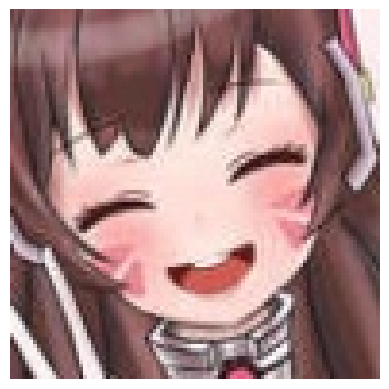

True Label: d.va_(overwatch)
This image is likely belongs to:
> gawr_gura : 12.19 % confidence.
> raphtalia : 7.94 % confidence.
> d.va_(overwatch) : 6.92 % confidence.
> tsushima_yoshiko : 5.50 % confidence.
> asuna_(sao) : 4.25 % confidence.


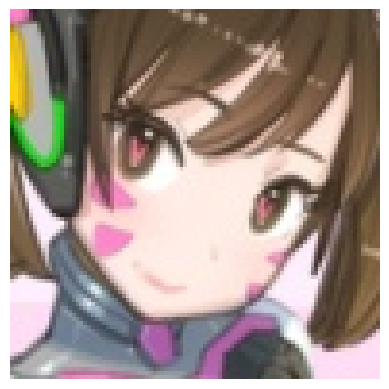

True Label: d.va_(overwatch)
This image is likely belongs to:
> toujou_nozomi : 8.69 % confidence.
> suzumiya_haruhi : 8.51 % confidence.
> nekomata_okayu : 7.15 % confidence.
> hanekawa_tsubasa : 5.25 % confidence.
> kizuna_ai : 4.36 % confidence.


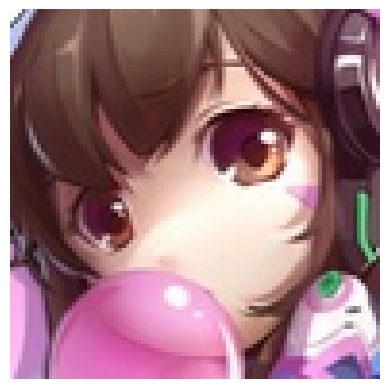

True Label: d.va_(overwatch)
This image is likely belongs to:
> ishtar_(fate_grand_order) : 19.80 % confidence.
> d.va_(overwatch) : 5.84 % confidence.
> tokoyami_towa : 4.58 % confidence.
> shinomiya_kaguya : 3.61 % confidence.
> super_sonico : 3.54 % confidence.


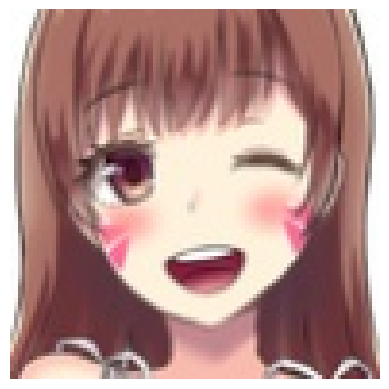

True Label: d.va_(overwatch)
This image is likely belongs to:
> tsushima_yoshiko : 10.09 % confidence.
> d.va_(overwatch) : 8.61 % confidence.
> shinomiya_kaguya : 7.60 % confidence.
> gawr_gura : 4.46 % confidence.
> takarada_rikka : 3.87 % confidence.


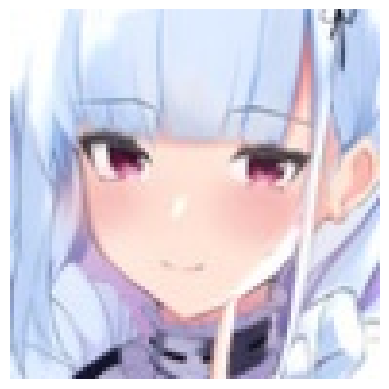

True Label: dido_(azur_lane)
This image is likely belongs to:
> dido_(azur_lane) : 77.19 % confidence.
> formidable_(azur_lane) : 10.81 % confidence.
> takimoto_hifumi : 2.85 % confidence.
> belfast_(azur_lane) : 2.25 % confidence.
> megumin : 0.62 % confidence.


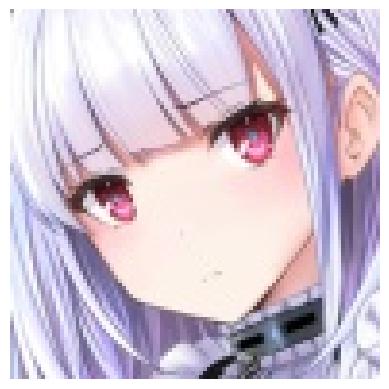

True Label: dido_(azur_lane)
This image is likely belongs to:
> dido_(azur_lane) : 28.40 % confidence.
> emilia_rezero : 7.20 % confidence.
> shinomiya_kaguya : 6.44 % confidence.
> shirogane_noel : 3.29 % confidence.
> enterprise_(azur_lane) : 2.23 % confidence.


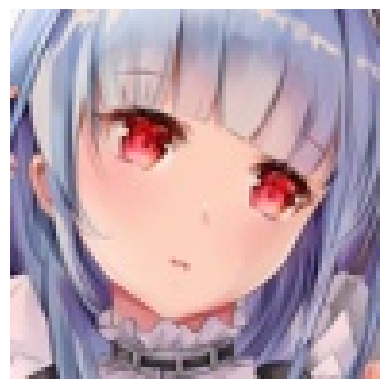

True Label: dido_(azur_lane)
This image is likely belongs to:
> dido_(azur_lane) : 71.22 % confidence.
> shirogane_noel : 16.57 % confidence.
> nekomata_okayu : 5.45 % confidence.
> karin_(blue_archive) : 0.74 % confidence.
> formidable_(azur_lane) : 0.70 % confidence.


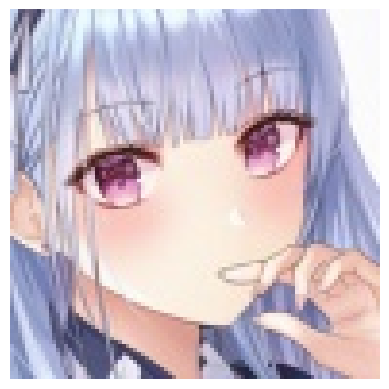

True Label: dido_(azur_lane)
This image is likely belongs to:
> formidable_(azur_lane) : 13.40 % confidence.
> shinomiya_kaguya : 10.78 % confidence.
> dido_(azur_lane) : 10.38 % confidence.
> gilgamesh : 5.77 % confidence.
> emilia_rezero : 5.38 % confidence.


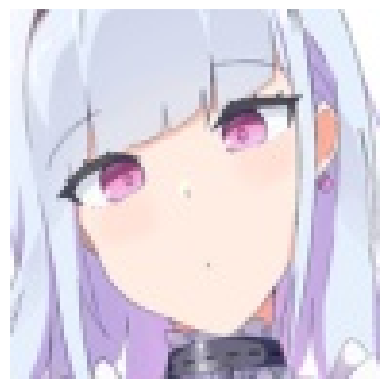

True Label: dido_(azur_lane)
This image is likely belongs to:
> dido_(azur_lane) : 20.05 % confidence.
> abigail_williams_(fate) : 14.05 % confidence.
> emilia_rezero : 5.66 % confidence.
> shibuya_rin : 4.44 % confidence.
> utsumi_erise : 4.25 % confidence.


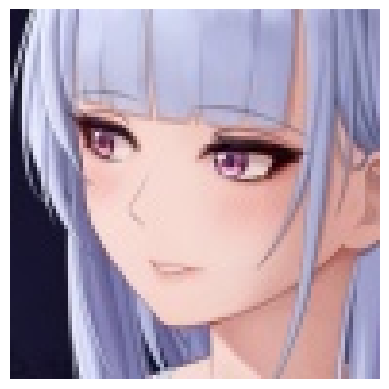

True Label: dido_(azur_lane)
This image is likely belongs to:
> nico_robin : 14.71 % confidence.
> platelet_(hataraku_saibou) : 9.25 % confidence.
> dido_(azur_lane) : 8.39 % confidence.
> sakura_futaba : 6.11 % confidence.
> komi_shouko : 4.83 % confidence.


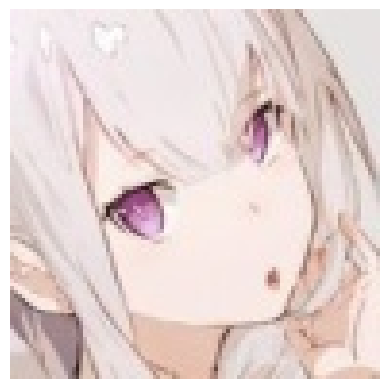

True Label: emilia_rezero
This image is likely belongs to:
> emilia_rezero : 24.59 % confidence.
> shirogane_noel : 4.56 % confidence.
> mash_kyrielight : 4.28 % confidence.
> laffey_(azur_lane) : 4.19 % confidence.
> nekomata_okayu : 4.16 % confidence.


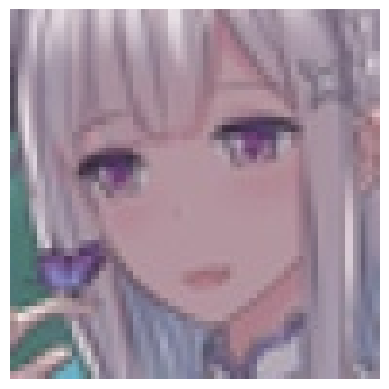

True Label: emilia_rezero
This image is likely belongs to:
> emilia_rezero : 30.95 % confidence.
> fujibayashi_kyou : 8.70 % confidence.
> dido_(azur_lane) : 4.81 % confidence.
> oshino_shinobu : 3.66 % confidence.
> enterprise_(azur_lane) : 3.07 % confidence.


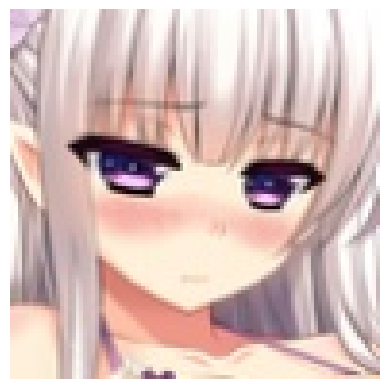

True Label: emilia_rezero
This image is likely belongs to:
> nekomata_okayu : 11.41 % confidence.
> utsumi_erise : 7.23 % confidence.
> nakano_nino : 5.67 % confidence.
> takimoto_hifumi : 4.84 % confidence.
> komi_shouko : 4.80 % confidence.


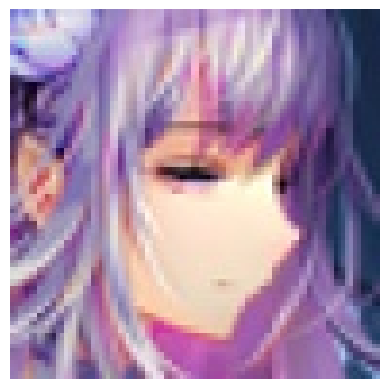

True Label: emilia_rezero
This image is likely belongs to:
> mori_calliope : 5.85 % confidence.
> st_ar-15_(girls_frontline) : 5.77 % confidence.
> arcueid_brunestud : 5.18 % confidence.
> shibuya_rin : 3.98 % confidence.
> taihou_(azur_lane) : 3.24 % confidence.


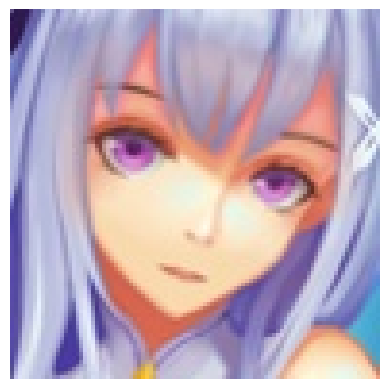

True Label: emilia_rezero
This image is likely belongs to:
> bremerton_(azur_lane) : 4.61 % confidence.
> aqua_(konosuba) : 3.76 % confidence.
> okita_souji_(fate) : 3.53 % confidence.
> unicorn_(azur_lane) : 3.19 % confidence.
> makise_kurisu : 3.18 % confidence.


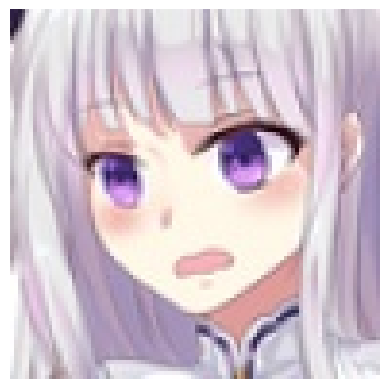

True Label: emilia_rezero
This image is likely belongs to:
> emilia_rezero : 51.50 % confidence.
> shidare_hotaru : 13.03 % confidence.
> fujiwara_chika : 7.66 % confidence.
> ninomae_ina'nis : 3.32 % confidence.
> zero_two_(darling_in_the_franxx) : 2.13 % confidence.


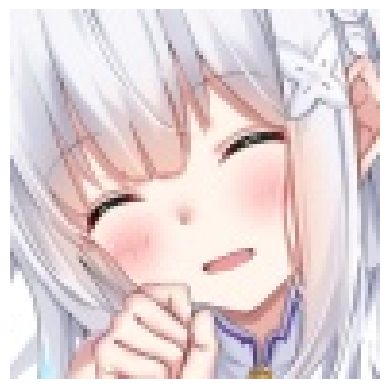

True Label: emilia_rezero
This image is likely belongs to:
> anastasia_(idolmaster) : 11.88 % confidence.
> shirakami_fubuki : 11.81 % confidence.
> shidare_hotaru : 6.26 % confidence.
> fujiwara_chika : 6.08 % confidence.
> laffey_(azur_lane) : 5.20 % confidence.


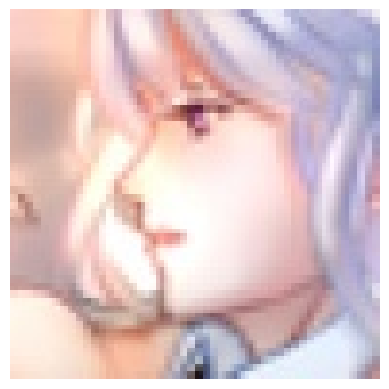

True Label: enterprise_(azur_lane)
This image is likely belongs to:
> laffey_(azur_lane) : 18.71 % confidence.
> ayanami_rei : 7.67 % confidence.
> usada_pekora : 6.02 % confidence.
> belfast_(azur_lane) : 3.09 % confidence.
> keqing_(genshin_impact) : 2.79 % confidence.


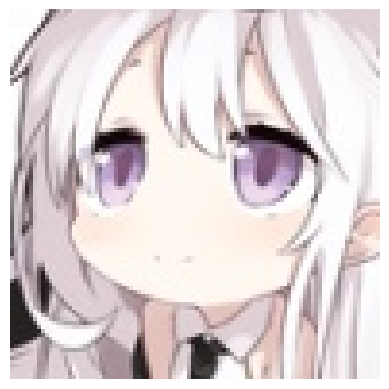

True Label: enterprise_(azur_lane)
This image is likely belongs to:
> enterprise_(azur_lane) : 10.60 % confidence.
> sakurajima_mai : 4.89 % confidence.
> emilia_rezero : 3.88 % confidence.
> unicorn_(azur_lane) : 3.69 % confidence.
> nagato_yuki : 3.19 % confidence.


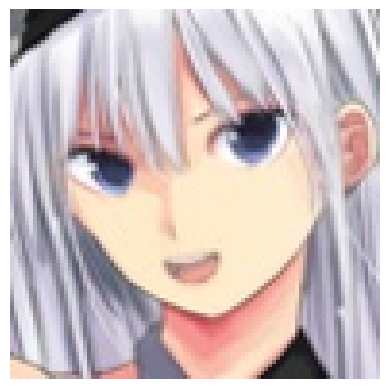

True Label: enterprise_(azur_lane)
This image is likely belongs to:
> gawr_gura : 9.77 % confidence.
> shidare_hotaru : 5.01 % confidence.
> aqua_(konosuba) : 4.21 % confidence.
> emilia_rezero : 3.91 % confidence.
> takarada_rikka : 3.18 % confidence.


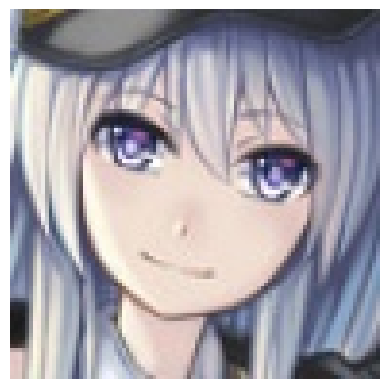

True Label: enterprise_(azur_lane)
This image is likely belongs to:
> belfast_(azur_lane) : 27.69 % confidence.
> enterprise_(azur_lane) : 9.13 % confidence.
> emilia_rezero : 3.31 % confidence.
> takarada_rikka : 2.67 % confidence.
> takamaki_anne : 2.21 % confidence.


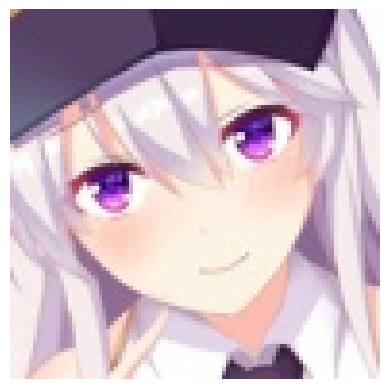

True Label: enterprise_(azur_lane)
This image is likely belongs to:
> emilia_rezero : 37.96 % confidence.
> enterprise_(azur_lane) : 7.05 % confidence.
> hayasaka_ai : 4.26 % confidence.
> ichigo_(darling_in_the_franxx) : 2.99 % confidence.
> fujibayashi_kyou : 2.98 % confidence.


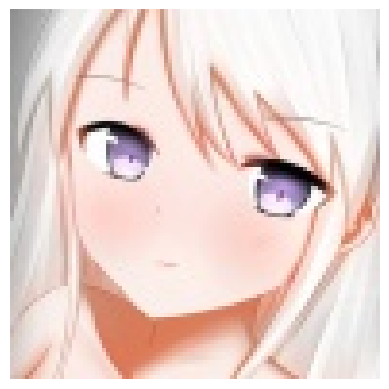

True Label: enterprise_(azur_lane)
This image is likely belongs to:
> emilia_rezero : 17.48 % confidence.
> enterprise_(azur_lane) : 7.08 % confidence.
> yukinoshita_yukino : 6.71 % confidence.
> sakurajima_mai : 3.89 % confidence.
> nakano_nino : 2.52 % confidence.


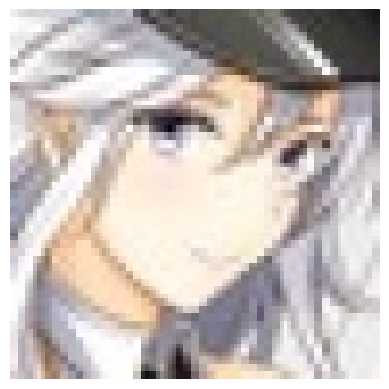

True Label: enterprise_(azur_lane)
This image is likely belongs to:
> atago_(azur_lane) : 13.89 % confidence.
> albedo : 5.74 % confidence.
> kirito : 5.35 % confidence.
> karna_(fate) : 4.85 % confidence.
> takao_(azur_lane) : 4.35 % confidence.


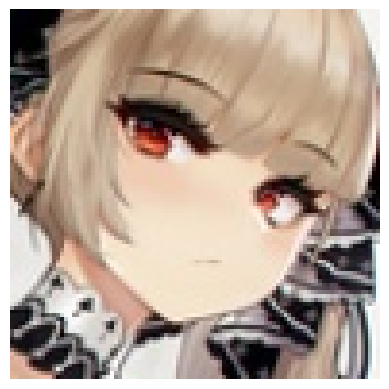

True Label: formidable_(azur_lane)
This image is likely belongs to:
> formidable_(azur_lane) : 59.94 % confidence.
> belfast_(azur_lane) : 3.41 % confidence.
> atago_(azur_lane) : 2.59 % confidence.
> tsushima_yoshiko : 2.49 % confidence.
> misaka_mikoto : 1.85 % confidence.


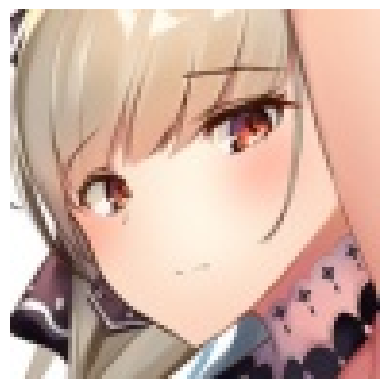

True Label: formidable_(azur_lane)
This image is likely belongs to:
> formidable_(azur_lane) : 36.54 % confidence.
> atago_(azur_lane) : 5.66 % confidence.
> ishtar_(fate_grand_order) : 4.86 % confidence.
> takao_(azur_lane) : 2.59 % confidence.
> belfast_(azur_lane) : 2.09 % confidence.


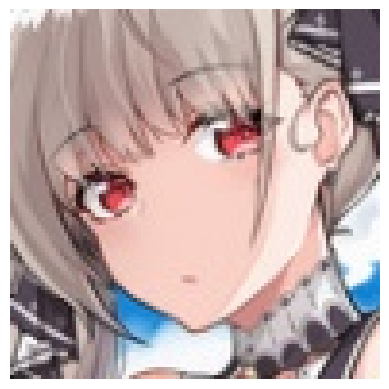

True Label: formidable_(azur_lane)
This image is likely belongs to:
> formidable_(azur_lane) : 64.04 % confidence.
> shirogane_noel : 3.65 % confidence.
> dido_(azur_lane) : 2.58 % confidence.
> ishtar_(fate_grand_order) : 2.36 % confidence.
> atago_(azur_lane) : 2.24 % confidence.


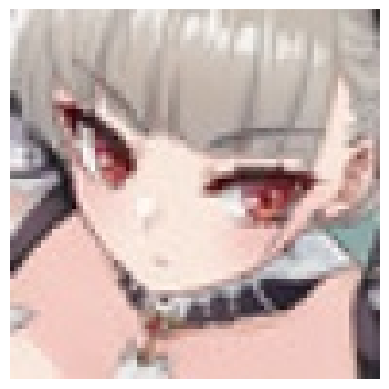

True Label: formidable_(azur_lane)
This image is likely belongs to:
> formidable_(azur_lane) : 40.25 % confidence.
> mori_calliope : 13.05 % confidence.
> komi_shouko : 8.31 % confidence.
> gilgamesh : 4.14 % confidence.
> dido_(azur_lane) : 2.93 % confidence.


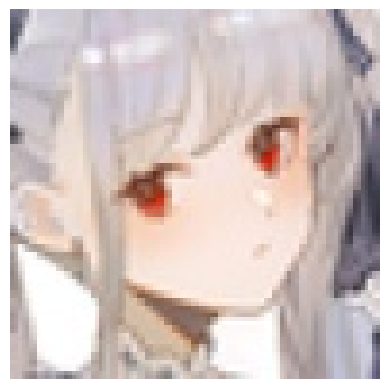

True Label: formidable_(azur_lane)
This image is likely belongs to:
> formidable_(azur_lane) : 37.53 % confidence.
> dido_(azur_lane) : 6.20 % confidence.
> ishtar_(fate_grand_order) : 5.50 % confidence.
> illyasviel_von_einzbern : 4.78 % confidence.
> emilia_rezero : 4.46 % confidence.


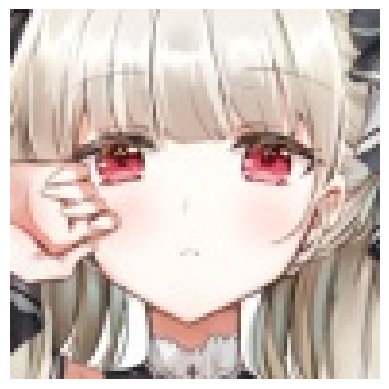

True Label: formidable_(azur_lane)
This image is likely belongs to:
> formidable_(azur_lane) : 45.15 % confidence.
> illyasviel_von_einzbern : 7.62 % confidence.
> dido_(azur_lane) : 4.78 % confidence.
> ishtar_(fate_grand_order) : 3.34 % confidence.
> takimoto_hifumi : 2.04 % confidence.


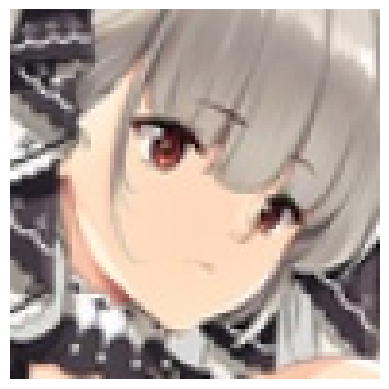

True Label: formidable_(azur_lane)
This image is likely belongs to:
> formidable_(azur_lane) : 11.79 % confidence.
> oshino_shinobu : 10.51 % confidence.
> rem_rezero : 10.11 % confidence.
> ouro_kronii : 6.45 % confidence.
> nakano_yotsuba : 3.01 % confidence.


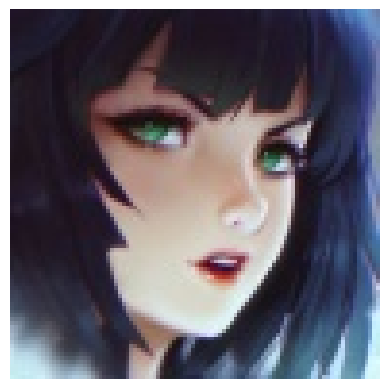

True Label: fubuki_(one-punch_man)
This image is likely belongs to:
> lancer : 7.81 % confidence.
> kochou_shinobu : 5.94 % confidence.
> shidare_hotaru : 5.54 % confidence.
> takarada_rikka : 3.47 % confidence.
> katsuragi_misato : 3.24 % confidence.


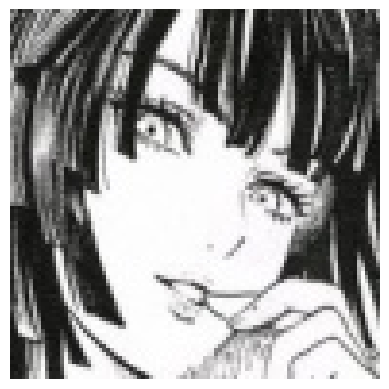

True Label: fubuki_(one-punch_man)
This image is likely belongs to:
> fubuki_(one-punch_man) : 13.07 % confidence.
> kochou_shinobu : 5.27 % confidence.
> senjougahara_hitagi : 4.77 % confidence.
> shirogane_naoto : 3.74 % confidence.
> oshino_ougi : 3.28 % confidence.


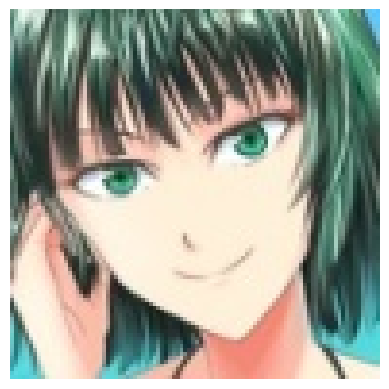

True Label: fubuki_(one-punch_man)
This image is likely belongs to:
> zero_two_(darling_in_the_franxx) : 10.79 % confidence.
> kizuna_ai : 6.84 % confidence.
> yukinoshita_yukino : 6.63 % confidence.
> takimoto_hifumi : 4.82 % confidence.
> komi_shouko : 4.10 % confidence.


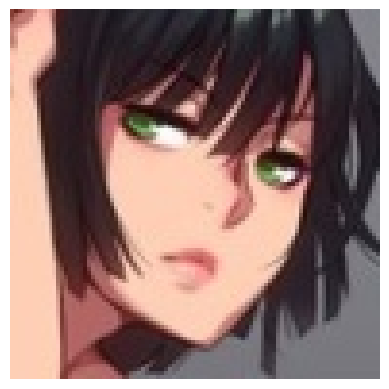

True Label: fubuki_(one-punch_man)
This image is likely belongs to:
> fubuki_(one-punch_man) : 26.82 % confidence.
> nico_robin : 6.58 % confidence.
> ookami_mio : 5.11 % confidence.
> kanbaru_suruga : 4.79 % confidence.
> taihou_(azur_lane) : 4.57 % confidence.


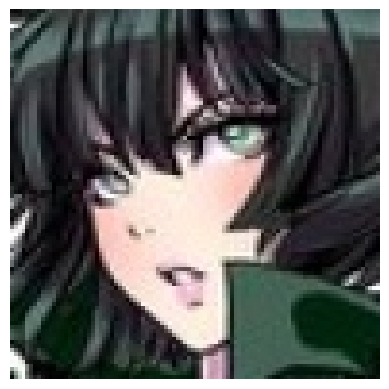

True Label: fubuki_(one-punch_man)
This image is likely belongs to:
> oshino_ougi : 12.95 % confidence.
> waver_velvet : 7.19 % confidence.
> fubuki_(one-punch_man) : 5.79 % confidence.
> fujibayashi_kyou : 4.91 % confidence.
> kochou_shinobu : 3.74 % confidence.


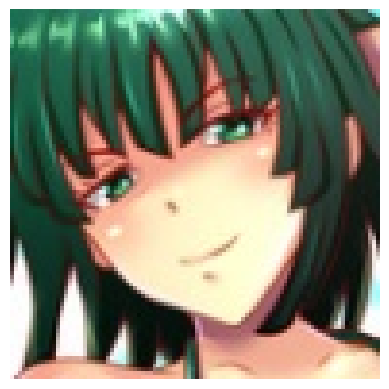

True Label: fubuki_(one-punch_man)
This image is likely belongs to:
> fubuki_(one-punch_man) : 13.43 % confidence.
> takao_(azur_lane) : 7.23 % confidence.
> hyuuga_hinata : 5.80 % confidence.
> chitanda_eru : 5.38 % confidence.
> oshino_ougi : 3.97 % confidence.


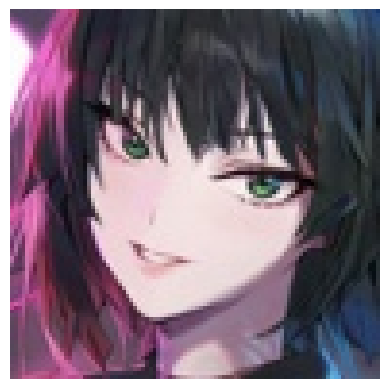

True Label: fubuki_(one-punch_man)
This image is likely belongs to:
> fubuki_(one-punch_man) : 22.53 % confidence.
> ryougi_shiki : 17.61 % confidence.
> ouro_kronii : 3.44 % confidence.
> shuten_douji_(fate) : 2.78 % confidence.
> oshino_ougi : 2.56 % confidence.


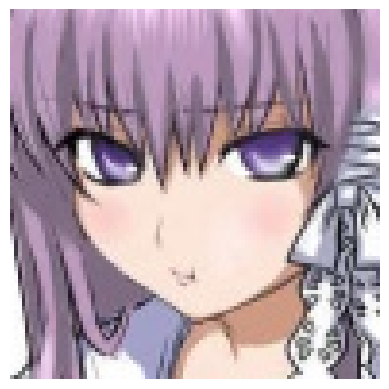

True Label: fujibayashi_kyou
This image is likely belongs to:
> fujibayashi_kyou : 8.95 % confidence.
> matou_sakura : 5.01 % confidence.
> c.c : 4.65 % confidence.
> belfast_(azur_lane) : 3.59 % confidence.
> st_ar-15_(girls_frontline) : 3.48 % confidence.


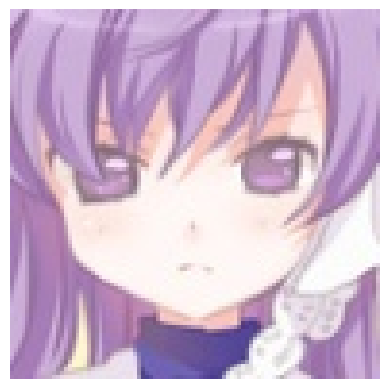

True Label: fujibayashi_kyou
This image is likely belongs to:
> kaname_madoka : 5.46 % confidence.
> meltlilith : 5.40 % confidence.
> tokoyami_towa : 4.80 % confidence.
> matou_sakura : 4.33 % confidence.
> mash_kyrielight : 3.73 % confidence.


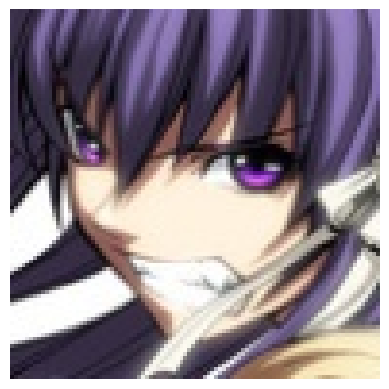

True Label: fujibayashi_kyou
This image is likely belongs to:
> nagato_yuki : 8.82 % confidence.
> meltlilith : 5.72 % confidence.
> satonaka_chie : 5.41 % confidence.
> fujibayashi_kyou : 4.25 % confidence.
> nekomata_okayu : 3.92 % confidence.


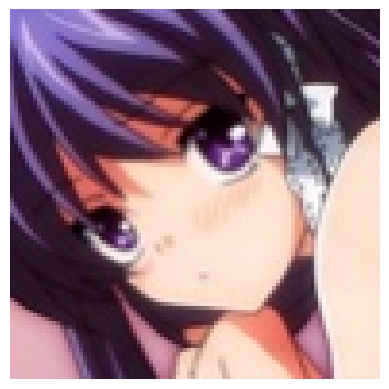

True Label: fujibayashi_kyou
This image is likely belongs to:
> fujibayashi_kyou : 18.92 % confidence.
> sakurajima_mai : 6.43 % confidence.
> furukawa_nagisa : 5.19 % confidence.
> rias_gremory : 5.18 % confidence.
> xenovia_(high_school_dxd) : 3.56 % confidence.


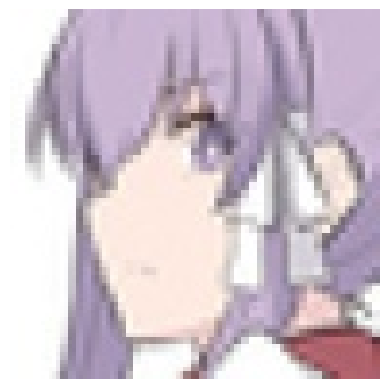

True Label: fujibayashi_kyou
This image is likely belongs to:
> katsuragi_misato : 8.17 % confidence.
> fujibayashi_kyou : 7.52 % confidence.
> ryougi_shiki : 7.50 % confidence.
> ayanami_rei : 6.78 % confidence.
> nagato_yuki : 6.09 % confidence.


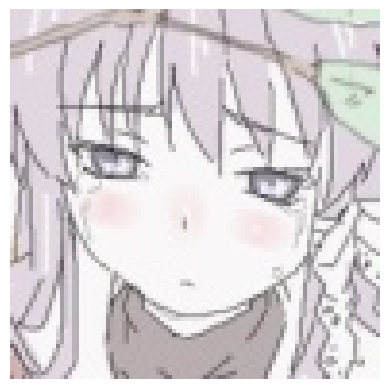

True Label: fujibayashi_kyou
This image is likely belongs to:
> anastasia_(idolmaster) : 8.22 % confidence.
> suzuhara_lulu : 6.51 % confidence.
> takimoto_hifumi : 4.94 % confidence.
> emilia_rezero : 4.67 % confidence.
> aisaka_taiga : 3.97 % confidence.


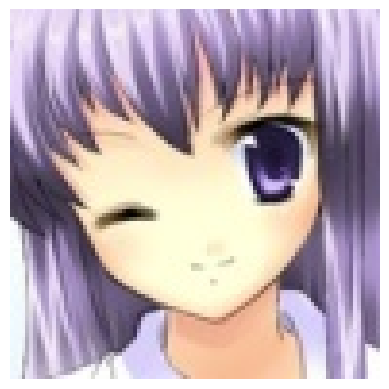

True Label: fujibayashi_kyou
This image is likely belongs to:
> matou_sakura : 10.96 % confidence.
> takarada_rikka : 6.86 % confidence.
> fujibayashi_kyou : 6.53 % confidence.
> belfast_(azur_lane) : 4.98 % confidence.
> tsushima_yoshiko : 4.87 % confidence.


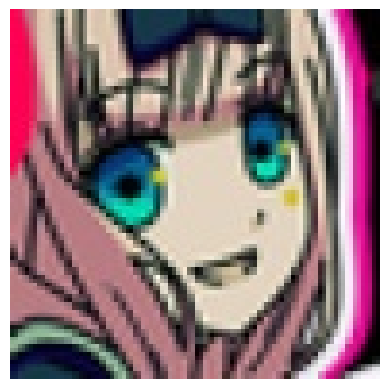

True Label: fujiwara_chika
This image is likely belongs to:
> fujiwara_chika : 40.18 % confidence.
> shibuya_rin : 2.56 % confidence.
> rider : 2.53 % confidence.
> gawr_gura : 2.24 % confidence.
> shirakami_fubuki : 2.22 % confidence.


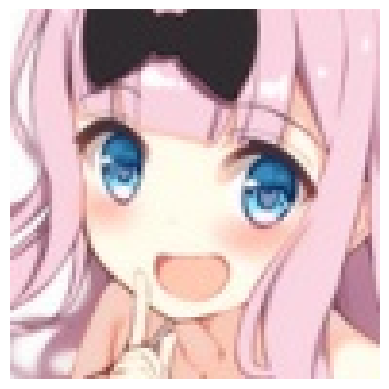

True Label: fujiwara_chika
This image is likely belongs to:
> fujiwara_chika : 44.64 % confidence.
> kizuna_ai : 4.36 % confidence.
> suzuhara_lulu : 3.03 % confidence.
> super_sonico : 2.83 % confidence.
> unicorn_(azur_lane) : 2.51 % confidence.


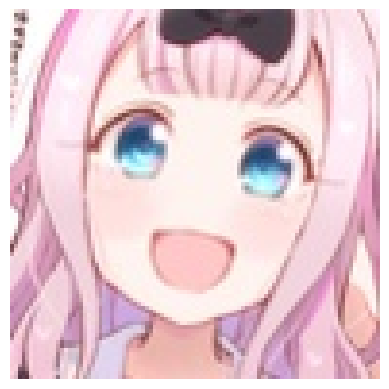

True Label: fujiwara_chika
This image is likely belongs to:
> fujiwara_chika : 43.11 % confidence.
> suzuhara_lulu : 14.92 % confidence.
> kizuna_ai : 6.84 % confidence.
> nakano_nino : 1.87 % confidence.
> nakano_yotsuba : 1.78 % confidence.


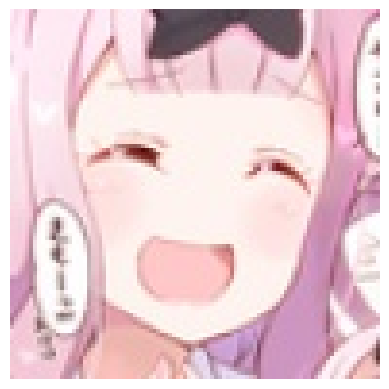

True Label: fujiwara_chika
This image is likely belongs to:
> fujiwara_chika : 19.72 % confidence.
> kochou_shinobu : 8.26 % confidence.
> shidare_hotaru : 5.61 % confidence.
> suzuhara_lulu : 5.21 % confidence.
> kaname_madoka : 3.82 % confidence.


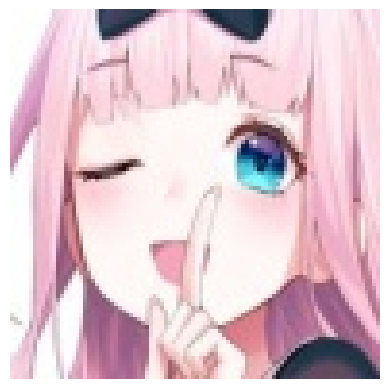

True Label: fujiwara_chika
This image is likely belongs to:
> fujiwara_chika : 24.71 % confidence.
> suzuhara_lulu : 6.88 % confidence.
> zero_two_(darling_in_the_franxx) : 5.10 % confidence.
> nakano_itsuki : 4.28 % confidence.
> st_ar-15_(girls_frontline) : 3.74 % confidence.


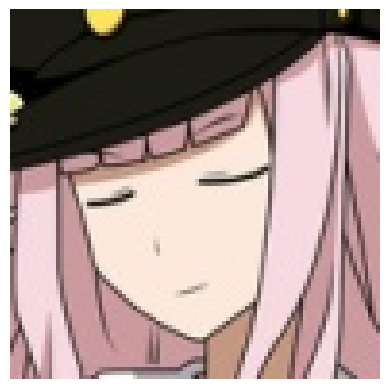

True Label: fujiwara_chika
This image is likely belongs to:
> albedo : 12.36 % confidence.
> enterprise_(azur_lane) : 7.66 % confidence.
> semiramis_(fate) : 6.71 % confidence.
> giorno_giovanna : 3.35 % confidence.
> shirogane_naoto : 2.99 % confidence.


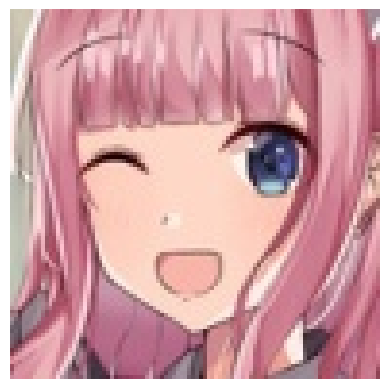

True Label: fujiwara_chika
This image is likely belongs to:
> fujiwara_chika : 47.76 % confidence.
> nakano_nino : 3.16 % confidence.
> shirogane_noel : 2.86 % confidence.
> nekomata_okayu : 2.62 % confidence.
> gawr_gura : 2.51 % confidence.


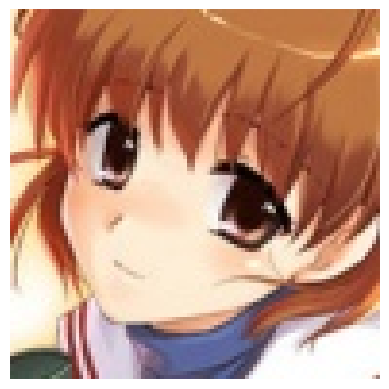

True Label: furukawa_nagisa
This image is likely belongs to:
> fujibayashi_kyou : 18.40 % confidence.
> xenovia_(high_school_dxd) : 14.03 % confidence.
> meltlilith : 6.40 % confidence.
> kanbaru_suruga : 6.01 % confidence.
> shirogane_naoto : 5.50 % confidence.


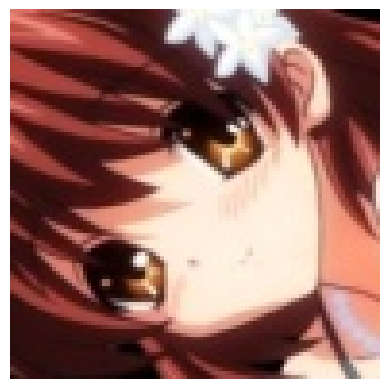

True Label: furukawa_nagisa
This image is likely belongs to:
> takao_(azur_lane) : 15.83 % confidence.
> nakano_itsuki : 10.75 % confidence.
> atago_(azur_lane) : 5.98 % confidence.
> sengoku_nadeko : 5.70 % confidence.
> utsumi_erise : 4.64 % confidence.


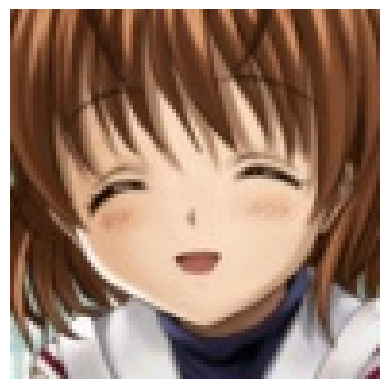

True Label: furukawa_nagisa
This image is likely belongs to:
> furukawa_nagisa : 23.44 % confidence.
> karin_(blue_archive) : 5.54 % confidence.
> hyuuga_hinata : 4.34 % confidence.
> suzumiya_haruhi : 4.33 % confidence.
> chitanda_eru : 3.96 % confidence.


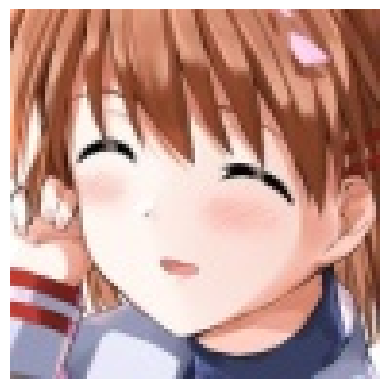

True Label: furukawa_nagisa
This image is likely belongs to:
> misaka_mikoto : 16.68 % confidence.
> ishtar_(fate_grand_order) : 4.40 % confidence.
> asuna_(sao) : 4.16 % confidence.
> yuigahama_yui : 4.01 % confidence.
> st_ar-15_(girls_frontline) : 3.03 % confidence.


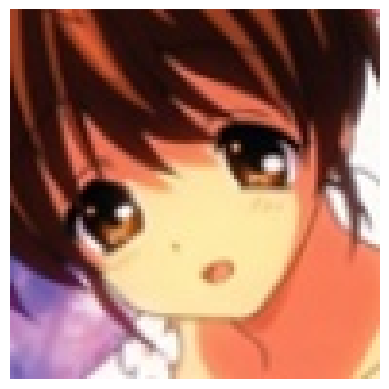

True Label: furukawa_nagisa
This image is likely belongs to:
> fujibayashi_kyou : 46.12 % confidence.
> senjougahara_hitagi : 5.97 % confidence.
> satonaka_chie : 4.66 % confidence.
> furukawa_nagisa : 4.62 % confidence.
> hatsune_miku : 3.51 % confidence.


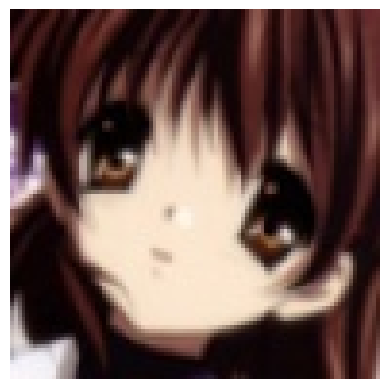

True Label: furukawa_nagisa
This image is likely belongs to:
> furukawa_nagisa : 41.06 % confidence.
> rias_gremory : 3.90 % confidence.
> ishtar_(fate_grand_order) : 3.83 % confidence.
> fujibayashi_kyou : 3.48 % confidence.
> tsushima_yoshiko : 3.46 % confidence.


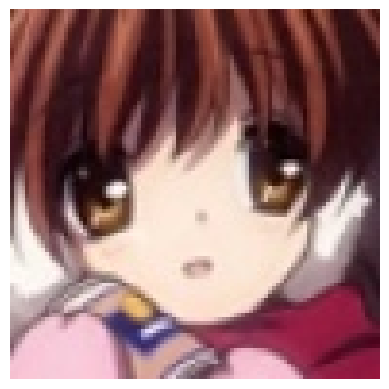

True Label: furukawa_nagisa
This image is likely belongs to:
> furukawa_nagisa : 86.72 % confidence.
> satonaka_chie : 1.42 % confidence.
> fujibayashi_kyou : 0.88 % confidence.
> nishikino_maki : 0.83 % confidence.
> suzumiya_haruhi : 0.78 % confidence.


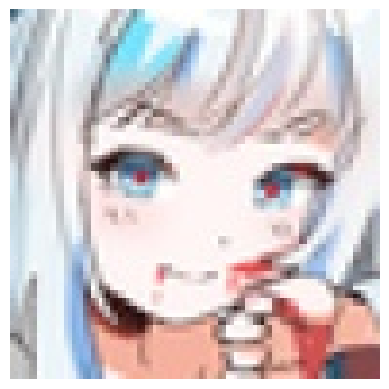

True Label: gawr_gura
This image is likely belongs to:
> gawr_gura : 16.75 % confidence.
> aqua_(konosuba) : 4.71 % confidence.
> fujibayashi_kyou : 4.24 % confidence.
> shidare_hotaru : 3.58 % confidence.
> suzumiya_haruhi : 3.54 % confidence.


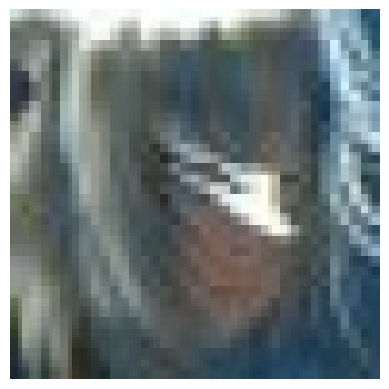

True Label: gawr_gura
This image is likely belongs to:
> gilgamesh : 27.05 % confidence.
> karna_(fate) : 11.85 % confidence.
> shirogane_naoto : 4.29 % confidence.
> kochou_shinobu : 2.57 % confidence.
> shirakami_fubuki : 2.29 % confidence.


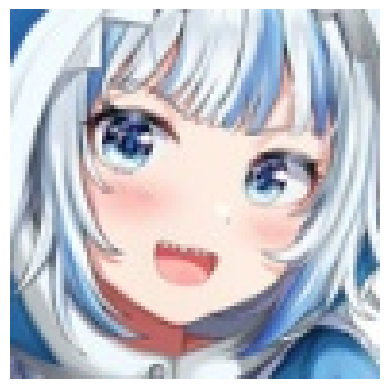

True Label: gawr_gura
This image is likely belongs to:
> gawr_gura : 32.77 % confidence.
> shirakami_fubuki : 3.73 % confidence.
> aegis_(persona) : 3.66 % confidence.
> watson_amelia : 2.94 % confidence.
> ayanami_rei : 2.60 % confidence.


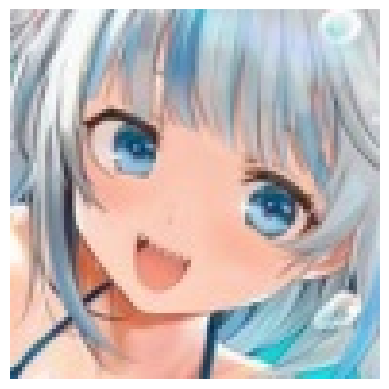

True Label: gawr_gura
This image is likely belongs to:
> fujibayashi_kyou : 12.47 % confidence.
> gawr_gura : 5.40 % confidence.
> suzumiya_haruhi : 4.70 % confidence.
> sakurajima_mai : 4.02 % confidence.
> kizuna_ai : 3.95 % confidence.


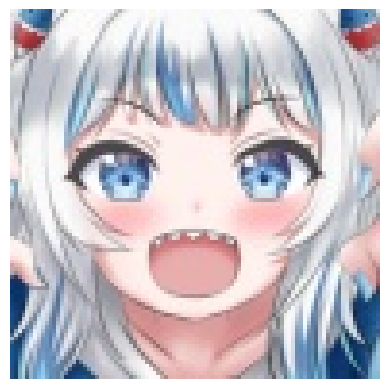

True Label: gawr_gura
This image is likely belongs to:
> gawr_gura : 22.67 % confidence.
> super_sonico : 6.74 % confidence.
> yuigahama_yui : 5.31 % confidence.
> anastasia_(idolmaster) : 4.10 % confidence.
> miyazono_kawori : 4.03 % confidence.


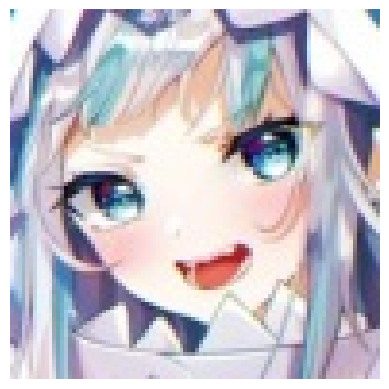

True Label: gawr_gura
This image is likely belongs to:
> sinon : 14.01 % confidence.
> kizuna_ai : 6.86 % confidence.
> shirakami_fubuki : 5.99 % confidence.
> kiryu_coco : 5.83 % confidence.
> gawr_gura : 4.26 % confidence.


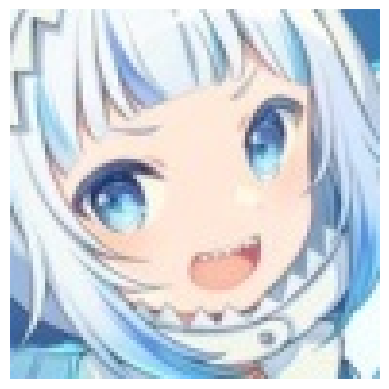

True Label: gawr_gura
This image is likely belongs to:
> gawr_gura : 23.43 % confidence.
> aqua_(konosuba) : 7.42 % confidence.
> usada_pekora : 6.76 % confidence.
> sinon : 3.55 % confidence.
> miyazono_kawori : 3.44 % confidence.


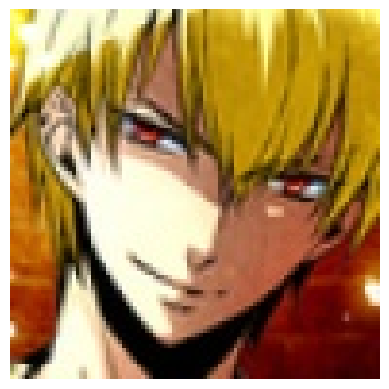

True Label: gilgamesh
This image is likely belongs to:
> gilgamesh : 53.68 % confidence.
> souryuu_asuka_langley : 5.84 % confidence.
> sakura_futaba : 3.41 % confidence.
> aegis_(persona) : 2.59 % confidence.
> arcueid_brunestud : 2.21 % confidence.


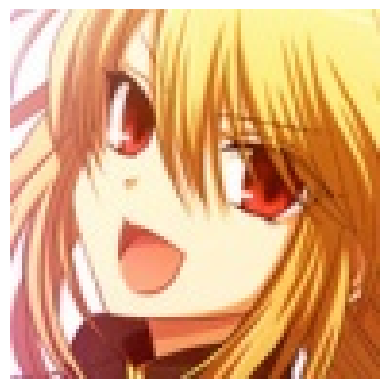

True Label: gilgamesh
This image is likely belongs to:
> arcueid_brunestud : 9.13 % confidence.
> astolfo_(fate) : 8.37 % confidence.
> hayasaka_ai : 4.91 % confidence.
> nakano_miku : 4.30 % confidence.
> cleveland_(azur_lane) : 4.17 % confidence.


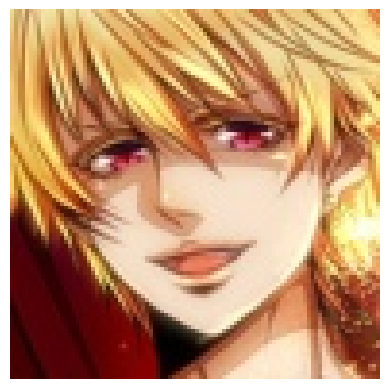

True Label: gilgamesh
This image is likely belongs to:
> gilgamesh : 38.31 % confidence.
> fubuki_(one-punch_man) : 6.25 % confidence.
> giorno_giovanna : 3.73 % confidence.
> aegis_(persona) : 3.72 % confidence.
> jonathan_joestar : 3.33 % confidence.


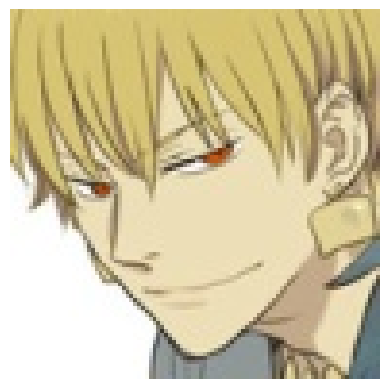

True Label: gilgamesh
This image is likely belongs to:
> satonaka_chie : 40.90 % confidence.
> gilgamesh : 11.36 % confidence.
> ayanami_rei : 10.68 % confidence.
> oshino_shinobu : 2.82 % confidence.
> nagato_yuki : 2.57 % confidence.


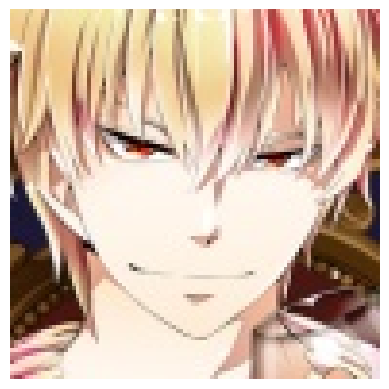

True Label: gilgamesh
This image is likely belongs to:
> gilgamesh : 22.01 % confidence.
> oshino_shinobu : 5.40 % confidence.
> c.c : 4.57 % confidence.
> sakura_futaba : 2.69 % confidence.
> chloe_von_einzbern : 2.53 % confidence.


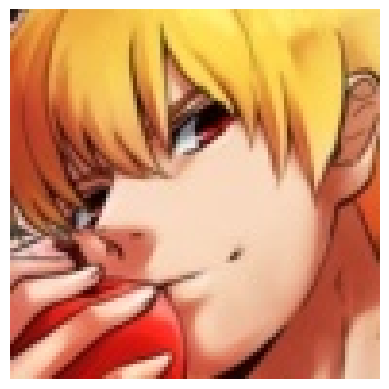

True Label: gilgamesh
This image is likely belongs to:
> aegis_(persona) : 13.54 % confidence.
> nami_(one_piece) : 10.64 % confidence.
> xenovia_(high_school_dxd) : 6.18 % confidence.
> sinon : 4.22 % confidence.
> souryuu_asuka_langley : 3.69 % confidence.


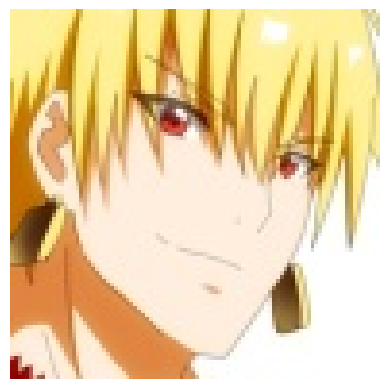

True Label: gilgamesh
This image is likely belongs to:
> gilgamesh : 29.72 % confidence.
> oshino_shinobu : 14.09 % confidence.
> satonaka_chie : 6.67 % confidence.
> aegis_(persona) : 4.19 % confidence.
> nagato_yuki : 3.76 % confidence.


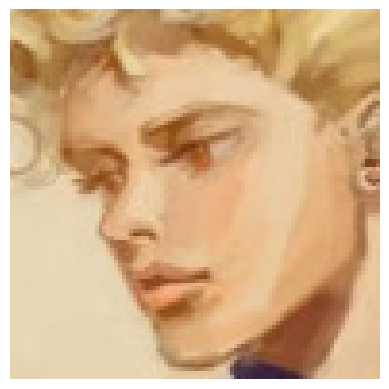

True Label: giorno_giovanna
This image is likely belongs to:
> giorno_giovanna : 71.68 % confidence.
> jonathan_joestar : 8.32 % confidence.
> gilgamesh : 6.82 % confidence.
> katsuragi_misato : 5.28 % confidence.
> aegis_(persona) : 1.12 % confidence.


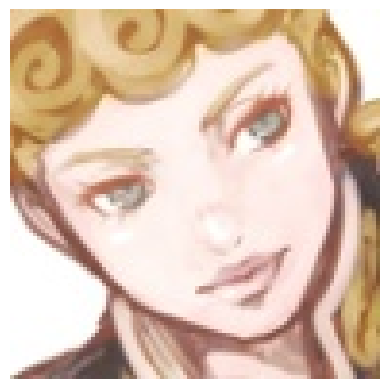

True Label: giorno_giovanna
This image is likely belongs to:
> giorno_giovanna : 51.98 % confidence.
> sakurauchi_riko : 3.93 % confidence.
> takamaki_anne : 3.56 % confidence.
> aegis_(persona) : 3.45 % confidence.
> d.va_(overwatch) : 2.35 % confidence.


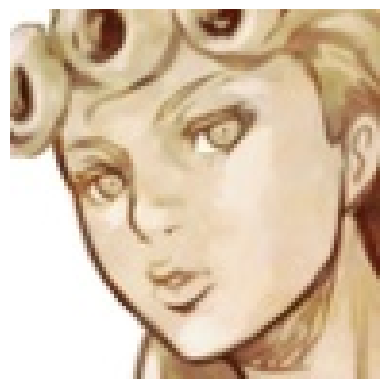

True Label: giorno_giovanna
This image is likely belongs to:
> giorno_giovanna : 41.91 % confidence.
> jonathan_joestar : 11.76 % confidence.
> katsuragi_misato : 10.33 % confidence.
> sakurauchi_riko : 10.12 % confidence.
> hyuuga_hinata : 2.43 % confidence.


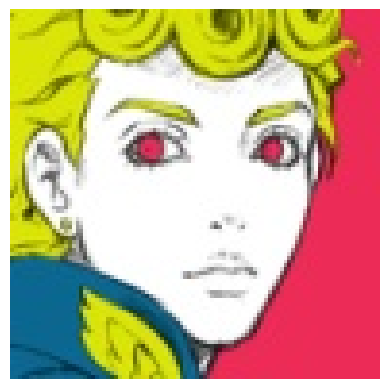

True Label: giorno_giovanna
This image is likely belongs to:
> giorno_giovanna : 21.24 % confidence.
> lancer : 14.61 % confidence.
> jonathan_joestar : 5.79 % confidence.
> hyuuga_hinata : 4.53 % confidence.
> takamaki_anne : 4.28 % confidence.


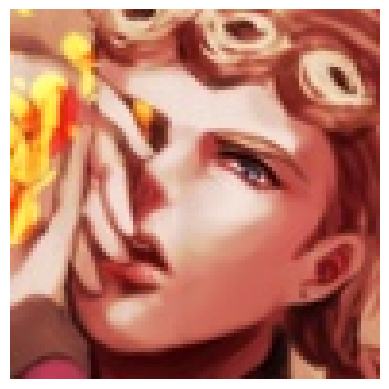

True Label: giorno_giovanna
This image is likely belongs to:
> giorno_giovanna : 11.23 % confidence.
> nami_(one_piece) : 10.20 % confidence.
> sakurauchi_riko : 6.96 % confidence.
> nishikino_maki : 5.89 % confidence.
> irisviel_von_einzbern : 2.55 % confidence.


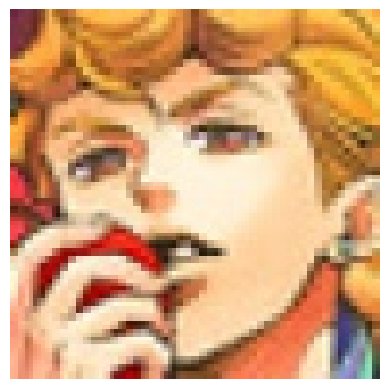

True Label: giorno_giovanna
This image is likely belongs to:
> giorno_giovanna : 30.85 % confidence.
> takamaki_anne : 10.66 % confidence.
> katsuragi_misato : 5.02 % confidence.
> abigail_williams_(fate) : 4.44 % confidence.
> ishtar_(fate_grand_order) : 4.01 % confidence.


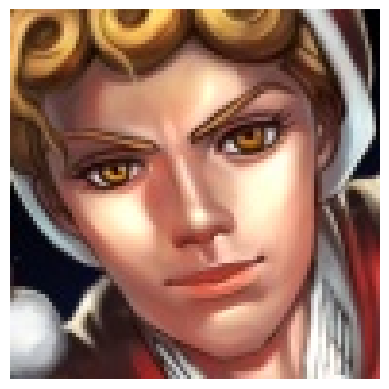

True Label: giorno_giovanna
This image is likely belongs to:
> giorno_giovanna : 87.26 % confidence.
> shirogane_naoto : 2.22 % confidence.
> nico_robin : 1.29 % confidence.
> aegis_(persona) : 1.21 % confidence.
> shishiro_botan : 0.40 % confidence.


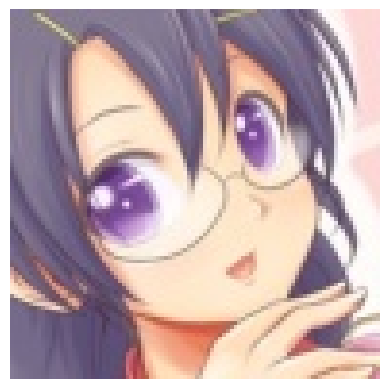

True Label: hanekawa_tsubasa
This image is likely belongs to:
> nakano_azusa : 6.53 % confidence.
> hirasawa_yui : 6.03 % confidence.
> takanashi_rikka : 3.76 % confidence.
> nagato_yuki : 3.62 % confidence.
> yui_(angel_beats!) : 2.74 % confidence.


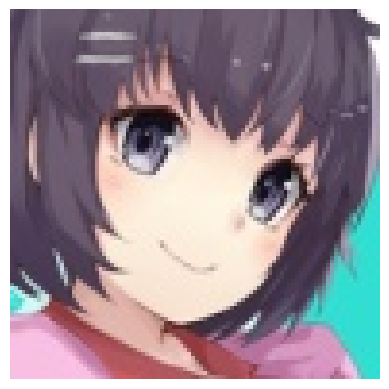

True Label: hanekawa_tsubasa
This image is likely belongs to:
> furukawa_nagisa : 13.95 % confidence.
> hanekawa_tsubasa : 12.81 % confidence.
> kaname_madoka : 4.83 % confidence.
> isshiki_iroha : 4.37 % confidence.
> toosaka_rin : 2.70 % confidence.


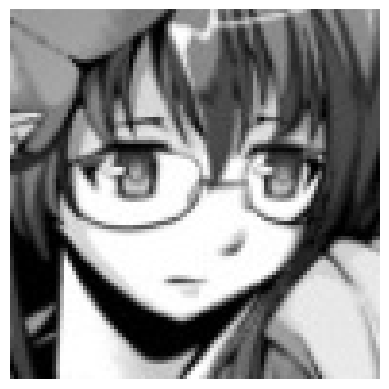

True Label: hanekawa_tsubasa
This image is likely belongs to:
> sakura_futaba : 6.77 % confidence.
> aisaka_taiga : 4.52 % confidence.
> suzumiya_haruhi : 4.37 % confidence.
> kanbaru_suruga : 3.77 % confidence.
> makise_kurisu : 3.09 % confidence.


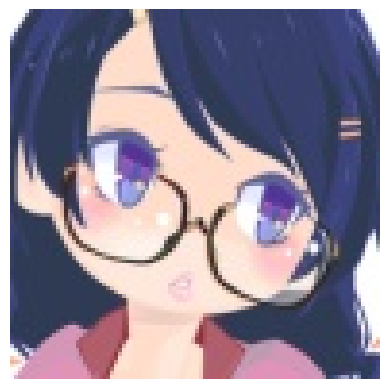

True Label: hanekawa_tsubasa
This image is likely belongs to:
> hanekawa_tsubasa : 25.80 % confidence.
> toujou_nozomi : 10.17 % confidence.
> mei_(pokemon) : 9.57 % confidence.
> nagato_yuki : 6.26 % confidence.
> takanashi_rikka : 4.98 % confidence.


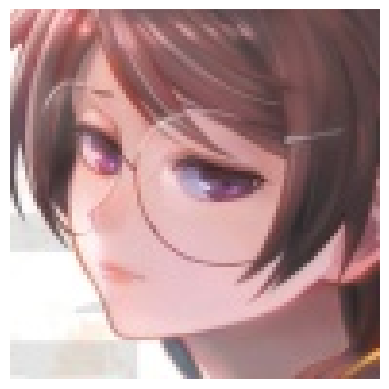

True Label: hanekawa_tsubasa
This image is likely belongs to:
> mash_kyrielight : 8.80 % confidence.
> miyazono_kawori : 6.17 % confidence.
> makise_kurisu : 3.92 % confidence.
> okita_souji_(fate) : 3.17 % confidence.
> aegis_(persona) : 2.77 % confidence.


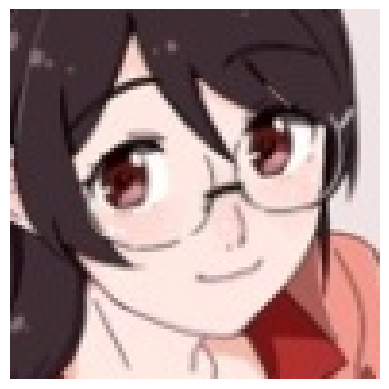

True Label: hanekawa_tsubasa
This image is likely belongs to:
> hanekawa_tsubasa : 34.57 % confidence.
> sengoku_nadeko : 10.54 % confidence.
> jonathan_joestar : 4.53 % confidence.
> senjougahara_hitagi : 4.04 % confidence.
> sakura_futaba : 3.23 % confidence.


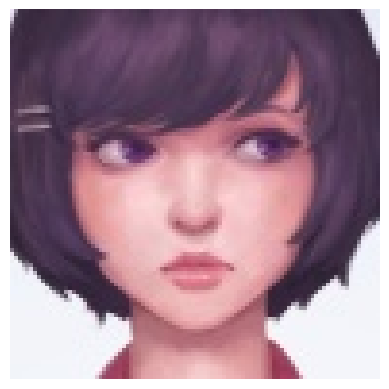

True Label: hanekawa_tsubasa
This image is likely belongs to:
> fubuki_(one-punch_man) : 13.54 % confidence.
> satonaka_chie : 7.19 % confidence.
> shibuya_rin : 6.84 % confidence.
> gilgamesh : 4.61 % confidence.
> ayanami_rei : 4.19 % confidence.


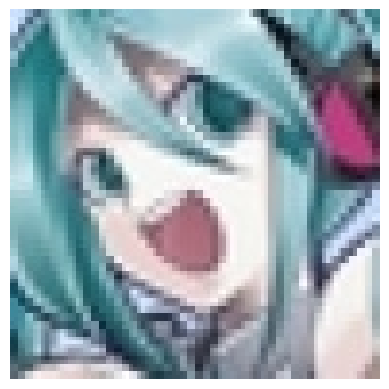

True Label: hatsune_miku
This image is likely belongs to:
> hatsune_miku : 17.33 % confidence.
> super_sonico : 7.42 % confidence.
> astolfo_(fate) : 6.88 % confidence.
> shirakami_fubuki : 4.79 % confidence.
> sinon : 4.20 % confidence.


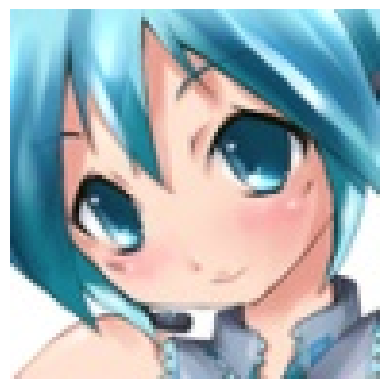

True Label: hatsune_miku
This image is likely belongs to:
> hatsune_miku : 16.85 % confidence.
> yuigahama_yui : 6.01 % confidence.
> aisaka_taiga : 4.03 % confidence.
> nagato_yuki : 3.85 % confidence.
> misaka_mikoto : 3.68 % confidence.


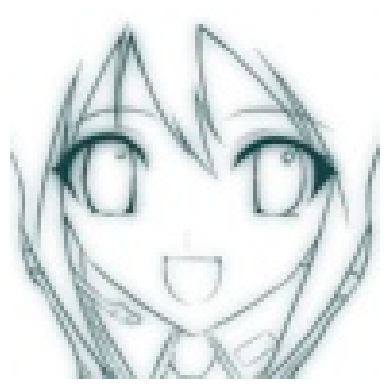

True Label: hatsune_miku
This image is likely belongs to:
> anastasia_(idolmaster) : 14.54 % confidence.
> astolfo_(fate) : 5.70 % confidence.
> kirito : 4.82 % confidence.
> kaname_madoka : 4.70 % confidence.
> shirakami_fubuki : 4.58 % confidence.


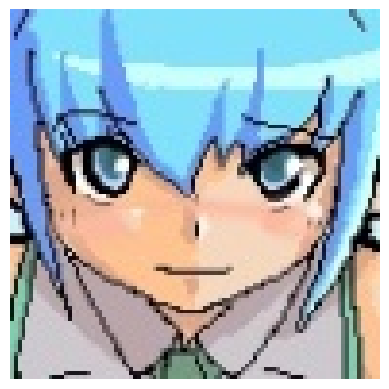

True Label: hatsune_miku
This image is likely belongs to:
> nakano_azusa : 9.98 % confidence.
> aqua_(konosuba) : 8.50 % confidence.
> hyuuga_hinata : 5.32 % confidence.
> ninomae_ina'nis : 5.17 % confidence.
> sinon : 4.98 % confidence.


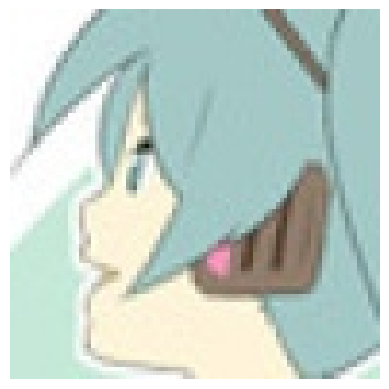

True Label: hatsune_miku
This image is likely belongs to:
> oshino_shinobu : 6.99 % confidence.
> giorno_giovanna : 6.14 % confidence.
> sinon : 5.40 % confidence.
> hatsune_miku : 4.35 % confidence.
> senjougahara_hitagi : 4.14 % confidence.


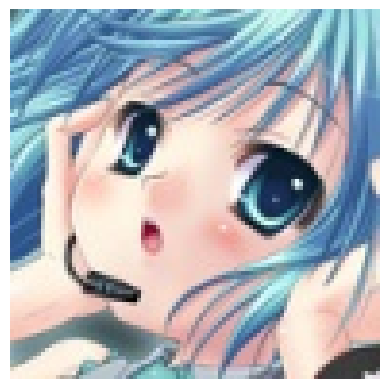

True Label: hatsune_miku
This image is likely belongs to:
> hatsune_miku : 9.39 % confidence.
> nishikino_maki : 9.38 % confidence.
> asia_argento : 8.28 % confidence.
> sinon : 4.61 % confidence.
> mei_(pokemon) : 4.06 % confidence.


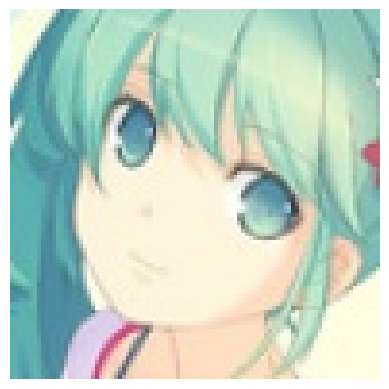

True Label: hatsune_miku
This image is likely belongs to:
> satonaka_chie : 9.62 % confidence.
> oshino_shinobu : 5.98 % confidence.
> ayanami_rei : 5.74 % confidence.
> aqua_(konosuba) : 3.36 % confidence.
> hatsune_miku : 3.33 % confidence.


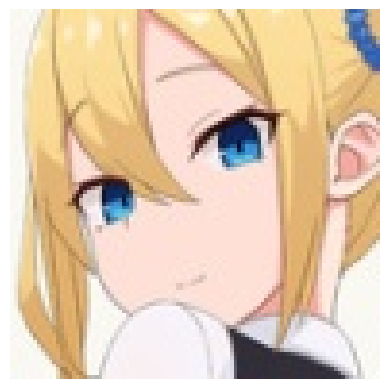

True Label: hayasaka_ai
This image is likely belongs to:
> st_ar-15_(girls_frontline) : 11.17 % confidence.
> rider : 6.74 % confidence.
> meltlilith : 5.50 % confidence.
> hayasaka_ai : 4.90 % confidence.
> nakano_miku : 4.60 % confidence.


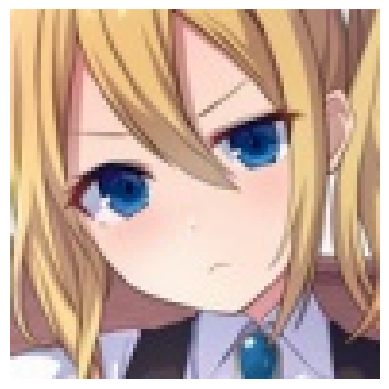

True Label: hayasaka_ai
This image is likely belongs to:
> nakano_miku : 40.71 % confidence.
> hayasaka_ai : 26.07 % confidence.
> unicorn_(azur_lane) : 3.97 % confidence.
> anastasia_(idolmaster) : 1.59 % confidence.
> sakurajima_mai : 1.53 % confidence.


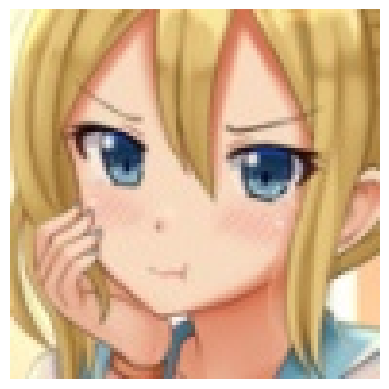

True Label: hayasaka_ai
This image is likely belongs to:
> nami_(one_piece) : 9.83 % confidence.
> nishikino_maki : 8.65 % confidence.
> asia_argento : 5.67 % confidence.
> hayasaka_ai : 4.79 % confidence.
> miyazono_kawori : 4.11 % confidence.


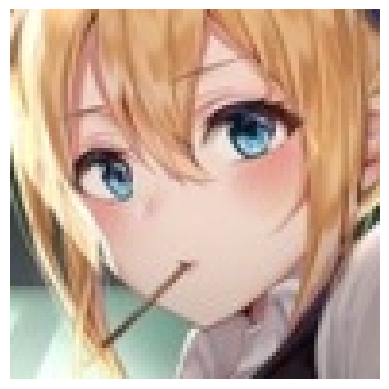

True Label: hayasaka_ai
This image is likely belongs to:
> hayasaka_ai : 17.36 % confidence.
> okita_souji_(fate) : 7.92 % confidence.
> raphtalia : 7.25 % confidence.
> isshiki_iroha : 7.18 % confidence.
> nami_(one_piece) : 6.09 % confidence.


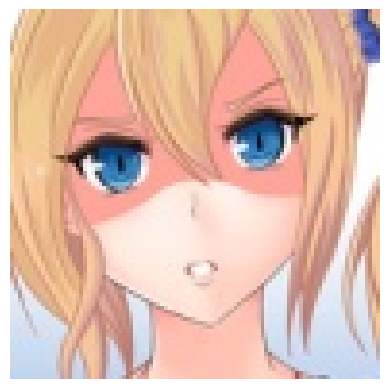

True Label: hayasaka_ai
This image is likely belongs to:
> nami_(one_piece) : 13.60 % confidence.
> platelet_(hataraku_saibou) : 7.14 % confidence.
> hayasaka_ai : 6.96 % confidence.
> watson_amelia : 3.57 % confidence.
> arcueid_brunestud : 2.87 % confidence.


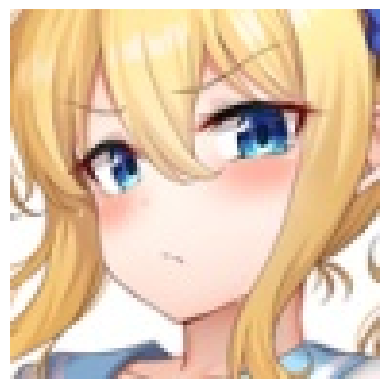

True Label: hayasaka_ai
This image is likely belongs to:
> usada_pekora : 13.68 % confidence.
> hayasaka_ai : 12.35 % confidence.
> nami_(one_piece) : 7.33 % confidence.
> watson_amelia : 6.28 % confidence.
> oshino_shinobu : 6.13 % confidence.


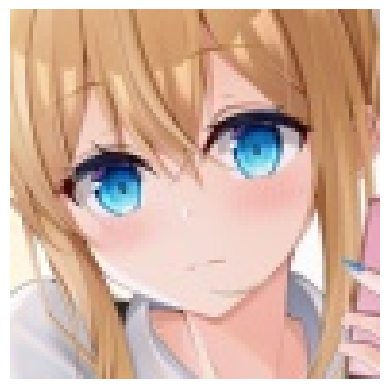

True Label: hayasaka_ai
This image is likely belongs to:
> suzuhara_lulu : 31.75 % confidence.
> kizuna_ai : 7.78 % confidence.
> hayasaka_ai : 7.23 % confidence.
> takimoto_hifumi : 7.15 % confidence.
> nakano_itsuki : 4.77 % confidence.


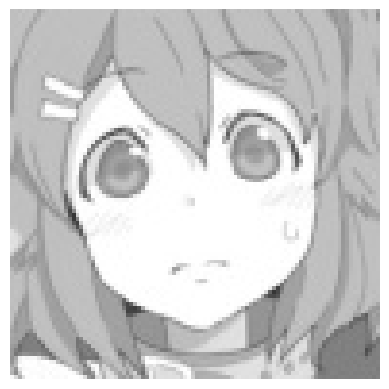

True Label: hirasawa_yui
This image is likely belongs to:
> shibuya_rin : 6.33 % confidence.
> toosaka_rin : 5.96 % confidence.
> hirasawa_yui : 5.84 % confidence.
> raphtalia : 4.97 % confidence.
> ookami_mio : 4.61 % confidence.


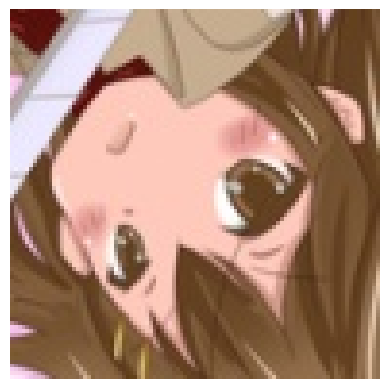

True Label: hirasawa_yui
This image is likely belongs to:
> abigail_williams_(fate) : 13.18 % confidence.
> hirasawa_yui : 10.56 % confidence.
> oshino_shinobu : 8.86 % confidence.
> platelet_(hataraku_saibou) : 4.09 % confidence.
> giorno_giovanna : 3.39 % confidence.


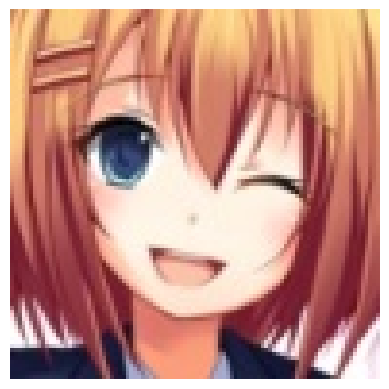

True Label: hirasawa_yui
This image is likely belongs to:
> yui_(angel_beats!) : 8.87 % confidence.
> souryuu_asuka_langley : 5.67 % confidence.
> aisaka_taiga : 5.04 % confidence.
> ryougi_shiki : 4.98 % confidence.
> nagato_yuki : 4.47 % confidence.


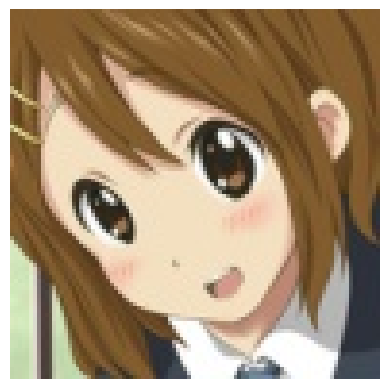

True Label: hirasawa_yui
This image is likely belongs to:
> furukawa_nagisa : 24.61 % confidence.
> suzumiya_haruhi : 10.39 % confidence.
> misaka_mikoto : 6.06 % confidence.
> hirasawa_yui : 5.51 % confidence.
> satonaka_chie : 5.22 % confidence.


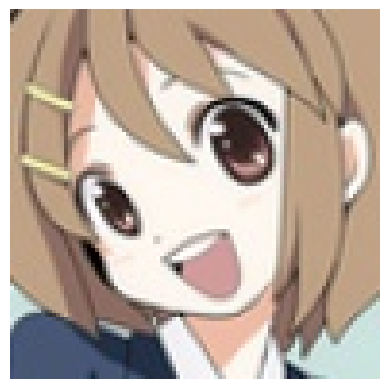

True Label: hirasawa_yui
This image is likely belongs to:
> hirasawa_yui : 40.32 % confidence.
> suzumiya_haruhi : 7.77 % confidence.
> paimon_(genshin_impact) : 3.13 % confidence.
> hanekawa_tsubasa : 2.28 % confidence.
> hatsune_miku : 2.28 % confidence.


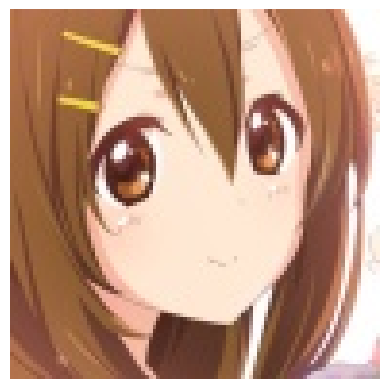

True Label: hirasawa_yui
This image is likely belongs to:
> hirasawa_yui : 22.41 % confidence.
> cleveland_(azur_lane) : 5.43 % confidence.
> unicorn_(azur_lane) : 5.05 % confidence.
> aisaka_taiga : 4.49 % confidence.
> hatsune_miku : 4.41 % confidence.


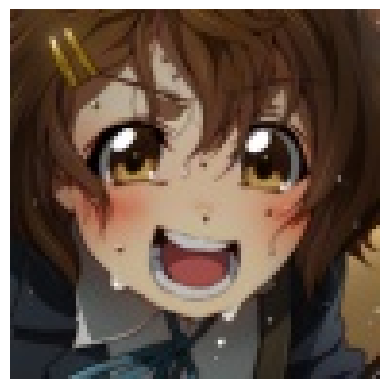

True Label: hirasawa_yui
This image is likely belongs to:
> tsushima_yoshiko : 5.85 % confidence.
> furukawa_nagisa : 5.59 % confidence.
> d.va_(overwatch) : 4.95 % confidence.
> megumin : 4.80 % confidence.
> ishtar_(fate_grand_order) : 4.75 % confidence.


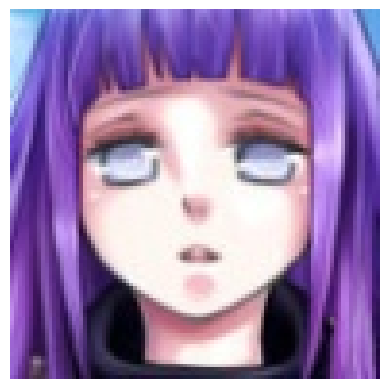

True Label: hyuuga_hinata
This image is likely belongs to:
> hyuuga_hinata : 43.39 % confidence.
> nico_robin : 3.10 % confidence.
> shidare_hotaru : 2.52 % confidence.
> d.va_(overwatch) : 2.49 % confidence.
> makise_kurisu : 2.34 % confidence.


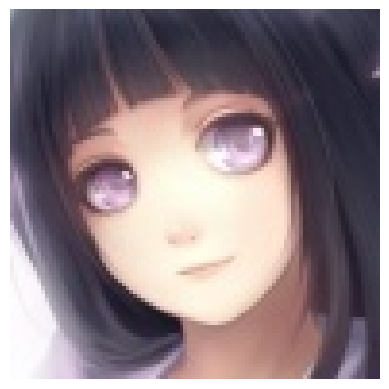

True Label: hyuuga_hinata
This image is likely belongs to:
> hyuuga_hinata : 13.43 % confidence.
> chitanda_eru : 11.37 % confidence.
> suzumiya_haruhi : 4.27 % confidence.
> fubuki_(one-punch_man) : 3.27 % confidence.
> atago_(azur_lane) : 3.21 % confidence.


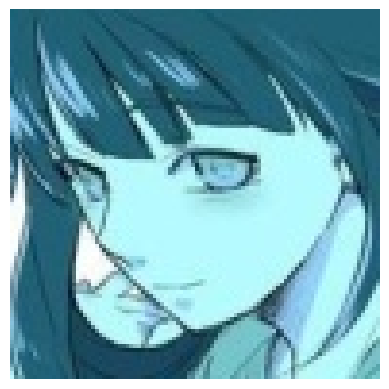

True Label: hyuuga_hinata
This image is likely belongs to:
> hyuuga_hinata : 12.42 % confidence.
> senjougahara_hitagi : 4.07 % confidence.
> matou_sakura : 4.03 % confidence.
> xenovia_(high_school_dxd) : 3.61 % confidence.
> takarada_rikka : 2.95 % confidence.


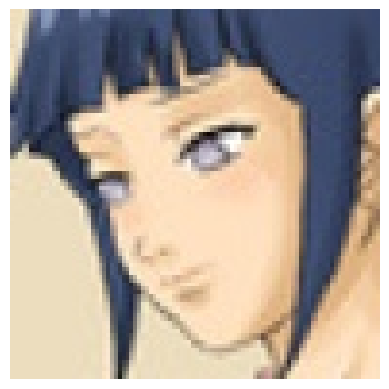

True Label: hyuuga_hinata
This image is likely belongs to:
> hyuuga_hinata : 28.03 % confidence.
> fubuki_(one-punch_man) : 9.44 % confidence.
> nico_robin : 8.14 % confidence.
> lancer : 6.50 % confidence.
> shirogane_naoto : 4.05 % confidence.


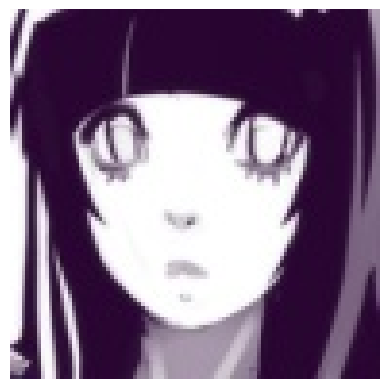

True Label: hyuuga_hinata
This image is likely belongs to:
> hyuuga_hinata : 22.32 % confidence.
> nico_robin : 16.22 % confidence.
> tsushima_yoshiko : 6.05 % confidence.
> takagi-san : 2.61 % confidence.
> ookami_mio : 2.42 % confidence.


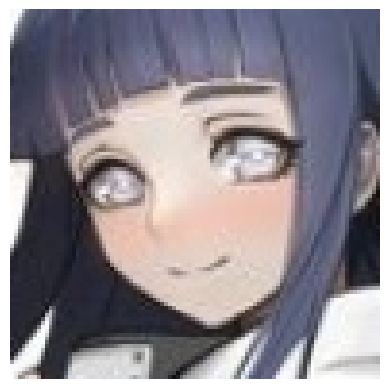

True Label: hyuuga_hinata
This image is likely belongs to:
> hyuuga_hinata : 42.88 % confidence.
> ninomae_ina'nis : 9.57 % confidence.
> nico_robin : 3.95 % confidence.
> mori_calliope : 2.54 % confidence.
> karin_(blue_archive) : 2.42 % confidence.


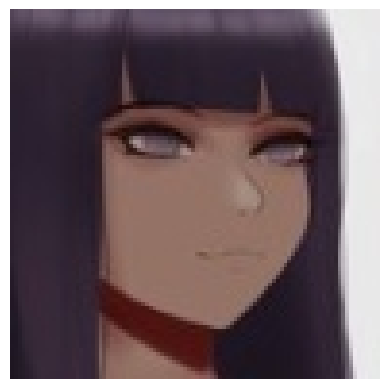

True Label: hyuuga_hinata
This image is likely belongs to:
> zero_two_(darling_in_the_franxx) : 12.37 % confidence.
> hyuuga_hinata : 11.75 % confidence.
> ninomae_ina'nis : 6.74 % confidence.
> chloe_von_einzbern : 5.68 % confidence.
> gawr_gura : 4.34 % confidence.


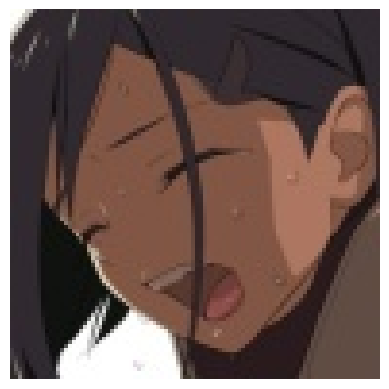

True Label: ichigo_(darling_in_the_franxx)
This image is likely belongs to:
> lancer : 17.48 % confidence.
> giorno_giovanna : 6.64 % confidence.
> kochou_shinobu : 5.96 % confidence.
> oshino_shinobu : 5.39 % confidence.
> shidare_hotaru : 3.30 % confidence.


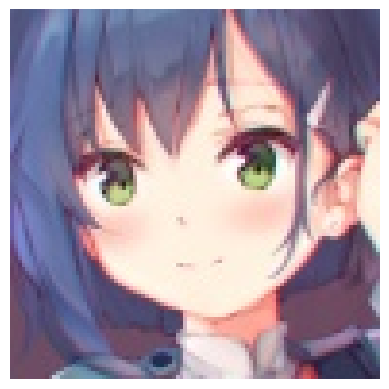

True Label: ichigo_(darling_in_the_franxx)
This image is likely belongs to:
> raphtalia : 6.54 % confidence.
> nakano_itsuki : 6.49 % confidence.
> usada_pekora : 5.11 % confidence.
> tsushima_yoshiko : 4.23 % confidence.
> sakurauchi_riko : 3.51 % confidence.


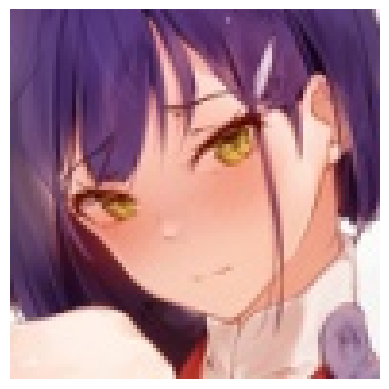

True Label: ichigo_(darling_in_the_franxx)
This image is likely belongs to:
> karin_(blue_archive) : 11.49 % confidence.
> ishtar_(fate_grand_order) : 9.29 % confidence.
> takao_(azur_lane) : 8.51 % confidence.
> atago_(azur_lane) : 6.55 % confidence.
> keqing_(genshin_impact) : 4.12 % confidence.


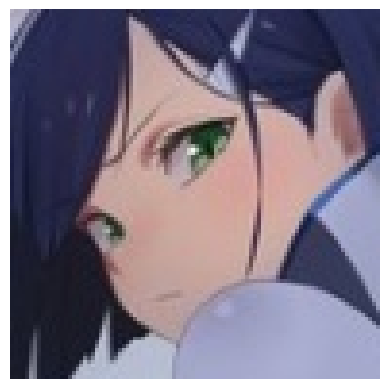

True Label: ichigo_(darling_in_the_franxx)
This image is likely belongs to:
> lancer : 15.83 % confidence.
> ichigo_(darling_in_the_franxx) : 6.53 % confidence.
> waver_velvet : 5.56 % confidence.
> enterprise_(azur_lane) : 4.69 % confidence.
> albedo : 4.11 % confidence.


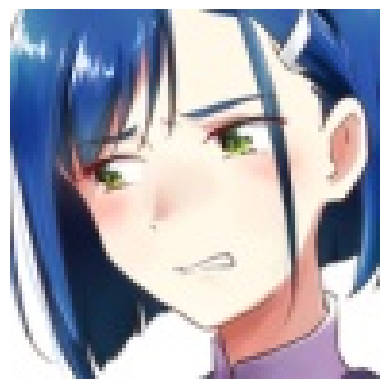

True Label: ichigo_(darling_in_the_franxx)
This image is likely belongs to:
> ichigo_(darling_in_the_franxx) : 36.61 % confidence.
> nico_robin : 6.50 % confidence.
> shuten_douji_(fate) : 4.98 % confidence.
> ryougi_shiki : 4.27 % confidence.
> waver_velvet : 3.60 % confidence.


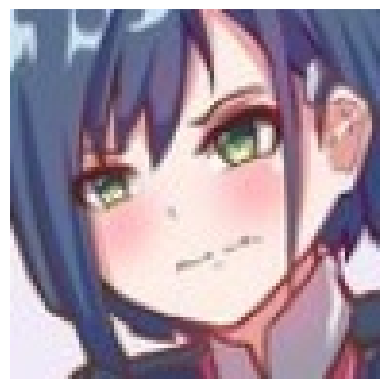

True Label: ichigo_(darling_in_the_franxx)
This image is likely belongs to:
> sakurauchi_riko : 7.99 % confidence.
> nishikino_maki : 7.10 % confidence.
> bremerton_(azur_lane) : 6.82 % confidence.
> ichigo_(darling_in_the_franxx) : 6.20 % confidence.
> shuten_douji_(fate) : 4.77 % confidence.


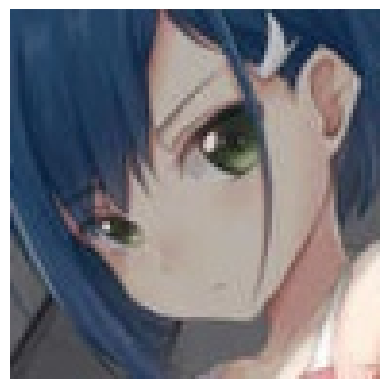

True Label: ichigo_(darling_in_the_franxx)
This image is likely belongs to:
> ichigo_(darling_in_the_franxx) : 25.40 % confidence.
> shuten_douji_(fate) : 10.62 % confidence.
> laffey_(azur_lane) : 5.35 % confidence.
> shinomiya_kaguya : 3.93 % confidence.
> bremerton_(azur_lane) : 3.67 % confidence.


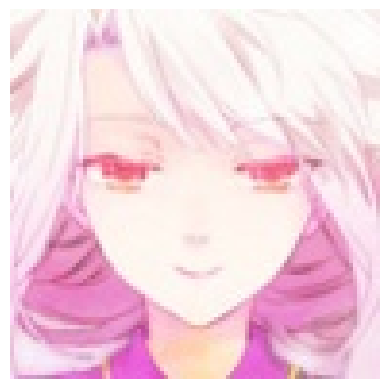

True Label: illyasviel_von_einzbern
This image is likely belongs to:
> mori_calliope : 21.85 % confidence.
> emilia_rezero : 14.13 % confidence.
> arcueid_brunestud : 6.89 % confidence.
> zero_two_(darling_in_the_franxx) : 4.33 % confidence.
> irisviel_von_einzbern : 4.29 % confidence.


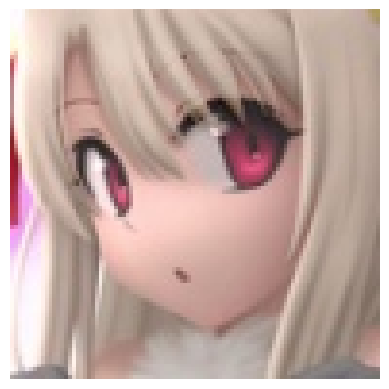

True Label: illyasviel_von_einzbern
This image is likely belongs to:
> arcueid_brunestud : 18.13 % confidence.
> formidable_(azur_lane) : 4.27 % confidence.
> kaname_madoka : 4.18 % confidence.
> megumin : 4.13 % confidence.
> illyasviel_von_einzbern : 4.12 % confidence.


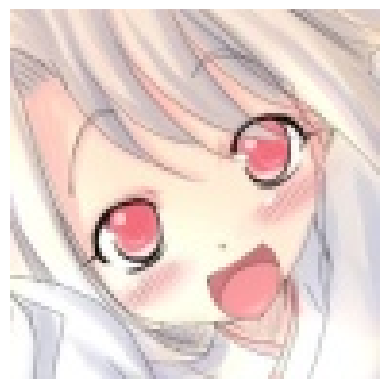

True Label: illyasviel_von_einzbern
This image is likely belongs to:
> illyasviel_von_einzbern : 14.78 % confidence.
> oshino_shinobu : 10.12 % confidence.
> arcueid_brunestud : 9.58 % confidence.
> watson_amelia : 4.78 % confidence.
> enterprise_(azur_lane) : 4.21 % confidence.


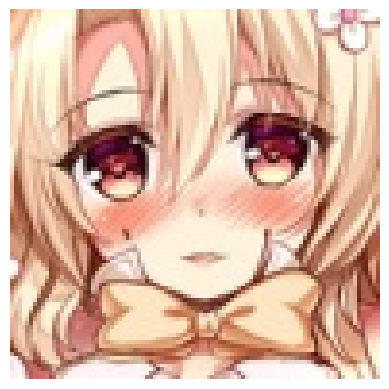

True Label: illyasviel_von_einzbern
This image is likely belongs to:
> cleveland_(azur_lane) : 21.42 % confidence.
> super_sonico : 14.40 % confidence.
> illyasviel_von_einzbern : 4.70 % confidence.
> miyazono_kawori : 4.29 % confidence.
> arcueid_brunestud : 3.59 % confidence.


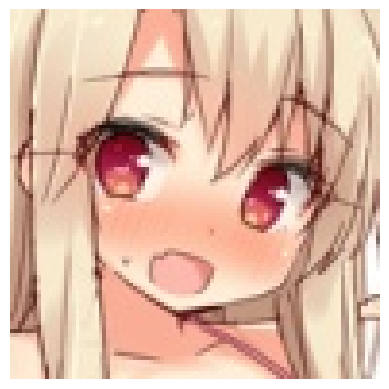

True Label: illyasviel_von_einzbern
This image is likely belongs to:
> illyasviel_von_einzbern : 19.50 % confidence.
> super_sonico : 8.41 % confidence.
> laffey_(azur_lane) : 3.20 % confidence.
> formidable_(azur_lane) : 3.04 % confidence.
> shidare_hotaru : 2.92 % confidence.


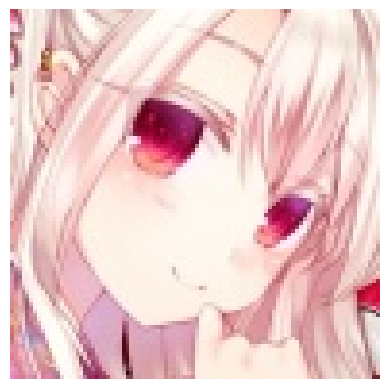

True Label: illyasviel_von_einzbern
This image is likely belongs to:
> illyasviel_von_einzbern : 22.21 % confidence.
> laffey_(azur_lane) : 22.01 % confidence.
> shirogane_noel : 5.42 % confidence.
> suzuhara_lulu : 4.26 % confidence.
> shirakami_fubuki : 3.87 % confidence.


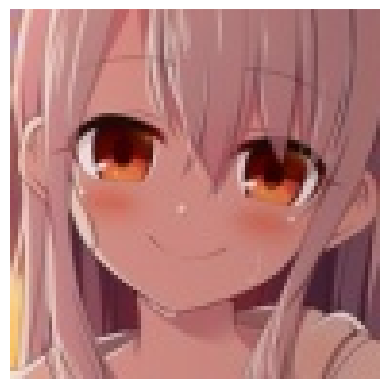

True Label: illyasviel_von_einzbern
This image is likely belongs to:
> emilia_rezero : 8.11 % confidence.
> enterprise_(azur_lane) : 5.26 % confidence.
> anastasia_(idolmaster) : 4.65 % confidence.
> unicorn_(azur_lane) : 4.48 % confidence.
> dido_(azur_lane) : 4.20 % confidence.


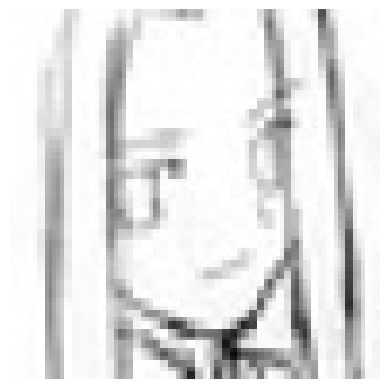

True Label: irisviel_von_einzbern
This image is likely belongs to:
> rider : 84.33 % confidence.
> irisviel_von_einzbern : 2.54 % confidence.
> makise_kurisu : 1.46 % confidence.
> karna_(fate) : 1.17 % confidence.
> shirakami_fubuki : 0.87 % confidence.


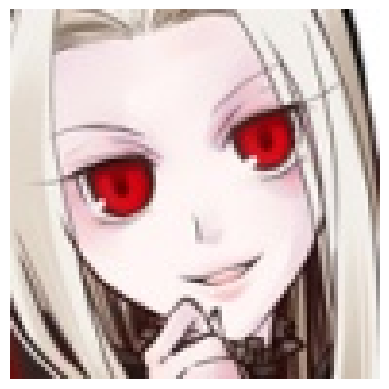

True Label: irisviel_von_einzbern
This image is likely belongs to:
> takagi-san : 19.13 % confidence.
> mori_calliope : 15.09 % confidence.
> kamado_nezuko : 6.74 % confidence.
> shishiro_botan : 6.42 % confidence.
> cleveland_(azur_lane) : 3.91 % confidence.


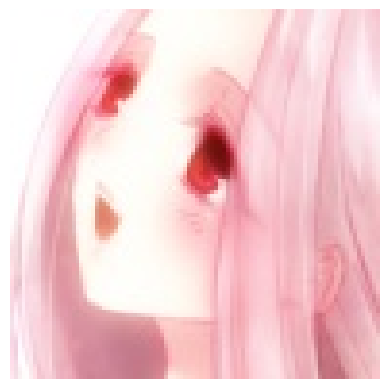

True Label: irisviel_von_einzbern
This image is likely belongs to:
> kizuna_ai : 7.94 % confidence.
> emilia_rezero : 7.73 % confidence.
> toosaka_rin : 4.87 % confidence.
> shinomiya_kaguya : 3.52 % confidence.
> ram_rezero : 3.52 % confidence.


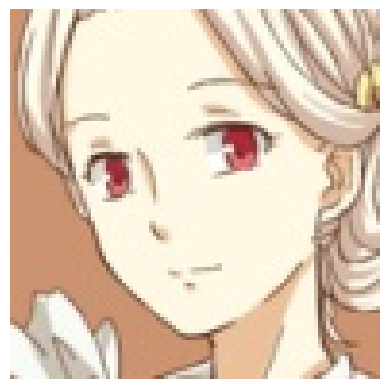

True Label: irisviel_von_einzbern
This image is likely belongs to:
> takamaki_anne : 19.86 % confidence.
> giorno_giovanna : 9.40 % confidence.
> lancer : 6.78 % confidence.
> irisviel_von_einzbern : 5.39 % confidence.
> abigail_williams_(fate) : 3.36 % confidence.


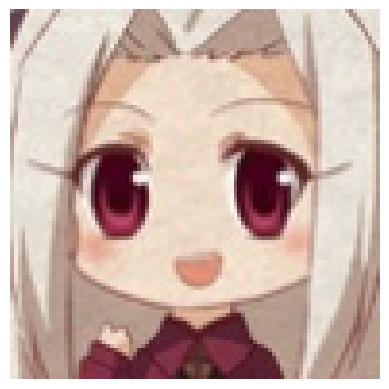

True Label: irisviel_von_einzbern
This image is likely belongs to:
> irisviel_von_einzbern : 73.52 % confidence.
> abigail_williams_(fate) : 5.31 % confidence.
> paimon_(genshin_impact) : 3.48 % confidence.
> takagi-san : 2.32 % confidence.
> hirasawa_yui : 1.57 % confidence.


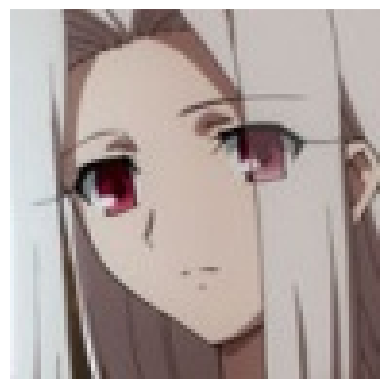

True Label: irisviel_von_einzbern
This image is likely belongs to:
> irisviel_von_einzbern : 67.96 % confidence.
> abigail_williams_(fate) : 7.72 % confidence.
> illyasviel_von_einzbern : 3.70 % confidence.
> takagi-san : 3.34 % confidence.
> rider : 1.44 % confidence.


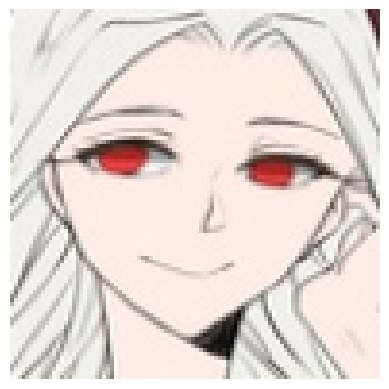

True Label: irisviel_von_einzbern
This image is likely belongs to:
> irisviel_von_einzbern : 48.19 % confidence.
> takamaki_anne : 5.36 % confidence.
> nico_robin : 5.24 % confidence.
> jonathan_joestar : 4.23 % confidence.
> giorno_giovanna : 2.83 % confidence.


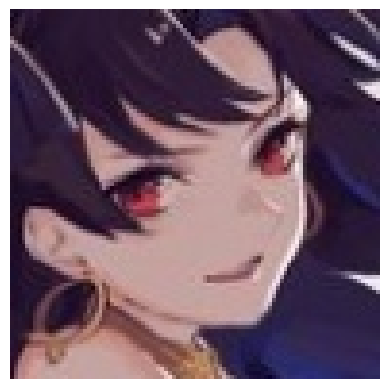

True Label: ishtar_(fate_grand_order)
This image is likely belongs to:
> atago_(azur_lane) : 17.43 % confidence.
> lancer : 10.52 % confidence.
> takao_(azur_lane) : 5.83 % confidence.
> ouro_kronii : 5.57 % confidence.
> ookami_mio : 4.47 % confidence.


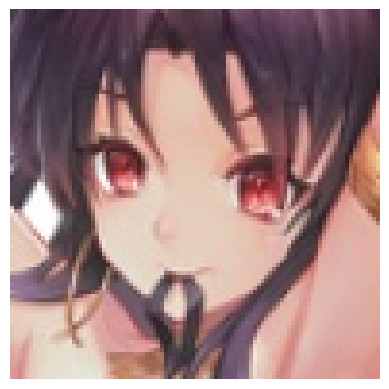

True Label: ishtar_(fate_grand_order)
This image is likely belongs to:
> ishtar_(fate_grand_order) : 12.80 % confidence.
> shinomiya_kaguya : 12.41 % confidence.
> taihou_(azur_lane) : 11.82 % confidence.
> karin_(blue_archive) : 9.39 % confidence.
> yukinoshita_yukino : 5.22 % confidence.


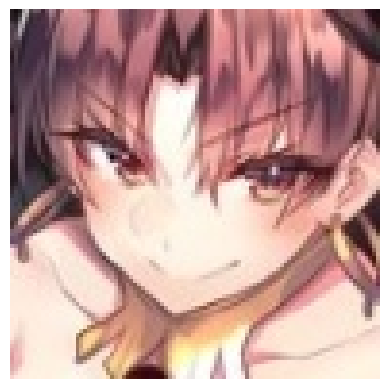

True Label: ishtar_(fate_grand_order)
This image is likely belongs to:
> ishtar_(fate_grand_order) : 21.21 % confidence.
> takao_(azur_lane) : 16.54 % confidence.
> ram_rezero : 4.31 % confidence.
> formidable_(azur_lane) : 4.11 % confidence.
> belfast_(azur_lane) : 3.66 % confidence.


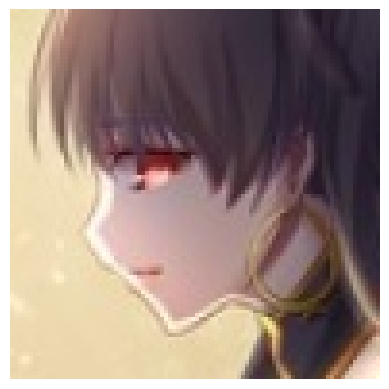

True Label: ishtar_(fate_grand_order)
This image is likely belongs to:
> takao_(azur_lane) : 7.40 % confidence.
> shinomiya_kaguya : 5.96 % confidence.
> utsumi_erise : 5.53 % confidence.
> megumin : 4.90 % confidence.
> ryougi_shiki : 4.85 % confidence.


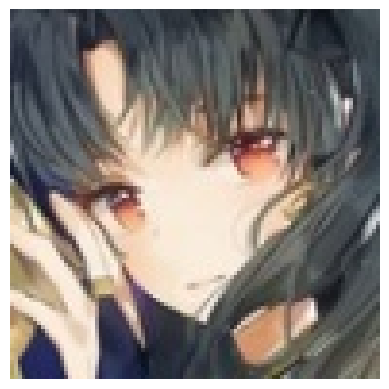

True Label: ishtar_(fate_grand_order)
This image is likely belongs to:
> fubuki_(one-punch_man) : 6.97 % confidence.
> shinomiya_kaguya : 6.19 % confidence.
> semiramis_(fate) : 4.51 % confidence.
> atago_(azur_lane) : 3.44 % confidence.
> taihou_(azur_lane) : 3.27 % confidence.


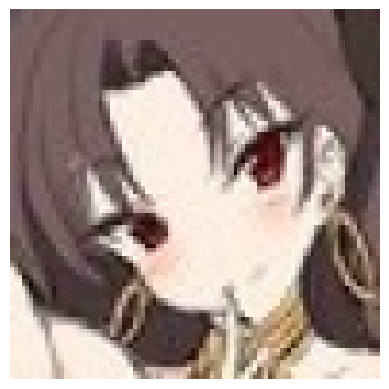

True Label: ishtar_(fate_grand_order)
This image is likely belongs to:
> ookami_mio : 8.84 % confidence.
> toosaka_rin : 8.82 % confidence.
> katsuragi_misato : 7.44 % confidence.
> oshino_ougi : 7.15 % confidence.
> ishtar_(fate_grand_order) : 6.67 % confidence.


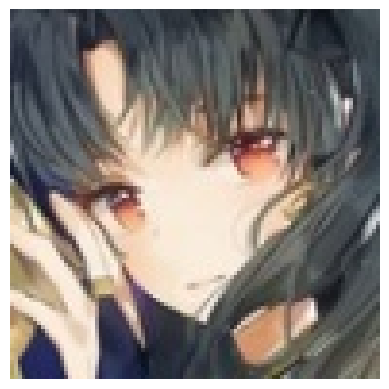

True Label: ishtar_(fate_grand_order)
This image is likely belongs to:
> fubuki_(one-punch_man) : 6.97 % confidence.
> shinomiya_kaguya : 6.19 % confidence.
> semiramis_(fate) : 4.51 % confidence.
> atago_(azur_lane) : 3.44 % confidence.
> taihou_(azur_lane) : 3.27 % confidence.


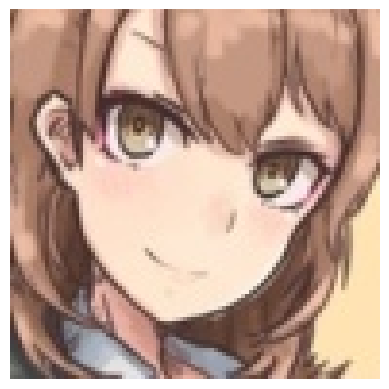

True Label: isshiki_iroha
This image is likely belongs to:
> zero_two_(darling_in_the_franxx) : 4.74 % confidence.
> suzuhara_lulu : 4.67 % confidence.
> yukinoshita_yukino : 4.17 % confidence.
> isshiki_iroha : 3.59 % confidence.
> shirogane_noel : 3.51 % confidence.


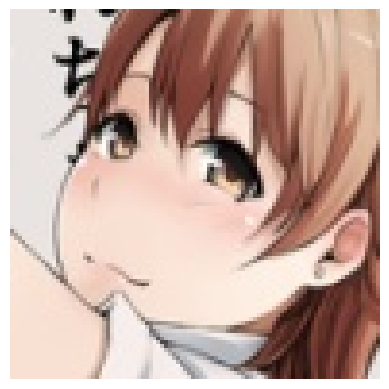

True Label: isshiki_iroha
This image is likely belongs to:
> misaka_mikoto : 6.95 % confidence.
> nakano_itsuki : 6.55 % confidence.
> yuigahama_yui : 6.15 % confidence.
> nishikino_maki : 4.96 % confidence.
> rias_gremory : 4.06 % confidence.


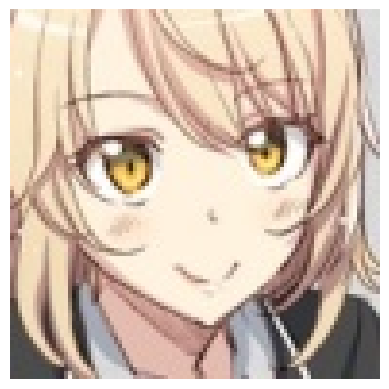

True Label: isshiki_iroha
This image is likely belongs to:
> isshiki_iroha : 17.52 % confidence.
> yuigahama_yui : 8.74 % confidence.
> raphtalia : 7.29 % confidence.
> sakurauchi_riko : 3.17 % confidence.
> gawr_gura : 2.69 % confidence.


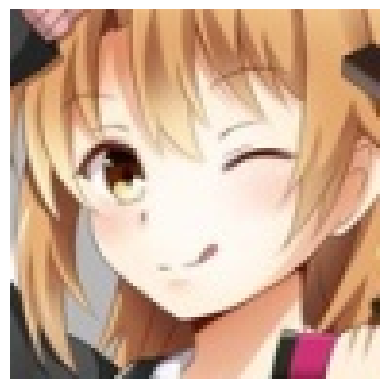

True Label: isshiki_iroha
This image is likely belongs to:
> asuna_(sao) : 16.03 % confidence.
> isshiki_iroha : 11.17 % confidence.
> kiryu_coco : 7.53 % confidence.
> raphtalia : 6.15 % confidence.
> cleveland_(azur_lane) : 6.05 % confidence.


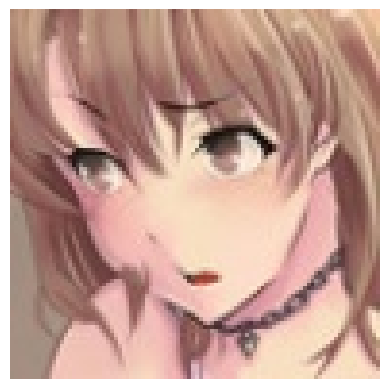

True Label: isshiki_iroha
This image is likely belongs to:
> isshiki_iroha : 10.61 % confidence.
> kizuna_ai : 10.45 % confidence.
> yuigahama_yui : 8.09 % confidence.
> misaka_mikoto : 4.83 % confidence.
> kaname_madoka : 3.95 % confidence.


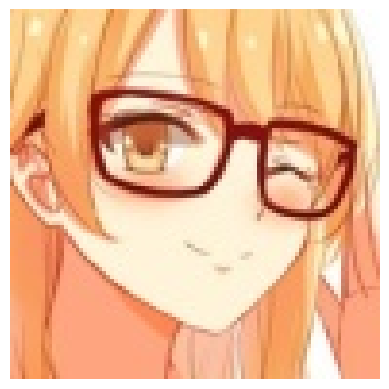

True Label: isshiki_iroha
This image is likely belongs to:
> sakura_futaba : 61.24 % confidence.
> nagato_yuki : 2.71 % confidence.
> aisaka_taiga : 2.05 % confidence.
> super_sonico : 1.31 % confidence.
> sengoku_nadeko : 1.29 % confidence.


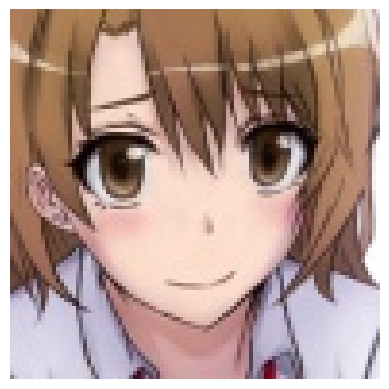

True Label: isshiki_iroha
This image is likely belongs to:
> sinon : 12.29 % confidence.
> anastasia_(idolmaster) : 8.34 % confidence.
> astolfo_(fate) : 8.25 % confidence.
> yukinoshita_yukino : 7.02 % confidence.
> sakurajima_mai : 4.42 % confidence.


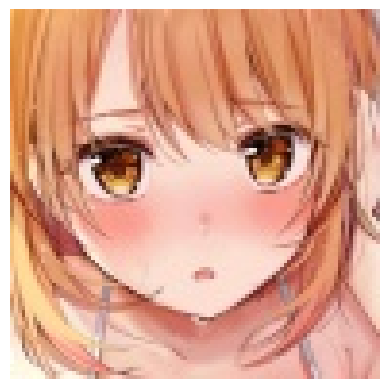

True Label: isshiki_iroha
This image is likely belongs to:
> isshiki_iroha : 26.98 % confidence.
> raphtalia : 13.87 % confidence.
> super_sonico : 4.87 % confidence.
> arcueid_brunestud : 3.13 % confidence.
> watson_amelia : 2.48 % confidence.


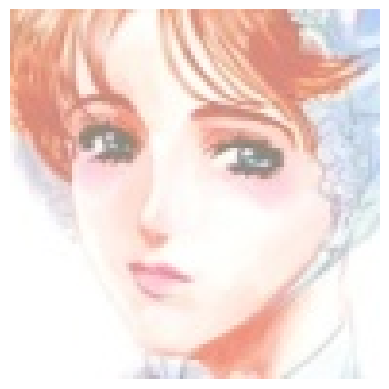

True Label: jonathan_joestar
This image is likely belongs to:
> giorno_giovanna : 11.49 % confidence.
> jonathan_joestar : 11.46 % confidence.
> aegis_(persona) : 10.28 % confidence.
> lancer : 4.24 % confidence.
> super_sonico : 3.88 % confidence.


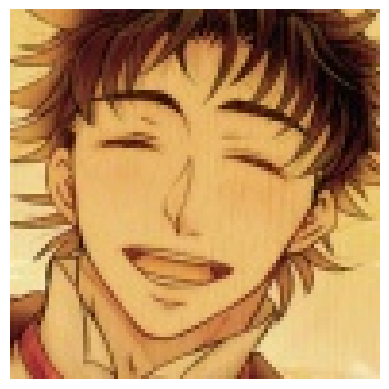

True Label: jonathan_joestar
This image is likely belongs to:
> jonathan_joestar : 26.76 % confidence.
> shinomiya_kaguya : 8.96 % confidence.
> fubuki_(one-punch_man) : 8.61 % confidence.
> hyuuga_hinata : 6.33 % confidence.
> nico_robin : 4.73 % confidence.


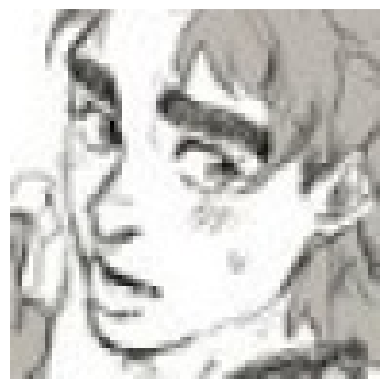

True Label: jonathan_joestar
This image is likely belongs to:
> shirogane_naoto : 9.45 % confidence.
> jonathan_joestar : 7.57 % confidence.
> karna_(fate) : 7.51 % confidence.
> kaname_madoka : 4.48 % confidence.
> sinon : 3.83 % confidence.


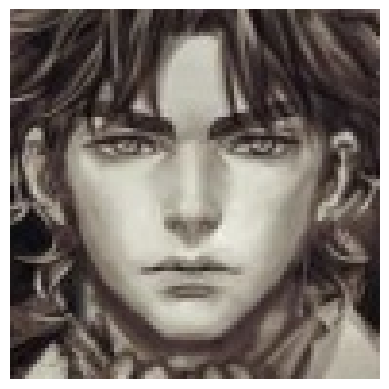

True Label: jonathan_joestar
This image is likely belongs to:
> jonathan_joestar : 11.86 % confidence.
> hyuuga_hinata : 11.30 % confidence.
> nico_robin : 10.74 % confidence.
> katsuragi_misato : 6.79 % confidence.
> semiramis_(fate) : 4.83 % confidence.


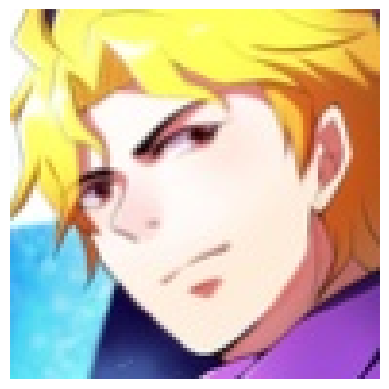

True Label: jonathan_joestar
This image is likely belongs to:
> lancer : 24.71 % confidence.
> usada_pekora : 4.06 % confidence.
> shidare_hotaru : 3.15 % confidence.
> sakurauchi_riko : 2.92 % confidence.
> laffey_(azur_lane) : 2.79 % confidence.


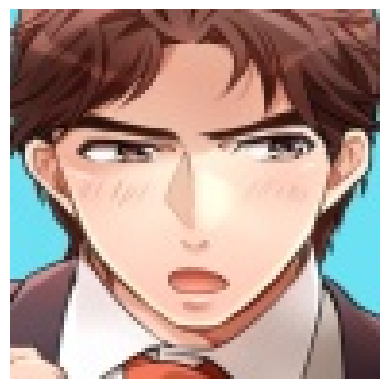

True Label: jonathan_joestar
This image is likely belongs to:
> jonathan_joestar : 44.23 % confidence.
> nico_robin : 10.37 % confidence.
> waver_velvet : 10.35 % confidence.
> lancer : 6.30 % confidence.
> hyuuga_hinata : 5.68 % confidence.


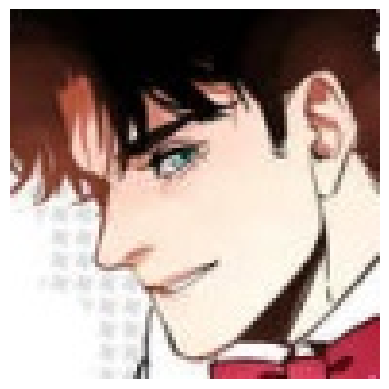

True Label: jonathan_joestar
This image is likely belongs to:
> jonathan_joestar : 9.62 % confidence.
> lancer : 8.32 % confidence.
> giorno_giovanna : 5.94 % confidence.
> katsuragi_misato : 5.91 % confidence.
> hyuuga_hinata : 5.74 % confidence.


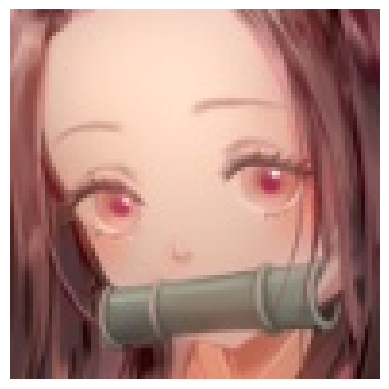

True Label: kamado_nezuko
This image is likely belongs to:
> kamado_nezuko : 94.00 % confidence.
> mori_calliope : 0.85 % confidence.
> shibuya_rin : 0.59 % confidence.
> takagi-san : 0.51 % confidence.
> d.va_(overwatch) : 0.34 % confidence.


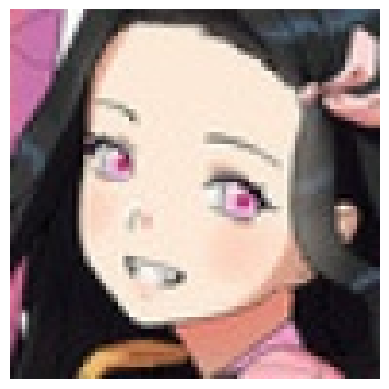

True Label: kamado_nezuko
This image is likely belongs to:
> kamado_nezuko : 14.06 % confidence.
> hyuuga_hinata : 13.38 % confidence.
> semiramis_(fate) : 7.16 % confidence.
> abigail_williams_(fate) : 6.75 % confidence.
> nico_robin : 6.13 % confidence.


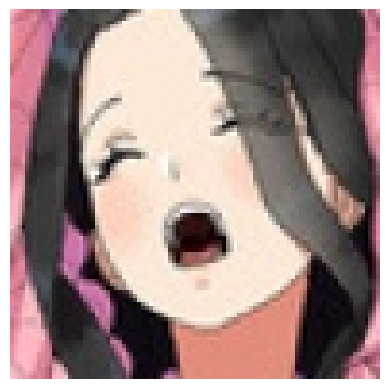

True Label: kamado_nezuko
This image is likely belongs to:
> hatsune_miku : 7.25 % confidence.
> mei_(pokemon) : 7.00 % confidence.
> kizuna_ai : 6.15 % confidence.
> fujiwara_chika : 6.01 % confidence.
> suzumiya_haruhi : 4.78 % confidence.


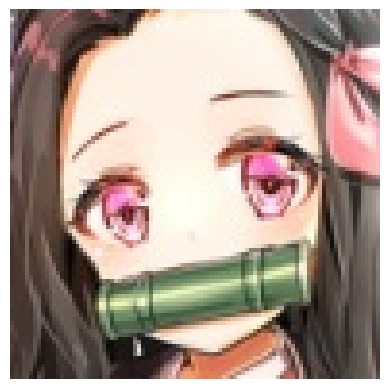

True Label: kamado_nezuko
This image is likely belongs to:
> kamado_nezuko : 98.86 % confidence.
> shibuya_rin : 0.19 % confidence.
> d.va_(overwatch) : 0.12 % confidence.
> abigail_williams_(fate) : 0.07 % confidence.
> takagi-san : 0.06 % confidence.


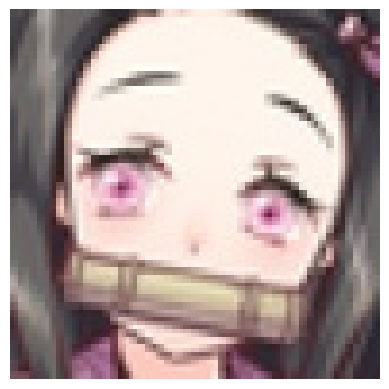

True Label: kamado_nezuko
This image is likely belongs to:
> kamado_nezuko : 99.23 % confidence.
> irisviel_von_einzbern : 0.14 % confidence.
> takagi-san : 0.09 % confidence.
> nico_robin : 0.09 % confidence.
> albedo : 0.04 % confidence.


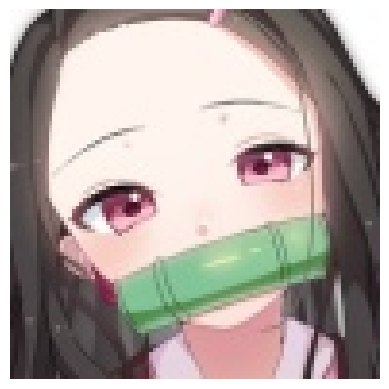

True Label: kamado_nezuko
This image is likely belongs to:
> kamado_nezuko : 98.37 % confidence.
> shibuya_rin : 0.72 % confidence.
> shirogane_noel : 0.22 % confidence.
> rider : 0.12 % confidence.
> d.va_(overwatch) : 0.06 % confidence.


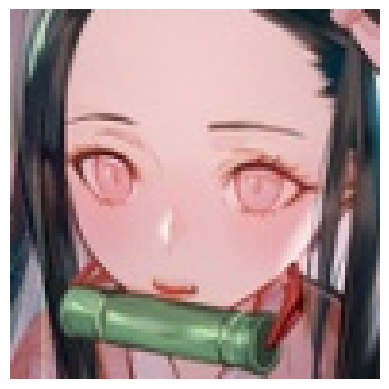

True Label: kamado_nezuko
This image is likely belongs to:
> kamado_nezuko : 96.22 % confidence.
> shirogane_noel : 0.22 % confidence.
> shidare_hotaru : 0.22 % confidence.
> shinomiya_kaguya : 0.21 % confidence.
> mori_calliope : 0.21 % confidence.


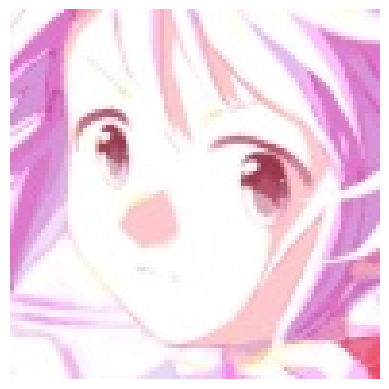

True Label: kaname_madoka
This image is likely belongs to:
> suzumiya_haruhi : 12.38 % confidence.
> kizuna_ai : 7.24 % confidence.
> kaname_madoka : 6.35 % confidence.
> toosaka_rin : 6.08 % confidence.
> furukawa_nagisa : 3.75 % confidence.


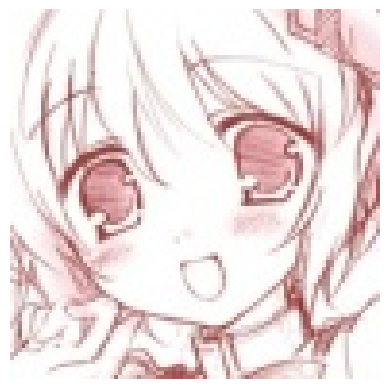

True Label: kaname_madoka
This image is likely belongs to:
> irisviel_von_einzbern : 10.24 % confidence.
> super_sonico : 8.92 % confidence.
> kaname_madoka : 6.76 % confidence.
> ayanami_rei : 4.92 % confidence.
> karna_(fate) : 4.31 % confidence.


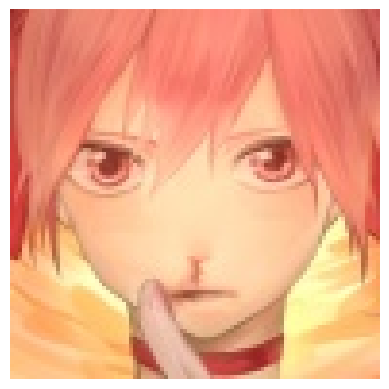

True Label: kaname_madoka
This image is likely belongs to:
> mash_kyrielight : 7.39 % confidence.
> bremerton_(azur_lane) : 6.99 % confidence.
> nakano_itsuki : 5.33 % confidence.
> rias_gremory : 5.07 % confidence.
> astolfo_(fate) : 4.53 % confidence.


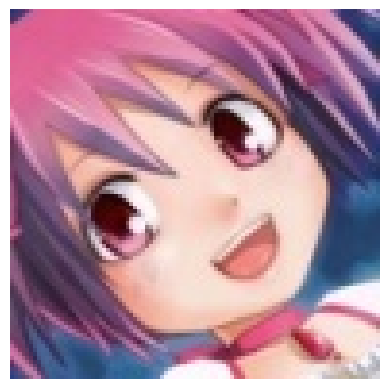

True Label: kaname_madoka
This image is likely belongs to:
> ayanami_rei : 6.58 % confidence.
> usada_pekora : 5.66 % confidence.
> tsushima_yoshiko : 5.41 % confidence.
> nishikino_maki : 3.69 % confidence.
> aegis_(persona) : 3.61 % confidence.


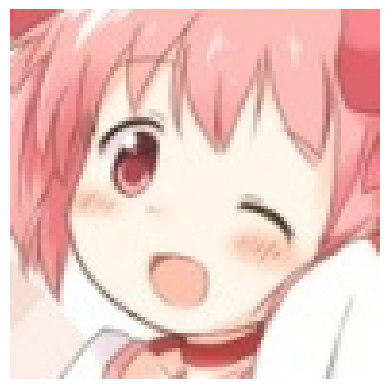

True Label: kaname_madoka
This image is likely belongs to:
> yuigahama_yui : 22.97 % confidence.
> misaka_mikoto : 15.39 % confidence.
> super_sonico : 6.49 % confidence.
> asuna_(sao) : 4.05 % confidence.
> raphtalia : 2.97 % confidence.


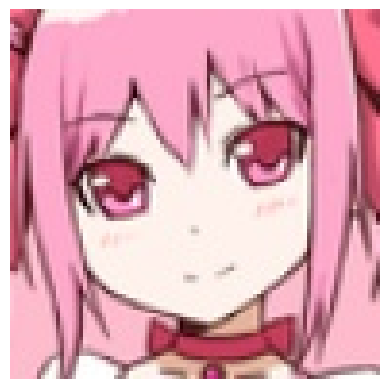

True Label: kaname_madoka
This image is likely belongs to:
> nishikino_maki : 8.75 % confidence.
> gawr_gura : 4.94 % confidence.
> hatsune_miku : 3.42 % confidence.
> senjougahara_hitagi : 3.16 % confidence.
> astolfo_(fate) : 2.83 % confidence.


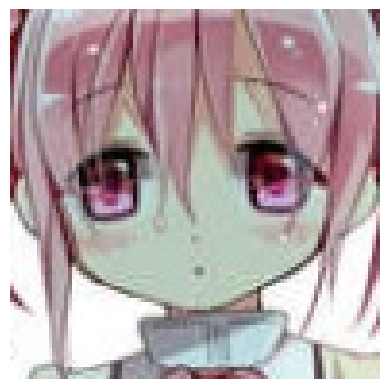

True Label: kaname_madoka
This image is likely belongs to:
> ram_rezero : 13.28 % confidence.
> takanashi_rikka : 6.60 % confidence.
> kaname_madoka : 4.42 % confidence.
> shuten_douji_(fate) : 4.05 % confidence.
> mash_kyrielight : 4.02 % confidence.


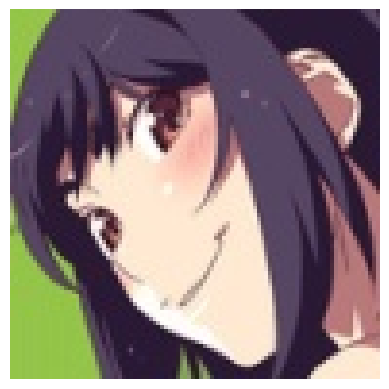

True Label: kanbaru_suruga
This image is likely belongs to:
> kanbaru_suruga : 17.06 % confidence.
> taihou_(azur_lane) : 5.22 % confidence.
> shirogane_naoto : 4.90 % confidence.
> hanekawa_tsubasa : 4.36 % confidence.
> albedo : 4.18 % confidence.


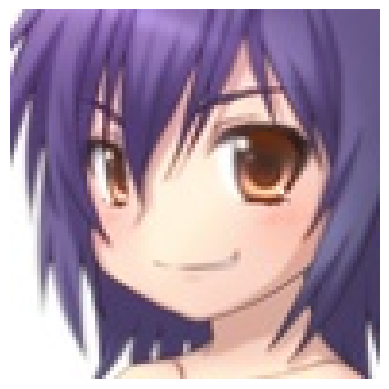

True Label: kanbaru_suruga
This image is likely belongs to:
> takanashi_rikka : 13.43 % confidence.
> nagato_yuki : 11.85 % confidence.
> mash_kyrielight : 11.56 % confidence.
> senjougahara_hitagi : 4.65 % confidence.
> kanbaru_suruga : 4.13 % confidence.


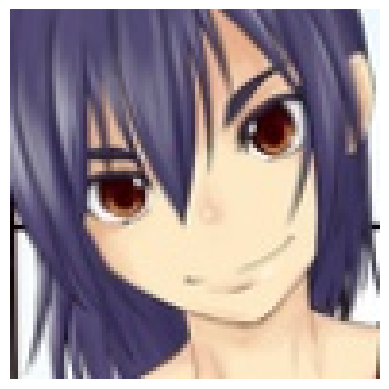

True Label: kanbaru_suruga
This image is likely belongs to:
> xenovia_(high_school_dxd) : 11.97 % confidence.
> nagato_yuki : 5.52 % confidence.
> yukinoshita_yukino : 5.19 % confidence.
> makise_kurisu : 4.53 % confidence.
> kirito : 4.28 % confidence.


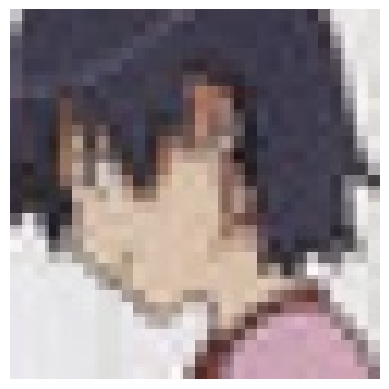

True Label: kanbaru_suruga
This image is likely belongs to:
> kanbaru_suruga : 60.86 % confidence.
> shirogane_naoto : 8.77 % confidence.
> katsuragi_misato : 3.44 % confidence.
> ayanami_rei : 2.40 % confidence.
> lancer : 1.78 % confidence.


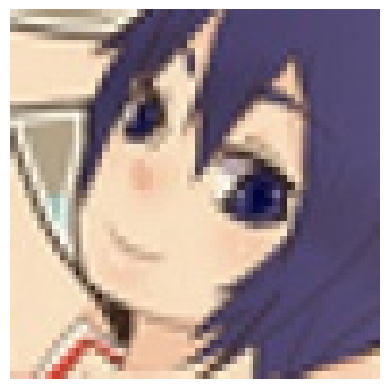

True Label: kanbaru_suruga
This image is likely belongs to:
> hatsune_miku : 21.01 % confidence.
> kanbaru_suruga : 11.03 % confidence.
> senjougahara_hitagi : 6.80 % confidence.
> aqua_(konosuba) : 5.46 % confidence.
> tsushima_yoshiko : 4.68 % confidence.


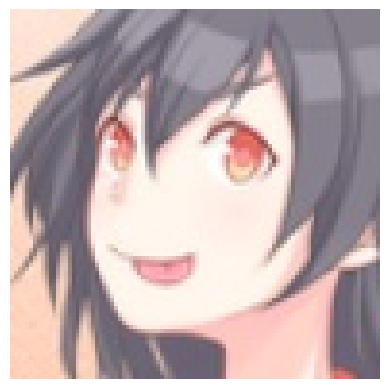

True Label: kanbaru_suruga
This image is likely belongs to:
> senjougahara_hitagi : 12.43 % confidence.
> hanekawa_tsubasa : 12.30 % confidence.
> kanbaru_suruga : 7.83 % confidence.
> hatsune_miku : 4.33 % confidence.
> yukinoshita_yukino : 3.83 % confidence.


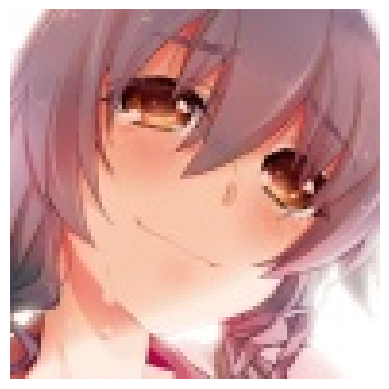

True Label: kanbaru_suruga
This image is likely belongs to:
> rem_rezero : 30.29 % confidence.
> ram_rezero : 15.68 % confidence.
> toujou_nozomi : 8.12 % confidence.
> kirito : 3.79 % confidence.
> keqing_(genshin_impact) : 3.03 % confidence.


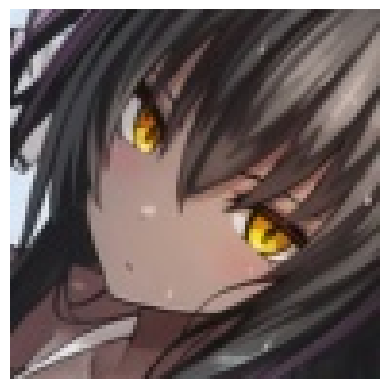

True Label: karin_(blue_archive)
This image is likely belongs to:
> karin_(blue_archive) : 9.06 % confidence.
> fujibayashi_kyou : 6.53 % confidence.
> furukawa_nagisa : 6.12 % confidence.
> takao_(azur_lane) : 4.46 % confidence.
> takarada_rikka : 3.85 % confidence.


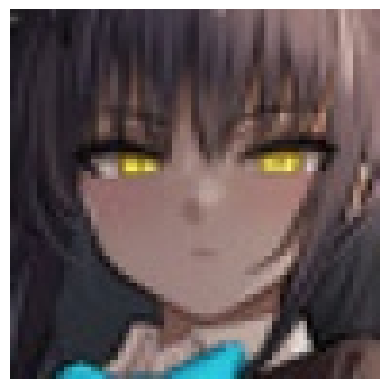

True Label: karin_(blue_archive)
This image is likely belongs to:
> karin_(blue_archive) : 31.24 % confidence.
> shidare_hotaru : 5.23 % confidence.
> ishtar_(fate_grand_order) : 4.20 % confidence.
> emilia_rezero : 3.84 % confidence.
> tsushima_yoshiko : 3.73 % confidence.


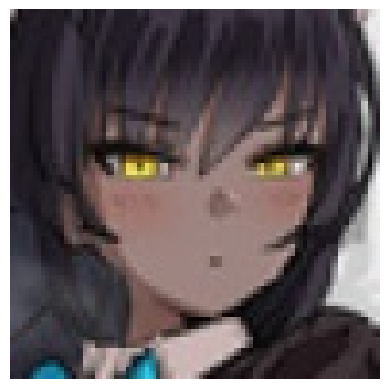

True Label: karin_(blue_archive)
This image is likely belongs to:
> shibuya_rin : 15.65 % confidence.
> karin_(blue_archive) : 10.91 % confidence.
> tsushima_yoshiko : 10.59 % confidence.
> shinomiya_kaguya : 5.30 % confidence.
> toosaka_rin : 5.08 % confidence.


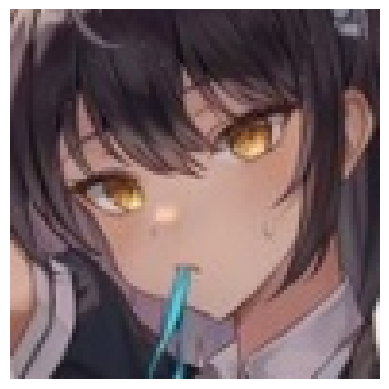

True Label: karin_(blue_archive)
This image is likely belongs to:
> karin_(blue_archive) : 18.74 % confidence.
> d.va_(overwatch) : 8.71 % confidence.
> shibuya_rin : 5.26 % confidence.
> atago_(azur_lane) : 5.25 % confidence.
> shinomiya_kaguya : 3.43 % confidence.


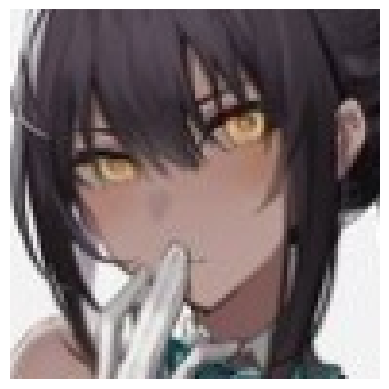

True Label: karin_(blue_archive)
This image is likely belongs to:
> shibuya_rin : 11.19 % confidence.
> taihou_(azur_lane) : 5.40 % confidence.
> ookami_mio : 5.22 % confidence.
> keqing_(genshin_impact) : 5.21 % confidence.
> karin_(blue_archive) : 4.37 % confidence.


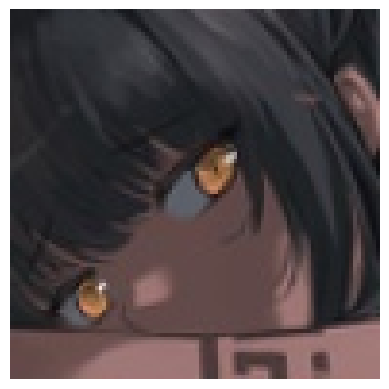

True Label: karin_(blue_archive)
This image is likely belongs to:
> karna_(fate) : 11.71 % confidence.
> kirito : 8.45 % confidence.
> fubuki_(one-punch_man) : 7.28 % confidence.
> souryuu_asuka_langley : 4.89 % confidence.
> shirogane_naoto : 4.53 % confidence.


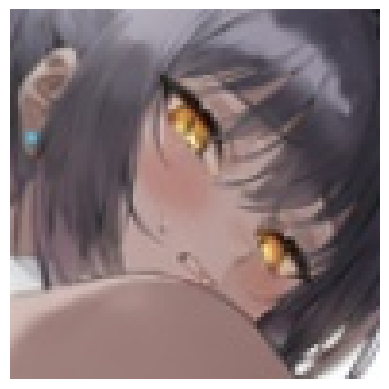

True Label: karin_(blue_archive)
This image is likely belongs to:
> karin_(blue_archive) : 16.50 % confidence.
> ryougi_shiki : 7.84 % confidence.
> fubuki_(one-punch_man) : 4.38 % confidence.
> gilgamesh : 3.70 % confidence.
> chloe_von_einzbern : 2.88 % confidence.


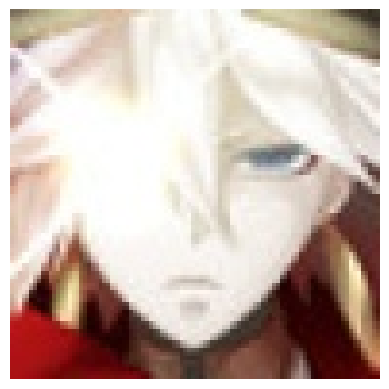

True Label: karna_(fate)
This image is likely belongs to:
> karna_(fate) : 59.45 % confidence.
> shishiro_botan : 4.26 % confidence.
> kirito : 3.96 % confidence.
> semiramis_(fate) : 3.95 % confidence.
> laffey_(azur_lane) : 2.18 % confidence.


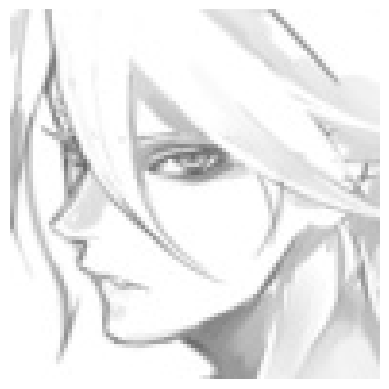

True Label: karna_(fate)
This image is likely belongs to:
> albedo : 34.00 % confidence.
> karna_(fate) : 6.26 % confidence.
> semiramis_(fate) : 3.76 % confidence.
> laffey_(azur_lane) : 2.92 % confidence.
> nakano_miku : 1.98 % confidence.


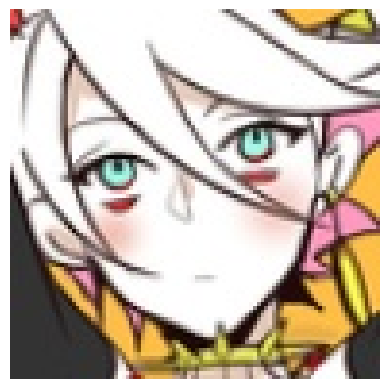

True Label: karna_(fate)
This image is likely belongs to:
> sakura_futaba : 9.42 % confidence.
> lancer : 8.75 % confidence.
> karna_(fate) : 8.24 % confidence.
> bremerton_(azur_lane) : 6.43 % confidence.
> sinon : 6.35 % confidence.


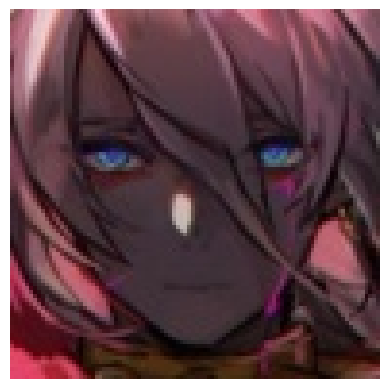

True Label: karna_(fate)
This image is likely belongs to:
> okita_souji_(fate) : 22.00 % confidence.
> shirogane_noel : 16.63 % confidence.
> astolfo_(fate) : 10.29 % confidence.
> shirakami_fubuki : 6.71 % confidence.
> mash_kyrielight : 6.19 % confidence.


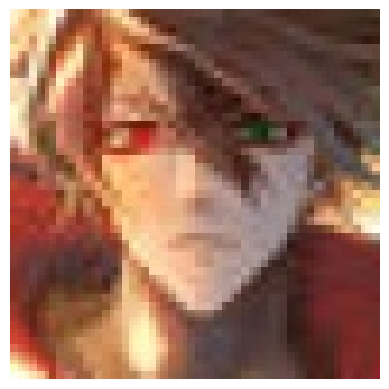

True Label: karna_(fate)
This image is likely belongs to:
> gilgamesh : 38.42 % confidence.
> shirogane_naoto : 15.71 % confidence.
> jonathan_joestar : 9.32 % confidence.
> giorno_giovanna : 4.94 % confidence.
> fubuki_(one-punch_man) : 4.28 % confidence.


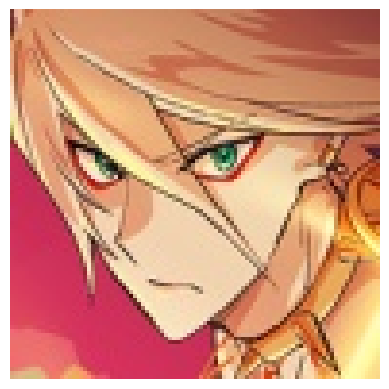

True Label: karna_(fate)
This image is likely belongs to:
> karna_(fate) : 12.32 % confidence.
> bremerton_(azur_lane) : 7.57 % confidence.
> giorno_giovanna : 5.40 % confidence.
> lancer : 4.48 % confidence.
> st_ar-15_(girls_frontline) : 4.11 % confidence.


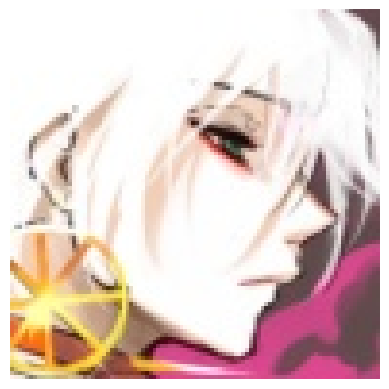

True Label: karna_(fate)
This image is likely belongs to:
> arcueid_brunestud : 14.69 % confidence.
> mash_kyrielight : 9.41 % confidence.
> laffey_(azur_lane) : 8.10 % confidence.
> karna_(fate) : 5.19 % confidence.
> ryougi_shiki : 4.40 % confidence.


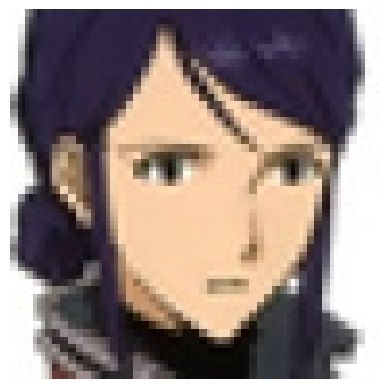

True Label: katsuragi_misato
This image is likely belongs to:
> katsuragi_misato : 46.05 % confidence.
> nico_robin : 7.05 % confidence.
> hyuuga_hinata : 6.47 % confidence.
> jonathan_joestar : 4.93 % confidence.
> lancer : 4.49 % confidence.


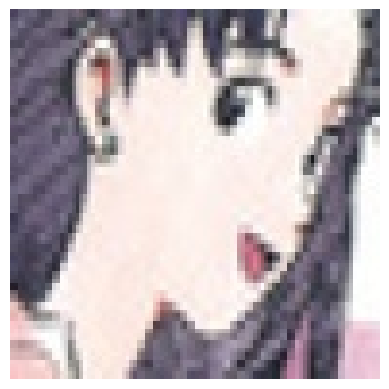

True Label: katsuragi_misato
This image is likely belongs to:
> katsuragi_misato : 65.44 % confidence.
> lancer : 4.37 % confidence.
> giorno_giovanna : 2.83 % confidence.
> abigail_williams_(fate) : 2.81 % confidence.
> kochou_shinobu : 2.01 % confidence.


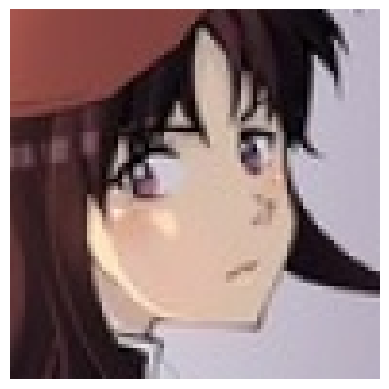

True Label: katsuragi_misato
This image is likely belongs to:
> chitanda_eru : 11.37 % confidence.
> takao_(azur_lane) : 7.40 % confidence.
> ninomae_ina'nis : 5.34 % confidence.
> yukinoshita_yukino : 4.68 % confidence.
> katsuragi_misato : 4.37 % confidence.


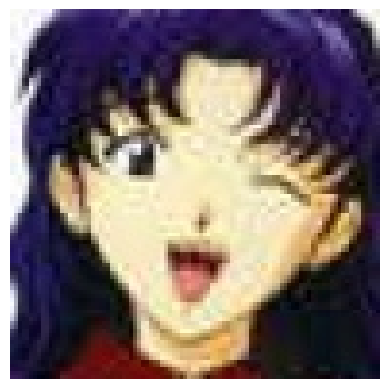

True Label: katsuragi_misato
This image is likely belongs to:
> katsuragi_misato : 38.62 % confidence.
> kanbaru_suruga : 8.32 % confidence.
> tsushima_yoshiko : 6.19 % confidence.
> hyuuga_hinata : 5.78 % confidence.
> shirogane_naoto : 5.47 % confidence.


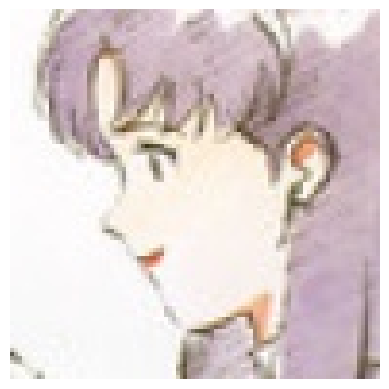

True Label: katsuragi_misato
This image is likely belongs to:
> katsuragi_misato : 42.78 % confidence.
> ayanami_rei : 7.48 % confidence.
> satonaka_chie : 5.72 % confidence.
> c.c : 3.24 % confidence.
> matou_sakura : 3.00 % confidence.


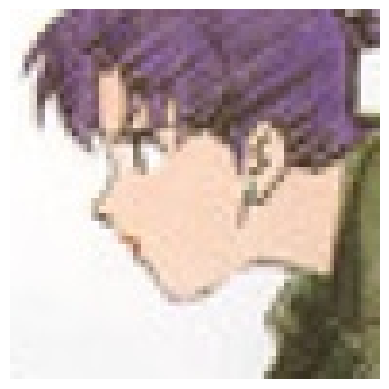

True Label: katsuragi_misato
This image is likely belongs to:
> lancer : 7.99 % confidence.
> meltlilith : 7.46 % confidence.
> jonathan_joestar : 7.34 % confidence.
> fujibayashi_kyou : 6.18 % confidence.
> kochou_shinobu : 6.13 % confidence.


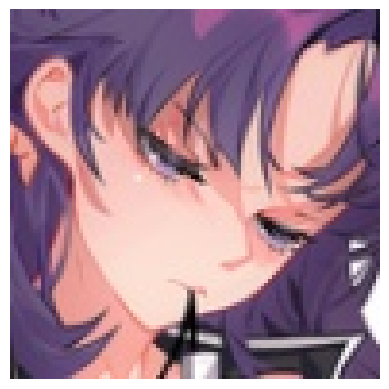

True Label: katsuragi_misato
This image is likely belongs to:
> ayanami_rei : 9.43 % confidence.
> shirogane_naoto : 5.04 % confidence.
> lancer : 4.02 % confidence.
> matou_sakura : 3.41 % confidence.
> fujibayashi_kyou : 3.13 % confidence.


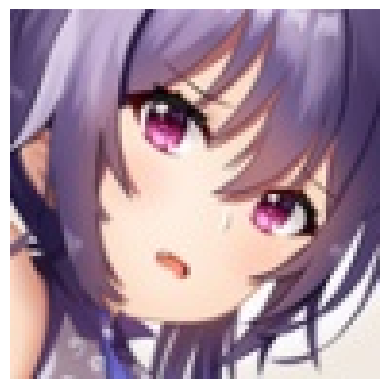

True Label: keqing_(genshin_impact)
This image is likely belongs to:
> nagato_yuki : 4.74 % confidence.
> keqing_(genshin_impact) : 4.59 % confidence.
> toujou_nozomi : 4.19 % confidence.
> sakurajima_mai : 3.66 % confidence.
> ouro_kronii : 3.46 % confidence.


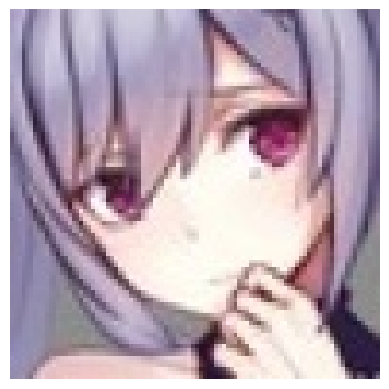

True Label: keqing_(genshin_impact)
This image is likely belongs to:
> laffey_(azur_lane) : 8.94 % confidence.
> tsushima_yoshiko : 4.70 % confidence.
> ichigo_(darling_in_the_franxx) : 4.16 % confidence.
> keqing_(genshin_impact) : 4.03 % confidence.
> kanbaru_suruga : 3.52 % confidence.


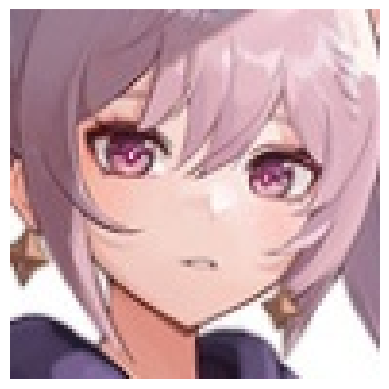

True Label: keqing_(genshin_impact)
This image is likely belongs to:
> satonaka_chie : 12.81 % confidence.
> yuigahama_yui : 5.32 % confidence.
> okita_souji_(fate) : 5.09 % confidence.
> ayanami_rei : 4.69 % confidence.
> isshiki_iroha : 3.94 % confidence.


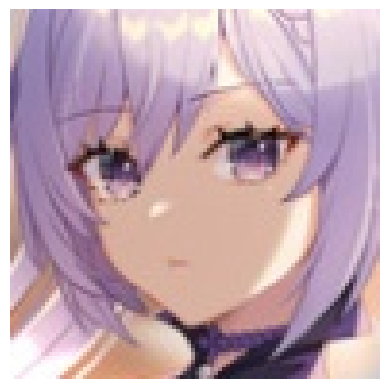

True Label: keqing_(genshin_impact)
This image is likely belongs to:
> nekomata_okayu : 9.26 % confidence.
> furukawa_nagisa : 7.05 % confidence.
> isshiki_iroha : 7.04 % confidence.
> yuigahama_yui : 5.15 % confidence.
> takarada_rikka : 4.29 % confidence.


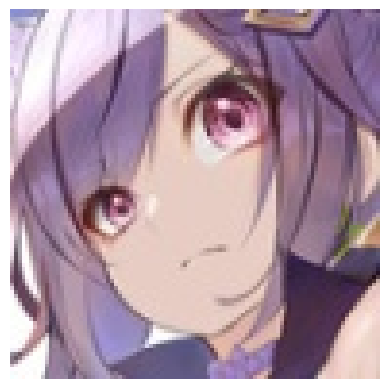

True Label: keqing_(genshin_impact)
This image is likely belongs to:
> chloe_von_einzbern : 12.78 % confidence.
> nishikino_maki : 4.45 % confidence.
> sakurauchi_riko : 4.00 % confidence.
> takamaki_anne : 3.48 % confidence.
> lancer : 3.05 % confidence.


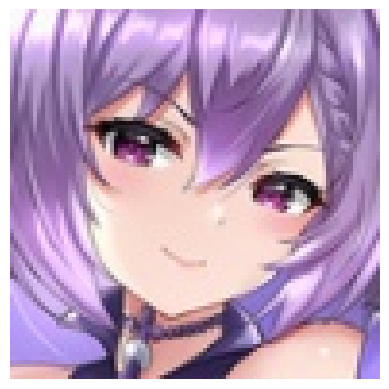

True Label: keqing_(genshin_impact)
This image is likely belongs to:
> nekomata_okayu : 11.84 % confidence.
> xenovia_(high_school_dxd) : 10.69 % confidence.
> fujibayashi_kyou : 5.11 % confidence.
> senjougahara_hitagi : 4.84 % confidence.
> keqing_(genshin_impact) : 3.97 % confidence.


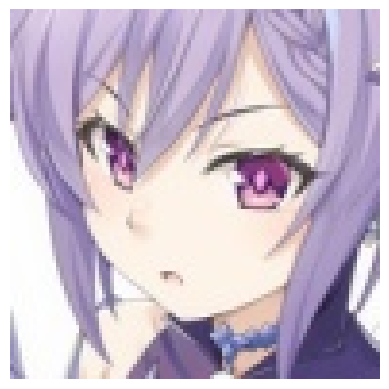

True Label: keqing_(genshin_impact)
This image is likely belongs to:
> keqing_(genshin_impact) : 11.16 % confidence.
> sakurajima_mai : 4.64 % confidence.
> usada_pekora : 3.19 % confidence.
> gilgamesh : 2.81 % confidence.
> atago_(azur_lane) : 2.65 % confidence.


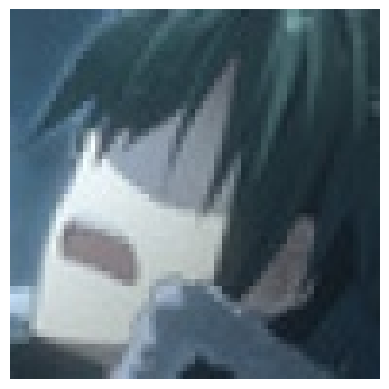

True Label: kirito
This image is likely belongs to:
> meltlilith : 5.79 % confidence.
> komi_shouko : 5.43 % confidence.
> ryougi_shiki : 4.28 % confidence.
> fubuki_(one-punch_man) : 3.72 % confidence.
> fujibayashi_kyou : 3.56 % confidence.


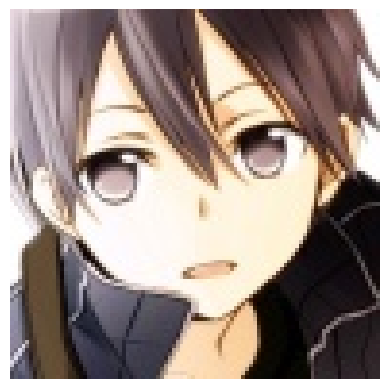

True Label: kirito
This image is likely belongs to:
> kirito : 8.10 % confidence.
> takao_(azur_lane) : 6.19 % confidence.
> suzumiya_haruhi : 4.21 % confidence.
> shidare_hotaru : 4.11 % confidence.
> nakano_azusa : 2.86 % confidence.


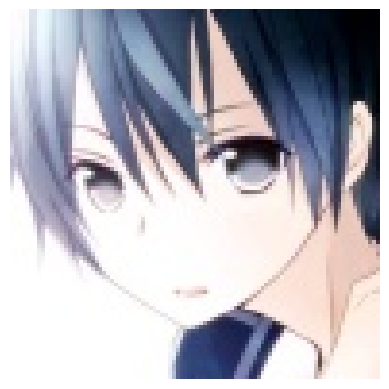

True Label: kirito
This image is likely belongs to:
> kirito : 26.66 % confidence.
> sakurajima_mai : 9.79 % confidence.
> nagato_yuki : 8.42 % confidence.
> yukinoshita_yukino : 3.64 % confidence.
> takanashi_rikka : 2.60 % confidence.


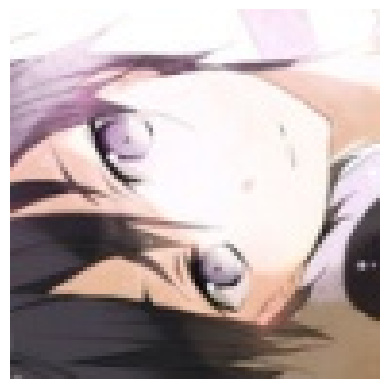

True Label: kirito
This image is likely belongs to:
> sengoku_nadeko : 9.75 % confidence.
> cleveland_(azur_lane) : 3.34 % confidence.
> takao_(azur_lane) : 3.12 % confidence.
> shishiro_botan : 3.07 % confidence.
> abigail_williams_(fate) : 3.06 % confidence.


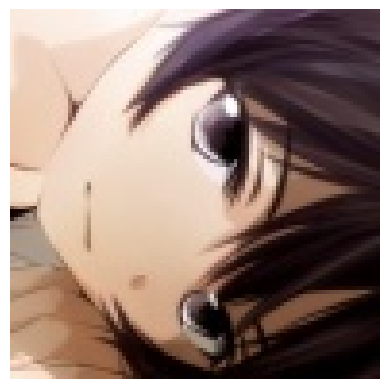

True Label: kirito
This image is likely belongs to:
> hirasawa_yui : 5.02 % confidence.
> kirito : 4.66 % confidence.
> sengoku_nadeko : 3.74 % confidence.
> furukawa_nagisa : 3.33 % confidence.
> ryougi_shiki : 2.98 % confidence.


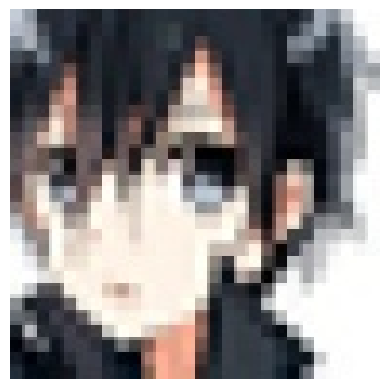

True Label: kirito
This image is likely belongs to:
> shirogane_naoto : 18.55 % confidence.
> kirito : 9.52 % confidence.
> kanbaru_suruga : 8.34 % confidence.
> takao_(azur_lane) : 8.24 % confidence.
> fubuki_(one-punch_man) : 7.48 % confidence.


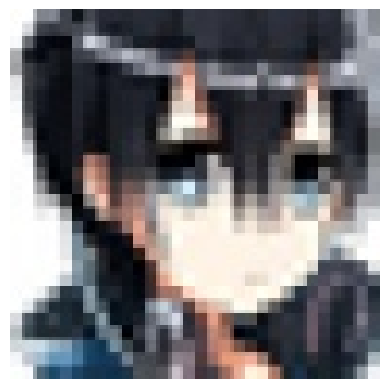

True Label: kirito
This image is likely belongs to:
> ninomae_ina'nis : 24.13 % confidence.
> aqua_(konosuba) : 8.68 % confidence.
> shirogane_naoto : 4.01 % confidence.
> anastasia_(idolmaster) : 3.97 % confidence.
> lancer : 3.88 % confidence.


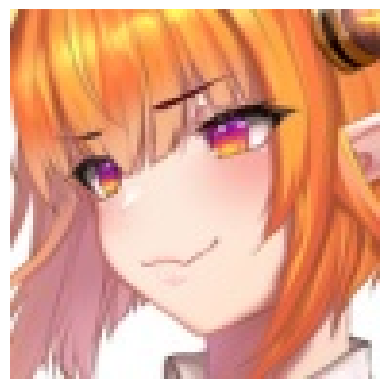

True Label: kiryu_coco
This image is likely belongs to:
> nami_(one_piece) : 16.55 % confidence.
> oshino_shinobu : 12.60 % confidence.
> watson_amelia : 6.26 % confidence.
> miyazono_kawori : 5.57 % confidence.
> gilgamesh : 5.10 % confidence.


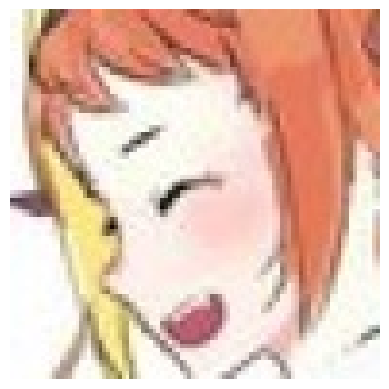

True Label: kiryu_coco
This image is likely belongs to:
> aegis_(persona) : 9.41 % confidence.
> hatsune_miku : 7.39 % confidence.
> sinon : 6.88 % confidence.
> aqua_(konosuba) : 5.35 % confidence.
> nishikino_maki : 3.80 % confidence.


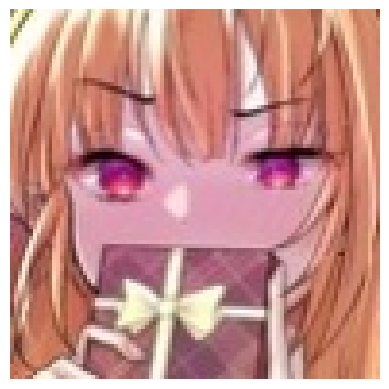

True Label: kiryu_coco
This image is likely belongs to:
> nekomata_okayu : 7.38 % confidence.
> raphtalia : 5.25 % confidence.
> tokoyami_towa : 4.82 % confidence.
> yuigahama_yui : 3.45 % confidence.
> fujibayashi_kyou : 3.37 % confidence.


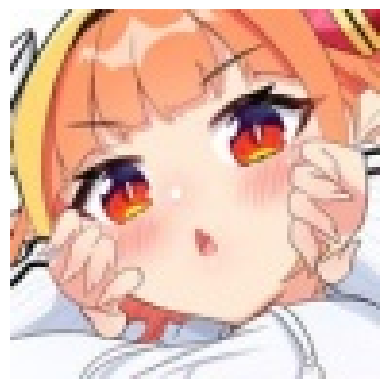

True Label: kiryu_coco
This image is likely belongs to:
> watson_amelia : 7.83 % confidence.
> usada_pekora : 7.02 % confidence.
> lancer : 4.30 % confidence.
> platelet_(hataraku_saibou) : 4.21 % confidence.
> belfast_(azur_lane) : 3.67 % confidence.


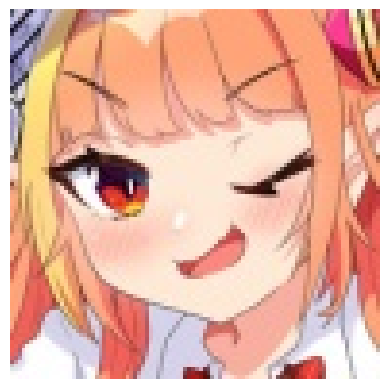

True Label: kiryu_coco
This image is likely belongs to:
> aegis_(persona) : 5.51 % confidence.
> yuigahama_yui : 5.32 % confidence.
> nami_(one_piece) : 5.04 % confidence.
> misaka_mikoto : 3.94 % confidence.
> hayasaka_ai : 3.85 % confidence.


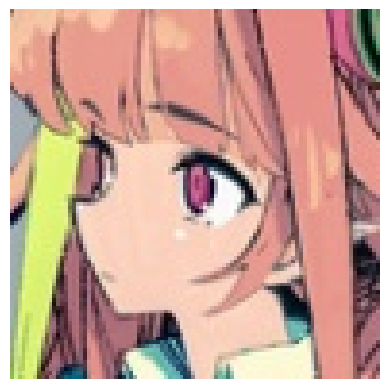

True Label: kiryu_coco
This image is likely belongs to:
> bremerton_(azur_lane) : 5.31 % confidence.
> abigail_williams_(fate) : 4.87 % confidence.
> sinon : 4.33 % confidence.
> astolfo_(fate) : 4.29 % confidence.
> suzumiya_haruhi : 4.21 % confidence.


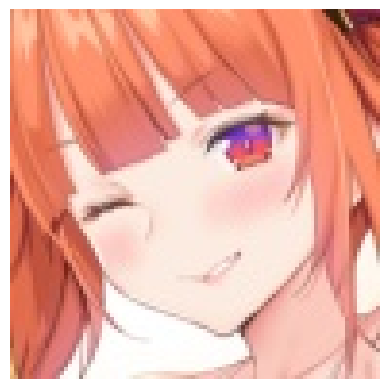

True Label: kiryu_coco
This image is likely belongs to:
> nakano_itsuki : 8.59 % confidence.
> gawr_gura : 4.32 % confidence.
> souryuu_asuka_langley : 3.83 % confidence.
> nakano_nino : 3.65 % confidence.
> watson_amelia : 3.20 % confidence.


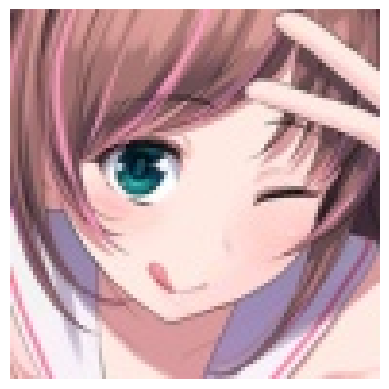

True Label: kizuna_ai
This image is likely belongs to:
> kizuna_ai : 16.10 % confidence.
> suzuhara_lulu : 11.92 % confidence.
> nakano_itsuki : 7.06 % confidence.
> ram_rezero : 6.60 % confidence.
> senjougahara_hitagi : 6.01 % confidence.


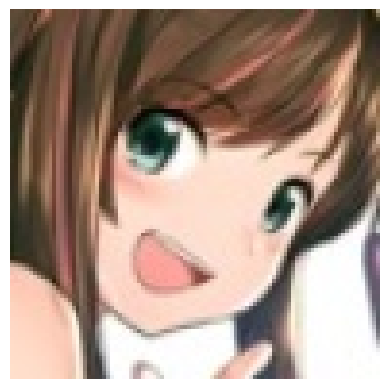

True Label: kizuna_ai
This image is likely belongs to:
> kizuna_ai : 13.36 % confidence.
> sengoku_nadeko : 6.54 % confidence.
> fujiwara_chika : 6.25 % confidence.
> takagi-san : 5.26 % confidence.
> senjougahara_hitagi : 3.84 % confidence.


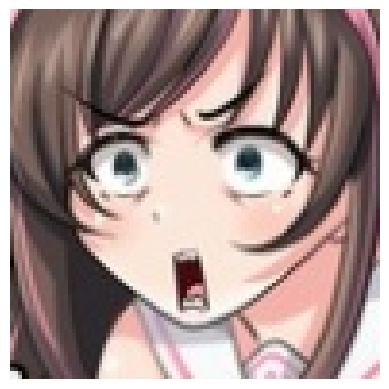

True Label: kizuna_ai
This image is likely belongs to:
> kizuna_ai : 30.19 % confidence.
> anastasia_(idolmaster) : 3.53 % confidence.
> mei_(pokemon) : 3.00 % confidence.
> suzumiya_haruhi : 2.94 % confidence.
> sakurajima_mai : 2.85 % confidence.


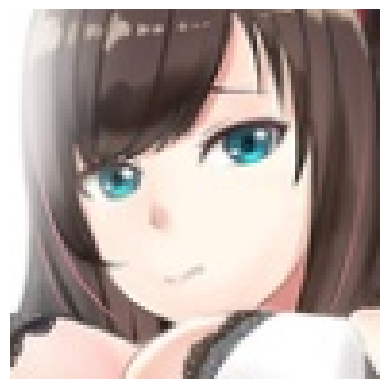

True Label: kizuna_ai
This image is likely belongs to:
> kizuna_ai : 15.90 % confidence.
> shuten_douji_(fate) : 6.65 % confidence.
> toujou_nozomi : 5.97 % confidence.
> utsumi_erise : 5.68 % confidence.
> suzuhara_lulu : 5.65 % confidence.


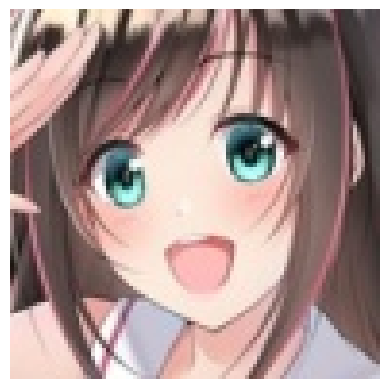

True Label: kizuna_ai
This image is likely belongs to:
> kizuna_ai : 47.60 % confidence.
> shibuya_rin : 3.04 % confidence.
> shirakami_fubuki : 2.79 % confidence.
> mei_(pokemon) : 2.52 % confidence.
> suzumiya_haruhi : 2.03 % confidence.


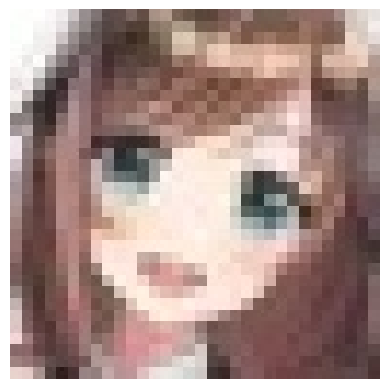

True Label: kizuna_ai
This image is likely belongs to:
> kiryu_coco : 18.69 % confidence.
> nami_(one_piece) : 14.03 % confidence.
> nakano_yotsuba : 7.32 % confidence.
> makise_kurisu : 6.13 % confidence.
> miyazono_kawori : 4.44 % confidence.


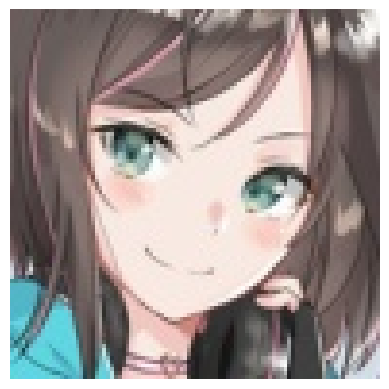

True Label: kizuna_ai
This image is likely belongs to:
> kizuna_ai : 26.85 % confidence.
> yukinoshita_yukino : 7.79 % confidence.
> sakurajima_mai : 5.90 % confidence.
> zero_two_(darling_in_the_franxx) : 5.63 % confidence.
> utsumi_erise : 3.21 % confidence.


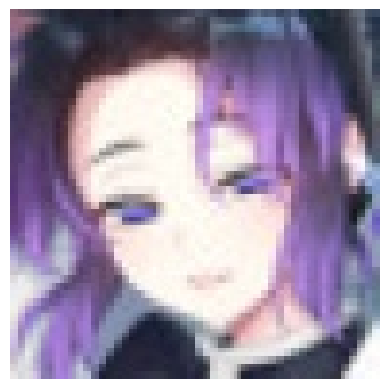

True Label: kochou_shinobu
This image is likely belongs to:
> kochou_shinobu : 53.22 % confidence.
> nagato_yuki : 2.94 % confidence.
> chitanda_eru : 2.29 % confidence.
> kaname_madoka : 1.76 % confidence.
> hyuuga_hinata : 1.54 % confidence.


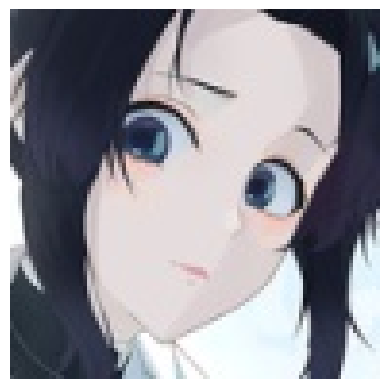

True Label: kochou_shinobu
This image is likely belongs to:
> shinomiya_kaguya : 9.82 % confidence.
> toosaka_rin : 5.32 % confidence.
> waver_velvet : 4.87 % confidence.
> watson_amelia : 3.59 % confidence.
> jonathan_joestar : 2.93 % confidence.


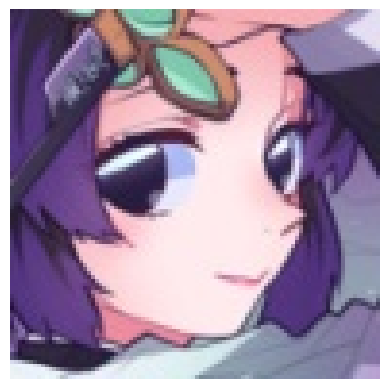

True Label: kochou_shinobu
This image is likely belongs to:
> kochou_shinobu : 5.92 % confidence.
> abigail_williams_(fate) : 5.22 % confidence.
> toujou_nozomi : 3.61 % confidence.
> lancer : 3.44 % confidence.
> mei_(pokemon) : 3.25 % confidence.


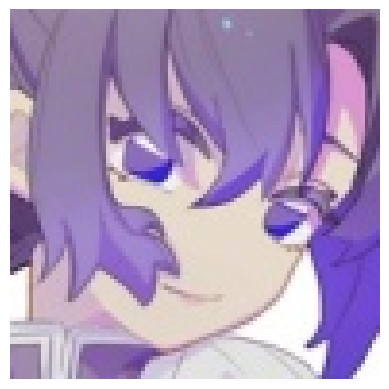

True Label: kochou_shinobu
This image is likely belongs to:
> c.c : 8.99 % confidence.
> senjougahara_hitagi : 4.96 % confidence.
> kochou_shinobu : 4.11 % confidence.
> kaname_madoka : 3.74 % confidence.
> shidare_hotaru : 3.57 % confidence.


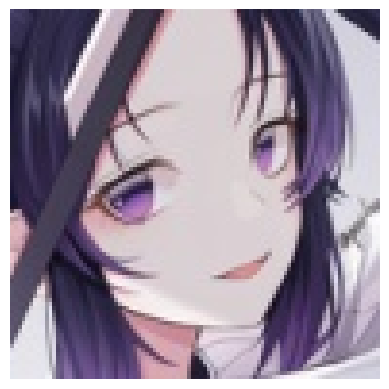

True Label: kochou_shinobu
This image is likely belongs to:
> kochou_shinobu : 7.10 % confidence.
> shinomiya_kaguya : 6.01 % confidence.
> rider : 4.15 % confidence.
> fubuki_(one-punch_man) : 3.88 % confidence.
> abigail_williams_(fate) : 2.77 % confidence.


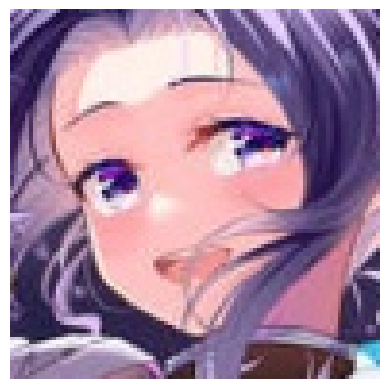

True Label: kochou_shinobu
This image is likely belongs to:
> kochou_shinobu : 14.74 % confidence.
> shidare_hotaru : 10.43 % confidence.
> gawr_gura : 4.81 % confidence.
> anastasia_(idolmaster) : 3.34 % confidence.
> hayasaka_ai : 2.80 % confidence.


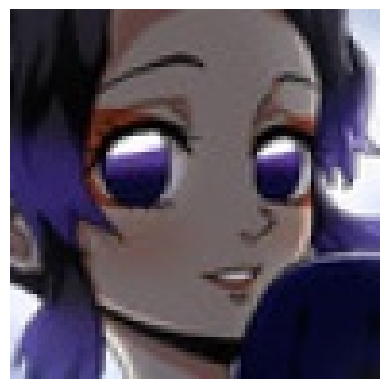

True Label: kochou_shinobu
This image is likely belongs to:
> abigail_williams_(fate) : 13.98 % confidence.
> nakano_miku : 12.79 % confidence.
> unicorn_(azur_lane) : 6.06 % confidence.
> kochou_shinobu : 2.94 % confidence.
> shuten_douji_(fate) : 2.40 % confidence.


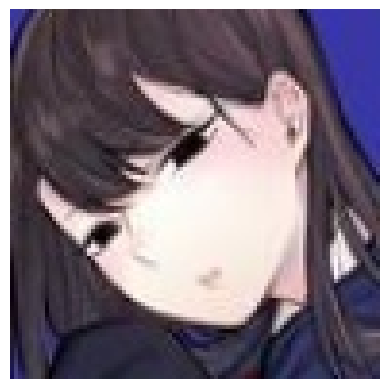

True Label: komi_shouko
This image is likely belongs to:
> atago_(azur_lane) : 18.91 % confidence.
> kirito : 11.71 % confidence.
> yukinoshita_yukino : 6.43 % confidence.
> shibuya_rin : 4.83 % confidence.
> takao_(azur_lane) : 3.83 % confidence.


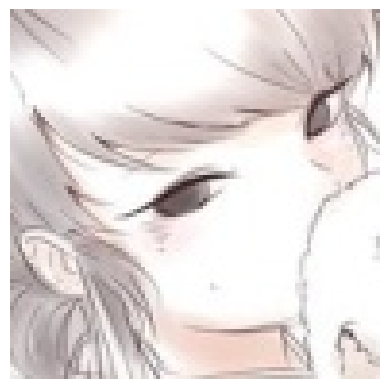

True Label: komi_shouko
This image is likely belongs to:
> nakano_miku : 11.37 % confidence.
> semiramis_(fate) : 5.99 % confidence.
> sakurajima_mai : 4.77 % confidence.
> atago_(azur_lane) : 3.55 % confidence.
> shuten_douji_(fate) : 3.49 % confidence.


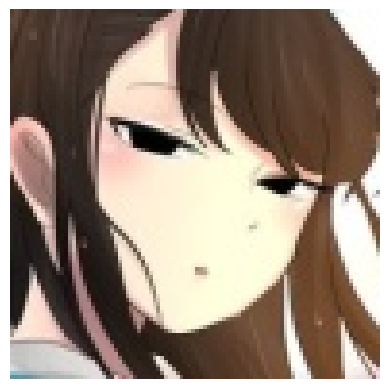

True Label: komi_shouko
This image is likely belongs to:
> atago_(azur_lane) : 10.10 % confidence.
> kirito : 4.09 % confidence.
> albedo : 3.55 % confidence.
> semiramis_(fate) : 3.45 % confidence.
> oshino_ougi : 3.08 % confidence.


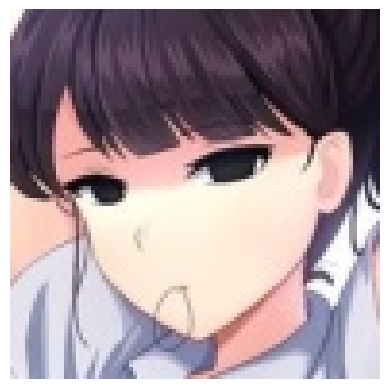

True Label: komi_shouko
This image is likely belongs to:
> komi_shouko : 39.79 % confidence.
> dido_(azur_lane) : 6.98 % confidence.
> formidable_(azur_lane) : 5.56 % confidence.
> megumin : 3.35 % confidence.
> takimoto_hifumi : 2.56 % confidence.


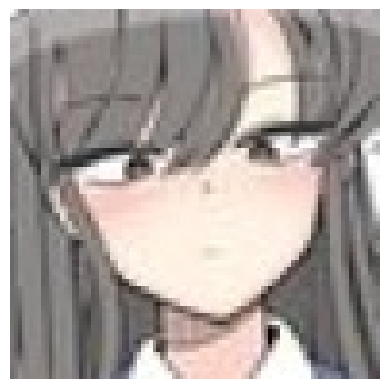

True Label: komi_shouko
This image is likely belongs to:
> komi_shouko : 16.18 % confidence.
> enterprise_(azur_lane) : 10.70 % confidence.
> semiramis_(fate) : 10.52 % confidence.
> takao_(azur_lane) : 6.78 % confidence.
> atago_(azur_lane) : 5.82 % confidence.


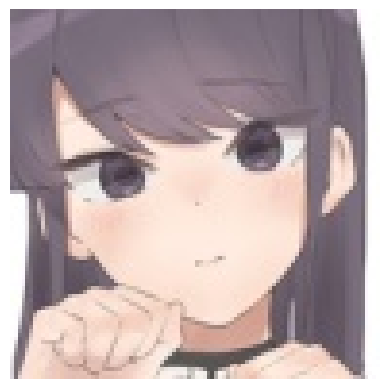

True Label: komi_shouko
This image is likely belongs to:
> ninomae_ina'nis : 5.68 % confidence.
> takimoto_hifumi : 5.54 % confidence.
> komi_shouko : 4.97 % confidence.
> shidare_hotaru : 3.76 % confidence.
> takamaki_anne : 3.51 % confidence.


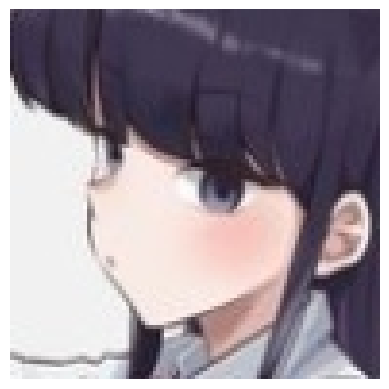

True Label: komi_shouko
This image is likely belongs to:
> komi_shouko : 42.36 % confidence.
> enterprise_(azur_lane) : 4.73 % confidence.
> formidable_(azur_lane) : 4.70 % confidence.
> takimoto_hifumi : 3.51 % confidence.
> shinomiya_kaguya : 3.38 % confidence.


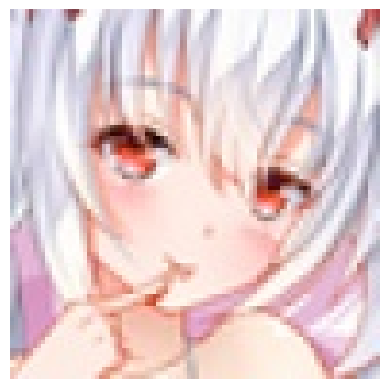

True Label: laffey_(azur_lane)
This image is likely belongs to:
> ayanami_rei : 20.29 % confidence.
> laffey_(azur_lane) : 7.61 % confidence.
> usada_pekora : 7.19 % confidence.
> mori_calliope : 4.38 % confidence.
> oshino_shinobu : 3.96 % confidence.


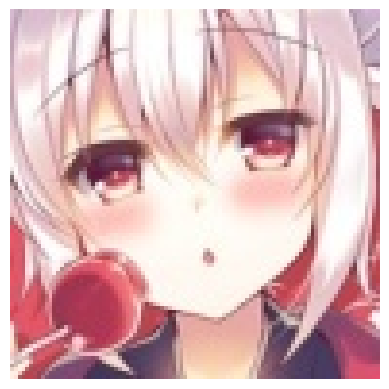

True Label: laffey_(azur_lane)
This image is likely belongs to:
> ishtar_(fate_grand_order) : 16.44 % confidence.
> laffey_(azur_lane) : 11.17 % confidence.
> super_sonico : 6.29 % confidence.
> formidable_(azur_lane) : 5.46 % confidence.
> shinomiya_kaguya : 5.41 % confidence.


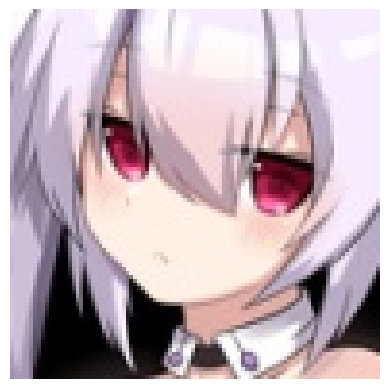

True Label: laffey_(azur_lane)
This image is likely belongs to:
> takanashi_rikka : 28.79 % confidence.
> shuten_douji_(fate) : 11.67 % confidence.
> shirakami_fubuki : 7.01 % confidence.
> shirogane_noel : 4.94 % confidence.
> formidable_(azur_lane) : 3.13 % confidence.


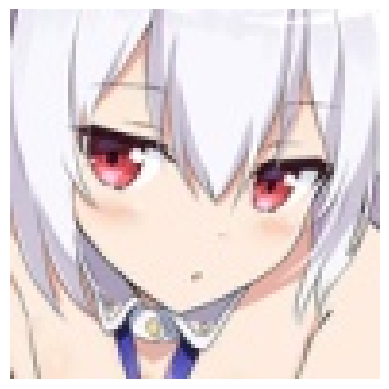

True Label: laffey_(azur_lane)
This image is likely belongs to:
> ayanami_rei : 7.13 % confidence.
> dido_(azur_lane) : 7.00 % confidence.
> bremerton_(azur_lane) : 6.78 % confidence.
> formidable_(azur_lane) : 6.63 % confidence.
> ram_rezero : 5.43 % confidence.


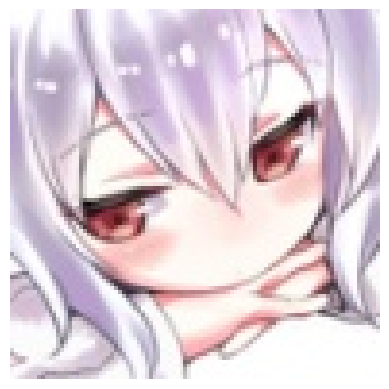

True Label: laffey_(azur_lane)
This image is likely belongs to:
> laffey_(azur_lane) : 25.85 % confidence.
> super_sonico : 6.63 % confidence.
> okita_souji_(fate) : 3.73 % confidence.
> illyasviel_von_einzbern : 3.64 % confidence.
> shishiro_botan : 2.65 % confidence.


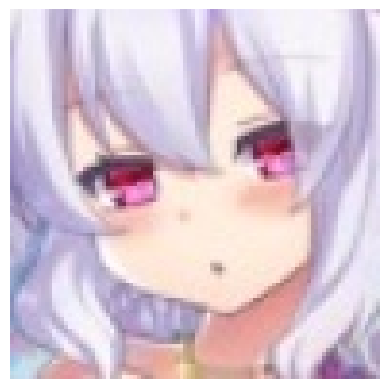

True Label: laffey_(azur_lane)
This image is likely belongs to:
> shirogane_noel : 19.70 % confidence.
> laffey_(azur_lane) : 15.26 % confidence.
> illyasviel_von_einzbern : 6.17 % confidence.
> usada_pekora : 6.09 % confidence.
> dido_(azur_lane) : 3.79 % confidence.


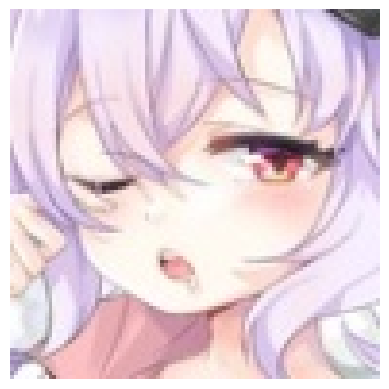

True Label: laffey_(azur_lane)
This image is likely belongs to:
> laffey_(azur_lane) : 44.61 % confidence.
> super_sonico : 7.79 % confidence.
> illyasviel_von_einzbern : 3.69 % confidence.
> usada_pekora : 3.39 % confidence.
> shishiro_botan : 3.38 % confidence.


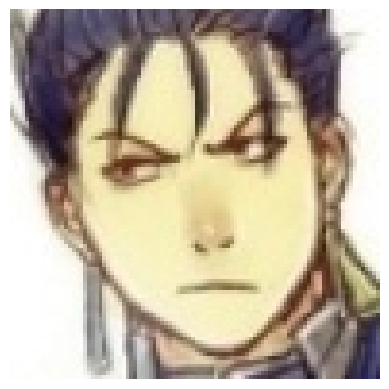

True Label: lancer
This image is likely belongs to:
> lancer : 55.53 % confidence.
> katsuragi_misato : 8.94 % confidence.
> semiramis_(fate) : 4.87 % confidence.
> belfast_(azur_lane) : 3.14 % confidence.
> hyuuga_hinata : 2.60 % confidence.


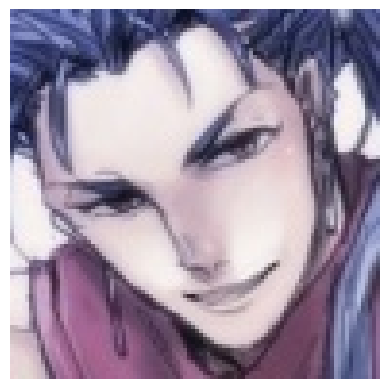

True Label: lancer
This image is likely belongs to:
> lancer : 52.93 % confidence.
> laffey_(azur_lane) : 8.48 % confidence.
> okita_souji_(fate) : 2.71 % confidence.
> shirogane_naoto : 2.10 % confidence.
> super_sonico : 1.97 % confidence.


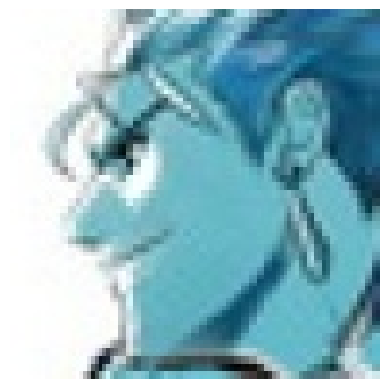

True Label: lancer
This image is likely belongs to:
> lancer : 62.60 % confidence.
> ayanami_rei : 7.50 % confidence.
> kochou_shinobu : 4.40 % confidence.
> takamaki_anne : 2.77 % confidence.
> jonathan_joestar : 1.87 % confidence.


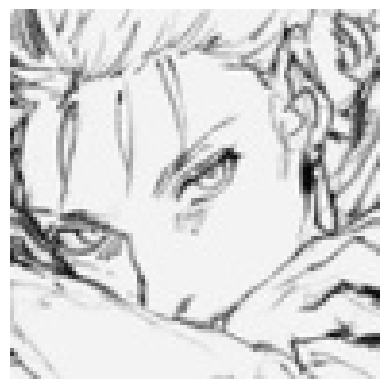

True Label: lancer
This image is likely belongs to:
> karna_(fate) : 28.29 % confidence.
> albedo : 4.56 % confidence.
> kirito : 4.36 % confidence.
> souryuu_asuka_langley : 4.31 % confidence.
> giorno_giovanna : 3.88 % confidence.


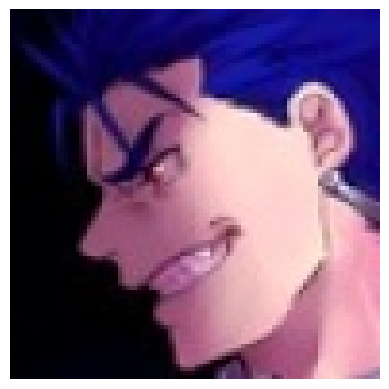

True Label: lancer
This image is likely belongs to:
> lancer : 15.45 % confidence.
> katsuragi_misato : 12.85 % confidence.
> kochou_shinobu : 6.04 % confidence.
> ayanami_rei : 4.22 % confidence.
> takarada_rikka : 3.65 % confidence.


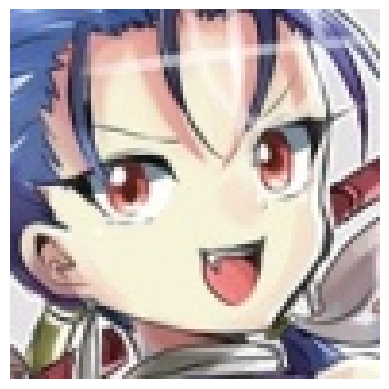

True Label: lancer
This image is likely belongs to:
> lancer : 12.63 % confidence.
> shidare_hotaru : 9.15 % confidence.
> aqua_(konosuba) : 8.31 % confidence.
> platelet_(hataraku_saibou) : 7.46 % confidence.
> gawr_gura : 5.07 % confidence.


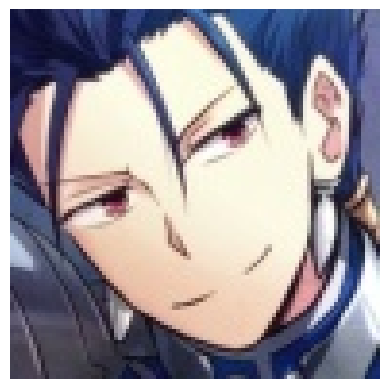

True Label: lancer
This image is likely belongs to:
> ishtar_(fate_grand_order) : 11.62 % confidence.
> oshino_ougi : 6.71 % confidence.
> lancer : 4.88 % confidence.
> sengoku_nadeko : 3.89 % confidence.
> semiramis_(fate) : 3.85 % confidence.


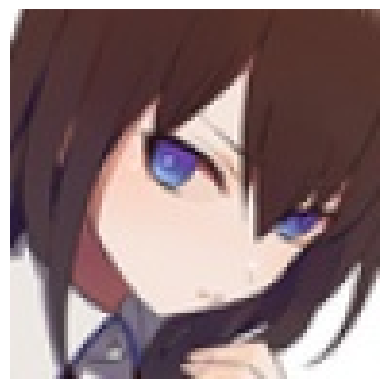

True Label: makise_kurisu
This image is likely belongs to:
> takanashi_rikka : 36.88 % confidence.
> kirito : 10.82 % confidence.
> nakano_azusa : 9.22 % confidence.
> ichigo_(darling_in_the_franxx) : 7.45 % confidence.
> nagato_yuki : 4.02 % confidence.


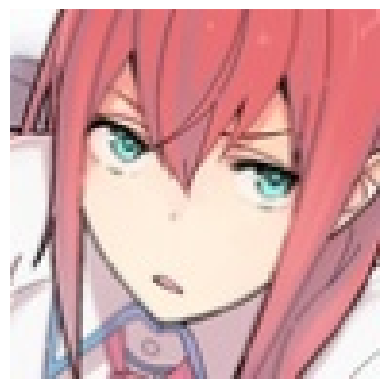

True Label: makise_kurisu
This image is likely belongs to:
> shirakami_fubuki : 9.03 % confidence.
> zero_two_(darling_in_the_franxx) : 7.79 % confidence.
> shishiro_botan : 6.47 % confidence.
> bremerton_(azur_lane) : 6.02 % confidence.
> astolfo_(fate) : 5.62 % confidence.


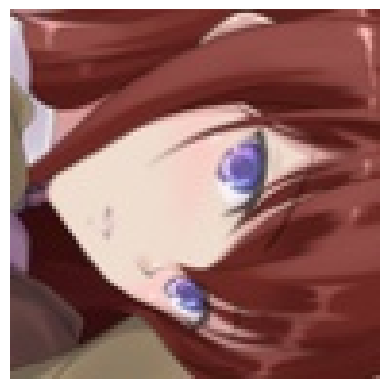

True Label: makise_kurisu
This image is likely belongs to:
> ichigo_(darling_in_the_franxx) : 15.87 % confidence.
> utsumi_erise : 15.26 % confidence.
> kirito : 4.80 % confidence.
> takarada_rikka : 4.63 % confidence.
> takanashi_rikka : 3.61 % confidence.


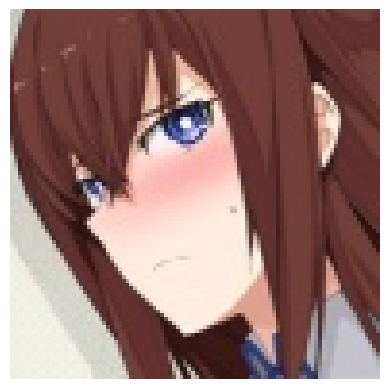

True Label: makise_kurisu
This image is likely belongs to:
> utsumi_erise : 10.87 % confidence.
> takanashi_rikka : 7.78 % confidence.
> makise_kurisu : 7.61 % confidence.
> ichigo_(darling_in_the_franxx) : 5.76 % confidence.
> nagato_yuki : 3.76 % confidence.


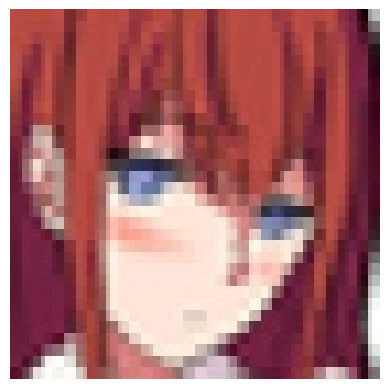

True Label: makise_kurisu
This image is likely belongs to:
> nakano_miku : 27.27 % confidence.
> makise_kurisu : 22.64 % confidence.
> suzuhara_lulu : 10.54 % confidence.
> rider : 4.98 % confidence.
> bremerton_(azur_lane) : 2.99 % confidence.


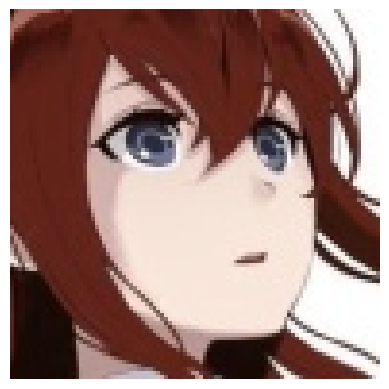

True Label: makise_kurisu
This image is likely belongs to:
> nami_(one_piece) : 11.40 % confidence.
> misaka_mikoto : 9.56 % confidence.
> asuna_(sao) : 3.54 % confidence.
> nishikino_maki : 3.51 % confidence.
> ninomae_ina'nis : 3.27 % confidence.


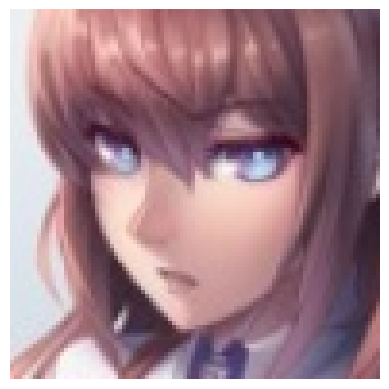

True Label: makise_kurisu
This image is likely belongs to:
> makise_kurisu : 11.26 % confidence.
> shibuya_rin : 10.69 % confidence.
> aegis_(persona) : 7.99 % confidence.
> rias_gremory : 5.57 % confidence.
> nami_(one_piece) : 2.56 % confidence.


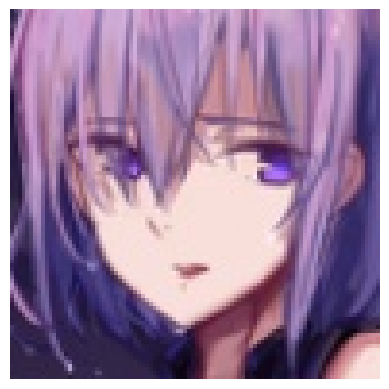

True Label: mash_kyrielight
This image is likely belongs to:
> st_ar-15_(girls_frontline) : 7.22 % confidence.
> oshino_ougi : 5.54 % confidence.
> keqing_(genshin_impact) : 3.99 % confidence.
> xenovia_(high_school_dxd) : 3.91 % confidence.
> mash_kyrielight : 3.50 % confidence.


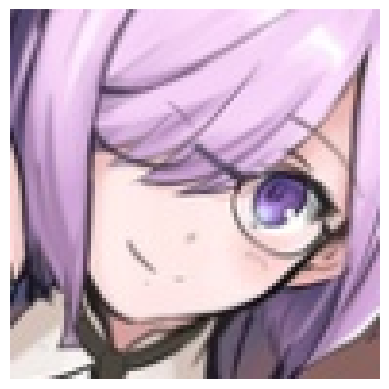

True Label: mash_kyrielight
This image is likely belongs to:
> mash_kyrielight : 75.41 % confidence.
> ram_rezero : 3.14 % confidence.
> tokoyami_towa : 3.08 % confidence.
> mori_calliope : 1.51 % confidence.
> bremerton_(azur_lane) : 1.45 % confidence.


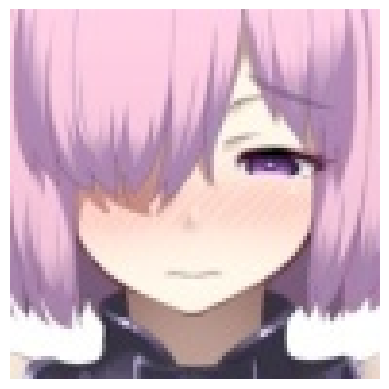

True Label: mash_kyrielight
This image is likely belongs to:
> meltlilith : 36.06 % confidence.
> ram_rezero : 9.82 % confidence.
> mash_kyrielight : 7.78 % confidence.
> rem_rezero : 4.61 % confidence.
> ichigo_(darling_in_the_franxx) : 4.40 % confidence.


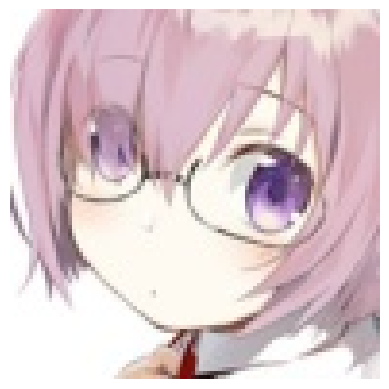

True Label: mash_kyrielight
This image is likely belongs to:
> kaname_madoka : 10.38 % confidence.
> unicorn_(azur_lane) : 7.48 % confidence.
> ram_rezero : 6.55 % confidence.
> laffey_(azur_lane) : 4.01 % confidence.
> mash_kyrielight : 3.31 % confidence.


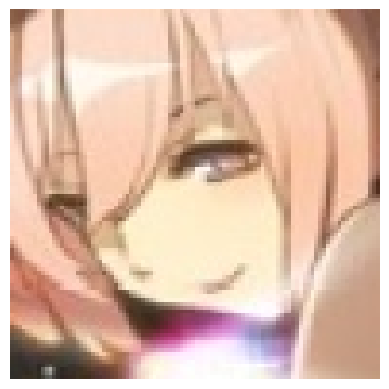

True Label: mash_kyrielight
This image is likely belongs to:
> shuten_douji_(fate) : 18.13 % confidence.
> okita_souji_(fate) : 9.49 % confidence.
> waver_velvet : 3.64 % confidence.
> enterprise_(azur_lane) : 3.64 % confidence.
> shirakami_fubuki : 3.59 % confidence.


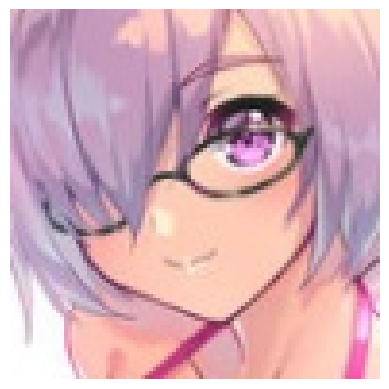

True Label: mash_kyrielight
This image is likely belongs to:
> meltlilith : 7.19 % confidence.
> senjougahara_hitagi : 6.39 % confidence.
> mash_kyrielight : 5.54 % confidence.
> zero_two_(darling_in_the_franxx) : 4.29 % confidence.
> nakano_itsuki : 3.46 % confidence.


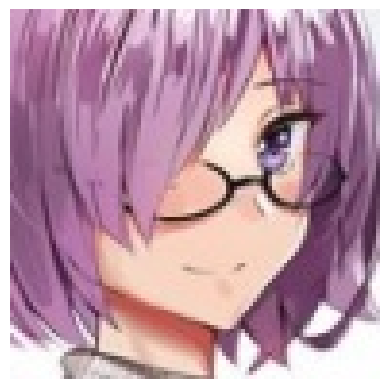

True Label: mash_kyrielight
This image is likely belongs to:
> mash_kyrielight : 23.09 % confidence.
> xenovia_(high_school_dxd) : 12.02 % confidence.
> meltlilith : 11.34 % confidence.
> takanashi_rikka : 5.85 % confidence.
> nagato_yuki : 4.73 % confidence.


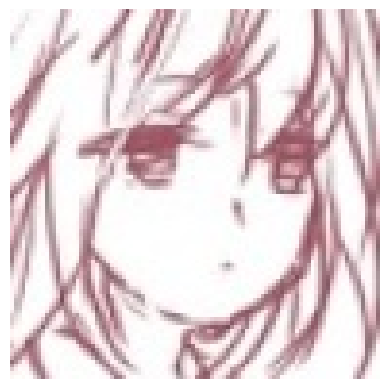

True Label: matou_sakura
This image is likely belongs to:
> suzuhara_lulu : 18.78 % confidence.
> astolfo_(fate) : 11.32 % confidence.
> shidare_hotaru : 4.86 % confidence.
> kaname_madoka : 4.42 % confidence.
> irisviel_von_einzbern : 3.06 % confidence.


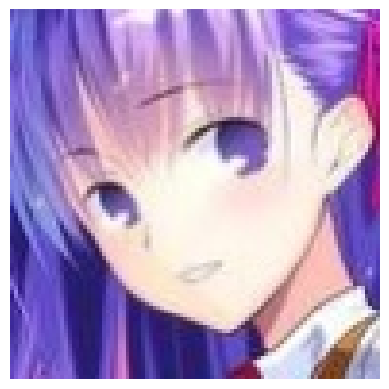

True Label: matou_sakura
This image is likely belongs to:
> matou_sakura : 7.57 % confidence.
> tsushima_yoshiko : 7.12 % confidence.
> belfast_(azur_lane) : 6.99 % confidence.
> minato_aqua : 6.20 % confidence.
> misaka_mikoto : 3.36 % confidence.


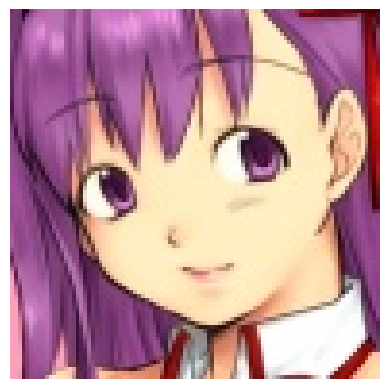

True Label: matou_sakura
This image is likely belongs to:
> yuigahama_yui : 11.59 % confidence.
> misaka_mikoto : 11.18 % confidence.
> matou_sakura : 5.68 % confidence.
> isshiki_iroha : 4.77 % confidence.
> nakano_nino : 3.53 % confidence.


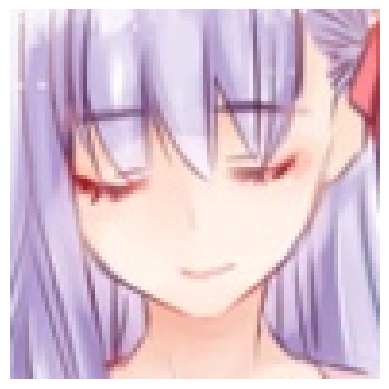

True Label: matou_sakura
This image is likely belongs to:
> ayanami_rei : 6.53 % confidence.
> matou_sakura : 6.46 % confidence.
> takao_(azur_lane) : 4.99 % confidence.
> c.c : 4.21 % confidence.
> shirogane_naoto : 4.00 % confidence.


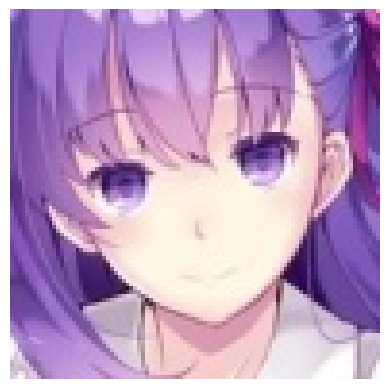

True Label: matou_sakura
This image is likely belongs to:
> minato_aqua : 23.47 % confidence.
> matou_sakura : 5.99 % confidence.
> isshiki_iroha : 4.94 % confidence.
> tokoyami_towa : 4.68 % confidence.
> nekomata_okayu : 4.46 % confidence.


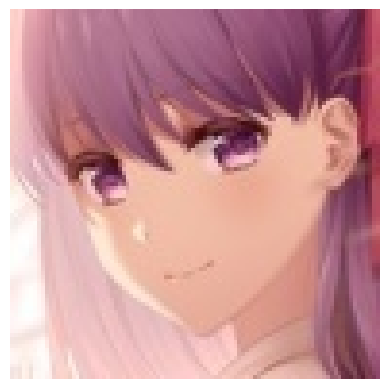

True Label: matou_sakura
This image is likely belongs to:
> takarada_rikka : 9.22 % confidence.
> nakano_nino : 4.60 % confidence.
> suzuhara_lulu : 4.30 % confidence.
> zero_two_(darling_in_the_franxx) : 4.11 % confidence.
> matou_sakura : 4.09 % confidence.


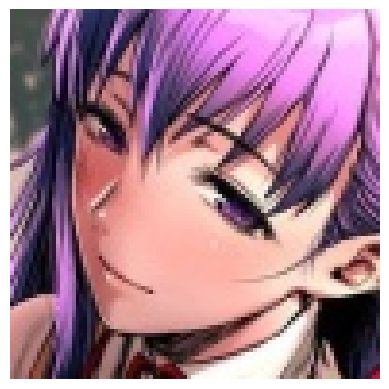

True Label: matou_sakura
This image is likely belongs to:
> matou_sakura : 4.02 % confidence.
> aegis_(persona) : 3.91 % confidence.
> tsushima_yoshiko : 3.89 % confidence.
> xenovia_(high_school_dxd) : 3.59 % confidence.
> belfast_(azur_lane) : 3.38 % confidence.


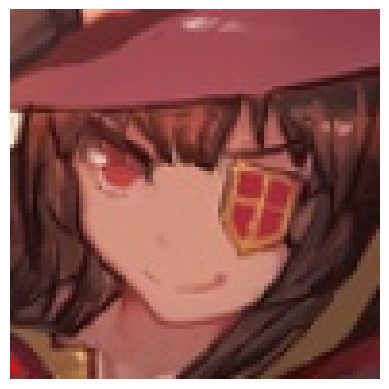

True Label: megumin
This image is likely belongs to:
> megumin : 17.65 % confidence.
> shuten_douji_(fate) : 4.45 % confidence.
> sengoku_nadeko : 4.24 % confidence.
> bremerton_(azur_lane) : 3.43 % confidence.
> fubuki_(one-punch_man) : 3.07 % confidence.


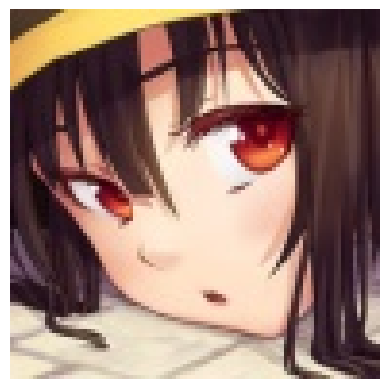

True Label: megumin
This image is likely belongs to:
> fubuki_(one-punch_man) : 21.27 % confidence.
> megumin : 7.03 % confidence.
> shinomiya_kaguya : 6.46 % confidence.
> taihou_(azur_lane) : 6.30 % confidence.
> sengoku_nadeko : 4.59 % confidence.


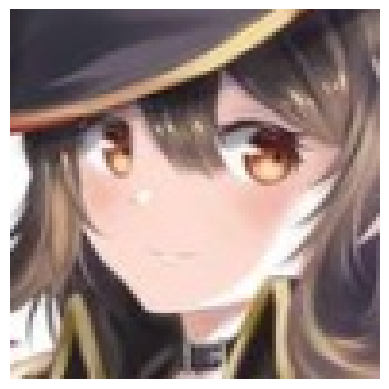

True Label: megumin
This image is likely belongs to:
> enterprise_(azur_lane) : 33.30 % confidence.
> albedo : 7.85 % confidence.
> megumin : 7.84 % confidence.
> takao_(azur_lane) : 5.47 % confidence.
> atago_(azur_lane) : 3.56 % confidence.


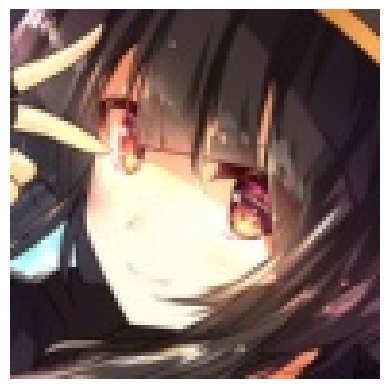

True Label: megumin
This image is likely belongs to:
> megumin : 29.62 % confidence.
> karin_(blue_archive) : 4.49 % confidence.
> shinomiya_kaguya : 4.08 % confidence.
> takao_(azur_lane) : 2.94 % confidence.
> oshino_ougi : 2.83 % confidence.


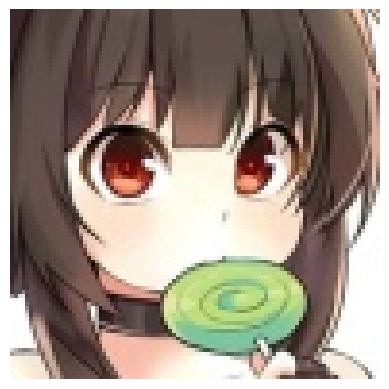

True Label: megumin
This image is likely belongs to:
> shirogane_noel : 13.47 % confidence.
> tokoyami_towa : 6.70 % confidence.
> raphtalia : 5.10 % confidence.
> tsushima_yoshiko : 4.39 % confidence.
> illyasviel_von_einzbern : 4.26 % confidence.


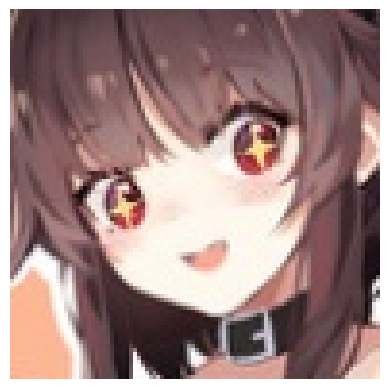

True Label: megumin
This image is likely belongs to:
> megumin : 7.01 % confidence.
> ninomae_ina'nis : 5.35 % confidence.
> komi_shouko : 3.87 % confidence.
> sakurajima_mai : 3.69 % confidence.
> sengoku_nadeko : 3.59 % confidence.


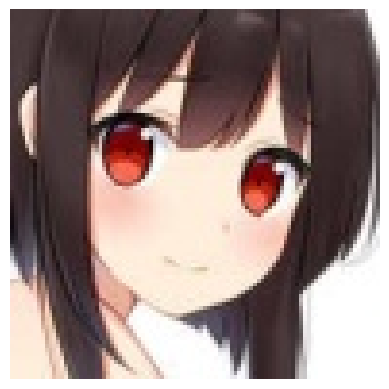

True Label: megumin
This image is likely belongs to:
> illyasviel_von_einzbern : 9.14 % confidence.
> toosaka_rin : 4.33 % confidence.
> utsumi_erise : 4.30 % confidence.
> fujiwara_chika : 3.75 % confidence.
> nakano_yotsuba : 3.39 % confidence.


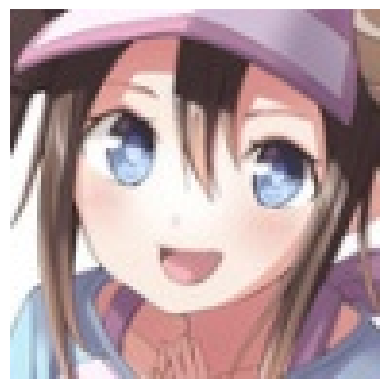

True Label: mei_(pokemon)
This image is likely belongs to:
> mei_(pokemon) : 38.24 % confidence.
> platelet_(hataraku_saibou) : 21.33 % confidence.
> bremerton_(azur_lane) : 5.28 % confidence.
> takagi-san : 2.83 % confidence.
> hayasaka_ai : 2.10 % confidence.


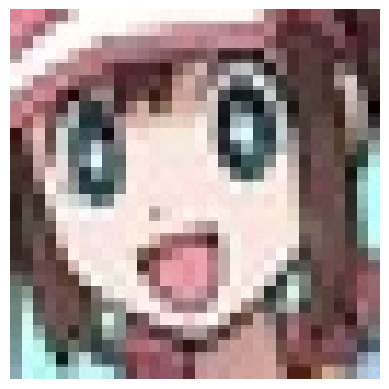

True Label: mei_(pokemon)
This image is likely belongs to:
> mei_(pokemon) : 20.40 % confidence.
> sengoku_nadeko : 5.18 % confidence.
> hatsune_miku : 4.43 % confidence.
> gawr_gura : 3.95 % confidence.
> katsuragi_misato : 3.65 % confidence.


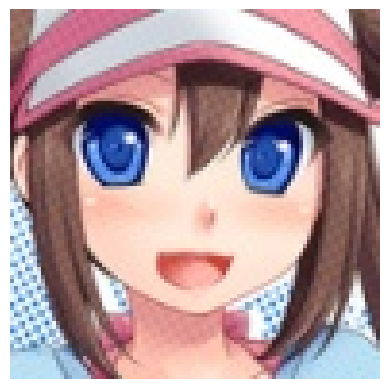

True Label: mei_(pokemon)
This image is likely belongs to:
> hayasaka_ai : 10.53 % confidence.
> mei_(pokemon) : 6.65 % confidence.
> shibuya_rin : 5.94 % confidence.
> nico_robin : 5.35 % confidence.
> shinomiya_kaguya : 5.00 % confidence.


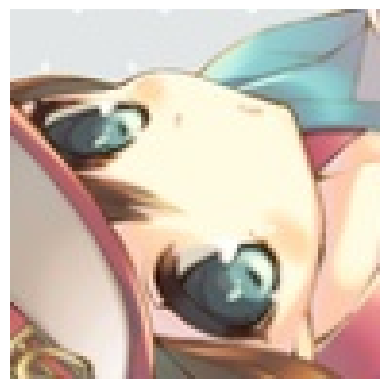

True Label: mei_(pokemon)
This image is likely belongs to:
> nakano_miku : 44.92 % confidence.
> utsumi_erise : 10.39 % confidence.
> paimon_(genshin_impact) : 3.81 % confidence.
> abigail_williams_(fate) : 2.85 % confidence.
> asia_argento : 2.20 % confidence.


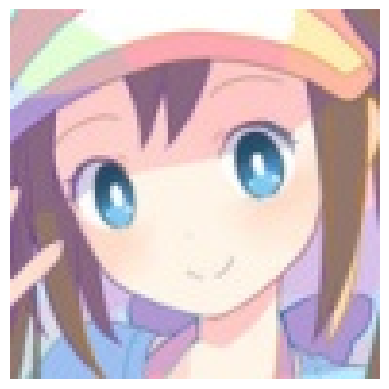

True Label: mei_(pokemon)
This image is likely belongs to:
> mei_(pokemon) : 43.63 % confidence.
> kizuna_ai : 9.94 % confidence.
> takagi-san : 4.78 % confidence.
> hatsune_miku : 2.55 % confidence.
> toujou_nozomi : 2.44 % confidence.


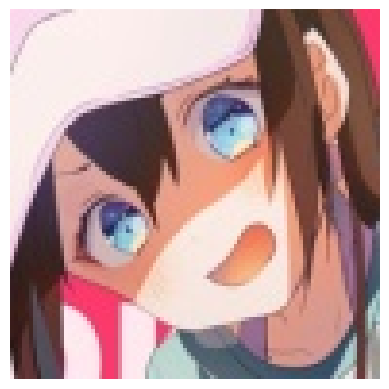

True Label: mei_(pokemon)
This image is likely belongs to:
> mei_(pokemon) : 11.16 % confidence.
> abigail_williams_(fate) : 7.45 % confidence.
> hirasawa_yui : 4.51 % confidence.
> oshino_shinobu : 4.06 % confidence.
> sengoku_nadeko : 3.96 % confidence.


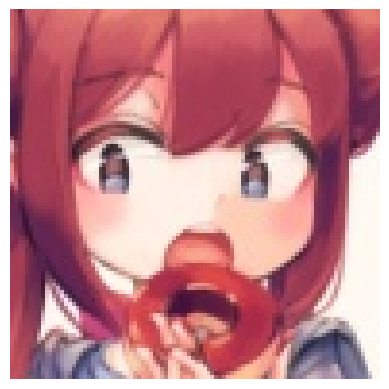

True Label: mei_(pokemon)
This image is likely belongs to:
> platelet_(hataraku_saibou) : 9.47 % confidence.
> aqua_(konosuba) : 6.62 % confidence.
> suzumiya_haruhi : 4.71 % confidence.
> yuigahama_yui : 4.62 % confidence.
> gawr_gura : 4.07 % confidence.


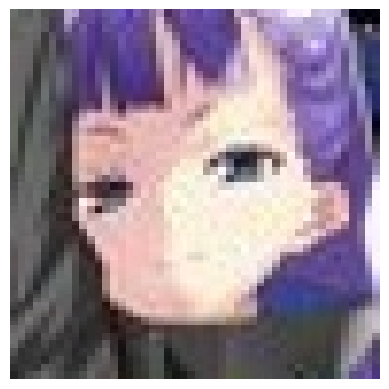

True Label: meltlilith
This image is likely belongs to:
> shirakami_fubuki : 16.89 % confidence.
> shidare_hotaru : 6.88 % confidence.
> nakano_nino : 6.72 % confidence.
> toosaka_rin : 5.10 % confidence.
> zero_two_(darling_in_the_franxx) : 4.54 % confidence.


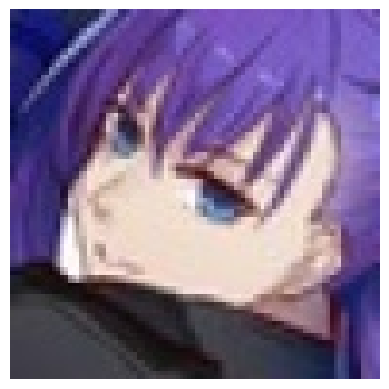

True Label: meltlilith
This image is likely belongs to:
> meltlilith : 72.79 % confidence.
> xenovia_(high_school_dxd) : 8.18 % confidence.
> mash_kyrielight : 5.05 % confidence.
> tokoyami_towa : 2.41 % confidence.
> takanashi_rikka : 1.49 % confidence.


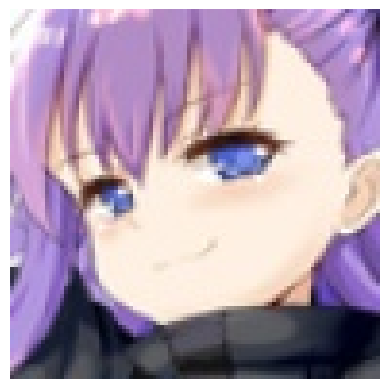

True Label: meltlilith
This image is likely belongs to:
> meltlilith : 10.59 % confidence.
> lancer : 10.31 % confidence.
> okita_souji_(fate) : 6.59 % confidence.
> st_ar-15_(girls_frontline) : 4.93 % confidence.
> nekomata_okayu : 4.02 % confidence.


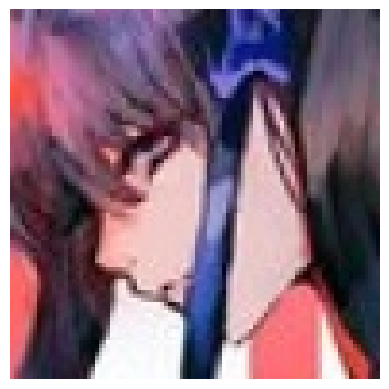

True Label: meltlilith
This image is likely belongs to:
> albedo : 29.20 % confidence.
> karna_(fate) : 8.03 % confidence.
> st_ar-15_(girls_frontline) : 6.30 % confidence.
> ryougi_shiki : 4.20 % confidence.
> yukinoshita_yukino : 3.51 % confidence.


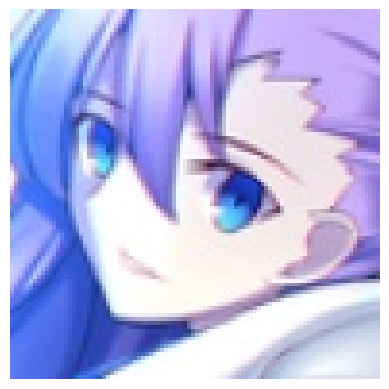

True Label: meltlilith
This image is likely belongs to:
> sinon : 11.99 % confidence.
> ichigo_(darling_in_the_franxx) : 8.04 % confidence.
> meltlilith : 7.65 % confidence.
> kanbaru_suruga : 7.58 % confidence.
> kirito : 3.84 % confidence.


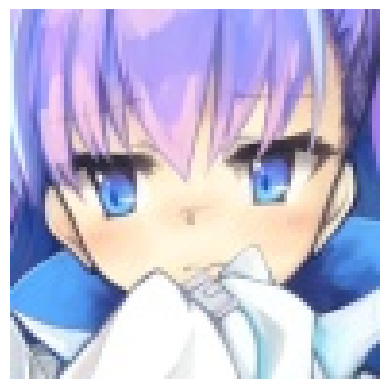

True Label: meltlilith
This image is likely belongs to:
> meltlilith : 19.01 % confidence.
> minato_aqua : 12.87 % confidence.
> matou_sakura : 5.57 % confidence.
> nekomata_okayu : 5.41 % confidence.
> unicorn_(azur_lane) : 5.04 % confidence.


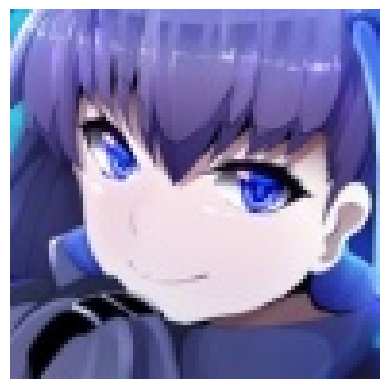

True Label: meltlilith
This image is likely belongs to:
> meltlilith : 28.84 % confidence.
> minato_aqua : 16.12 % confidence.
> rem_rezero : 9.85 % confidence.
> ram_rezero : 8.56 % confidence.
> nakano_itsuki : 5.12 % confidence.


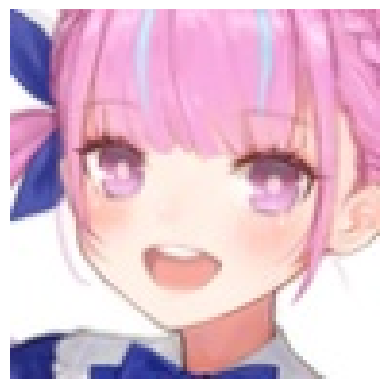

True Label: minato_aqua
This image is likely belongs to:
> minato_aqua : 27.11 % confidence.
> yuigahama_yui : 5.88 % confidence.
> nakano_nino : 5.65 % confidence.
> tokoyami_towa : 5.03 % confidence.
> satonaka_chie : 4.36 % confidence.


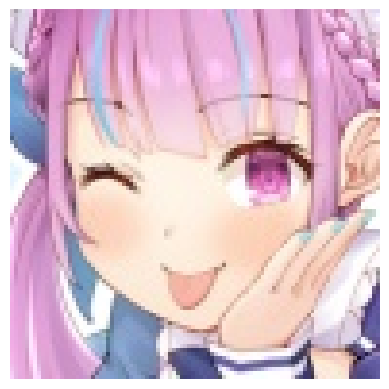

True Label: minato_aqua
This image is likely belongs to:
> minato_aqua : 28.36 % confidence.
> nekomata_okayu : 9.19 % confidence.
> tokoyami_towa : 7.04 % confidence.
> meltlilith : 5.39 % confidence.
> nakano_nino : 4.55 % confidence.


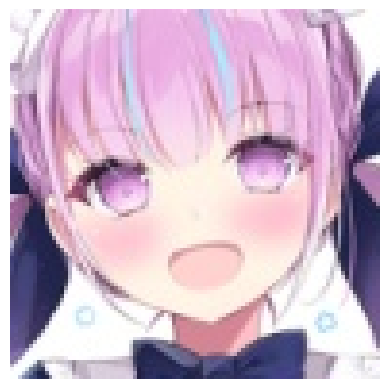

True Label: minato_aqua
This image is likely belongs to:
> minato_aqua : 35.77 % confidence.
> yuigahama_yui : 4.36 % confidence.
> kaname_madoka : 3.68 % confidence.
> tokoyami_towa : 3.42 % confidence.
> ram_rezero : 3.24 % confidence.


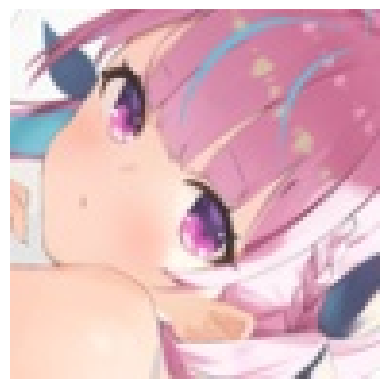

True Label: minato_aqua
This image is likely belongs to:
> minato_aqua : 5.04 % confidence.
> komi_shouko : 4.65 % confidence.
> nakano_nino : 3.10 % confidence.
> st_ar-15_(girls_frontline) : 3.09 % confidence.
> nakano_itsuki : 2.95 % confidence.


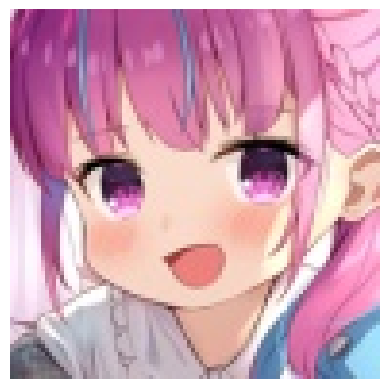

True Label: minato_aqua
This image is likely belongs to:
> minato_aqua : 22.37 % confidence.
> fujibayashi_kyou : 6.77 % confidence.
> tokoyami_towa : 6.69 % confidence.
> meltlilith : 5.14 % confidence.
> matou_sakura : 4.23 % confidence.


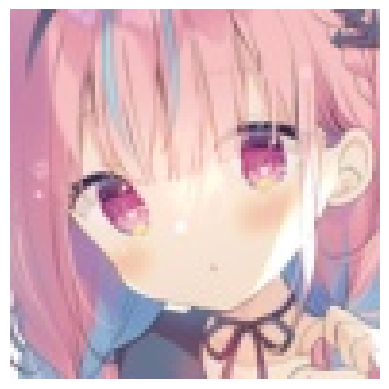

True Label: minato_aqua
This image is likely belongs to:
> rem_rezero : 10.69 % confidence.
> kaname_madoka : 7.68 % confidence.
> tokoyami_towa : 7.55 % confidence.
> meltlilith : 7.24 % confidence.
> ram_rezero : 6.67 % confidence.


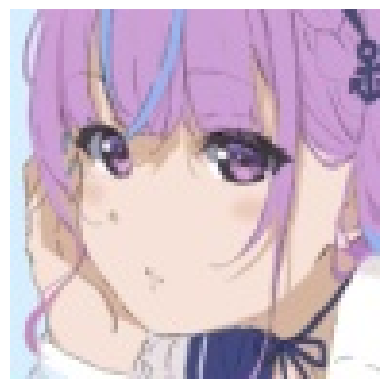

True Label: minato_aqua
This image is likely belongs to:
> minato_aqua : 14.24 % confidence.
> yuigahama_yui : 11.27 % confidence.
> isshiki_iroha : 8.22 % confidence.
> misaka_mikoto : 6.53 % confidence.
> senjougahara_hitagi : 3.97 % confidence.


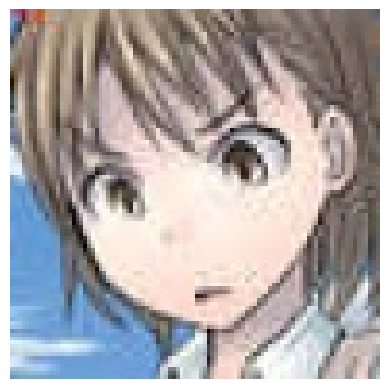

True Label: misaka_mikoto
This image is likely belongs to:
> chitanda_eru : 14.04 % confidence.
> takarada_rikka : 10.98 % confidence.
> nagato_yuki : 6.32 % confidence.
> yukinoshita_yukino : 4.34 % confidence.
> sakurajima_mai : 4.01 % confidence.


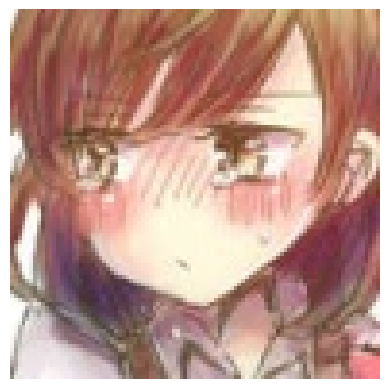

True Label: misaka_mikoto
This image is likely belongs to:
> dido_(azur_lane) : 9.99 % confidence.
> nakano_miku : 7.22 % confidence.
> laffey_(azur_lane) : 4.43 % confidence.
> bremerton_(azur_lane) : 3.89 % confidence.
> karna_(fate) : 3.33 % confidence.


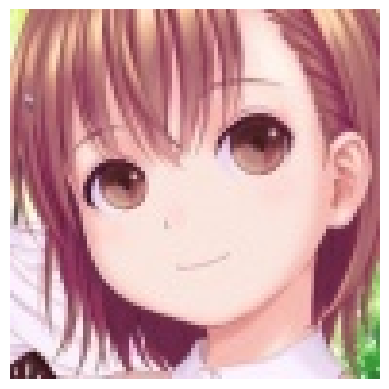

True Label: misaka_mikoto
This image is likely belongs to:
> misaka_mikoto : 7.45 % confidence.
> furukawa_nagisa : 6.69 % confidence.
> yuigahama_yui : 4.37 % confidence.
> shirogane_noel : 3.53 % confidence.
> nami_(one_piece) : 3.04 % confidence.


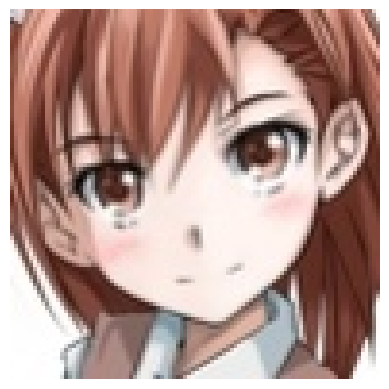

True Label: misaka_mikoto
This image is likely belongs to:
> misaka_mikoto : 16.06 % confidence.
> yuigahama_yui : 13.47 % confidence.
> nishikino_maki : 6.51 % confidence.
> rias_gremory : 4.32 % confidence.
> isshiki_iroha : 4.21 % confidence.


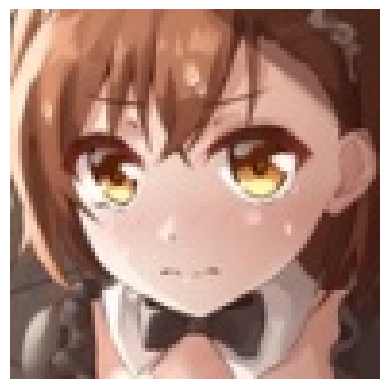

True Label: misaka_mikoto
This image is likely belongs to:
> isshiki_iroha : 44.53 % confidence.
> kiryu_coco : 5.51 % confidence.
> aisaka_taiga : 4.59 % confidence.
> yuigahama_yui : 3.56 % confidence.
> nakano_itsuki : 2.37 % confidence.


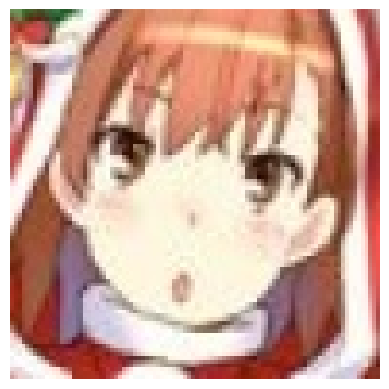

True Label: misaka_mikoto
This image is likely belongs to:
> ninomae_ina'nis : 30.85 % confidence.
> minato_aqua : 26.45 % confidence.
> kiryu_coco : 11.82 % confidence.
> asuna_(sao) : 2.04 % confidence.
> yuigahama_yui : 2.03 % confidence.


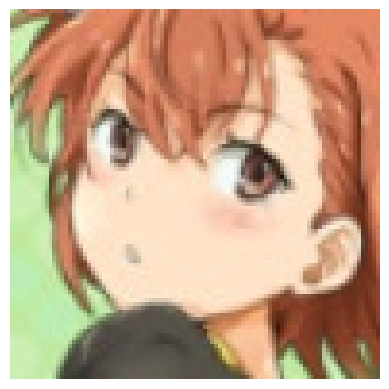

True Label: misaka_mikoto
This image is likely belongs to:
> misaka_mikoto : 21.14 % confidence.
> souryuu_asuka_langley : 8.55 % confidence.
> satonaka_chie : 4.80 % confidence.
> ouro_kronii : 3.93 % confidence.
> nakano_yotsuba : 3.56 % confidence.


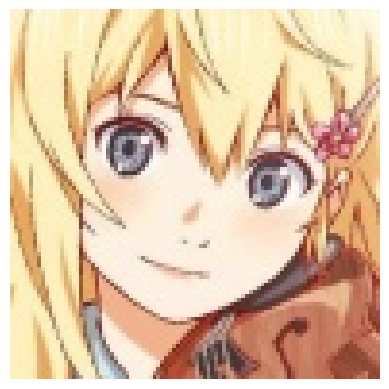

True Label: miyazono_kawori
This image is likely belongs to:
> aegis_(persona) : 10.66 % confidence.
> miyazono_kawori : 9.81 % confidence.
> sinon : 7.72 % confidence.
> giorno_giovanna : 5.62 % confidence.
> cleveland_(azur_lane) : 4.95 % confidence.


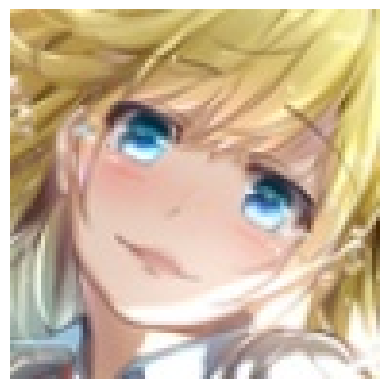

True Label: miyazono_kawori
This image is likely belongs to:
> watson_amelia : 21.60 % confidence.
> satonaka_chie : 9.98 % confidence.
> arcueid_brunestud : 9.20 % confidence.
> gilgamesh : 7.56 % confidence.
> meltlilith : 3.90 % confidence.


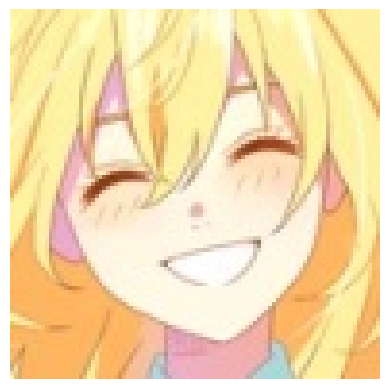

True Label: miyazono_kawori
This image is likely belongs to:
> nakano_yotsuba : 17.18 % confidence.
> makise_kurisu : 9.37 % confidence.
> shirakami_fubuki : 9.21 % confidence.
> nekomata_okayu : 7.23 % confidence.
> kiryu_coco : 6.68 % confidence.


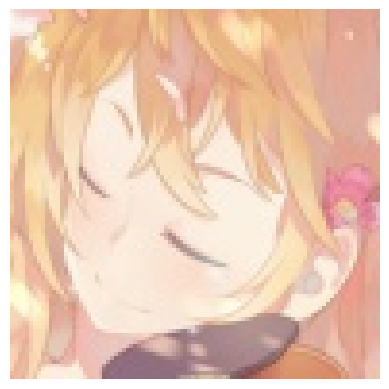

True Label: miyazono_kawori
This image is likely belongs to:
> karna_(fate) : 9.13 % confidence.
> kaname_madoka : 8.40 % confidence.
> gilgamesh : 6.52 % confidence.
> miyazono_kawori : 6.03 % confidence.
> oshino_shinobu : 6.02 % confidence.


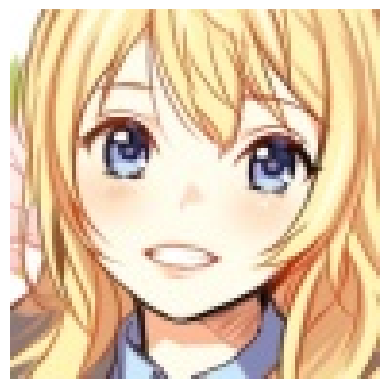

True Label: miyazono_kawori
This image is likely belongs to:
> miyazono_kawori : 15.56 % confidence.
> watson_amelia : 9.83 % confidence.
> asuna_(sao) : 8.98 % confidence.
> nami_(one_piece) : 6.87 % confidence.
> raphtalia : 3.83 % confidence.


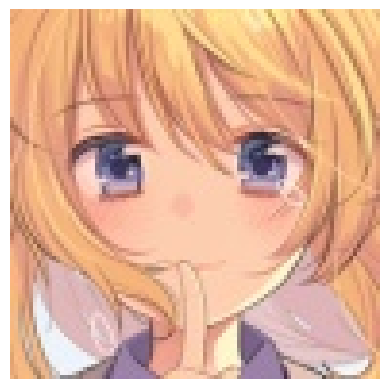

True Label: miyazono_kawori
This image is likely belongs to:
> watson_amelia : 21.62 % confidence.
> miyazono_kawori : 6.96 % confidence.
> furukawa_nagisa : 5.43 % confidence.
> satonaka_chie : 5.41 % confidence.
> oshino_shinobu : 5.15 % confidence.


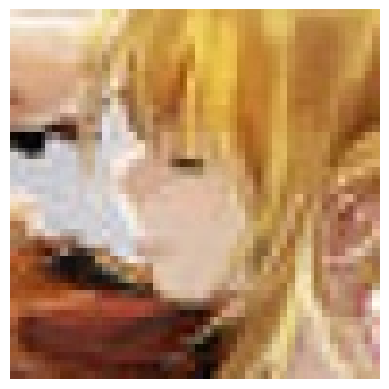

True Label: miyazono_kawori
This image is likely belongs to:
> karna_(fate) : 15.45 % confidence.
> souryuu_asuka_langley : 6.93 % confidence.
> st_ar-15_(girls_frontline) : 5.48 % confidence.
> albedo : 4.66 % confidence.
> miyazono_kawori : 3.06 % confidence.


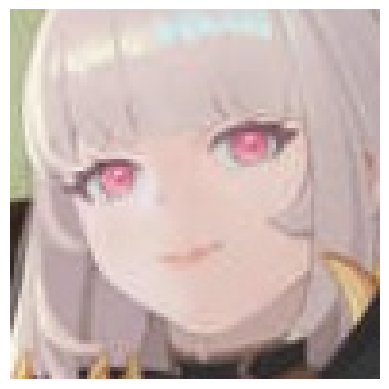

True Label: mori_calliope
This image is likely belongs to:
> mori_calliope : 29.62 % confidence.
> formidable_(azur_lane) : 11.42 % confidence.
> kamado_nezuko : 6.76 % confidence.
> ninomae_ina'nis : 4.45 % confidence.
> dido_(azur_lane) : 4.00 % confidence.


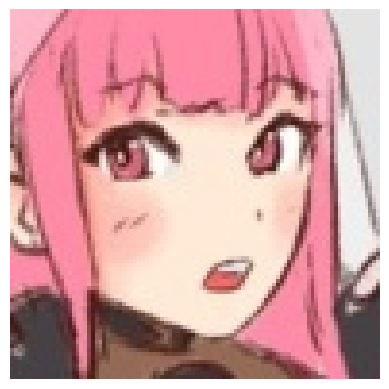

True Label: mori_calliope
This image is likely belongs to:
> mori_calliope : 10.19 % confidence.
> megumin : 4.77 % confidence.
> shinomiya_kaguya : 4.10 % confidence.
> zero_two_(darling_in_the_franxx) : 3.91 % confidence.
> takagi-san : 3.52 % confidence.


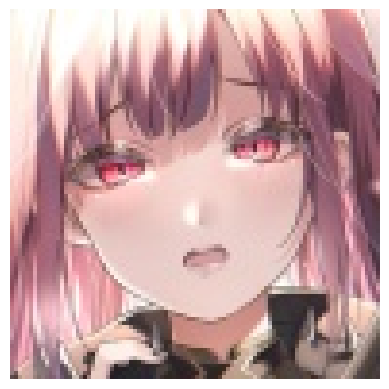

True Label: mori_calliope
This image is likely belongs to:
> mori_calliope : 18.92 % confidence.
> tokoyami_towa : 9.67 % confidence.
> kizuna_ai : 3.80 % confidence.
> nakano_nino : 3.47 % confidence.
> chitanda_eru : 3.44 % confidence.


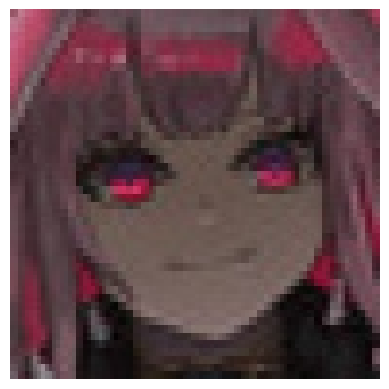

True Label: mori_calliope
This image is likely belongs to:
> mori_calliope : 9.58 % confidence.
> suzuhara_lulu : 6.81 % confidence.
> kiryu_coco : 5.07 % confidence.
> bremerton_(azur_lane) : 4.60 % confidence.
> astolfo_(fate) : 3.84 % confidence.


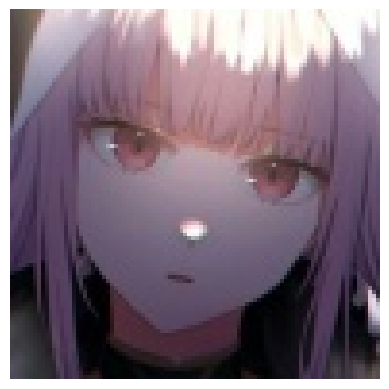

True Label: mori_calliope
This image is likely belongs to:
> mori_calliope : 10.25 % confidence.
> ninomae_ina'nis : 6.33 % confidence.
> formidable_(azur_lane) : 3.91 % confidence.
> karin_(blue_archive) : 3.85 % confidence.
> matou_sakura : 3.65 % confidence.


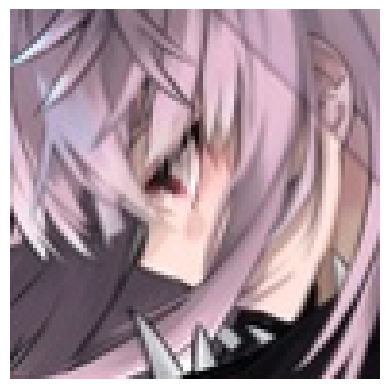

True Label: mori_calliope
This image is likely belongs to:
> mash_kyrielight : 11.37 % confidence.
> ram_rezero : 9.19 % confidence.
> okita_souji_(fate) : 6.61 % confidence.
> st_ar-15_(girls_frontline) : 6.26 % confidence.
> karna_(fate) : 5.45 % confidence.


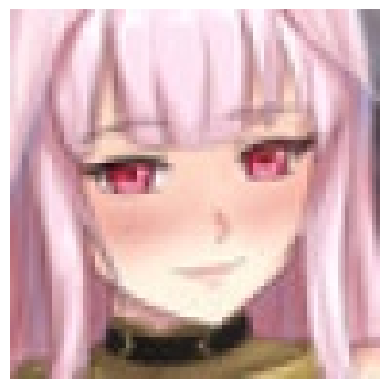

True Label: mori_calliope
This image is likely belongs to:
> mori_calliope : 28.98 % confidence.
> formidable_(azur_lane) : 9.14 % confidence.
> dido_(azur_lane) : 4.67 % confidence.
> illyasviel_von_einzbern : 3.93 % confidence.
> shishiro_botan : 3.26 % confidence.


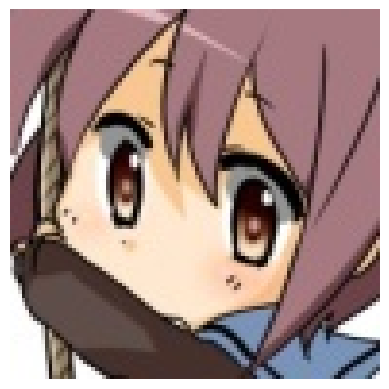

True Label: nagato_yuki
This image is likely belongs to:
> takanashi_rikka : 25.67 % confidence.
> nakano_azusa : 23.22 % confidence.
> shirogane_naoto : 9.37 % confidence.
> hirasawa_yui : 9.23 % confidence.
> kanbaru_suruga : 8.68 % confidence.


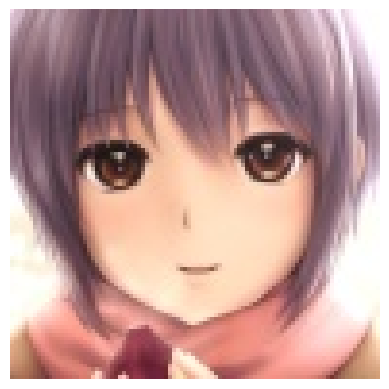

True Label: nagato_yuki
This image is likely belongs to:
> satonaka_chie : 18.74 % confidence.
> tsushima_yoshiko : 8.91 % confidence.
> shinomiya_kaguya : 6.43 % confidence.
> nakano_azusa : 5.32 % confidence.
> takarada_rikka : 4.22 % confidence.


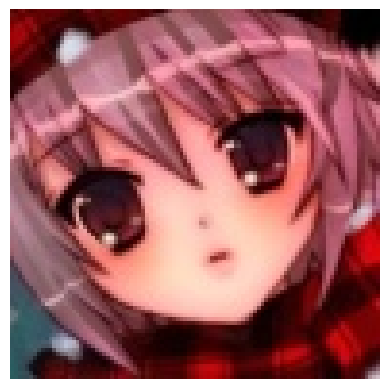

True Label: nagato_yuki
This image is likely belongs to:
> bremerton_(azur_lane) : 6.51 % confidence.
> kaname_madoka : 5.65 % confidence.
> mei_(pokemon) : 4.52 % confidence.
> shirogane_noel : 4.41 % confidence.
> minato_aqua : 4.16 % confidence.


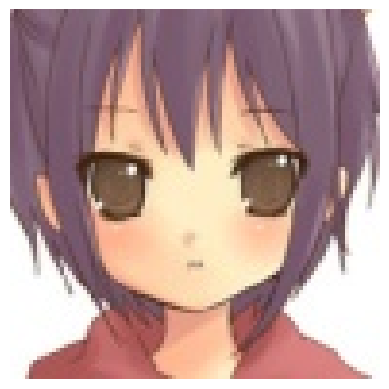

True Label: nagato_yuki
This image is likely belongs to:
> nakano_azusa : 22.02 % confidence.
> nagato_yuki : 12.47 % confidence.
> takanashi_rikka : 7.67 % confidence.
> tsushima_yoshiko : 5.95 % confidence.
> oshino_ougi : 4.09 % confidence.


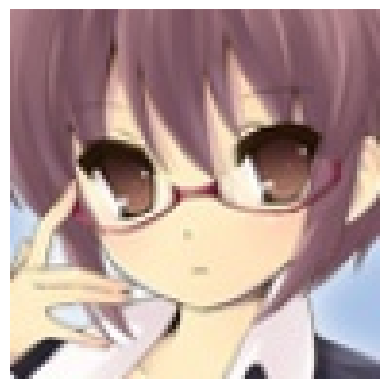

True Label: nagato_yuki
This image is likely belongs to:
> meltlilith : 34.71 % confidence.
> gilgamesh : 11.25 % confidence.
> nagato_yuki : 5.94 % confidence.
> nekomata_okayu : 4.60 % confidence.
> mash_kyrielight : 4.26 % confidence.


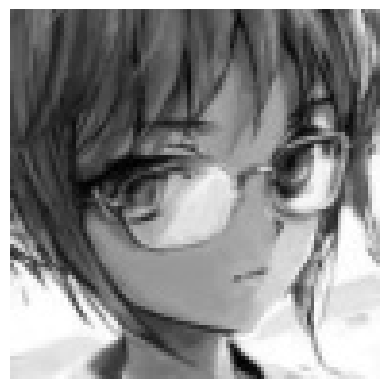

True Label: nagato_yuki
This image is likely belongs to:
> gilgamesh : 36.60 % confidence.
> arcueid_brunestud : 5.24 % confidence.
> miyazono_kawori : 4.87 % confidence.
> nagato_yuki : 3.91 % confidence.
> oshino_shinobu : 2.24 % confidence.


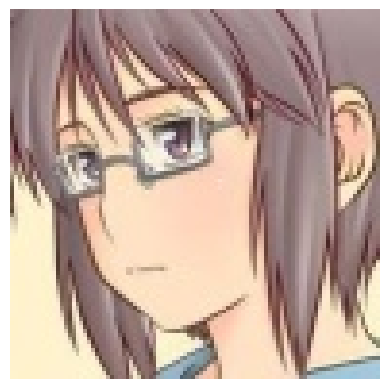

True Label: nagato_yuki
This image is likely belongs to:
> nico_robin : 4.53 % confidence.
> jonathan_joestar : 4.38 % confidence.
> fubuki_(one-punch_man) : 3.07 % confidence.
> chloe_von_einzbern : 3.06 % confidence.
> shirogane_naoto : 2.36 % confidence.


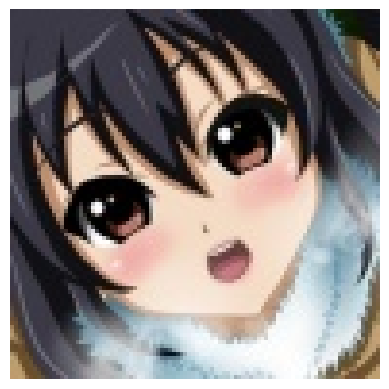

True Label: nakano_azusa
This image is likely belongs to:
> nakano_azusa : 9.35 % confidence.
> megumin : 6.74 % confidence.
> aisaka_taiga : 6.33 % confidence.
> suzumiya_haruhi : 6.10 % confidence.
> hirasawa_yui : 4.65 % confidence.


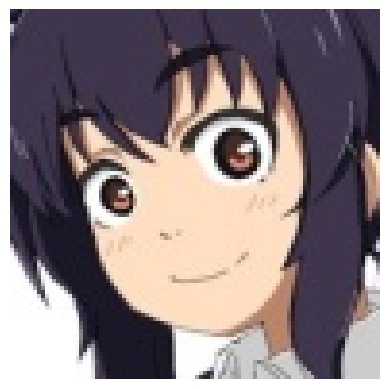

True Label: nakano_azusa
This image is likely belongs to:
> nakano_azusa : 7.38 % confidence.
> misaka_mikoto : 7.09 % confidence.
> hirasawa_yui : 5.72 % confidence.
> nagato_yuki : 5.13 % confidence.
> yuigahama_yui : 4.57 % confidence.


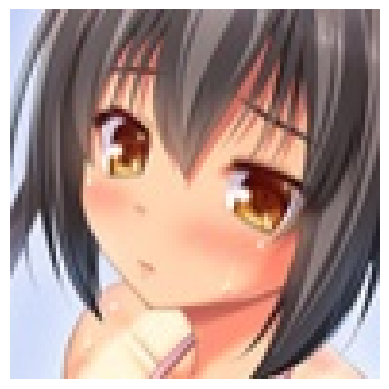

True Label: nakano_azusa
This image is likely belongs to:
> toujou_nozomi : 5.94 % confidence.
> usada_pekora : 4.76 % confidence.
> toosaka_rin : 4.48 % confidence.
> keqing_(genshin_impact) : 4.28 % confidence.
> tsushima_yoshiko : 3.89 % confidence.


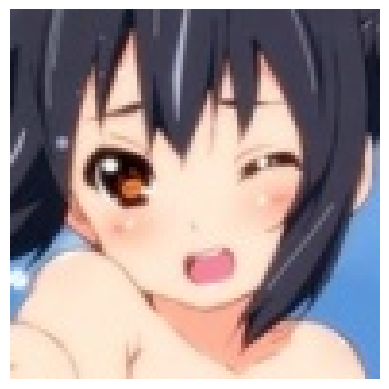

True Label: nakano_azusa
This image is likely belongs to:
> nakano_azusa : 38.61 % confidence.
> tsushima_yoshiko : 10.79 % confidence.
> kanbaru_suruga : 10.16 % confidence.
> ayanami_rei : 3.95 % confidence.
> oshino_ougi : 2.54 % confidence.


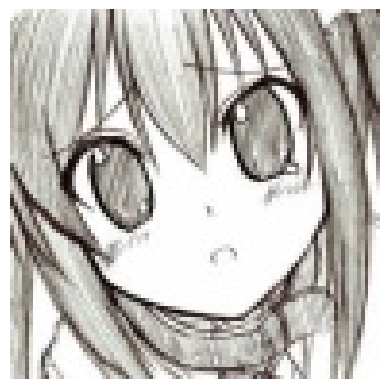

True Label: nakano_azusa
This image is likely belongs to:
> shirakami_fubuki : 7.78 % confidence.
> shidare_hotaru : 6.58 % confidence.
> shirogane_noel : 6.34 % confidence.
> gawr_gura : 4.83 % confidence.
> makise_kurisu : 4.59 % confidence.


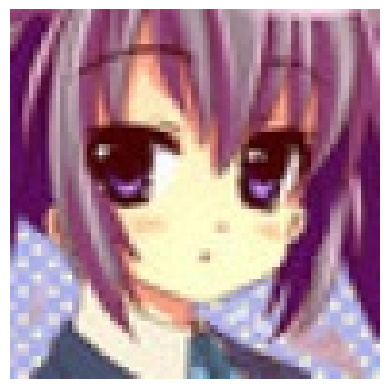

True Label: nakano_azusa
This image is likely belongs to:
> hirasawa_yui : 6.40 % confidence.
> hatsune_miku : 6.33 % confidence.
> nakano_azusa : 5.80 % confidence.
> tsushima_yoshiko : 5.38 % confidence.
> kanbaru_suruga : 3.75 % confidence.


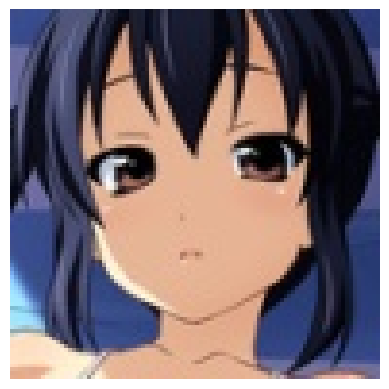

True Label: nakano_azusa
This image is likely belongs to:
> nakano_azusa : 8.50 % confidence.
> senjougahara_hitagi : 7.11 % confidence.
> ichigo_(darling_in_the_franxx) : 4.48 % confidence.
> hanekawa_tsubasa : 3.78 % confidence.
> kanbaru_suruga : 3.66 % confidence.


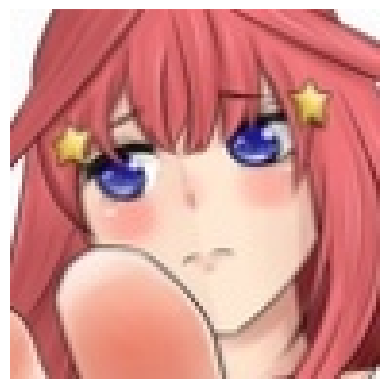

True Label: nakano_itsuki
This image is likely belongs to:
> nishikino_maki : 12.65 % confidence.
> nakano_itsuki : 11.37 % confidence.
> ichigo_(darling_in_the_franxx) : 4.76 % confidence.
> nakano_yotsuba : 3.55 % confidence.
> nakano_nino : 2.91 % confidence.


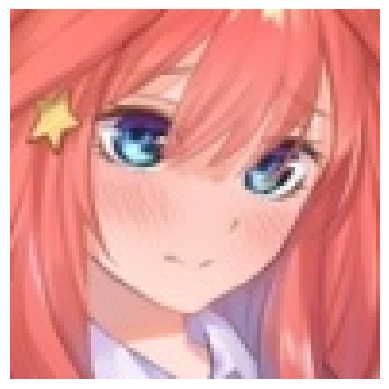

True Label: nakano_itsuki
This image is likely belongs to:
> nakano_itsuki : 35.62 % confidence.
> rias_gremory : 6.17 % confidence.
> nishikino_maki : 5.48 % confidence.
> bremerton_(azur_lane) : 4.68 % confidence.
> nakano_nino : 3.67 % confidence.


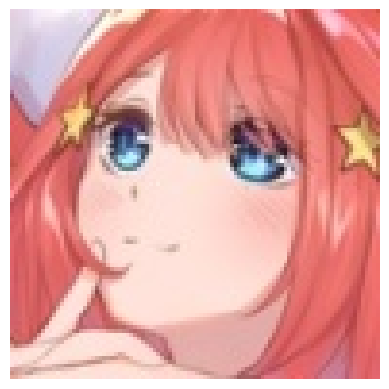

True Label: nakano_itsuki
This image is likely belongs to:
> nakano_nino : 19.86 % confidence.
> nakano_itsuki : 12.15 % confidence.
> suzuhara_lulu : 11.90 % confidence.
> nishikino_maki : 4.59 % confidence.
> unicorn_(azur_lane) : 3.46 % confidence.


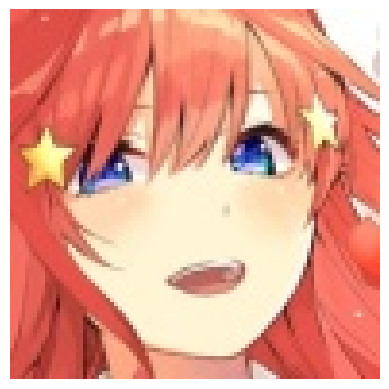

True Label: nakano_itsuki
This image is likely belongs to:
> misaka_mikoto : 8.72 % confidence.
> souryuu_asuka_langley : 8.33 % confidence.
> nakano_itsuki : 5.67 % confidence.
> ouro_kronii : 5.49 % confidence.
> nakano_yotsuba : 3.99 % confidence.


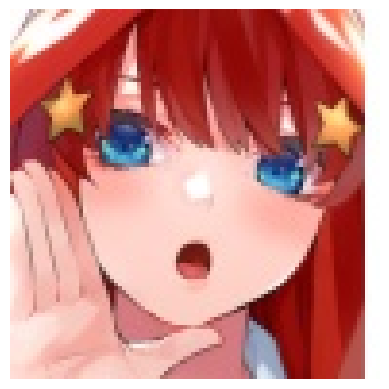

True Label: nakano_itsuki
This image is likely belongs to:
> nakano_itsuki : 28.17 % confidence.
> asia_argento : 10.23 % confidence.
> souryuu_asuka_langley : 4.73 % confidence.
> nami_(one_piece) : 2.61 % confidence.
> furukawa_nagisa : 2.54 % confidence.


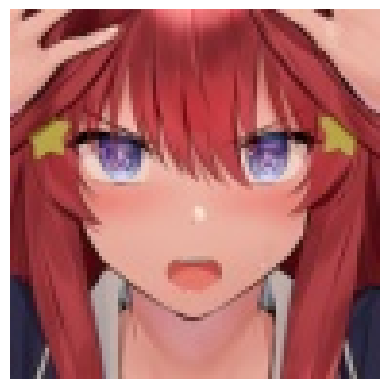

True Label: nakano_itsuki
This image is likely belongs to:
> nakano_itsuki : 72.95 % confidence.
> nakano_nino : 4.36 % confidence.
> yui_(angel_beats!) : 2.13 % confidence.
> oshino_shinobu : 1.42 % confidence.
> bremerton_(azur_lane) : 1.35 % confidence.


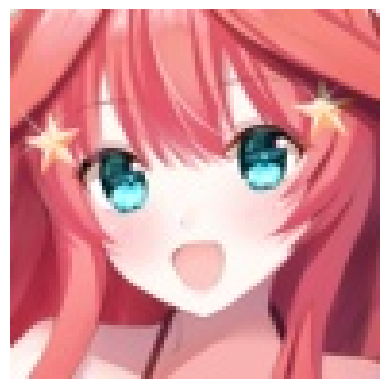

True Label: nakano_itsuki
This image is likely belongs to:
> nakano_itsuki : 66.31 % confidence.
> kizuna_ai : 7.60 % confidence.
> fujiwara_chika : 1.59 % confidence.
> zero_two_(darling_in_the_franxx) : 1.56 % confidence.
> asia_argento : 1.32 % confidence.


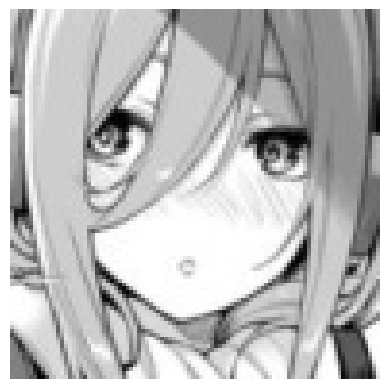

True Label: nakano_miku
This image is likely belongs to:
> nakano_miku : 13.59 % confidence.
> nakano_yotsuba : 9.50 % confidence.
> shuten_douji_(fate) : 6.03 % confidence.
> unicorn_(azur_lane) : 5.45 % confidence.
> laffey_(azur_lane) : 4.87 % confidence.


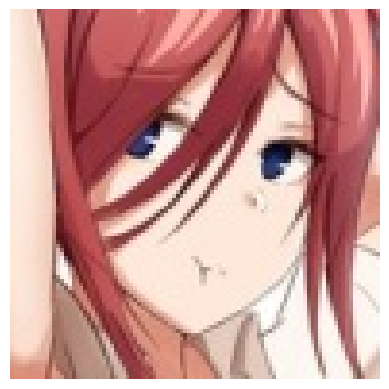

True Label: nakano_miku
This image is likely belongs to:
> nakano_miku : 18.60 % confidence.
> rias_gremory : 12.49 % confidence.
> bremerton_(azur_lane) : 5.81 % confidence.
> karna_(fate) : 5.70 % confidence.
> sinon : 3.09 % confidence.


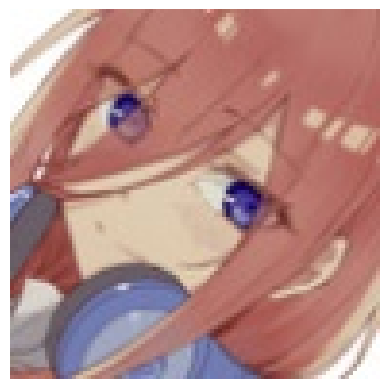

True Label: nakano_miku
This image is likely belongs to:
> fujiwara_chika : 10.55 % confidence.
> nakano_miku : 9.22 % confidence.
> rem_rezero : 4.11 % confidence.
> abigail_williams_(fate) : 4.04 % confidence.
> utsumi_erise : 3.67 % confidence.


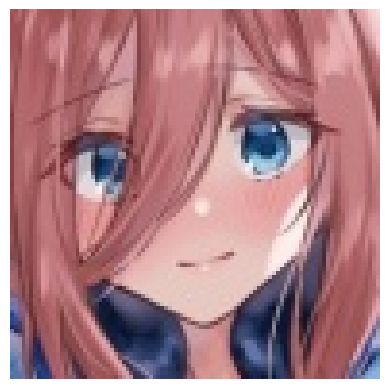

True Label: nakano_miku
This image is likely belongs to:
> nakano_miku : 63.05 % confidence.
> suzuhara_lulu : 4.31 % confidence.
> nakano_itsuki : 2.87 % confidence.
> nakano_yotsuba : 2.28 % confidence.
> hatsune_miku : 2.19 % confidence.


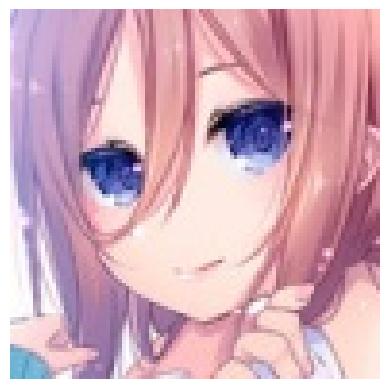

True Label: nakano_miku
This image is likely belongs to:
> nakano_miku : 14.16 % confidence.
> hayasaka_ai : 6.62 % confidence.
> suzuhara_lulu : 5.74 % confidence.
> unicorn_(azur_lane) : 5.57 % confidence.
> ram_rezero : 4.78 % confidence.


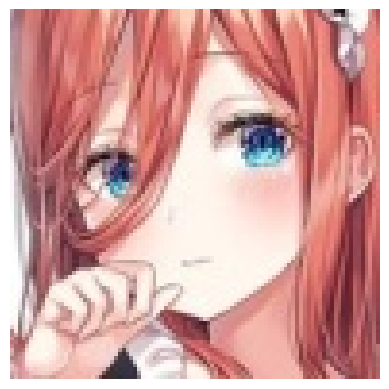

True Label: nakano_miku
This image is likely belongs to:
> nakano_miku : 59.75 % confidence.
> nakano_itsuki : 5.56 % confidence.
> utsumi_erise : 4.65 % confidence.
> suzuhara_lulu : 3.97 % confidence.
> fujiwara_chika : 3.33 % confidence.


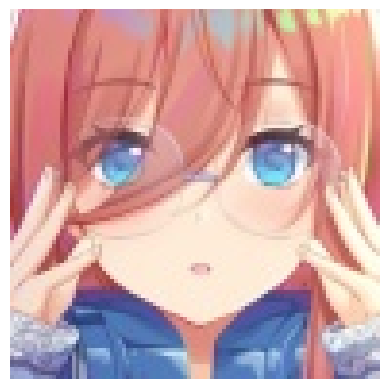

True Label: nakano_miku
This image is likely belongs to:
> nakano_miku : 70.88 % confidence.
> hayasaka_ai : 4.59 % confidence.
> sinon : 2.64 % confidence.
> utsumi_erise : 2.32 % confidence.
> chloe_von_einzbern : 1.09 % confidence.


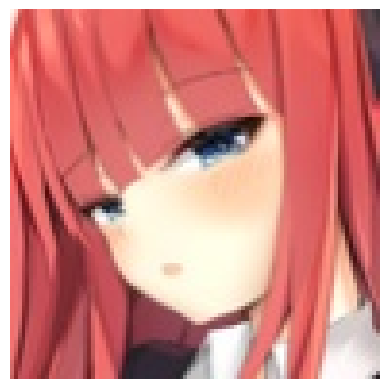

True Label: nakano_nino
This image is likely belongs to:
> takimoto_hifumi : 29.35 % confidence.
> nakano_yotsuba : 5.93 % confidence.
> st_ar-15_(girls_frontline) : 5.88 % confidence.
> nakano_itsuki : 5.82 % confidence.
> zero_two_(darling_in_the_franxx) : 4.81 % confidence.


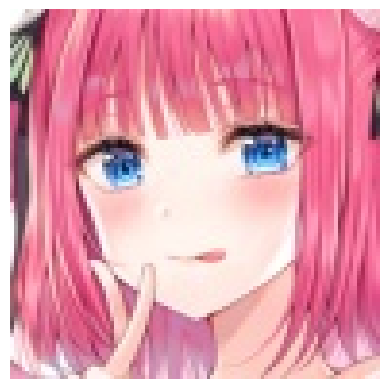

True Label: nakano_nino
This image is likely belongs to:
> nakano_nino : 17.94 % confidence.
> fujiwara_chika : 10.92 % confidence.
> zero_two_(darling_in_the_franxx) : 10.79 % confidence.
> suzuhara_lulu : 8.98 % confidence.
> takimoto_hifumi : 6.54 % confidence.


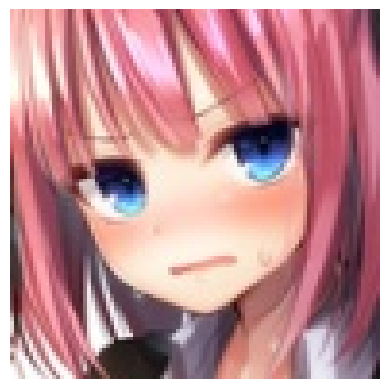

True Label: nakano_nino
This image is likely belongs to:
> fujiwara_chika : 25.24 % confidence.
> suzuhara_lulu : 11.98 % confidence.
> nakano_nino : 5.65 % confidence.
> takarada_rikka : 4.32 % confidence.
> utsumi_erise : 3.43 % confidence.


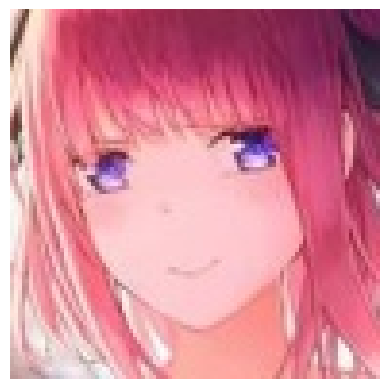

True Label: nakano_nino
This image is likely belongs to:
> nakano_nino : 23.50 % confidence.
> chitanda_eru : 12.44 % confidence.
> tokoyami_towa : 5.84 % confidence.
> emilia_rezero : 4.65 % confidence.
> fujiwara_chika : 3.06 % confidence.


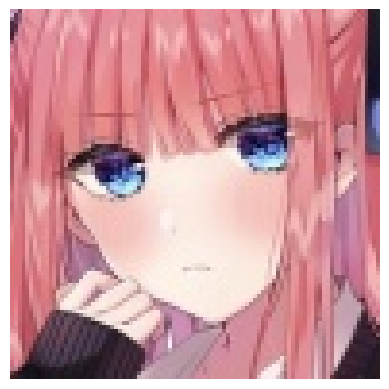

True Label: nakano_nino
This image is likely belongs to:
> nakano_nino : 25.07 % confidence.
> takimoto_hifumi : 22.04 % confidence.
> emilia_rezero : 4.38 % confidence.
> unicorn_(azur_lane) : 2.79 % confidence.
> nakano_itsuki : 2.68 % confidence.


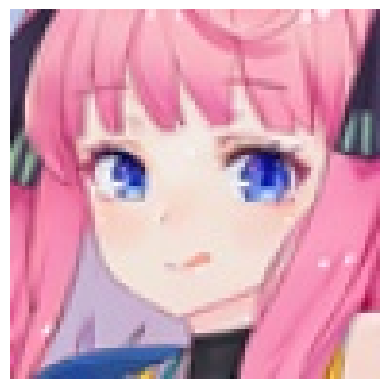

True Label: nakano_nino
This image is likely belongs to:
> nakano_itsuki : 13.37 % confidence.
> nishikino_maki : 9.67 % confidence.
> nakano_nino : 6.25 % confidence.
> sakurauchi_riko : 5.11 % confidence.
> fujiwara_chika : 4.62 % confidence.


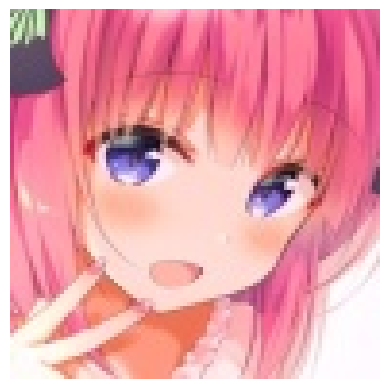

True Label: nakano_nino
This image is likely belongs to:
> nakano_nino : 25.90 % confidence.
> yuigahama_yui : 10.60 % confidence.
> tokoyami_towa : 6.00 % confidence.
> yui_(angel_beats!) : 5.57 % confidence.
> minato_aqua : 5.07 % confidence.


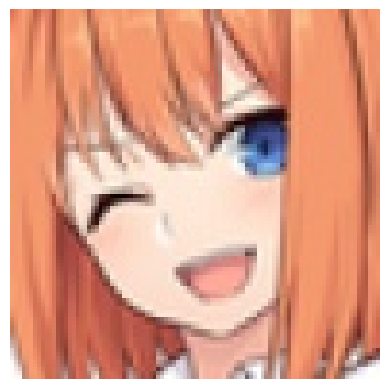

True Label: nakano_yotsuba
This image is likely belongs to:
> aqua_(konosuba) : 10.23 % confidence.
> xenovia_(high_school_dxd) : 7.83 % confidence.
> nakano_yotsuba : 4.68 % confidence.
> sinon : 4.46 % confidence.
> usada_pekora : 4.35 % confidence.


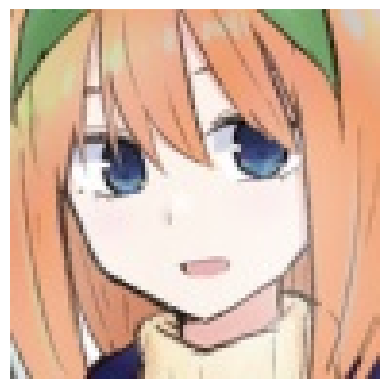

True Label: nakano_yotsuba
This image is likely belongs to:
> nakano_yotsuba : 54.42 % confidence.
> ninomae_ina'nis : 2.76 % confidence.
> aqua_(konosuba) : 2.73 % confidence.
> nakano_miku : 2.27 % confidence.
> suzuhara_lulu : 1.90 % confidence.


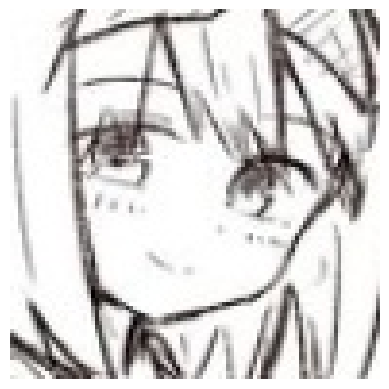

True Label: nakano_yotsuba
This image is likely belongs to:
> irisviel_von_einzbern : 9.39 % confidence.
> illyasviel_von_einzbern : 7.80 % confidence.
> karna_(fate) : 5.66 % confidence.
> shirakami_fubuki : 5.51 % confidence.
> suzuhara_lulu : 4.51 % confidence.


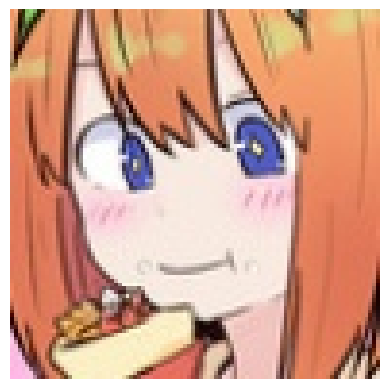

True Label: nakano_yotsuba
This image is likely belongs to:
> nakano_yotsuba : 31.92 % confidence.
> shuten_douji_(fate) : 8.94 % confidence.
> rem_rezero : 5.33 % confidence.
> nakano_itsuki : 2.75 % confidence.
> asia_argento : 2.34 % confidence.


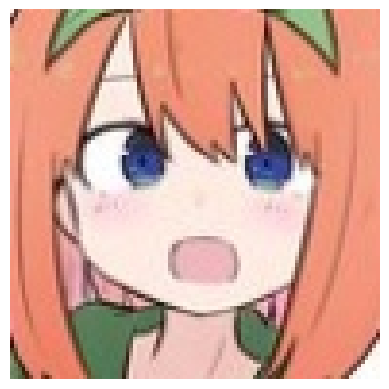

True Label: nakano_yotsuba
This image is likely belongs to:
> nakano_yotsuba : 82.93 % confidence.
> hirasawa_yui : 2.26 % confidence.
> unicorn_(azur_lane) : 2.16 % confidence.
> suzuhara_lulu : 1.65 % confidence.
> rem_rezero : 1.01 % confidence.


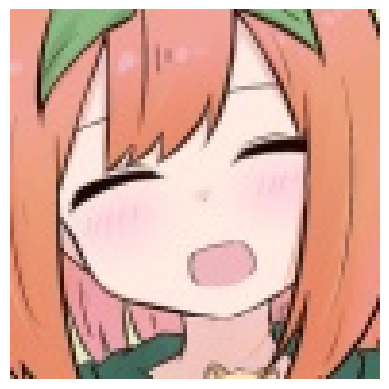

True Label: nakano_yotsuba
This image is likely belongs to:
> nakano_yotsuba : 46.59 % confidence.
> nekomata_okayu : 6.19 % confidence.
> astolfo_(fate) : 3.66 % confidence.
> hatsune_miku : 3.19 % confidence.
> raphtalia : 2.28 % confidence.


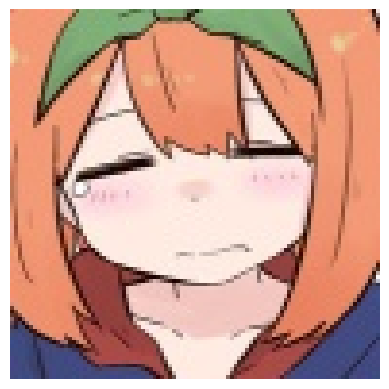

True Label: nakano_yotsuba
This image is likely belongs to:
> nakano_yotsuba : 64.98 % confidence.
> takanashi_rikka : 5.10 % confidence.
> ram_rezero : 4.27 % confidence.
> rem_rezero : 3.51 % confidence.
> oshino_ougi : 3.10 % confidence.


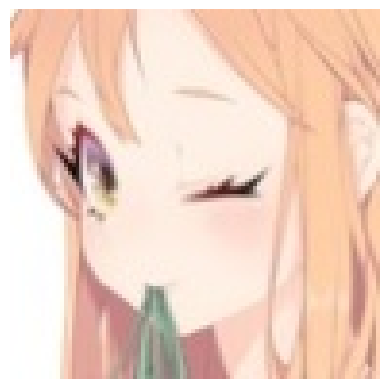

True Label: nami_(one_piece)
This image is likely belongs to:
> zero_two_(darling_in_the_franxx) : 14.25 % confidence.
> hayasaka_ai : 3.52 % confidence.
> st_ar-15_(girls_frontline) : 3.14 % confidence.
> waver_velvet : 2.63 % confidence.
> yukinoshita_yukino : 2.54 % confidence.


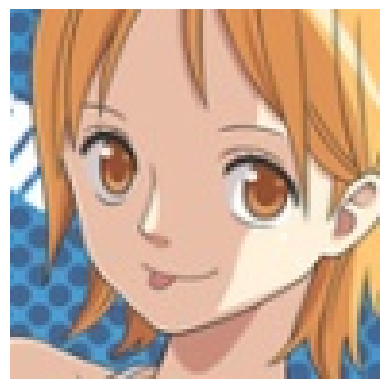

True Label: nami_(one_piece)
This image is likely belongs to:
> aqua_(konosuba) : 21.07 % confidence.
> hirasawa_yui : 6.25 % confidence.
> rem_rezero : 5.92 % confidence.
> hatsune_miku : 4.46 % confidence.
> sinon : 3.61 % confidence.


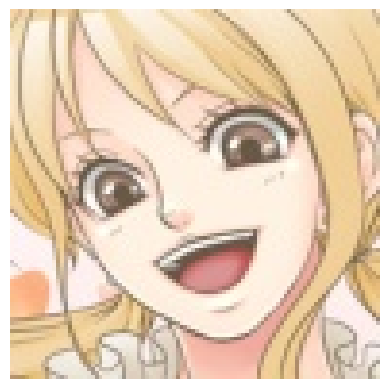

True Label: nami_(one_piece)
This image is likely belongs to:
> nami_(one_piece) : 12.17 % confidence.
> rias_gremory : 5.01 % confidence.
> aqua_(konosuba) : 4.19 % confidence.
> miyazono_kawori : 3.80 % confidence.
> suzumiya_haruhi : 3.79 % confidence.


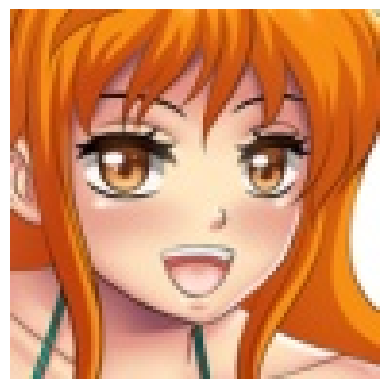

True Label: nami_(one_piece)
This image is likely belongs to:
> nami_(one_piece) : 57.39 % confidence.
> rias_gremory : 3.98 % confidence.
> nakano_itsuki : 3.94 % confidence.
> yuigahama_yui : 3.34 % confidence.
> furukawa_nagisa : 2.85 % confidence.


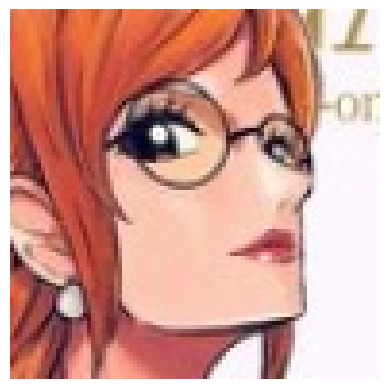

True Label: nami_(one_piece)
This image is likely belongs to:
> nami_(one_piece) : 23.79 % confidence.
> takamaki_anne : 5.43 % confidence.
> sakurauchi_riko : 5.09 % confidence.
> platelet_(hataraku_saibou) : 4.16 % confidence.
> hayasaka_ai : 3.81 % confidence.


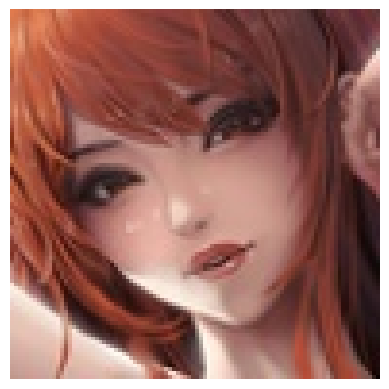

True Label: nami_(one_piece)
This image is likely belongs to:
> nami_(one_piece) : 10.20 % confidence.
> rias_gremory : 10.10 % confidence.
> furukawa_nagisa : 5.46 % confidence.
> atago_(azur_lane) : 4.37 % confidence.
> sakurajima_mai : 4.25 % confidence.


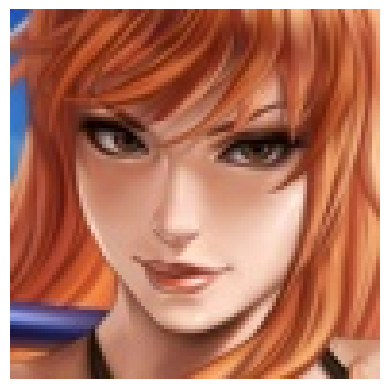

True Label: nami_(one_piece)
This image is likely belongs to:
> nami_(one_piece) : 39.30 % confidence.
> aegis_(persona) : 10.81 % confidence.
> souryuu_asuka_langley : 7.24 % confidence.
> rias_gremory : 6.00 % confidence.
> makise_kurisu : 5.41 % confidence.


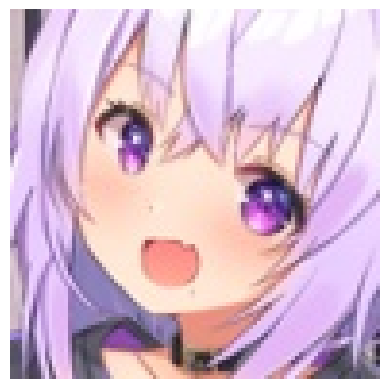

True Label: nekomata_okayu
This image is likely belongs to:
> paimon_(genshin_impact) : 14.30 % confidence.
> nekomata_okayu : 9.03 % confidence.
> cleveland_(azur_lane) : 8.43 % confidence.
> arcueid_brunestud : 4.89 % confidence.
> tokoyami_towa : 4.61 % confidence.


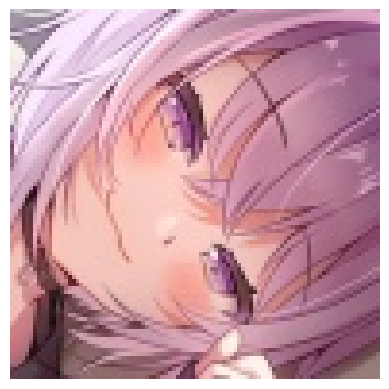

True Label: nekomata_okayu
This image is likely belongs to:
> shibuya_rin : 7.26 % confidence.
> mash_kyrielight : 6.33 % confidence.
> karin_(blue_archive) : 4.44 % confidence.
> kirito : 3.79 % confidence.
> ram_rezero : 3.56 % confidence.


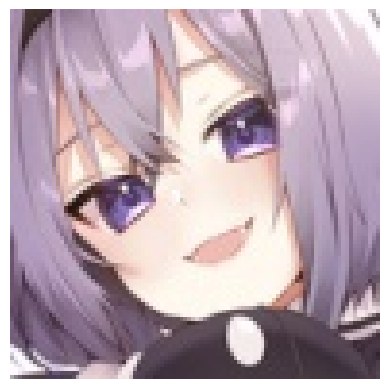

True Label: nekomata_okayu
This image is likely belongs to:
> nekomata_okayu : 19.04 % confidence.
> shirogane_noel : 7.46 % confidence.
> shirakami_fubuki : 4.25 % confidence.
> ryougi_shiki : 3.82 % confidence.
> shishiro_botan : 2.92 % confidence.


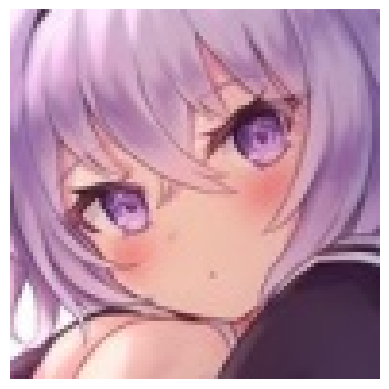

True Label: nekomata_okayu
This image is likely belongs to:
> sinon : 9.36 % confidence.
> okita_souji_(fate) : 7.90 % confidence.
> chloe_von_einzbern : 5.28 % confidence.
> shishiro_botan : 3.58 % confidence.
> miyazono_kawori : 2.91 % confidence.


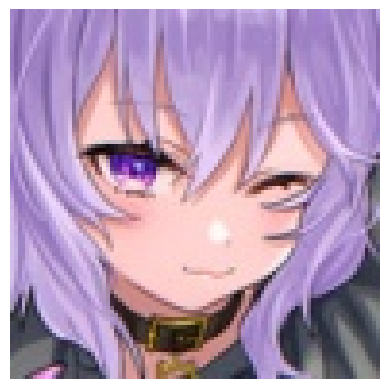

True Label: nekomata_okayu
This image is likely belongs to:
> nekomata_okayu : 10.52 % confidence.
> raphtalia : 7.17 % confidence.
> shishiro_botan : 5.53 % confidence.
> ouro_kronii : 4.51 % confidence.
> usada_pekora : 3.09 % confidence.


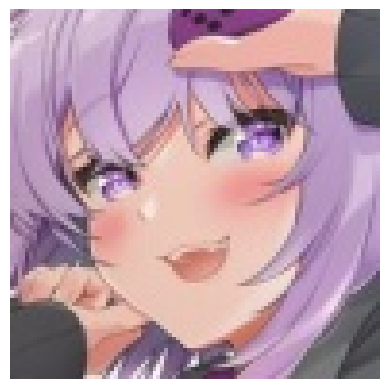

True Label: nekomata_okayu
This image is likely belongs to:
> usada_pekora : 11.06 % confidence.
> sinon : 7.37 % confidence.
> kochou_shinobu : 3.49 % confidence.
> keqing_(genshin_impact) : 3.45 % confidence.
> lancer : 3.05 % confidence.


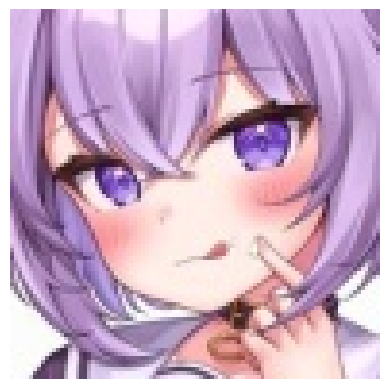

True Label: nekomata_okayu
This image is likely belongs to:
> nekomata_okayu : 14.46 % confidence.
> hayasaka_ai : 8.85 % confidence.
> unicorn_(azur_lane) : 6.82 % confidence.
> laffey_(azur_lane) : 6.59 % confidence.
> keqing_(genshin_impact) : 4.75 % confidence.


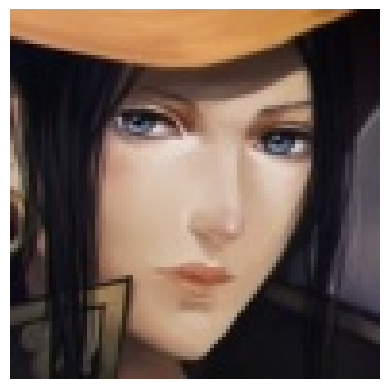

True Label: nico_robin
This image is likely belongs to:
> semiramis_(fate) : 13.10 % confidence.
> albedo : 10.34 % confidence.
> nico_robin : 9.92 % confidence.
> irisviel_von_einzbern : 9.79 % confidence.
> enterprise_(azur_lane) : 6.65 % confidence.


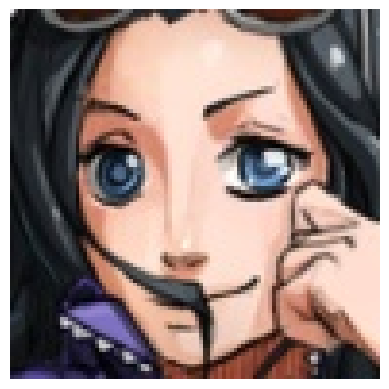

True Label: nico_robin
This image is likely belongs to:
> nico_robin : 13.49 % confidence.
> sakurauchi_riko : 10.64 % confidence.
> astolfo_(fate) : 4.89 % confidence.
> sinon : 4.30 % confidence.
> shibuya_rin : 3.15 % confidence.


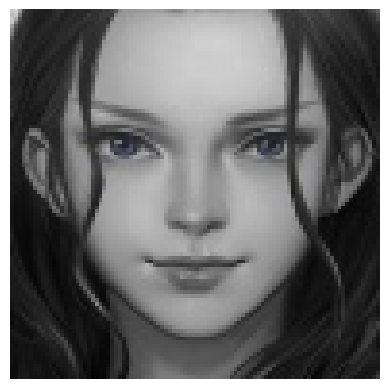

True Label: nico_robin
This image is likely belongs to:
> nico_robin : 16.93 % confidence.
> irisviel_von_einzbern : 10.99 % confidence.
> kamado_nezuko : 10.42 % confidence.
> albedo : 5.92 % confidence.
> fubuki_(one-punch_man) : 5.60 % confidence.


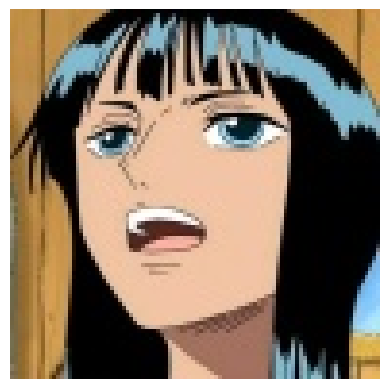

True Label: nico_robin
This image is likely belongs to:
> nico_robin : 25.69 % confidence.
> hyuuga_hinata : 20.77 % confidence.
> sakurauchi_riko : 7.32 % confidence.
> jonathan_joestar : 6.37 % confidence.
> waver_velvet : 4.12 % confidence.


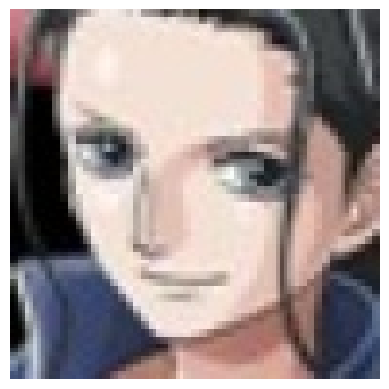

True Label: nico_robin
This image is likely belongs to:
> nico_robin : 93.97 % confidence.
> kamado_nezuko : 1.83 % confidence.
> rider : 1.05 % confidence.
> irisviel_von_einzbern : 0.37 % confidence.
> lancer : 0.36 % confidence.


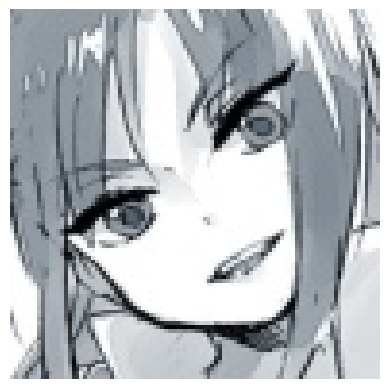

True Label: nico_robin
This image is likely belongs to:
> laffey_(azur_lane) : 13.46 % confidence.
> shishiro_botan : 9.43 % confidence.
> shuten_douji_(fate) : 4.88 % confidence.
> aqua_(konosuba) : 4.86 % confidence.
> makise_kurisu : 4.34 % confidence.


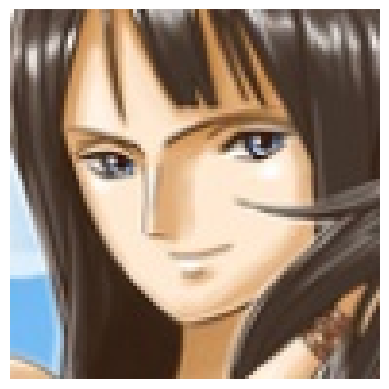

True Label: nico_robin
This image is likely belongs to:
> nico_robin : 18.06 % confidence.
> nami_(one_piece) : 16.26 % confidence.
> makise_kurisu : 12.48 % confidence.
> ninomae_ina'nis : 4.34 % confidence.
> asuna_(sao) : 4.25 % confidence.


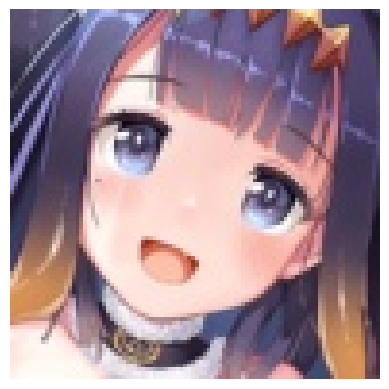

True Label: ninomae_ina'nis
This image is likely belongs to:
> utsumi_erise : 17.77 % confidence.
> dido_(azur_lane) : 9.51 % confidence.
> takimoto_hifumi : 8.11 % confidence.
> ouro_kronii : 5.80 % confidence.
> ninomae_ina'nis : 4.33 % confidence.


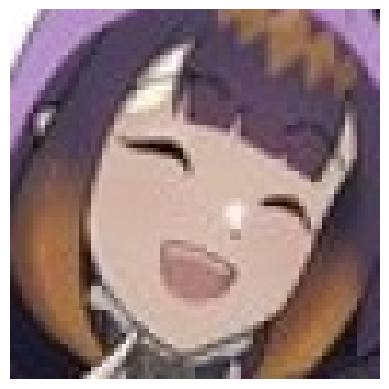

True Label: ninomae_ina'nis
This image is likely belongs to:
> ninomae_ina'nis : 27.14 % confidence.
> gawr_gura : 8.76 % confidence.
> hyuuga_hinata : 6.52 % confidence.
> kiryu_coco : 4.80 % confidence.
> shirogane_noel : 4.43 % confidence.


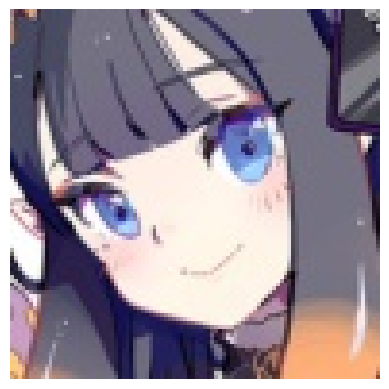

True Label: ninomae_ina'nis
This image is likely belongs to:
> ouro_kronii : 16.28 % confidence.
> utsumi_erise : 10.49 % confidence.
> yukinoshita_yukino : 5.64 % confidence.
> takimoto_hifumi : 5.39 % confidence.
> ninomae_ina'nis : 4.56 % confidence.


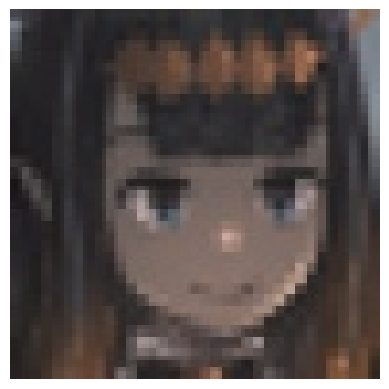

True Label: ninomae_ina'nis
This image is likely belongs to:
> ninomae_ina'nis : 95.00 % confidence.
> kiryu_coco : 1.61 % confidence.
> asuna_(sao) : 0.89 % confidence.
> gawr_gura : 0.28 % confidence.
> takagi-san : 0.28 % confidence.


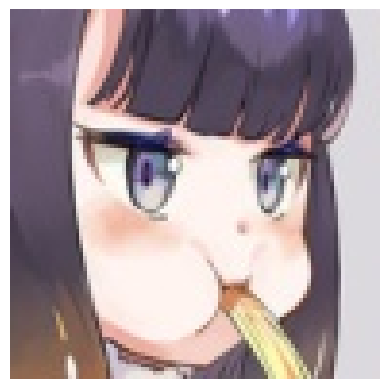

True Label: ninomae_ina'nis
This image is likely belongs to:
> sakura_futaba : 6.17 % confidence.
> komi_shouko : 5.42 % confidence.
> platelet_(hataraku_saibou) : 5.13 % confidence.
> kiryu_coco : 2.91 % confidence.
> shibuya_rin : 2.66 % confidence.


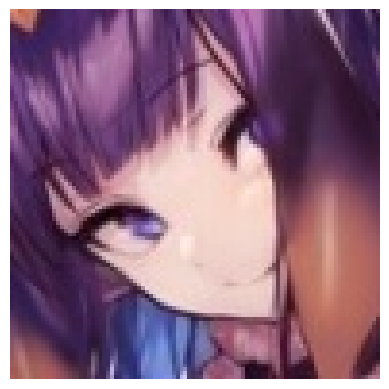

True Label: ninomae_ina'nis
This image is likely belongs to:
> matou_sakura : 12.34 % confidence.
> ouro_kronii : 9.56 % confidence.
> aqua_(konosuba) : 9.09 % confidence.
> fujibayashi_kyou : 6.98 % confidence.
> katsuragi_misato : 5.18 % confidence.


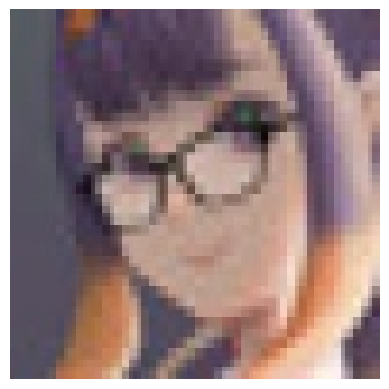

True Label: ninomae_ina'nis
This image is likely belongs to:
> ninomae_ina'nis : 10.06 % confidence.
> rider : 6.20 % confidence.
> unicorn_(azur_lane) : 5.13 % confidence.
> oshino_shinobu : 3.55 % confidence.
> kaname_madoka : 2.97 % confidence.


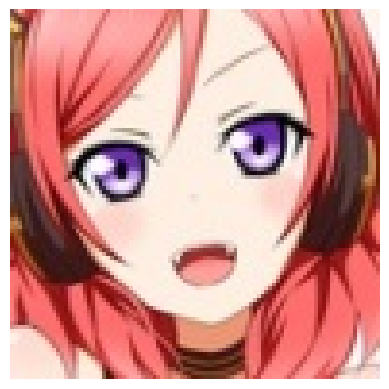

True Label: nishikino_maki
This image is likely belongs to:
> nishikino_maki : 29.13 % confidence.
> paimon_(genshin_impact) : 4.51 % confidence.
> cleveland_(azur_lane) : 3.48 % confidence.
> miyazono_kawori : 3.38 % confidence.
> asuna_(sao) : 3.38 % confidence.


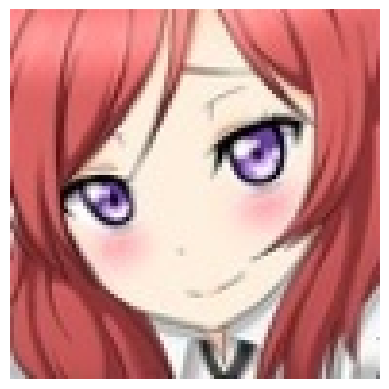

True Label: nishikino_maki
This image is likely belongs to:
> nishikino_maki : 81.18 % confidence.
> hatsune_miku : 2.84 % confidence.
> sinon : 1.61 % confidence.
> nakano_itsuki : 1.08 % confidence.
> aqua_(konosuba) : 0.84 % confidence.


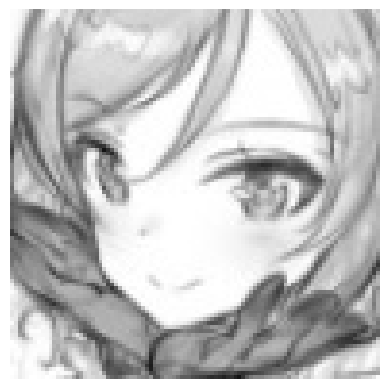

True Label: nishikino_maki
This image is likely belongs to:
> ram_rezero : 16.52 % confidence.
> anastasia_(idolmaster) : 13.61 % confidence.
> nishikino_maki : 6.17 % confidence.
> kaname_madoka : 5.01 % confidence.
> mash_kyrielight : 4.18 % confidence.


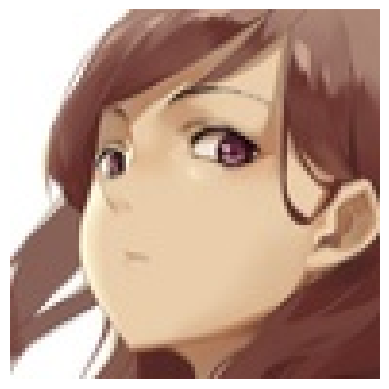

True Label: nishikino_maki
This image is likely belongs to:
> nami_(one_piece) : 9.32 % confidence.
> takarada_rikka : 7.09 % confidence.
> sakurauchi_riko : 5.30 % confidence.
> misaka_mikoto : 4.64 % confidence.
> belfast_(azur_lane) : 4.09 % confidence.


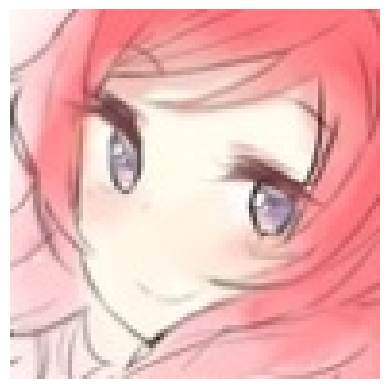

True Label: nishikino_maki
This image is likely belongs to:
> astolfo_(fate) : 14.21 % confidence.
> hatsune_miku : 4.28 % confidence.
> ayanami_rei : 4.15 % confidence.
> nishikino_maki : 4.14 % confidence.
> kaname_madoka : 3.72 % confidence.


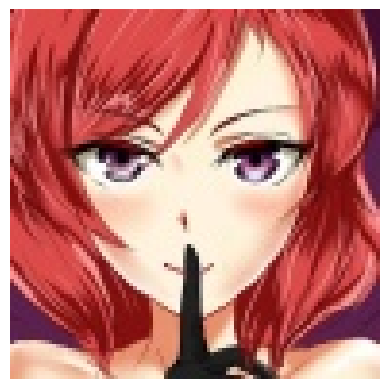

True Label: nishikino_maki
This image is likely belongs to:
> mori_calliope : 9.76 % confidence.
> sakurauchi_riko : 7.78 % confidence.
> bremerton_(azur_lane) : 7.58 % confidence.
> nakano_itsuki : 3.88 % confidence.
> st_ar-15_(girls_frontline) : 3.58 % confidence.


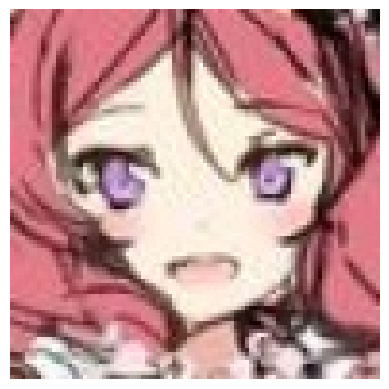

True Label: nishikino_maki
This image is likely belongs to:
> hatsune_miku : 15.28 % confidence.
> nishikino_maki : 6.98 % confidence.
> sinon : 6.96 % confidence.
> ayanami_rei : 5.46 % confidence.
> kaname_madoka : 4.17 % confidence.


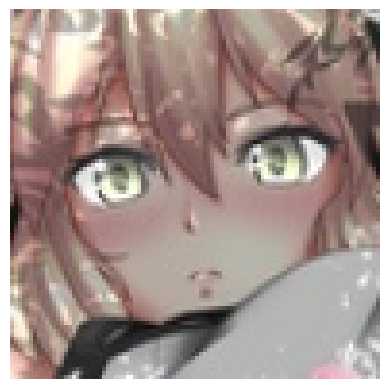

True Label: okita_souji_(fate)
This image is likely belongs to:
> okita_souji_(fate) : 19.92 % confidence.
> nakano_miku : 9.73 % confidence.
> chloe_von_einzbern : 7.96 % confidence.
> mash_kyrielight : 6.01 % confidence.
> st_ar-15_(girls_frontline) : 3.95 % confidence.


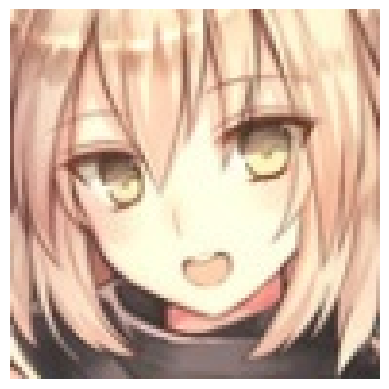

True Label: okita_souji_(fate)
This image is likely belongs to:
> raphtalia : 13.44 % confidence.
> okita_souji_(fate) : 13.31 % confidence.
> astolfo_(fate) : 9.18 % confidence.
> cleveland_(azur_lane) : 8.46 % confidence.
> nekomata_okayu : 7.70 % confidence.


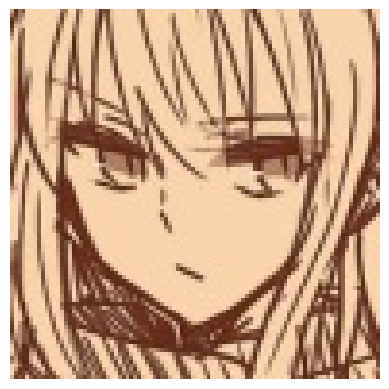

True Label: okita_souji_(fate)
This image is likely belongs to:
> makise_kurisu : 6.69 % confidence.
> nami_(one_piece) : 5.76 % confidence.
> shirakami_fubuki : 4.16 % confidence.
> shidare_hotaru : 4.08 % confidence.
> miyazono_kawori : 3.79 % confidence.


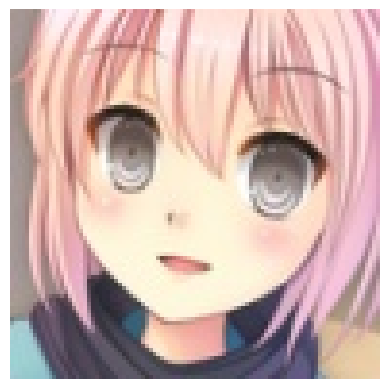

True Label: okita_souji_(fate)
This image is likely belongs to:
> kizuna_ai : 11.87 % confidence.
> fujiwara_chika : 4.06 % confidence.
> nagato_yuki : 3.54 % confidence.
> suzumiya_haruhi : 3.42 % confidence.
> toujou_nozomi : 3.28 % confidence.


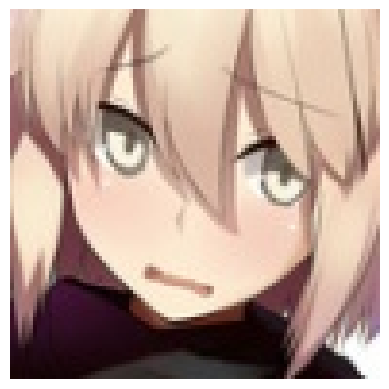

True Label: okita_souji_(fate)
This image is likely belongs to:
> okita_souji_(fate) : 52.65 % confidence.
> kirito : 13.97 % confidence.
> paimon_(genshin_impact) : 4.46 % confidence.
> chloe_von_einzbern : 2.47 % confidence.
> hatsune_miku : 1.70 % confidence.


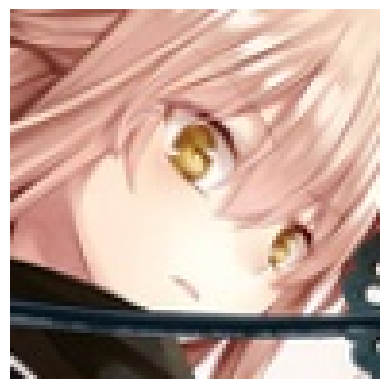

True Label: okita_souji_(fate)
This image is likely belongs to:
> nakano_itsuki : 11.00 % confidence.
> nakano_miku : 9.97 % confidence.
> utsumi_erise : 8.51 % confidence.
> nishikino_maki : 7.50 % confidence.
> rem_rezero : 4.37 % confidence.


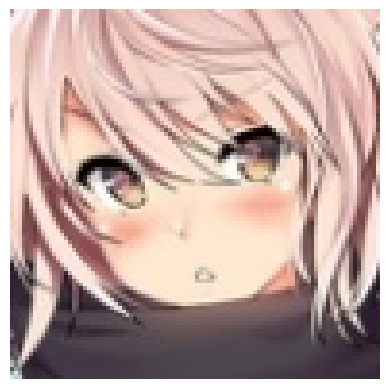

True Label: okita_souji_(fate)
This image is likely belongs to:
> mash_kyrielight : 7.60 % confidence.
> shirakami_fubuki : 6.39 % confidence.
> hanekawa_tsubasa : 6.34 % confidence.
> kaname_madoka : 5.33 % confidence.
> takanashi_rikka : 4.27 % confidence.


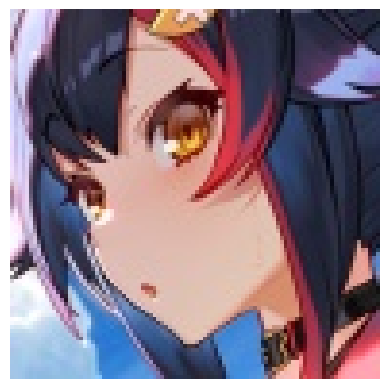

True Label: ookami_mio
This image is likely belongs to:
> sinon : 14.19 % confidence.
> mei_(pokemon) : 7.54 % confidence.
> ichigo_(darling_in_the_franxx) : 6.22 % confidence.
> nishikino_maki : 5.59 % confidence.
> takanashi_rikka : 4.24 % confidence.


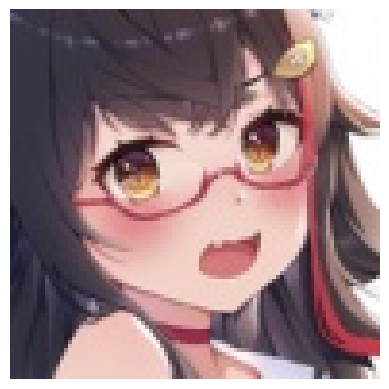

True Label: ookami_mio
This image is likely belongs to:
> ookami_mio : 33.49 % confidence.
> d.va_(overwatch) : 4.85 % confidence.
> shinomiya_kaguya : 2.74 % confidence.
> toosaka_rin : 2.72 % confidence.
> atago_(azur_lane) : 2.31 % confidence.


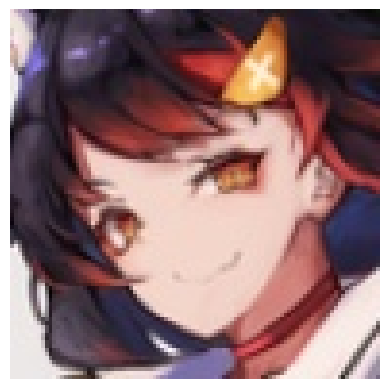

True Label: ookami_mio
This image is likely belongs to:
> takao_(azur_lane) : 15.10 % confidence.
> kanbaru_suruga : 14.01 % confidence.
> ookami_mio : 11.35 % confidence.
> atago_(azur_lane) : 6.86 % confidence.
> shirogane_naoto : 6.52 % confidence.


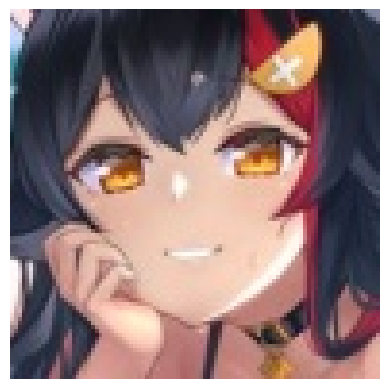

True Label: ookami_mio
This image is likely belongs to:
> ishtar_(fate_grand_order) : 26.59 % confidence.
> ookami_mio : 25.22 % confidence.
> sakurauchi_riko : 3.95 % confidence.
> toosaka_rin : 2.17 % confidence.
> takao_(azur_lane) : 2.13 % confidence.


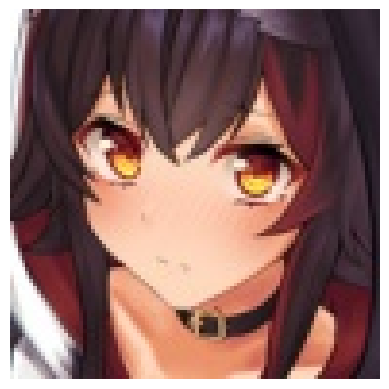

True Label: ookami_mio
This image is likely belongs to:
> taihou_(azur_lane) : 28.13 % confidence.
> yukinoshita_yukino : 8.19 % confidence.
> sakurajima_mai : 6.90 % confidence.
> atago_(azur_lane) : 5.90 % confidence.
> ookami_mio : 3.93 % confidence.


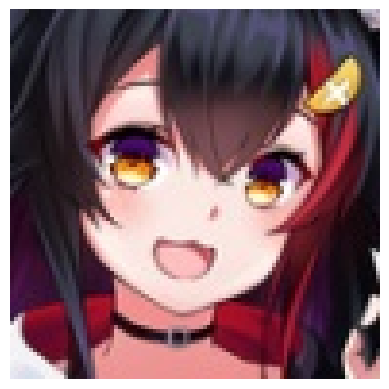

True Label: ookami_mio
This image is likely belongs to:
> ookami_mio : 84.11 % confidence.
> megumin : 2.70 % confidence.
> toosaka_rin : 2.47 % confidence.
> taihou_(azur_lane) : 1.22 % confidence.
> d.va_(overwatch) : 0.88 % confidence.


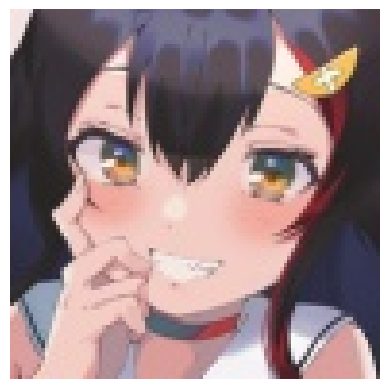

True Label: ookami_mio
This image is likely belongs to:
> ookami_mio : 28.68 % confidence.
> tsushima_yoshiko : 7.28 % confidence.
> yukinoshita_yukino : 4.30 % confidence.
> toosaka_rin : 2.77 % confidence.
> senjougahara_hitagi : 2.71 % confidence.


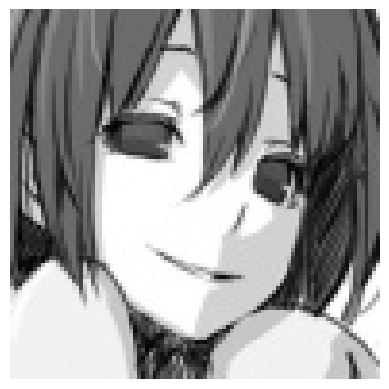

True Label: oshino_ougi
This image is likely belongs to:
> takanashi_rikka : 16.57 % confidence.
> waver_velvet : 10.69 % confidence.
> ryougi_shiki : 7.77 % confidence.
> taihou_(azur_lane) : 5.76 % confidence.
> hirasawa_yui : 5.54 % confidence.


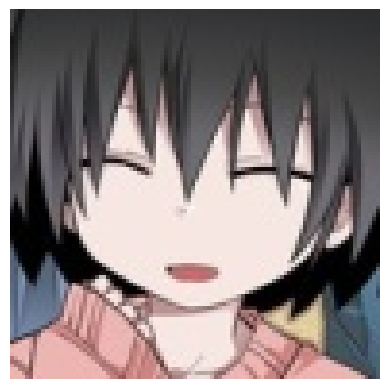

True Label: oshino_ougi
This image is likely belongs to:
> oshino_ougi : 47.35 % confidence.
> tsushima_yoshiko : 10.87 % confidence.
> takanashi_rikka : 3.42 % confidence.
> kirito : 2.94 % confidence.
> hatsune_miku : 2.73 % confidence.


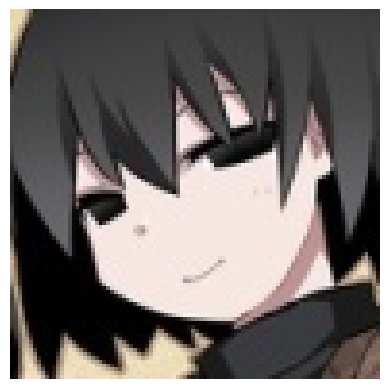

True Label: oshino_ougi
This image is likely belongs to:
> oshino_ougi : 76.18 % confidence.
> kirito : 4.62 % confidence.
> toosaka_rin : 1.64 % confidence.
> nakano_azusa : 1.21 % confidence.
> ryougi_shiki : 1.17 % confidence.


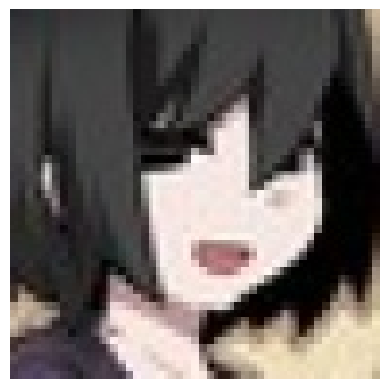

True Label: oshino_ougi
This image is likely belongs to:
> oshino_ougi : 51.26 % confidence.
> ryougi_shiki : 26.10 % confidence.
> kirito : 4.97 % confidence.
> nagato_yuki : 3.05 % confidence.
> suzumiya_haruhi : 2.23 % confidence.


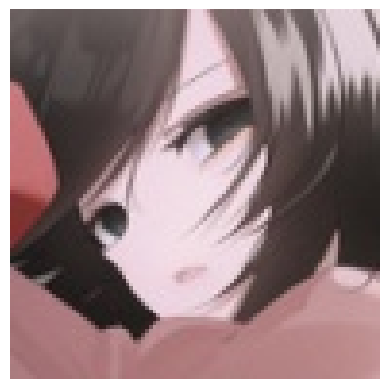

True Label: oshino_ougi
This image is likely belongs to:
> albedo : 12.52 % confidence.
> fubuki_(one-punch_man) : 6.95 % confidence.
> ryougi_shiki : 6.81 % confidence.
> semiramis_(fate) : 5.89 % confidence.
> kirito : 5.03 % confidence.


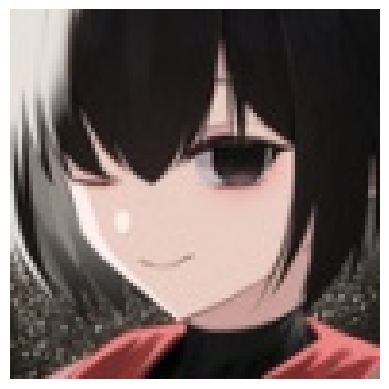

True Label: oshino_ougi
This image is likely belongs to:
> oshino_ougi : 19.26 % confidence.
> megumin : 6.58 % confidence.
> shinomiya_kaguya : 6.56 % confidence.
> tsushima_yoshiko : 6.16 % confidence.
> ishtar_(fate_grand_order) : 4.38 % confidence.


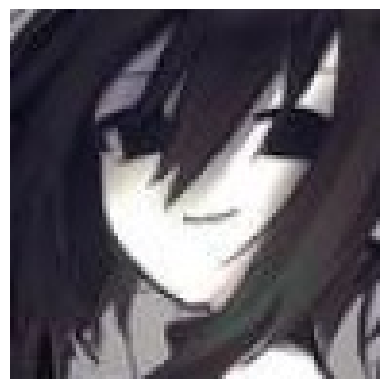

True Label: oshino_ougi
This image is likely belongs to:
> kirito : 12.38 % confidence.
> albedo : 10.19 % confidence.
> kochou_shinobu : 9.30 % confidence.
> oshino_ougi : 8.20 % confidence.
> fubuki_(one-punch_man) : 4.24 % confidence.


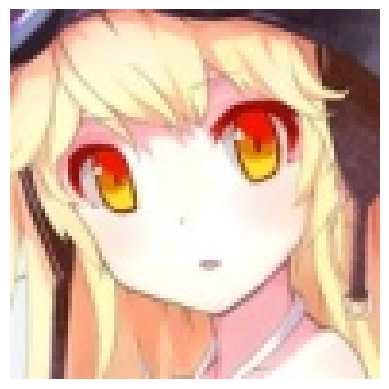

True Label: oshino_shinobu
This image is likely belongs to:
> platelet_(hataraku_saibou) : 12.48 % confidence.
> nakano_itsuki : 6.88 % confidence.
> oshino_shinobu : 6.73 % confidence.
> kiryu_coco : 5.17 % confidence.
> mei_(pokemon) : 4.04 % confidence.


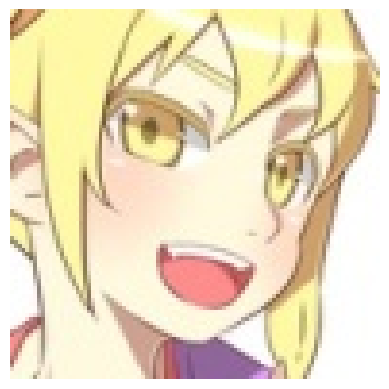

True Label: oshino_shinobu
This image is likely belongs to:
> bremerton_(azur_lane) : 3.81 % confidence.
> platelet_(hataraku_saibou) : 3.69 % confidence.
> nami_(one_piece) : 2.96 % confidence.
> giorno_giovanna : 2.93 % confidence.
> shishiro_botan : 2.89 % confidence.


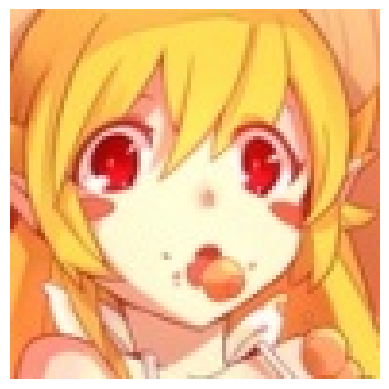

True Label: oshino_shinobu
This image is likely belongs to:
> oshino_shinobu : 15.77 % confidence.
> asia_argento : 12.40 % confidence.
> kiryu_coco : 6.57 % confidence.
> raphtalia : 3.79 % confidence.
> nishikino_maki : 3.36 % confidence.


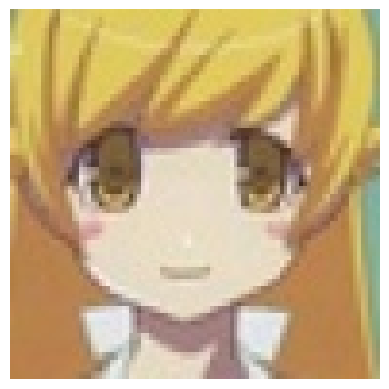

True Label: oshino_shinobu
This image is likely belongs to:
> oshino_shinobu : 25.59 % confidence.
> fujibayashi_kyou : 20.15 % confidence.
> satonaka_chie : 6.88 % confidence.
> furukawa_nagisa : 3.79 % confidence.
> c.c : 2.16 % confidence.


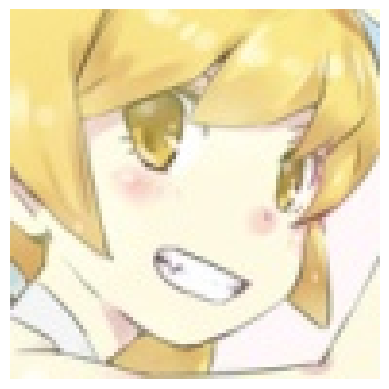

True Label: oshino_shinobu
This image is likely belongs to:
> oshino_shinobu : 15.54 % confidence.
> miyazono_kawori : 6.53 % confidence.
> hayasaka_ai : 5.83 % confidence.
> usada_pekora : 3.62 % confidence.
> raphtalia : 3.48 % confidence.


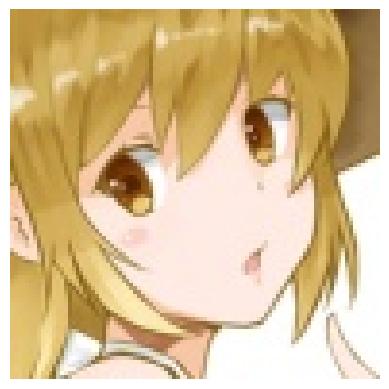

True Label: oshino_shinobu
This image is likely belongs to:
> oshino_shinobu : 9.19 % confidence.
> platelet_(hataraku_saibou) : 4.39 % confidence.
> aqua_(konosuba) : 4.17 % confidence.
> aegis_(persona) : 2.98 % confidence.
> watson_amelia : 2.88 % confidence.


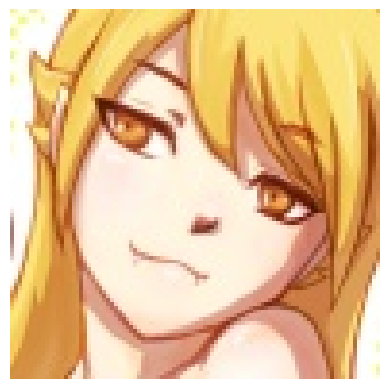

True Label: oshino_shinobu
This image is likely belongs to:
> nishikino_maki : 9.27 % confidence.
> rias_gremory : 7.86 % confidence.
> nami_(one_piece) : 5.79 % confidence.
> oshino_shinobu : 3.90 % confidence.
> satonaka_chie : 2.98 % confidence.


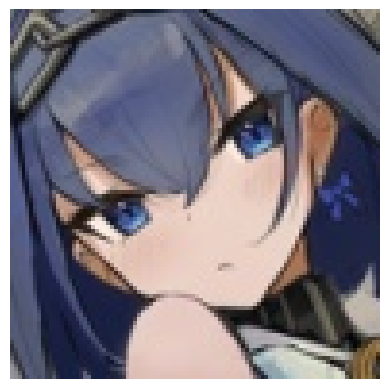

True Label: ouro_kronii
This image is likely belongs to:
> fujibayashi_kyou : 8.24 % confidence.
> ouro_kronii : 5.76 % confidence.
> bremerton_(azur_lane) : 3.40 % confidence.
> sakurajima_mai : 3.07 % confidence.
> takao_(azur_lane) : 2.89 % confidence.


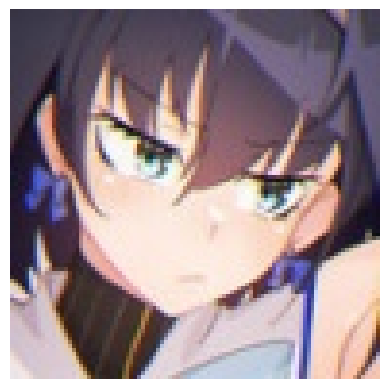

True Label: ouro_kronii
This image is likely belongs to:
> yukinoshita_yukino : 25.02 % confidence.
> ouro_kronii : 24.14 % confidence.
> kirito : 8.95 % confidence.
> toosaka_rin : 3.33 % confidence.
> nagato_yuki : 2.50 % confidence.


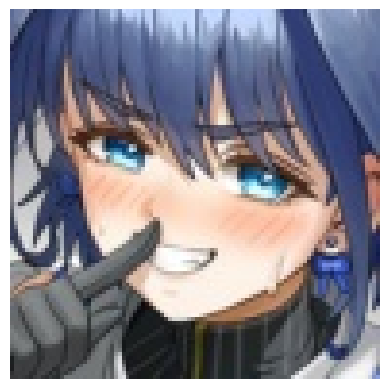

True Label: ouro_kronii
This image is likely belongs to:
> ouro_kronii : 31.33 % confidence.
> enterprise_(azur_lane) : 6.52 % confidence.
> aqua_(konosuba) : 6.32 % confidence.
> meltlilith : 5.11 % confidence.
> ryougi_shiki : 4.62 % confidence.


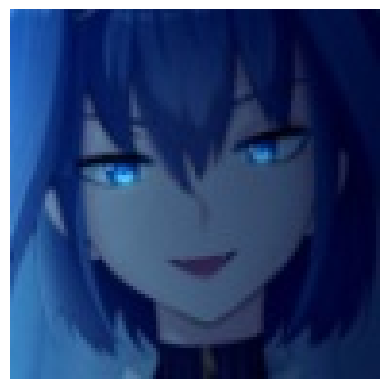

True Label: ouro_kronii
This image is likely belongs to:
> ryougi_shiki : 9.81 % confidence.
> makise_kurisu : 7.11 % confidence.
> xenovia_(high_school_dxd) : 6.96 % confidence.
> oshino_ougi : 6.72 % confidence.
> furukawa_nagisa : 5.98 % confidence.


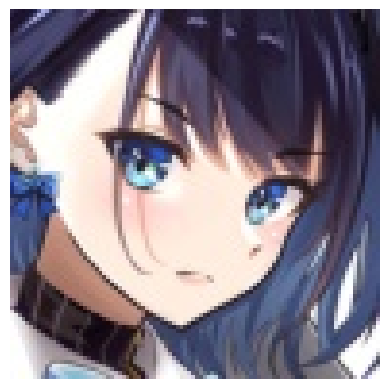

True Label: ouro_kronii
This image is likely belongs to:
> ouro_kronii : 43.74 % confidence.
> takanashi_rikka : 11.80 % confidence.
> utsumi_erise : 11.34 % confidence.
> souryuu_asuka_langley : 2.31 % confidence.
> suzuhara_lulu : 2.30 % confidence.


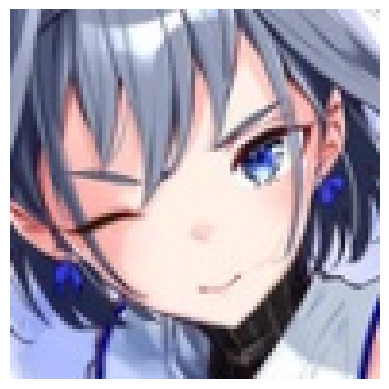

True Label: ouro_kronii
This image is likely belongs to:
> sinon : 7.89 % confidence.
> xenovia_(high_school_dxd) : 7.37 % confidence.
> ouro_kronii : 6.58 % confidence.
> hatsune_miku : 5.27 % confidence.
> kanbaru_suruga : 3.84 % confidence.


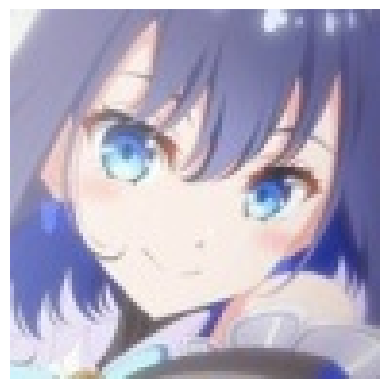

True Label: ouro_kronii
This image is likely belongs to:
> yukinoshita_yukino : 9.93 % confidence.
> ouro_kronii : 7.61 % confidence.
> utsumi_erise : 7.01 % confidence.
> takanashi_rikka : 5.30 % confidence.
> kizuna_ai : 5.03 % confidence.


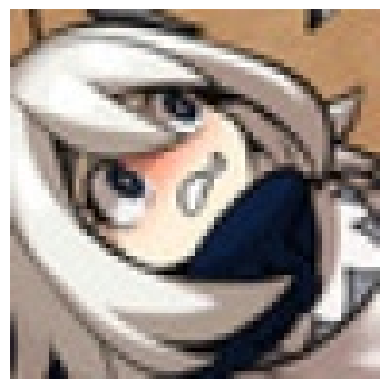

True Label: paimon_(genshin_impact)
This image is likely belongs to:
> hatsune_miku : 12.95 % confidence.
> sengoku_nadeko : 11.10 % confidence.
> takamaki_anne : 7.16 % confidence.
> shirakami_fubuki : 6.58 % confidence.
> paimon_(genshin_impact) : 6.20 % confidence.


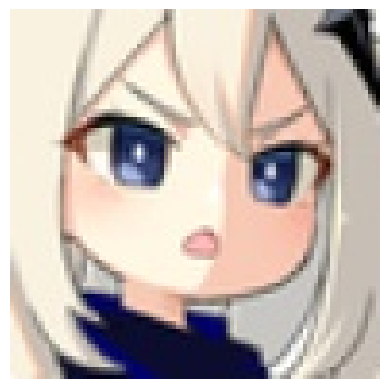

True Label: paimon_(genshin_impact)
This image is likely belongs to:
> paimon_(genshin_impact) : 34.24 % confidence.
> nakano_azusa : 9.13 % confidence.
> sinon : 5.41 % confidence.
> hirasawa_yui : 3.30 % confidence.
> hatsune_miku : 3.24 % confidence.


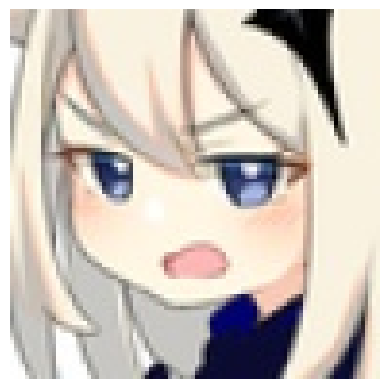

True Label: paimon_(genshin_impact)
This image is likely belongs to:
> paimon_(genshin_impact) : 17.29 % confidence.
> gawr_gura : 3.94 % confidence.
> nakano_azusa : 3.65 % confidence.
> shishiro_botan : 3.49 % confidence.
> shinomiya_kaguya : 2.94 % confidence.


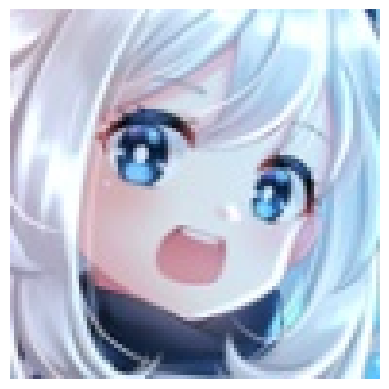

True Label: paimon_(genshin_impact)
This image is likely belongs to:
> paimon_(genshin_impact) : 30.96 % confidence.
> kizuna_ai : 9.58 % confidence.
> gawr_gura : 4.47 % confidence.
> nakano_yotsuba : 3.48 % confidence.
> nekomata_okayu : 3.28 % confidence.


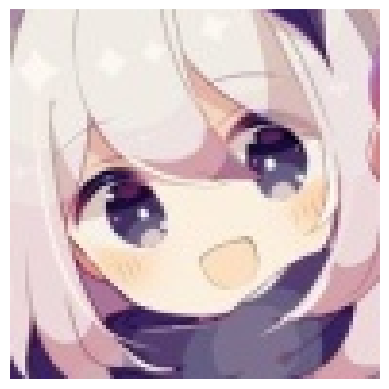

True Label: paimon_(genshin_impact)
This image is likely belongs to:
> paimon_(genshin_impact) : 27.07 % confidence.
> unicorn_(azur_lane) : 16.53 % confidence.
> nakano_yotsuba : 9.69 % confidence.
> hirasawa_yui : 3.76 % confidence.
> suzuhara_lulu : 2.62 % confidence.


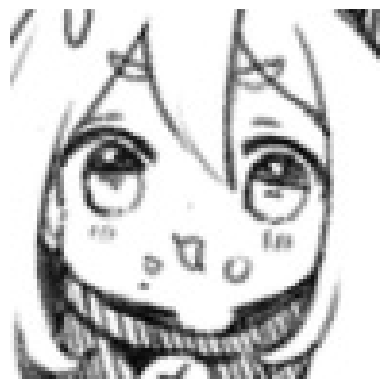

True Label: paimon_(genshin_impact)
This image is likely belongs to:
> astolfo_(fate) : 6.31 % confidence.
> shirakami_fubuki : 4.57 % confidence.
> karna_(fate) : 4.08 % confidence.
> asuna_(sao) : 3.45 % confidence.
> ayanami_rei : 3.30 % confidence.


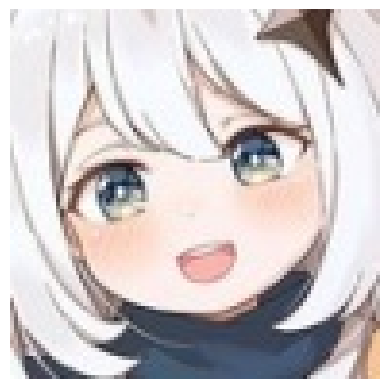

True Label: paimon_(genshin_impact)
This image is likely belongs to:
> paimon_(genshin_impact) : 51.54 % confidence.
> okita_souji_(fate) : 3.79 % confidence.
> cleveland_(azur_lane) : 2.91 % confidence.
> gawr_gura : 2.55 % confidence.
> nekomata_okayu : 1.59 % confidence.


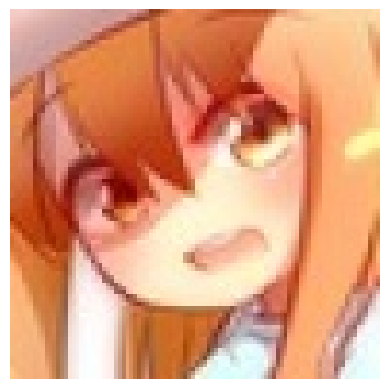

True Label: platelet_(hataraku_saibou)
This image is likely belongs to:
> platelet_(hataraku_saibou) : 12.56 % confidence.
> illyasviel_von_einzbern : 8.90 % confidence.
> bremerton_(azur_lane) : 8.15 % confidence.
> irisviel_von_einzbern : 6.27 % confidence.
> oshino_shinobu : 6.23 % confidence.


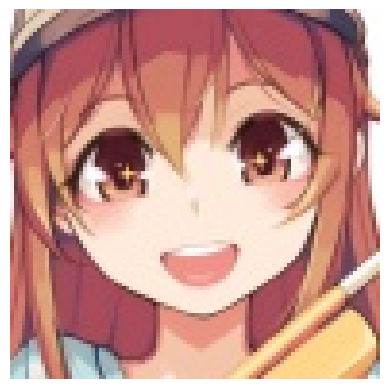

True Label: platelet_(hataraku_saibou)
This image is likely belongs to:
> platelet_(hataraku_saibou) : 23.09 % confidence.
> sakurauchi_riko : 5.17 % confidence.
> megumin : 4.55 % confidence.
> bremerton_(azur_lane) : 4.13 % confidence.
> shidare_hotaru : 3.94 % confidence.


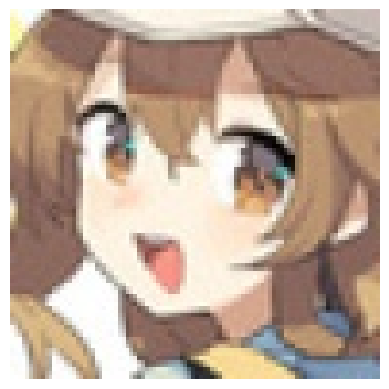

True Label: platelet_(hataraku_saibou)
This image is likely belongs to:
> platelet_(hataraku_saibou) : 38.67 % confidence.
> mei_(pokemon) : 7.35 % confidence.
> sengoku_nadeko : 3.92 % confidence.
> takamaki_anne : 3.01 % confidence.
> aegis_(persona) : 2.98 % confidence.


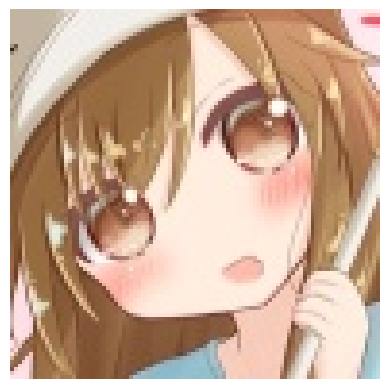

True Label: platelet_(hataraku_saibou)
This image is likely belongs to:
> platelet_(hataraku_saibou) : 21.49 % confidence.
> abigail_williams_(fate) : 16.14 % confidence.
> asia_argento : 4.79 % confidence.
> mei_(pokemon) : 4.64 % confidence.
> illyasviel_von_einzbern : 4.12 % confidence.


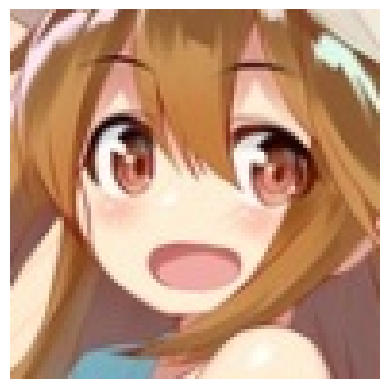

True Label: platelet_(hataraku_saibou)
This image is likely belongs to:
> platelet_(hataraku_saibou) : 13.48 % confidence.
> raphtalia : 9.55 % confidence.
> oshino_shinobu : 4.96 % confidence.
> kiryu_coco : 4.25 % confidence.
> cleveland_(azur_lane) : 3.98 % confidence.


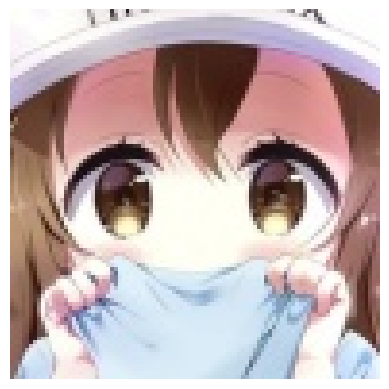

True Label: platelet_(hataraku_saibou)
This image is likely belongs to:
> platelet_(hataraku_saibou) : 52.37 % confidence.
> mei_(pokemon) : 27.58 % confidence.
> megumin : 5.75 % confidence.
> shibuya_rin : 1.65 % confidence.
> oshino_shinobu : 0.86 % confidence.


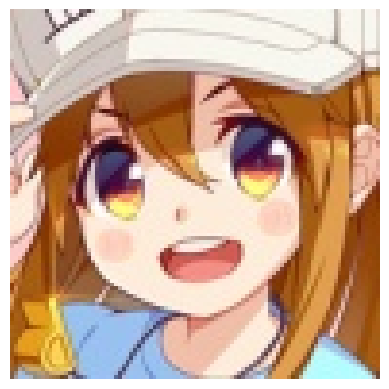

True Label: platelet_(hataraku_saibou)
This image is likely belongs to:
> platelet_(hataraku_saibou) : 92.16 % confidence.
> mei_(pokemon) : 0.74 % confidence.
> oshino_shinobu : 0.61 % confidence.
> kiryu_coco : 0.55 % confidence.
> suzumiya_haruhi : 0.53 % confidence.


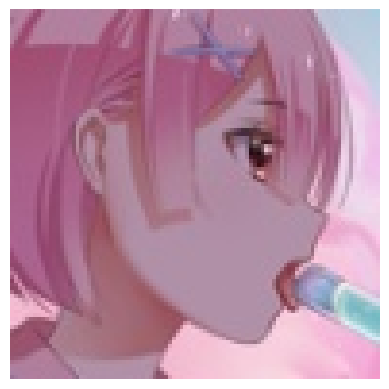

True Label: ram_rezero
This image is likely belongs to:
> ram_rezero : 15.67 % confidence.
> takagi-san : 4.30 % confidence.
> hanekawa_tsubasa : 4.19 % confidence.
> senjougahara_hitagi : 3.73 % confidence.
> kaname_madoka : 3.53 % confidence.


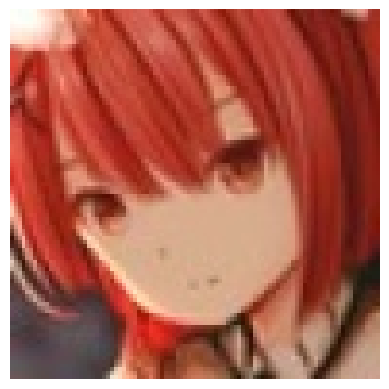

True Label: ram_rezero
This image is likely belongs to:
> furukawa_nagisa : 16.18 % confidence.
> yuigahama_yui : 4.38 % confidence.
> bremerton_(azur_lane) : 3.85 % confidence.
> nishikino_maki : 3.76 % confidence.
> aisaka_taiga : 2.96 % confidence.


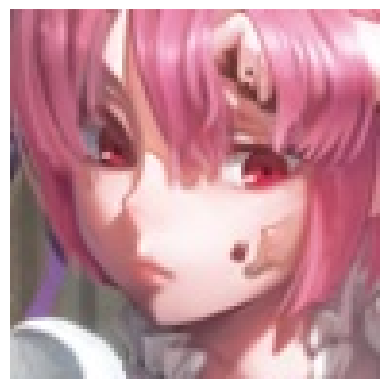

True Label: ram_rezero
This image is likely belongs to:
> rias_gremory : 15.38 % confidence.
> nishikino_maki : 3.29 % confidence.
> mori_calliope : 2.85 % confidence.
> hatsune_miku : 2.74 % confidence.
> tsushima_yoshiko : 2.69 % confidence.


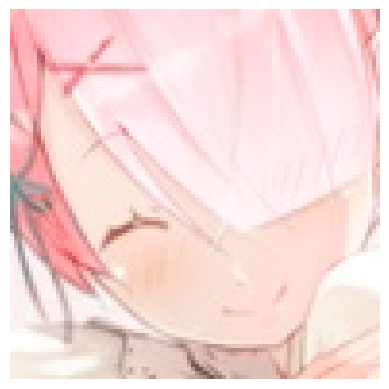

True Label: ram_rezero
This image is likely belongs to:
> ram_rezero : 11.99 % confidence.
> karna_(fate) : 6.48 % confidence.
> belfast_(azur_lane) : 6.23 % confidence.
> shirakami_fubuki : 5.53 % confidence.
> bremerton_(azur_lane) : 4.01 % confidence.


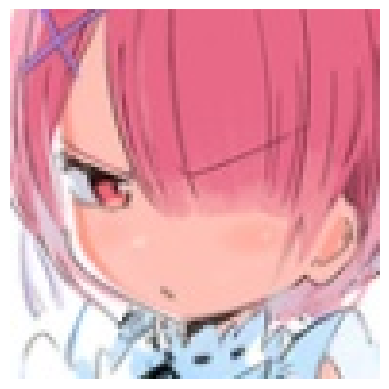

True Label: ram_rezero
This image is likely belongs to:
> ram_rezero : 81.58 % confidence.
> rem_rezero : 3.53 % confidence.
> tokoyami_towa : 1.09 % confidence.
> suzuhara_lulu : 0.97 % confidence.
> mash_kyrielight : 0.90 % confidence.


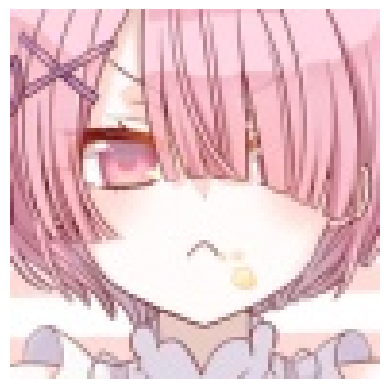

True Label: ram_rezero
This image is likely belongs to:
> ram_rezero : 12.24 % confidence.
> rem_rezero : 5.63 % confidence.
> mash_kyrielight : 5.57 % confidence.
> dido_(azur_lane) : 3.21 % confidence.
> suzuhara_lulu : 2.73 % confidence.


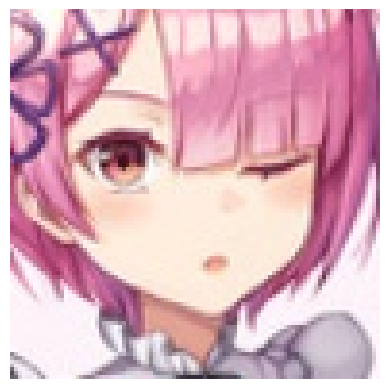

True Label: ram_rezero
This image is likely belongs to:
> ram_rezero : 22.30 % confidence.
> rem_rezero : 8.58 % confidence.
> mash_kyrielight : 6.10 % confidence.
> meltlilith : 4.11 % confidence.
> nakano_nino : 4.10 % confidence.


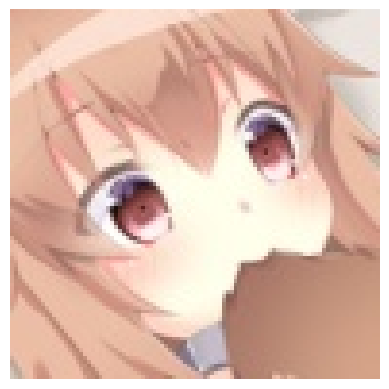

True Label: raphtalia
This image is likely belongs to:
> anastasia_(idolmaster) : 12.38 % confidence.
> okita_souji_(fate) : 5.05 % confidence.
> nagato_yuki : 4.69 % confidence.
> toosaka_rin : 4.36 % confidence.
> kaname_madoka : 3.60 % confidence.


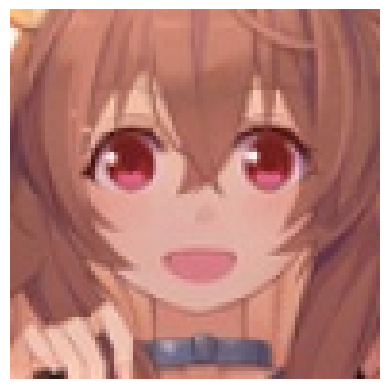

True Label: raphtalia
This image is likely belongs to:
> raphtalia : 47.31 % confidence.
> kiryu_coco : 6.18 % confidence.
> platelet_(hataraku_saibou) : 4.66 % confidence.
> arcueid_brunestud : 3.57 % confidence.
> aisaka_taiga : 3.07 % confidence.


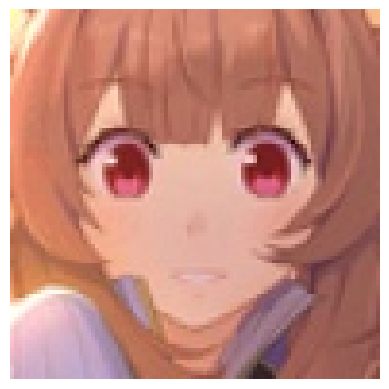

True Label: raphtalia
This image is likely belongs to:
> raphtalia : 76.72 % confidence.
> isshiki_iroha : 3.64 % confidence.
> aisaka_taiga : 1.28 % confidence.
> shirogane_noel : 1.26 % confidence.
> kiryu_coco : 1.25 % confidence.


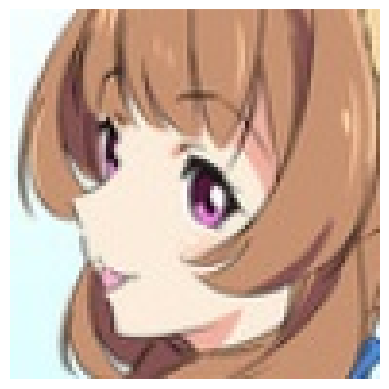

True Label: raphtalia
This image is likely belongs to:
> suzumiya_haruhi : 18.12 % confidence.
> hirasawa_yui : 10.95 % confidence.
> nakano_yotsuba : 9.84 % confidence.
> yuigahama_yui : 5.29 % confidence.
> aisaka_taiga : 5.18 % confidence.


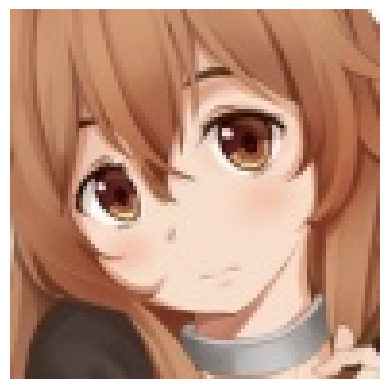

True Label: raphtalia
This image is likely belongs to:
> raphtalia : 16.21 % confidence.
> aisaka_taiga : 12.39 % confidence.
> cleveland_(azur_lane) : 7.45 % confidence.
> hirasawa_yui : 4.74 % confidence.
> asuna_(sao) : 3.71 % confidence.


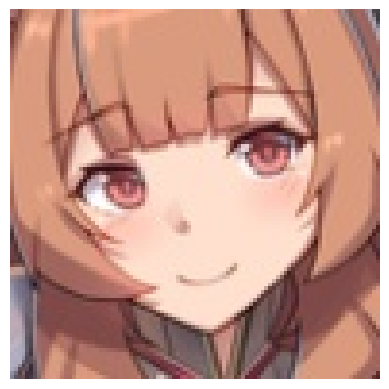

True Label: raphtalia
This image is likely belongs to:
> raphtalia : 36.04 % confidence.
> ninomae_ina'nis : 10.38 % confidence.
> kiryu_coco : 7.71 % confidence.
> isshiki_iroha : 5.54 % confidence.
> megumin : 2.39 % confidence.


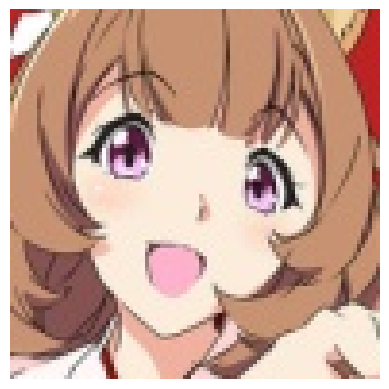

True Label: raphtalia
This image is likely belongs to:
> satonaka_chie : 7.92 % confidence.
> hirasawa_yui : 5.55 % confidence.
> raphtalia : 5.53 % confidence.
> suzumiya_haruhi : 5.01 % confidence.
> toosaka_rin : 4.84 % confidence.


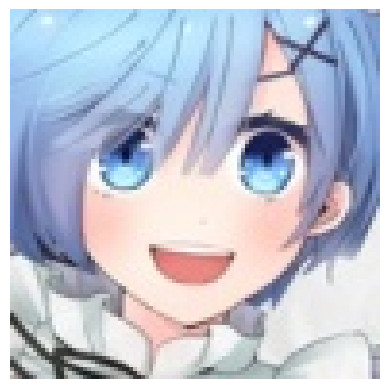

True Label: rem_rezero
This image is likely belongs to:
> rem_rezero : 57.27 % confidence.
> nagato_yuki : 5.01 % confidence.
> aqua_(konosuba) : 2.28 % confidence.
> meltlilith : 2.14 % confidence.
> takanashi_rikka : 2.02 % confidence.


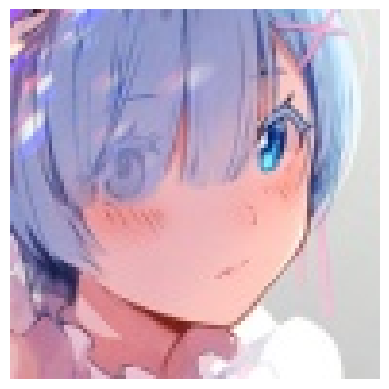

True Label: rem_rezero
This image is likely belongs to:
> ram_rezero : 14.75 % confidence.
> rem_rezero : 8.17 % confidence.
> minato_aqua : 6.77 % confidence.
> oshino_shinobu : 4.79 % confidence.
> kaname_madoka : 3.81 % confidence.


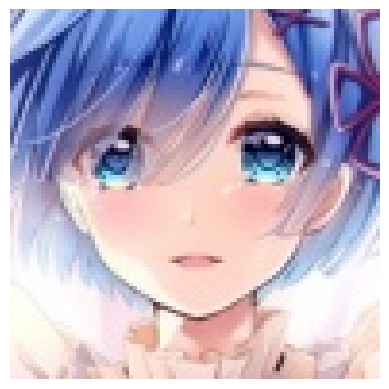

True Label: rem_rezero
This image is likely belongs to:
> rem_rezero : 38.97 % confidence.
> anastasia_(idolmaster) : 9.36 % confidence.
> shirakami_fubuki : 7.36 % confidence.
> aegis_(persona) : 3.22 % confidence.
> toujou_nozomi : 2.91 % confidence.


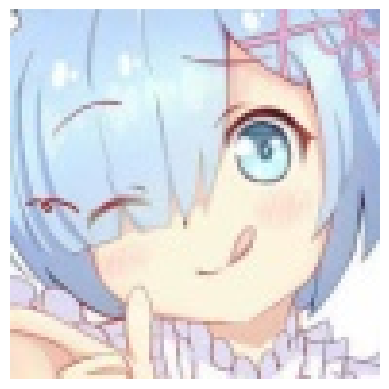

True Label: rem_rezero
This image is likely belongs to:
> rem_rezero : 15.59 % confidence.
> aqua_(konosuba) : 7.97 % confidence.
> ram_rezero : 5.34 % confidence.
> hatsune_miku : 5.14 % confidence.
> minato_aqua : 3.85 % confidence.


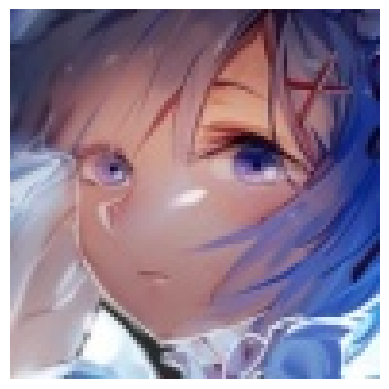

True Label: rem_rezero
This image is likely belongs to:
> ram_rezero : 9.17 % confidence.
> kaname_madoka : 7.03 % confidence.
> rem_rezero : 5.82 % confidence.
> tokoyami_towa : 4.93 % confidence.
> toujou_nozomi : 4.88 % confidence.


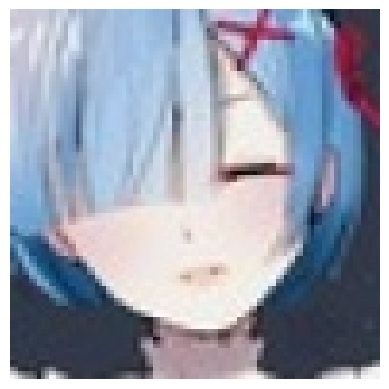

True Label: rem_rezero
This image is likely belongs to:
> shuten_douji_(fate) : 70.82 % confidence.
> rem_rezero : 3.71 % confidence.
> ram_rezero : 3.34 % confidence.
> shirogane_noel : 2.96 % confidence.
> karin_(blue_archive) : 2.50 % confidence.


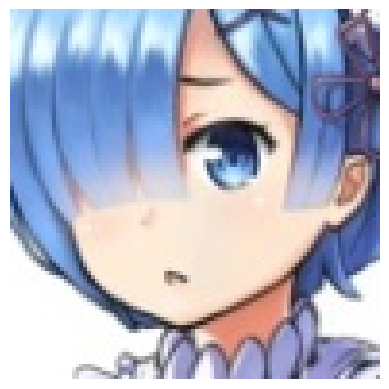

True Label: rem_rezero
This image is likely belongs to:
> rem_rezero : 86.72 % confidence.
> ram_rezero : 4.39 % confidence.
> nakano_yotsuba : 2.16 % confidence.
> unicorn_(azur_lane) : 1.01 % confidence.
> mash_kyrielight : 0.42 % confidence.


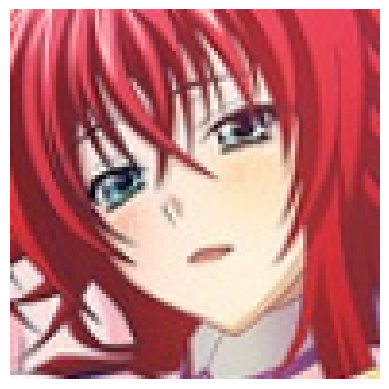

True Label: rias_gremory
This image is likely belongs to:
> rias_gremory : 81.47 % confidence.
> xenovia_(high_school_dxd) : 3.84 % confidence.
> nami_(one_piece) : 1.83 % confidence.
> makise_kurisu : 1.61 % confidence.
> nishikino_maki : 1.27 % confidence.


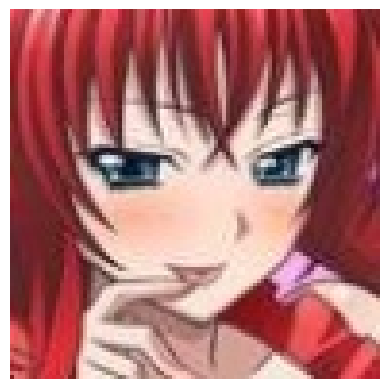

True Label: rias_gremory
This image is likely belongs to:
> rias_gremory : 44.33 % confidence.
> fujibayashi_kyou : 6.32 % confidence.
> furukawa_nagisa : 5.76 % confidence.
> yukinoshita_yukino : 3.76 % confidence.
> suzumiya_haruhi : 3.11 % confidence.


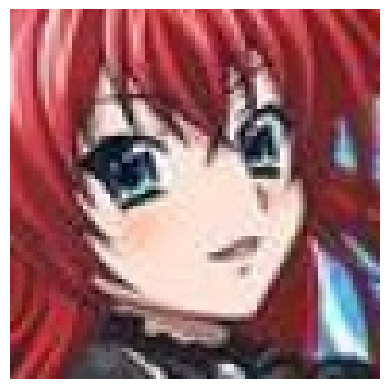

True Label: rias_gremory
This image is likely belongs to:
> rias_gremory : 75.74 % confidence.
> fujibayashi_kyou : 3.29 % confidence.
> nishikino_maki : 1.45 % confidence.
> souryuu_asuka_langley : 1.10 % confidence.
> furukawa_nagisa : 0.87 % confidence.


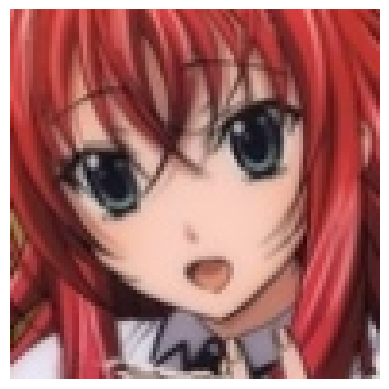

True Label: rias_gremory
This image is likely belongs to:
> furukawa_nagisa : 17.61 % confidence.
> rias_gremory : 12.67 % confidence.
> nakano_azusa : 4.98 % confidence.
> makise_kurisu : 4.30 % confidence.
> megumin : 3.37 % confidence.


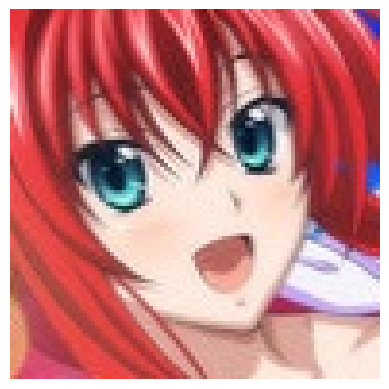

True Label: rias_gremory
This image is likely belongs to:
> rias_gremory : 49.89 % confidence.
> hatsune_miku : 4.94 % confidence.
> nishikino_maki : 3.07 % confidence.
> xenovia_(high_school_dxd) : 2.90 % confidence.
> astolfo_(fate) : 2.58 % confidence.


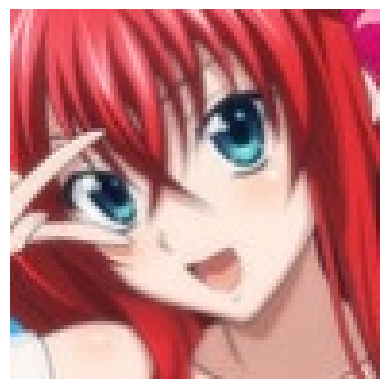

True Label: rias_gremory
This image is likely belongs to:
> rias_gremory : 53.37 % confidence.
> nami_(one_piece) : 6.45 % confidence.
> nakano_itsuki : 4.90 % confidence.
> xenovia_(high_school_dxd) : 2.68 % confidence.
> fujibayashi_kyou : 2.14 % confidence.


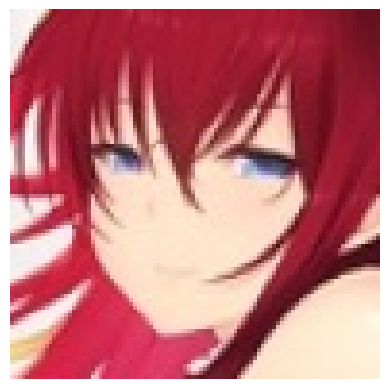

True Label: rias_gremory
This image is likely belongs to:
> oshino_ougi : 11.20 % confidence.
> shirogane_naoto : 11.13 % confidence.
> kirito : 8.78 % confidence.
> xenovia_(high_school_dxd) : 4.47 % confidence.
> fubuki_(one-punch_man) : 4.27 % confidence.


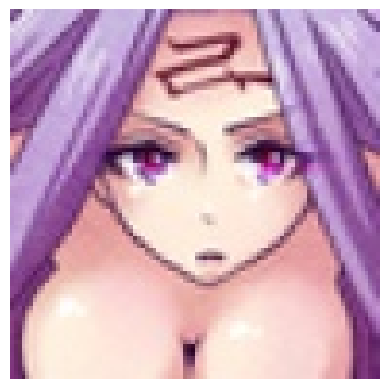

True Label: rider
This image is likely belongs to:
> rider : 15.13 % confidence.
> enterprise_(azur_lane) : 11.26 % confidence.
> abigail_williams_(fate) : 9.86 % confidence.
> nami_(one_piece) : 8.68 % confidence.
> irisviel_von_einzbern : 6.92 % confidence.


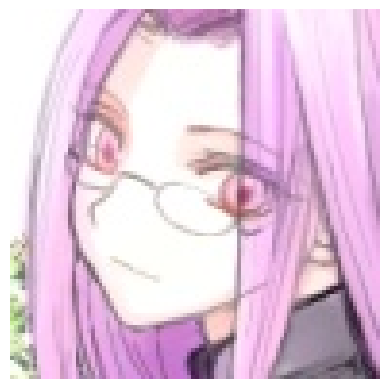

True Label: rider
This image is likely belongs to:
> rider : 54.60 % confidence.
> irisviel_von_einzbern : 4.61 % confidence.
> abigail_williams_(fate) : 2.84 % confidence.
> miyazono_kawori : 1.93 % confidence.
> shibuya_rin : 1.92 % confidence.


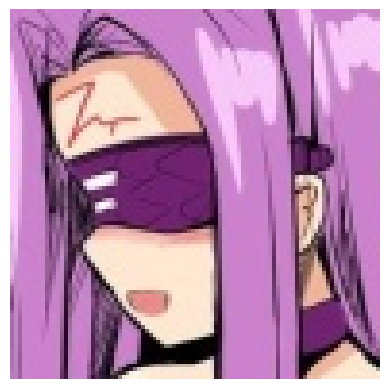

True Label: rider
This image is likely belongs to:
> rider : 34.15 % confidence.
> nakano_miku : 20.63 % confidence.
> albedo : 5.98 % confidence.
> suzuhara_lulu : 3.64 % confidence.
> semiramis_(fate) : 3.06 % confidence.


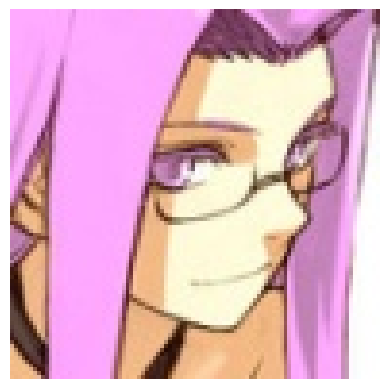

True Label: rider
This image is likely belongs to:
> rider : 34.02 % confidence.
> nico_robin : 8.08 % confidence.
> irisviel_von_einzbern : 4.12 % confidence.
> rias_gremory : 2.70 % confidence.
> sakura_futaba : 2.66 % confidence.


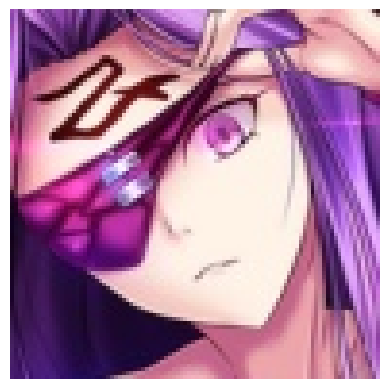

True Label: rider
This image is likely belongs to:
> waver_velvet : 19.31 % confidence.
> sakurauchi_riko : 5.22 % confidence.
> nico_robin : 5.10 % confidence.
> ichigo_(darling_in_the_franxx) : 4.59 % confidence.
> semiramis_(fate) : 4.37 % confidence.


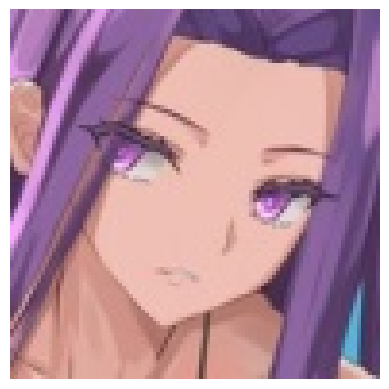

True Label: rider
This image is likely belongs to:
> abigail_williams_(fate) : 22.97 % confidence.
> rider : 15.68 % confidence.
> shidare_hotaru : 15.13 % confidence.
> kochou_shinobu : 8.82 % confidence.
> irisviel_von_einzbern : 6.86 % confidence.


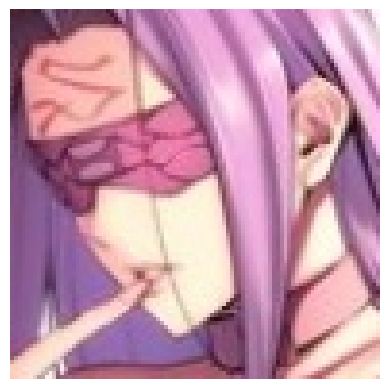

True Label: rider
This image is likely belongs to:
> rider : 50.20 % confidence.
> st_ar-15_(girls_frontline) : 6.18 % confidence.
> bremerton_(azur_lane) : 3.50 % confidence.
> albedo : 3.10 % confidence.
> karna_(fate) : 2.80 % confidence.


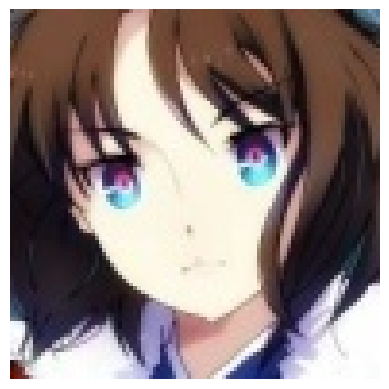

True Label: ryougi_shiki
This image is likely belongs to:
> kizuna_ai : 21.92 % confidence.
> ouro_kronii : 18.19 % confidence.
> toujou_nozomi : 9.20 % confidence.
> ryougi_shiki : 4.82 % confidence.
> takarada_rikka : 3.58 % confidence.


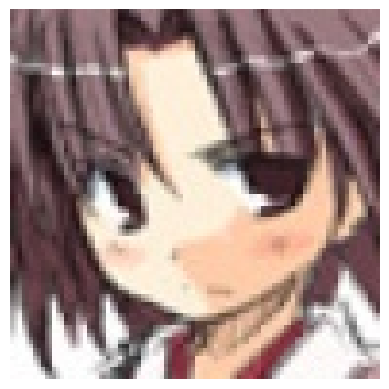

True Label: ryougi_shiki
This image is likely belongs to:
> ryougi_shiki : 15.25 % confidence.
> fujibayashi_kyou : 11.76 % confidence.
> nakano_yotsuba : 8.88 % confidence.
> nagato_yuki : 5.94 % confidence.
> gawr_gura : 5.60 % confidence.


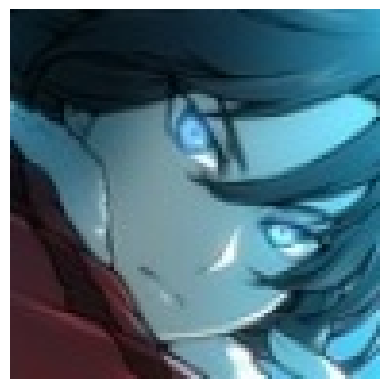

True Label: ryougi_shiki
This image is likely belongs to:
> karna_(fate) : 33.45 % confidence.
> atago_(azur_lane) : 8.80 % confidence.
> albedo : 5.54 % confidence.
> kirito : 4.28 % confidence.
> chloe_von_einzbern : 2.49 % confidence.


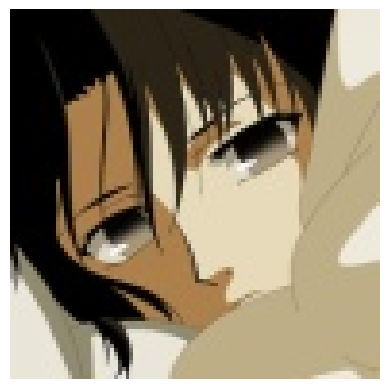

True Label: ryougi_shiki
This image is likely belongs to:
> kirito : 18.20 % confidence.
> atago_(azur_lane) : 12.60 % confidence.
> komi_shouko : 5.08 % confidence.
> albedo : 4.01 % confidence.
> meltlilith : 4.01 % confidence.


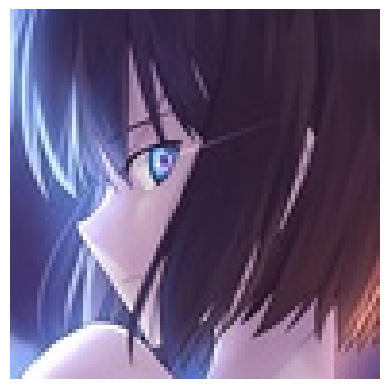

True Label: ryougi_shiki
This image is likely belongs to:
> ayanami_rei : 7.86 % confidence.
> satonaka_chie : 6.98 % confidence.
> kirito : 6.84 % confidence.
> ryougi_shiki : 4.71 % confidence.
> unicorn_(azur_lane) : 4.24 % confidence.


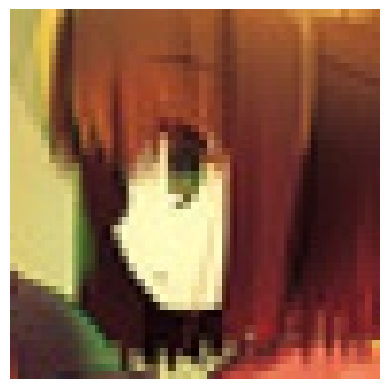

True Label: ryougi_shiki
This image is likely belongs to:
> ryougi_shiki : 23.01 % confidence.
> sakura_futaba : 19.44 % confidence.
> ninomae_ina'nis : 5.49 % confidence.
> oshino_ougi : 4.73 % confidence.
> souryuu_asuka_langley : 4.49 % confidence.


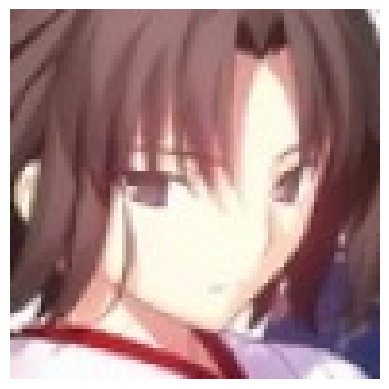

True Label: ryougi_shiki
This image is likely belongs to:
> nakano_miku : 8.59 % confidence.
> ryougi_shiki : 7.64 % confidence.
> shinomiya_kaguya : 5.92 % confidence.
> fubuki_(one-punch_man) : 4.45 % confidence.
> takanashi_rikka : 4.08 % confidence.


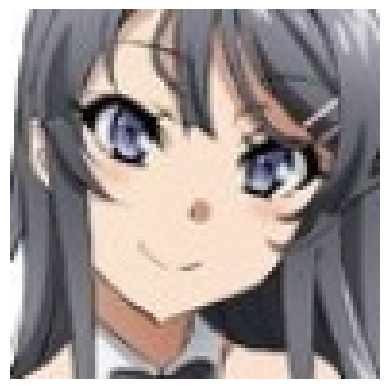

True Label: sakurajima_mai
This image is likely belongs to:
> fujibayashi_kyou : 65.09 % confidence.
> suzumiya_haruhi : 4.68 % confidence.
> katsuragi_misato : 2.36 % confidence.
> sakurajima_mai : 1.58 % confidence.
> aqua_(konosuba) : 1.47 % confidence.


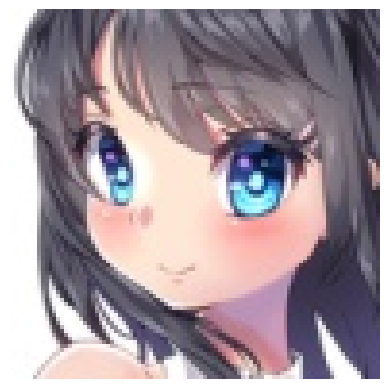

True Label: sakurajima_mai
This image is likely belongs to:
> utsumi_erise : 11.18 % confidence.
> kizuna_ai : 10.85 % confidence.
> nakano_itsuki : 5.37 % confidence.
> takamaki_anne : 4.26 % confidence.
> takarada_rikka : 3.80 % confidence.


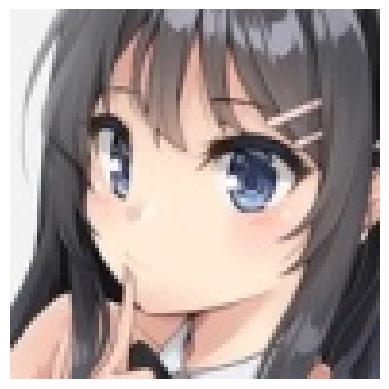

True Label: sakurajima_mai
This image is likely belongs to:
> sakurajima_mai : 10.22 % confidence.
> yukinoshita_yukino : 8.99 % confidence.
> megumin : 5.73 % confidence.
> chitanda_eru : 4.74 % confidence.
> toosaka_rin : 4.46 % confidence.


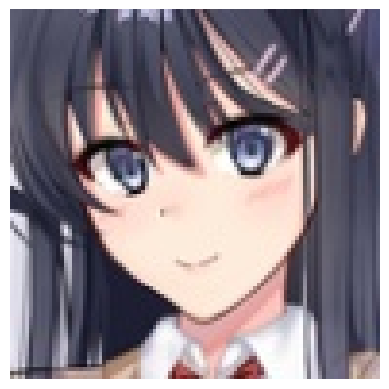

True Label: sakurajima_mai
This image is likely belongs to:
> misaka_mikoto : 12.42 % confidence.
> yukinoshita_yukino : 7.82 % confidence.
> yuigahama_yui : 5.91 % confidence.
> fujibayashi_kyou : 5.58 % confidence.
> sakurajima_mai : 5.23 % confidence.


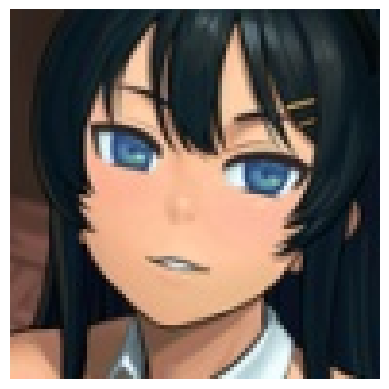

True Label: sakurajima_mai
This image is likely belongs to:
> karin_(blue_archive) : 13.48 % confidence.
> hyuuga_hinata : 12.34 % confidence.
> yukinoshita_yukino : 11.27 % confidence.
> sakurajima_mai : 5.92 % confidence.
> nakano_azusa : 3.68 % confidence.


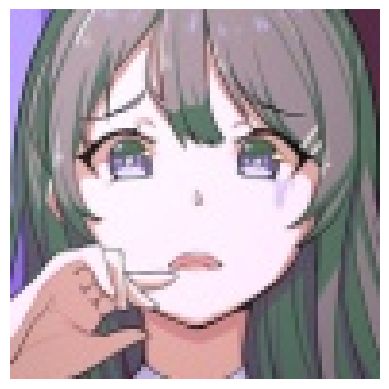

True Label: sakurajima_mai
This image is likely belongs to:
> tsushima_yoshiko : 6.61 % confidence.
> shidare_hotaru : 4.15 % confidence.
> takarada_rikka : 3.50 % confidence.
> suzumiya_haruhi : 3.39 % confidence.
> gawr_gura : 3.32 % confidence.


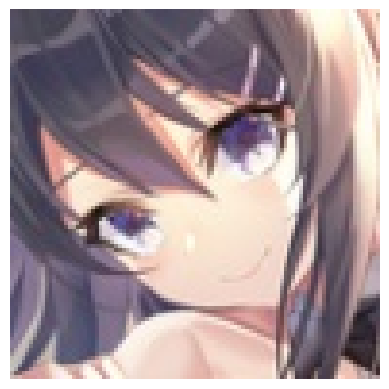

True Label: sakurajima_mai
This image is likely belongs to:
> xenovia_(high_school_dxd) : 20.53 % confidence.
> sakurajima_mai : 4.70 % confidence.
> atago_(azur_lane) : 4.62 % confidence.
> suzumiya_haruhi : 3.13 % confidence.
> shibuya_rin : 2.62 % confidence.


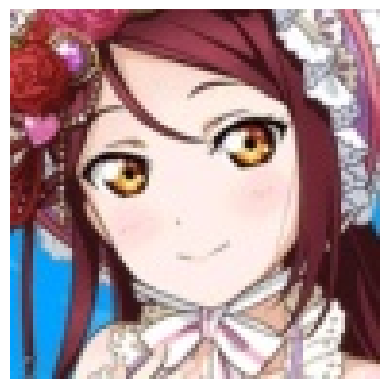

True Label: sakurauchi_riko
This image is likely belongs to:
> sakurauchi_riko : 43.97 % confidence.
> giorno_giovanna : 3.81 % confidence.
> nico_robin : 2.68 % confidence.
> nishikino_maki : 2.10 % confidence.
> sengoku_nadeko : 2.06 % confidence.


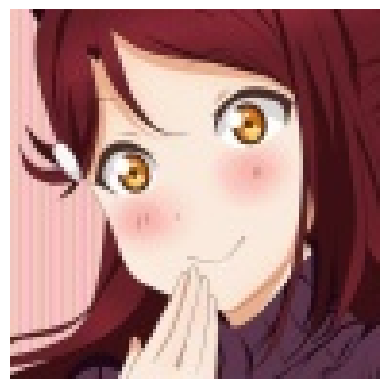

True Label: sakurauchi_riko
This image is likely belongs to:
> sakurauchi_riko : 23.70 % confidence.
> ookami_mio : 10.54 % confidence.
> nishikino_maki : 4.92 % confidence.
> mei_(pokemon) : 4.22 % confidence.
> hatsune_miku : 4.08 % confidence.


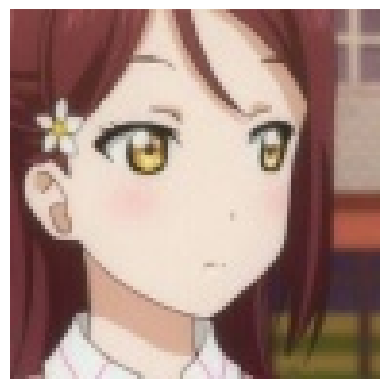

True Label: sakurauchi_riko
This image is likely belongs to:
> sakurauchi_riko : 10.85 % confidence.
> belfast_(azur_lane) : 5.30 % confidence.
> formidable_(azur_lane) : 3.40 % confidence.
> takamaki_anne : 3.33 % confidence.
> watson_amelia : 3.10 % confidence.


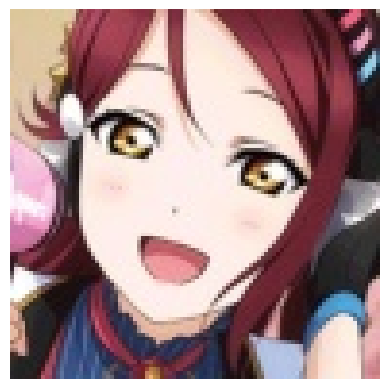

True Label: sakurauchi_riko
This image is likely belongs to:
> sakurauchi_riko : 50.21 % confidence.
> shidare_hotaru : 3.81 % confidence.
> bremerton_(azur_lane) : 3.41 % confidence.
> d.va_(overwatch) : 2.80 % confidence.
> kiryu_coco : 2.74 % confidence.


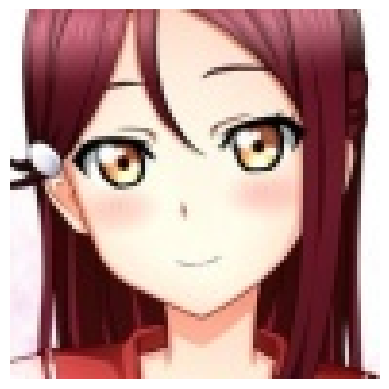

True Label: sakurauchi_riko
This image is likely belongs to:
> sakurauchi_riko : 39.25 % confidence.
> nico_robin : 14.24 % confidence.
> takamaki_anne : 3.00 % confidence.
> yukinoshita_yukino : 2.26 % confidence.
> hyuuga_hinata : 1.97 % confidence.


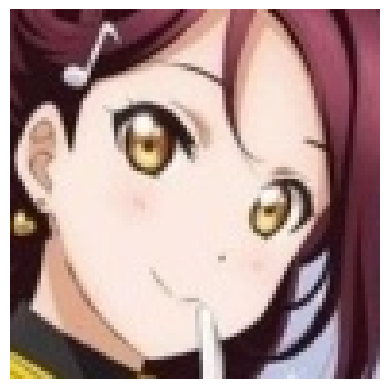

True Label: sakurauchi_riko
This image is likely belongs to:
> sakurauchi_riko : 18.73 % confidence.
> cleveland_(azur_lane) : 6.49 % confidence.
> bremerton_(azur_lane) : 4.38 % confidence.
> asuna_(sao) : 4.36 % confidence.
> abigail_williams_(fate) : 4.32 % confidence.


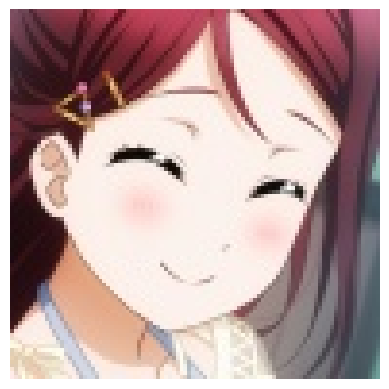

True Label: sakurauchi_riko
This image is likely belongs to:
> toujou_nozomi : 5.98 % confidence.
> sakurauchi_riko : 5.16 % confidence.
> kizuna_ai : 4.40 % confidence.
> shirogane_noel : 4.26 % confidence.
> shibuya_rin : 3.97 % confidence.


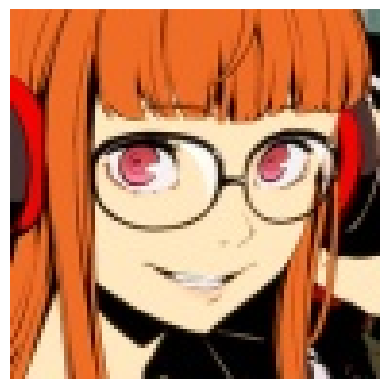

True Label: sakura_futaba
This image is likely belongs to:
> sakura_futaba : 87.06 % confidence.
> st_ar-15_(girls_frontline) : 1.31 % confidence.
> kiryu_coco : 1.26 % confidence.
> zero_two_(darling_in_the_franxx) : 1.07 % confidence.
> makise_kurisu : 0.59 % confidence.


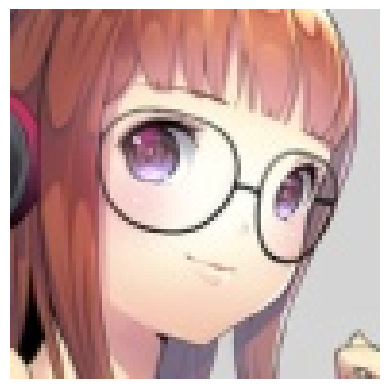

True Label: sakura_futaba
This image is likely belongs to:
> sakura_futaba : 12.07 % confidence.
> asia_argento : 4.25 % confidence.
> nagato_yuki : 4.15 % confidence.
> tsushima_yoshiko : 3.51 % confidence.
> nishikino_maki : 3.37 % confidence.


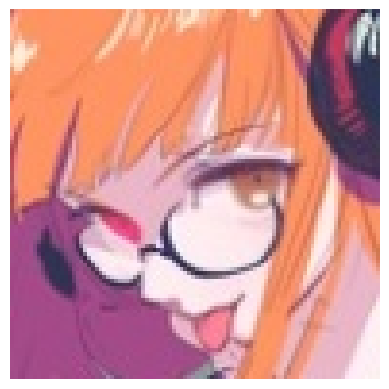

True Label: sakura_futaba
This image is likely belongs to:
> sinon : 4.58 % confidence.
> sakura_futaba : 4.22 % confidence.
> nakano_itsuki : 2.59 % confidence.
> rider : 2.48 % confidence.
> st_ar-15_(girls_frontline) : 2.46 % confidence.


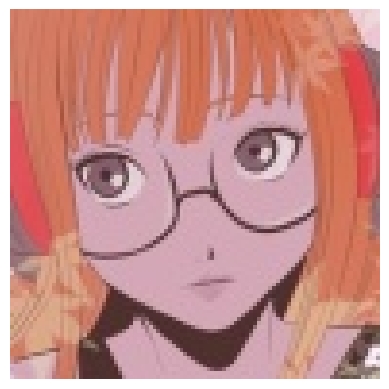

True Label: sakura_futaba
This image is likely belongs to:
> fujibayashi_kyou : 8.09 % confidence.
> takarada_rikka : 5.46 % confidence.
> oshino_shinobu : 4.72 % confidence.
> sakura_futaba : 4.13 % confidence.
> suzumiya_haruhi : 3.91 % confidence.


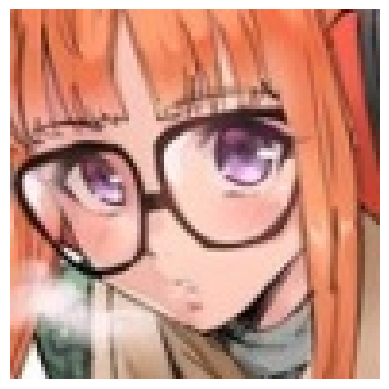

True Label: sakura_futaba
This image is likely belongs to:
> sakura_futaba : 37.68 % confidence.
> mei_(pokemon) : 4.19 % confidence.
> nakano_nino : 4.03 % confidence.
> emilia_rezero : 3.39 % confidence.
> fujiwara_chika : 2.97 % confidence.


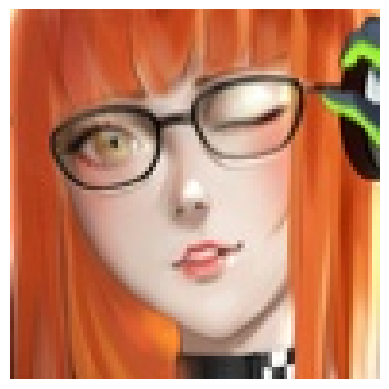

True Label: sakura_futaba
This image is likely belongs to:
> gilgamesh : 13.36 % confidence.
> sakura_futaba : 11.97 % confidence.
> hyuuga_hinata : 10.11 % confidence.
> nami_(one_piece) : 5.00 % confidence.
> nico_robin : 4.67 % confidence.


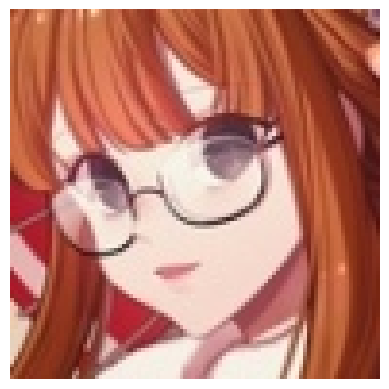

True Label: sakura_futaba
This image is likely belongs to:
> sakura_futaba : 28.40 % confidence.
> souryuu_asuka_langley : 8.72 % confidence.
> kiryu_coco : 5.55 % confidence.
> oshino_shinobu : 5.19 % confidence.
> watson_amelia : 3.39 % confidence.


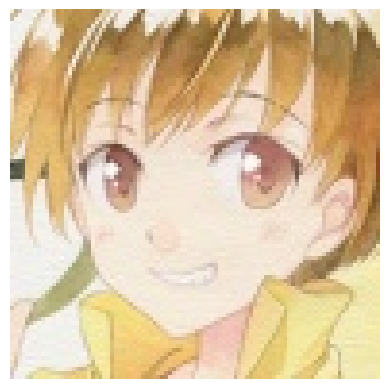

True Label: satonaka_chie
This image is likely belongs to:
> satonaka_chie : 10.37 % confidence.
> ishtar_(fate_grand_order) : 7.39 % confidence.
> aegis_(persona) : 3.88 % confidence.
> oshino_shinobu : 3.70 % confidence.
> chitanda_eru : 3.45 % confidence.


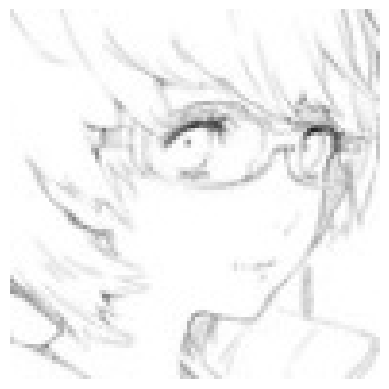

True Label: satonaka_chie
This image is likely belongs to:
> kaname_madoka : 8.91 % confidence.
> jonathan_joestar : 4.97 % confidence.
> kochou_shinobu : 4.84 % confidence.
> shidare_hotaru : 3.03 % confidence.
> mash_kyrielight : 2.86 % confidence.


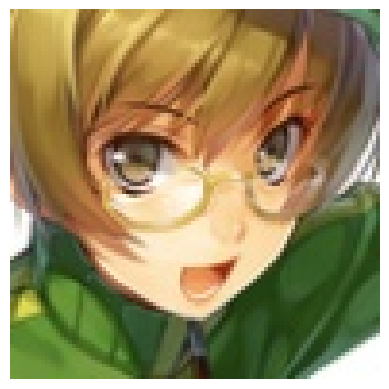

True Label: satonaka_chie
This image is likely belongs to:
> satonaka_chie : 40.11 % confidence.
> aegis_(persona) : 6.45 % confidence.
> c.c : 5.34 % confidence.
> shirogane_naoto : 4.39 % confidence.
> oshino_shinobu : 3.68 % confidence.


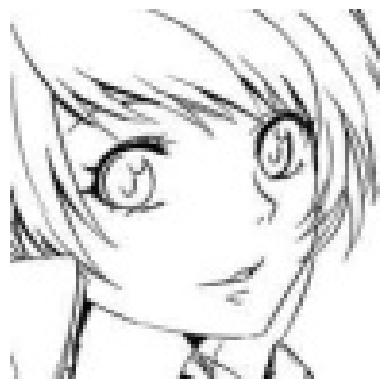

True Label: satonaka_chie
This image is likely belongs to:
> kaname_madoka : 9.21 % confidence.
> toujou_nozomi : 8.54 % confidence.
> satonaka_chie : 8.24 % confidence.
> nagato_yuki : 7.23 % confidence.
> toosaka_rin : 5.09 % confidence.


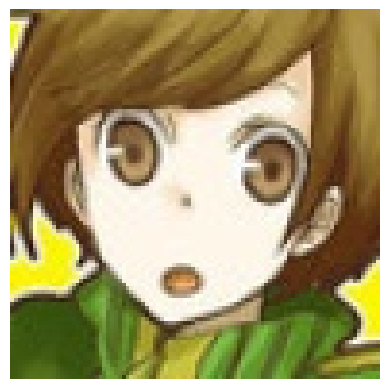

True Label: satonaka_chie
This image is likely belongs to:
> satonaka_chie : 10.82 % confidence.
> hirasawa_yui : 8.51 % confidence.
> aisaka_taiga : 6.42 % confidence.
> tokoyami_towa : 4.92 % confidence.
> furukawa_nagisa : 4.75 % confidence.


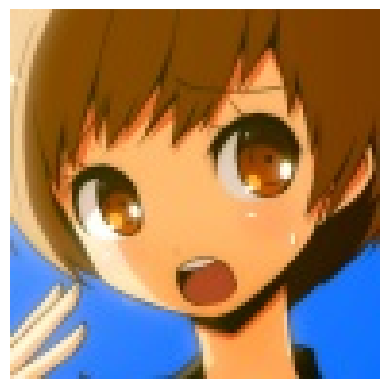

True Label: satonaka_chie
This image is likely belongs to:
> satonaka_chie : 20.29 % confidence.
> nagato_yuki : 9.48 % confidence.
> unicorn_(azur_lane) : 4.15 % confidence.
> aisaka_taiga : 3.86 % confidence.
> senjougahara_hitagi : 3.32 % confidence.


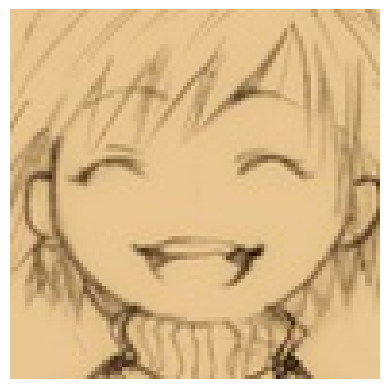

True Label: satonaka_chie
This image is likely belongs to:
> astolfo_(fate) : 10.76 % confidence.
> shishiro_botan : 8.10 % confidence.
> yuigahama_yui : 5.17 % confidence.
> oshino_ougi : 5.09 % confidence.
> miyazono_kawori : 4.72 % confidence.


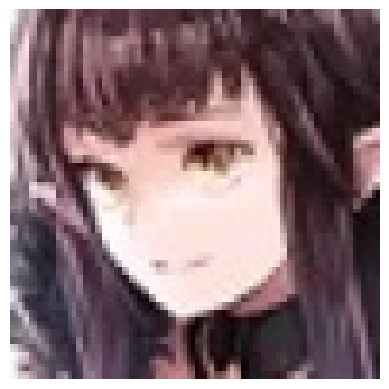

True Label: semiramis_(fate)
This image is likely belongs to:
> semiramis_(fate) : 7.48 % confidence.
> nakano_nino : 4.41 % confidence.
> chitanda_eru : 3.83 % confidence.
> fujibayashi_kyou : 3.80 % confidence.
> matou_sakura : 3.48 % confidence.


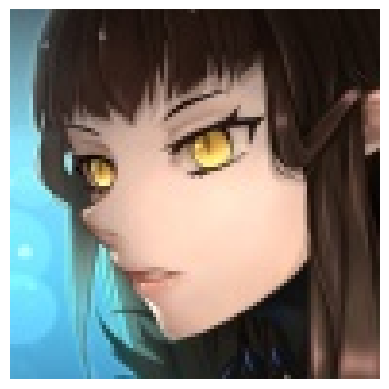

True Label: semiramis_(fate)
This image is likely belongs to:
> ishtar_(fate_grand_order) : 13.60 % confidence.
> yukinoshita_yukino : 6.68 % confidence.
> toosaka_rin : 6.37 % confidence.
> shidare_hotaru : 3.93 % confidence.
> belfast_(azur_lane) : 3.61 % confidence.


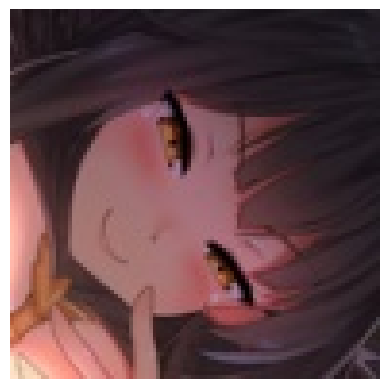

True Label: semiramis_(fate)
This image is likely belongs to:
> toosaka_rin : 7.54 % confidence.
> ryougi_shiki : 6.30 % confidence.
> ookami_mio : 5.81 % confidence.
> kochou_shinobu : 4.22 % confidence.
> oshino_ougi : 3.38 % confidence.


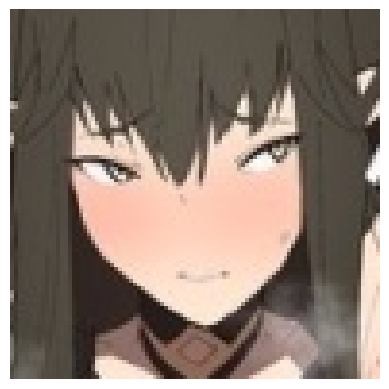

True Label: semiramis_(fate)
This image is likely belongs to:
> kirito : 5.88 % confidence.
> makise_kurisu : 4.98 % confidence.
> meltlilith : 3.96 % confidence.
> ouro_kronii : 3.93 % confidence.
> oshino_ougi : 3.91 % confidence.


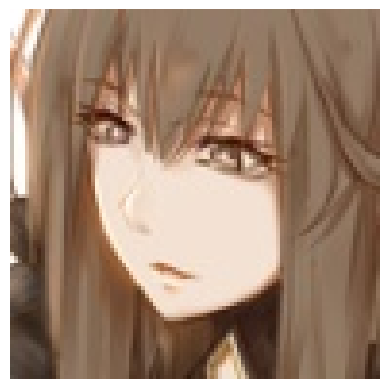

True Label: semiramis_(fate)
This image is likely belongs to:
> semiramis_(fate) : 36.21 % confidence.
> dido_(azur_lane) : 8.05 % confidence.
> oshino_ougi : 4.70 % confidence.
> enterprise_(azur_lane) : 3.80 % confidence.
> makise_kurisu : 3.42 % confidence.


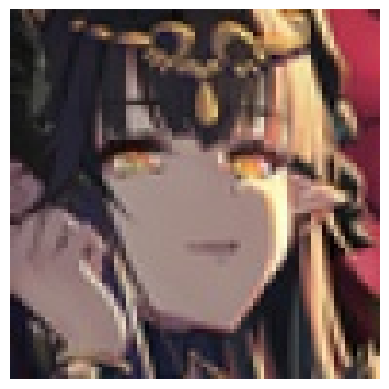

True Label: semiramis_(fate)
This image is likely belongs to:
> semiramis_(fate) : 14.53 % confidence.
> sakura_futaba : 6.24 % confidence.
> abigail_williams_(fate) : 5.90 % confidence.
> rider : 4.67 % confidence.
> giorno_giovanna : 3.36 % confidence.


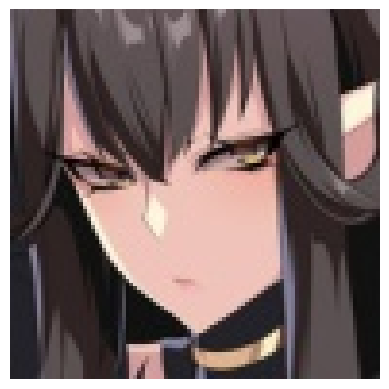

True Label: semiramis_(fate)
This image is likely belongs to:
> semiramis_(fate) : 33.91 % confidence.
> komi_shouko : 5.40 % confidence.
> albedo : 3.28 % confidence.
> shishiro_botan : 2.98 % confidence.
> yukinoshita_yukino : 2.60 % confidence.


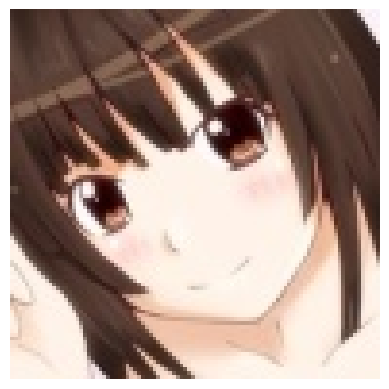

True Label: sengoku_nadeko
This image is likely belongs to:
> suzumiya_haruhi : 7.31 % confidence.
> nekomata_okayu : 5.40 % confidence.
> furukawa_nagisa : 5.13 % confidence.
> shuten_douji_(fate) : 4.90 % confidence.
> nagato_yuki : 4.64 % confidence.


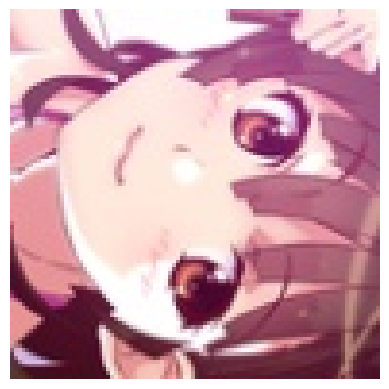

True Label: sengoku_nadeko
This image is likely belongs to:
> formidable_(azur_lane) : 5.80 % confidence.
> cleveland_(azur_lane) : 5.73 % confidence.
> abigail_williams_(fate) : 5.67 % confidence.
> rem_rezero : 5.07 % confidence.
> watson_amelia : 4.60 % confidence.


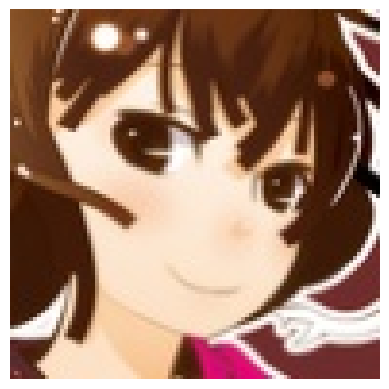

True Label: sengoku_nadeko
This image is likely belongs to:
> furukawa_nagisa : 9.75 % confidence.
> d.va_(overwatch) : 7.43 % confidence.
> satonaka_chie : 6.78 % confidence.
> atago_(azur_lane) : 4.89 % confidence.
> tsushima_yoshiko : 4.72 % confidence.


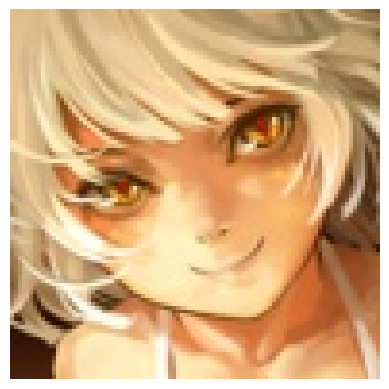

True Label: sengoku_nadeko
This image is likely belongs to:
> giorno_giovanna : 9.64 % confidence.
> gilgamesh : 8.16 % confidence.
> super_sonico : 4.53 % confidence.
> oshino_shinobu : 3.50 % confidence.
> takamaki_anne : 3.31 % confidence.


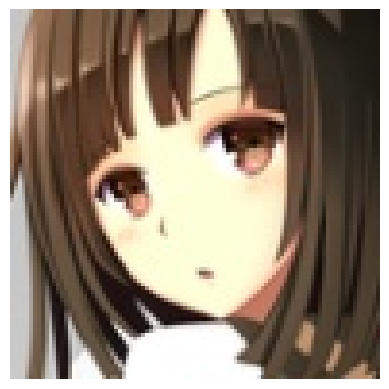

True Label: sengoku_nadeko
This image is likely belongs to:
> shinomiya_kaguya : 26.91 % confidence.
> nakano_azusa : 12.02 % confidence.
> hirasawa_yui : 6.56 % confidence.
> ishtar_(fate_grand_order) : 4.22 % confidence.
> asuna_(sao) : 2.83 % confidence.


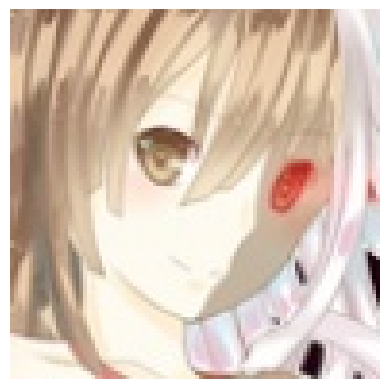

True Label: sengoku_nadeko
This image is likely belongs to:
> shirakami_fubuki : 14.09 % confidence.
> nekomata_okayu : 6.55 % confidence.
> suzumiya_haruhi : 6.55 % confidence.
> shirogane_noel : 4.92 % confidence.
> mash_kyrielight : 4.54 % confidence.


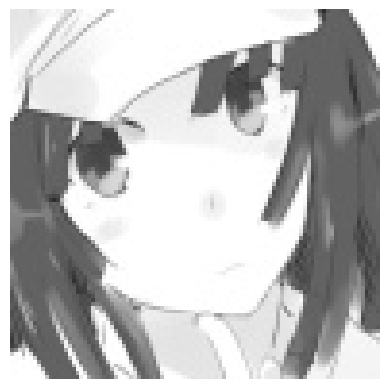

True Label: sengoku_nadeko
This image is likely belongs to:
> nagato_yuki : 8.51 % confidence.
> mei_(pokemon) : 8.22 % confidence.
> toosaka_rin : 5.81 % confidence.
> suzumiya_haruhi : 4.90 % confidence.
> sengoku_nadeko : 4.05 % confidence.


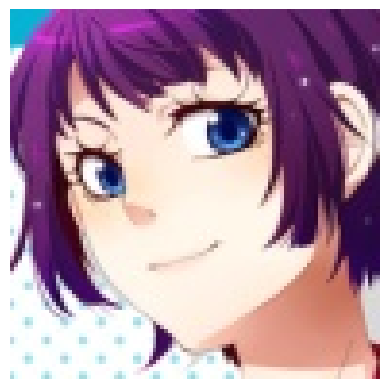

True Label: senjougahara_hitagi
This image is likely belongs to:
> rias_gremory : 7.34 % confidence.
> fubuki_(one-punch_man) : 4.55 % confidence.
> aegis_(persona) : 4.03 % confidence.
> nishikino_maki : 3.93 % confidence.
> nami_(one_piece) : 3.58 % confidence.


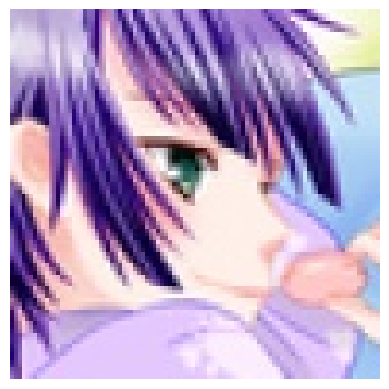

True Label: senjougahara_hitagi
This image is likely belongs to:
> fubuki_(one-punch_man) : 5.71 % confidence.
> ichigo_(darling_in_the_franxx) : 4.22 % confidence.
> ryougi_shiki : 4.02 % confidence.
> senjougahara_hitagi : 3.59 % confidence.
> unicorn_(azur_lane) : 2.94 % confidence.


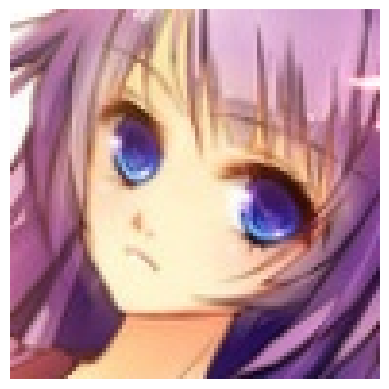

True Label: senjougahara_hitagi
This image is likely belongs to:
> aisaka_taiga : 6.35 % confidence.
> aqua_(konosuba) : 6.09 % confidence.
> senjougahara_hitagi : 5.98 % confidence.
> meltlilith : 5.63 % confidence.
> hirasawa_yui : 5.57 % confidence.


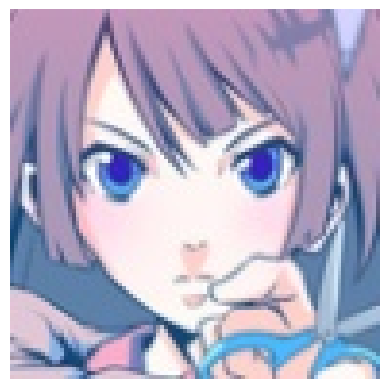

True Label: senjougahara_hitagi
This image is likely belongs to:
> ichigo_(darling_in_the_franxx) : 13.18 % confidence.
> nakano_azusa : 12.59 % confidence.
> senjougahara_hitagi : 9.81 % confidence.
> nagato_yuki : 7.88 % confidence.
> kirito : 5.73 % confidence.


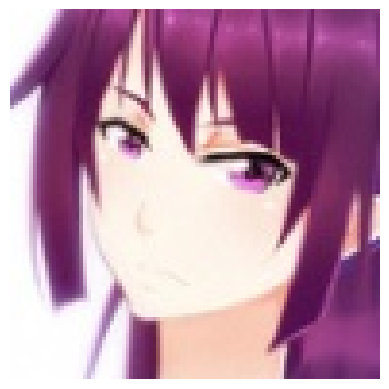

True Label: senjougahara_hitagi
This image is likely belongs to:
> yukinoshita_yukino : 19.19 % confidence.
> nagato_yuki : 17.28 % confidence.
> hanekawa_tsubasa : 6.38 % confidence.
> sakurajima_mai : 4.24 % confidence.
> oshino_ougi : 3.83 % confidence.


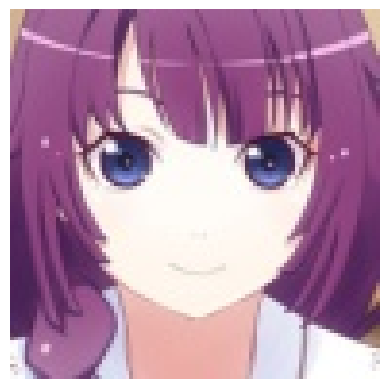

True Label: senjougahara_hitagi
This image is likely belongs to:
> takimoto_hifumi : 10.55 % confidence.
> nakano_itsuki : 7.99 % confidence.
> senjougahara_hitagi : 4.07 % confidence.
> nakano_yotsuba : 3.54 % confidence.
> tokoyami_towa : 3.25 % confidence.


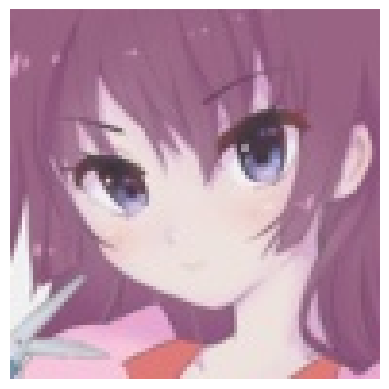

True Label: senjougahara_hitagi
This image is likely belongs to:
> meltlilith : 7.29 % confidence.
> senjougahara_hitagi : 6.30 % confidence.
> nagato_yuki : 4.91 % confidence.
> aisaka_taiga : 4.18 % confidence.
> kaname_madoka : 4.00 % confidence.


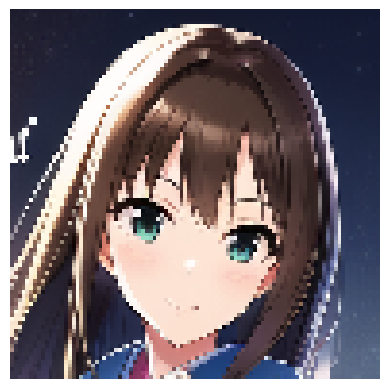

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 98.82 % confidence.
> gawr_gura : 0.22 % confidence.
> shirogane_noel : 0.13 % confidence.
> nekomata_okayu : 0.08 % confidence.
> kiryu_coco : 0.06 % confidence.


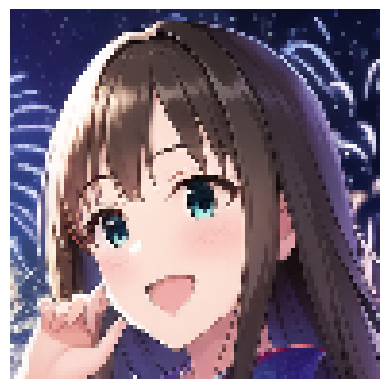

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 93.39 % confidence.
> furukawa_nagisa : 0.66 % confidence.
> suzumiya_haruhi : 0.59 % confidence.
> makise_kurisu : 0.55 % confidence.
> satonaka_chie : 0.37 % confidence.


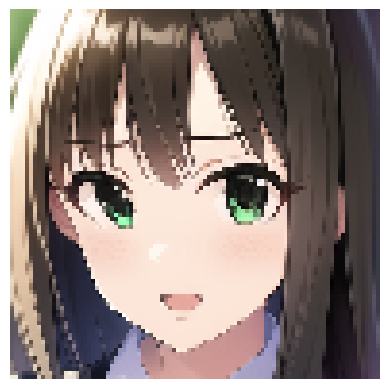

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 65.46 % confidence.
> gawr_gura : 2.90 % confidence.
> suzumiya_haruhi : 1.96 % confidence.
> shirogane_noel : 1.87 % confidence.
> shidare_hotaru : 1.63 % confidence.


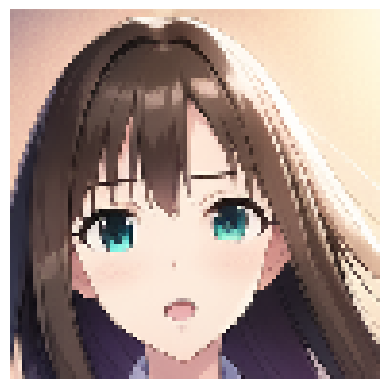

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 97.28 % confidence.
> astolfo_(fate) : 0.19 % confidence.
> makise_kurisu : 0.11 % confidence.
> nagato_yuki : 0.10 % confidence.
> shirogane_noel : 0.09 % confidence.


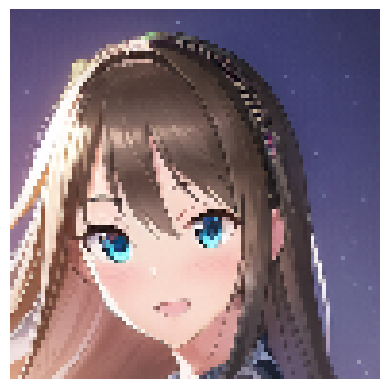

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 94.89 % confidence.
> zero_two_(darling_in_the_franxx) : 0.76 % confidence.
> abigail_williams_(fate) : 0.26 % confidence.
> takarada_rikka : 0.26 % confidence.
> shirakami_fubuki : 0.20 % confidence.


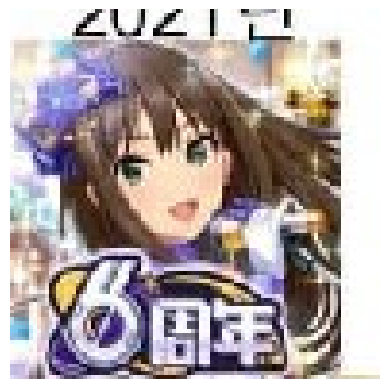

True Label: shibuya_rin
This image is likely belongs to:
> katsuragi_misato : 11.97 % confidence.
> shibuya_rin : 8.19 % confidence.
> ouro_kronii : 4.95 % confidence.
> giorno_giovanna : 3.43 % confidence.
> shirakami_fubuki : 3.03 % confidence.


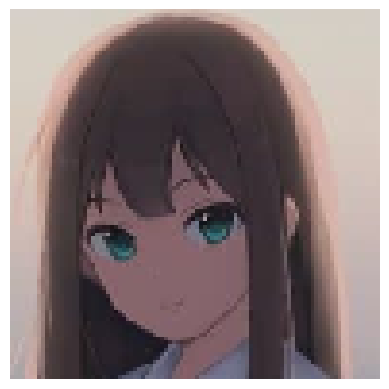

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 90.83 % confidence.
> abigail_williams_(fate) : 2.22 % confidence.
> rider : 1.06 % confidence.
> irisviel_von_einzbern : 0.78 % confidence.
> kiryu_coco : 0.37 % confidence.


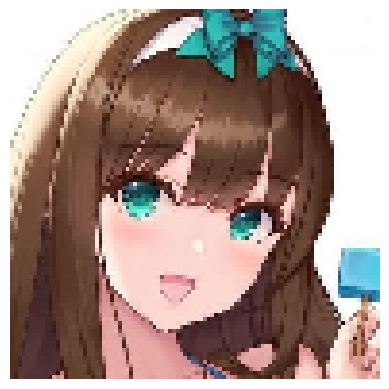

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 67.90 % confidence.
> fujiwara_chika : 5.06 % confidence.
> mori_calliope : 4.79 % confidence.
> kizuna_ai : 2.17 % confidence.
> abigail_williams_(fate) : 1.48 % confidence.


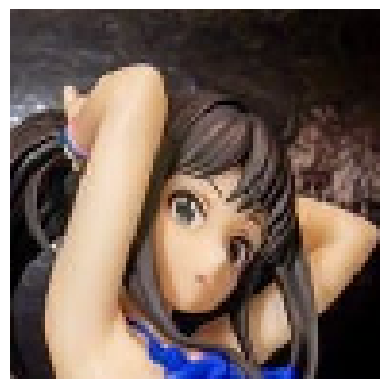

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 11.35 % confidence.
> d.va_(overwatch) : 7.15 % confidence.
> albedo : 7.02 % confidence.
> nico_robin : 5.87 % confidence.
> jonathan_joestar : 5.18 % confidence.


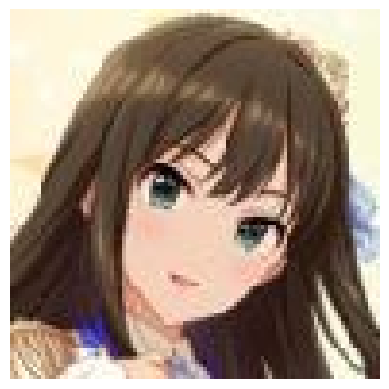

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 81.10 % confidence.
> suzumiya_haruhi : 1.51 % confidence.
> makise_kurisu : 1.31 % confidence.
> yukinoshita_yukino : 0.90 % confidence.
> nagato_yuki : 0.73 % confidence.


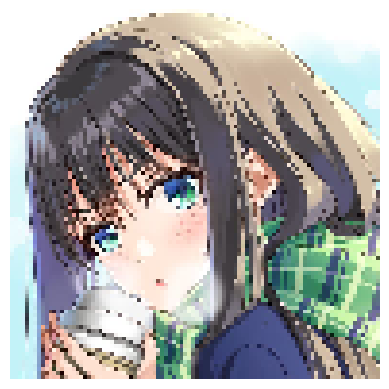

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 71.46 % confidence.
> d.va_(overwatch) : 3.86 % confidence.
> kamado_nezuko : 2.01 % confidence.
> kochou_shinobu : 1.33 % confidence.
> keqing_(genshin_impact) : 1.02 % confidence.


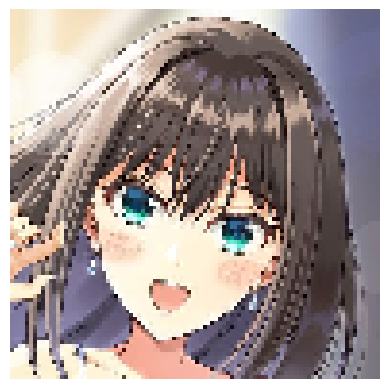

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 97.30 % confidence.
> shirogane_noel : 0.20 % confidence.
> nekomata_okayu : 0.17 % confidence.
> gawr_gura : 0.16 % confidence.
> shirakami_fubuki : 0.15 % confidence.


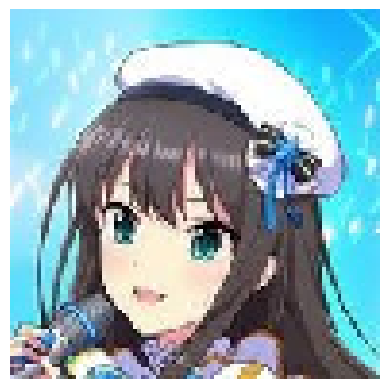

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 97.21 % confidence.
> mei_(pokemon) : 0.28 % confidence.
> mori_calliope : 0.18 % confidence.
> platelet_(hataraku_saibou) : 0.10 % confidence.
> dido_(azur_lane) : 0.09 % confidence.


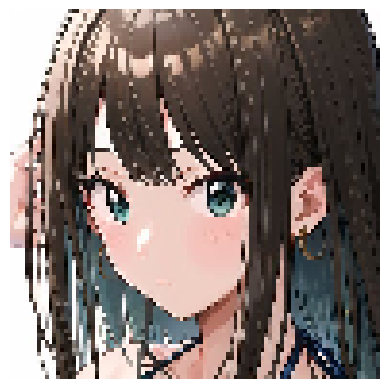

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 77.15 % confidence.
> nakano_nino : 1.74 % confidence.
> nakano_yotsuba : 1.74 % confidence.
> kiryu_coco : 1.64 % confidence.
> nekomata_okayu : 1.51 % confidence.


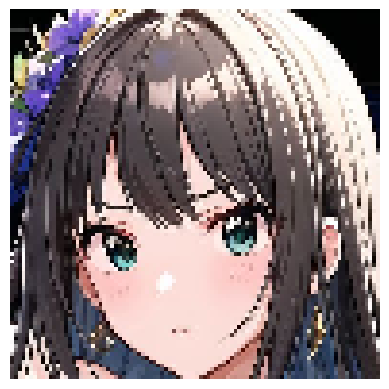

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 93.92 % confidence.
> suzumiya_haruhi : 0.33 % confidence.
> shidare_hotaru : 0.26 % confidence.
> sakurajima_mai : 0.23 % confidence.
> aegis_(persona) : 0.20 % confidence.


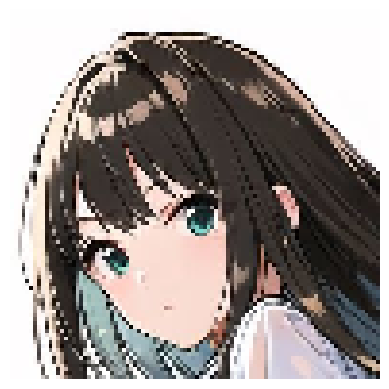

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 93.30 % confidence.
> abigail_williams_(fate) : 0.36 % confidence.
> fujiwara_chika : 0.33 % confidence.
> dido_(azur_lane) : 0.30 % confidence.
> gawr_gura : 0.28 % confidence.


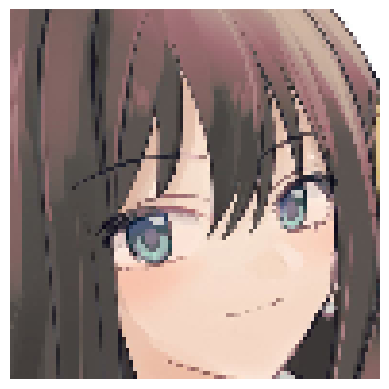

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 29.81 % confidence.
> makise_kurisu : 9.74 % confidence.
> rias_gremory : 8.17 % confidence.
> nami_(one_piece) : 3.93 % confidence.
> miyazono_kawori : 2.81 % confidence.


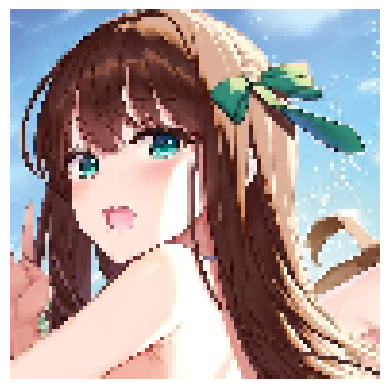

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 91.32 % confidence.
> megumin : 0.72 % confidence.
> suzumiya_haruhi : 0.64 % confidence.
> komi_shouko : 0.49 % confidence.
> nagato_yuki : 0.32 % confidence.


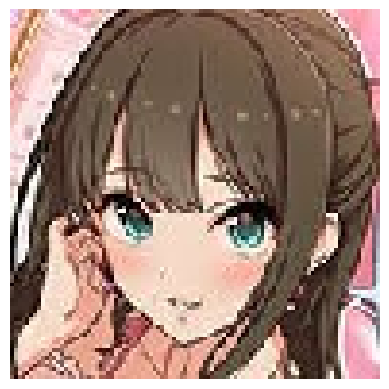

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 93.28 % confidence.
> astolfo_(fate) : 0.42 % confidence.
> keqing_(genshin_impact) : 0.36 % confidence.
> okita_souji_(fate) : 0.35 % confidence.
> anastasia_(idolmaster) : 0.32 % confidence.


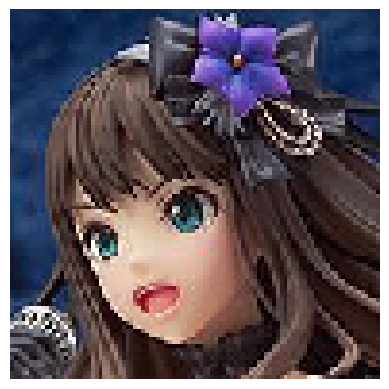

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 13.00 % confidence.
> super_sonico : 5.73 % confidence.
> toujou_nozomi : 3.49 % confidence.
> laffey_(azur_lane) : 3.29 % confidence.
> takamaki_anne : 3.01 % confidence.


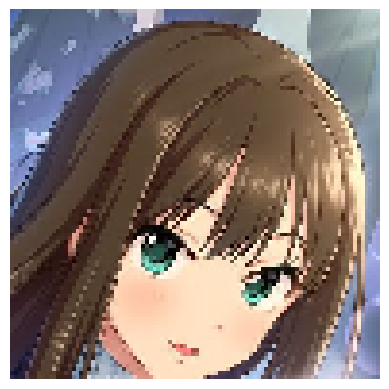

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 99.85 % confidence.
> shishiro_botan : 0.01 % confidence.
> gawr_gura : 0.01 % confidence.
> yukinoshita_yukino : 0.01 % confidence.
> shirakami_fubuki : 0.01 % confidence.


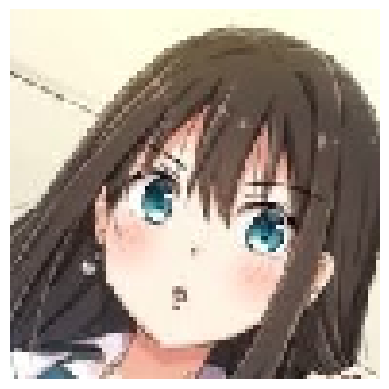

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 90.40 % confidence.
> toosaka_rin : 0.91 % confidence.
> yukinoshita_yukino : 0.82 % confidence.
> chitanda_eru : 0.79 % confidence.
> nakano_azusa : 0.34 % confidence.


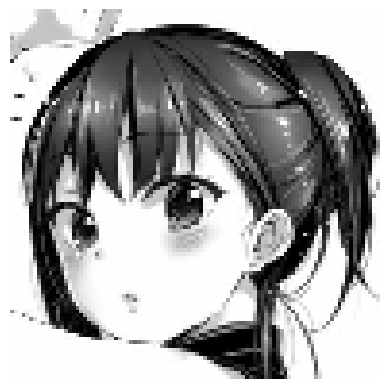

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 55.72 % confidence.
> okita_souji_(fate) : 13.37 % confidence.
> mash_kyrielight : 9.94 % confidence.
> astolfo_(fate) : 4.78 % confidence.
> nagato_yuki : 1.09 % confidence.


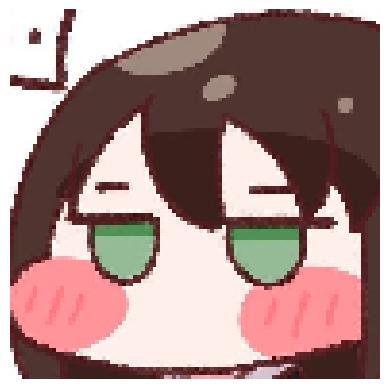

True Label: shibuya_rin
This image is likely belongs to:
> irisviel_von_einzbern : 6.48 % confidence.
> shirakami_fubuki : 6.47 % confidence.
> suzuhara_lulu : 6.42 % confidence.
> paimon_(genshin_impact) : 6.38 % confidence.
> illyasviel_von_einzbern : 4.97 % confidence.


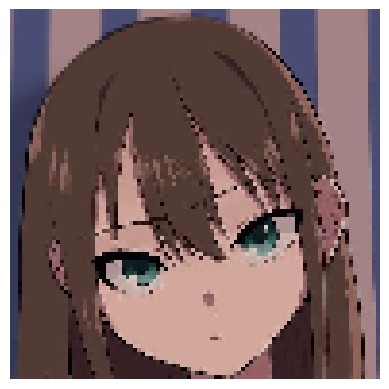

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 95.07 % confidence.
> mori_calliope : 0.54 % confidence.
> taihou_(azur_lane) : 0.24 % confidence.
> zero_two_(darling_in_the_franxx) : 0.22 % confidence.
> raphtalia : 0.21 % confidence.


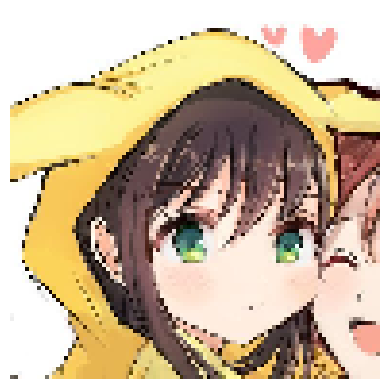

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 10.75 % confidence.
> megumin : 6.17 % confidence.
> sengoku_nadeko : 5.22 % confidence.
> mei_(pokemon) : 4.53 % confidence.
> albedo : 3.68 % confidence.


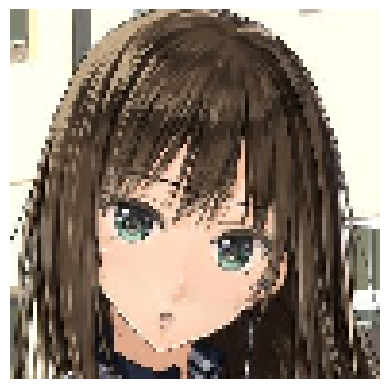

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 98.45 % confidence.
> gawr_gura : 0.21 % confidence.
> aegis_(persona) : 0.12 % confidence.
> watson_amelia : 0.11 % confidence.
> suzumiya_haruhi : 0.07 % confidence.


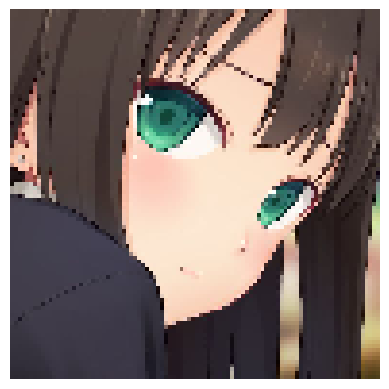

True Label: shibuya_rin
This image is likely belongs to:
> takanashi_rikka : 10.62 % confidence.
> shinomiya_kaguya : 10.27 % confidence.
> utsumi_erise : 6.94 % confidence.
> komi_shouko : 4.24 % confidence.
> shibuya_rin : 3.36 % confidence.


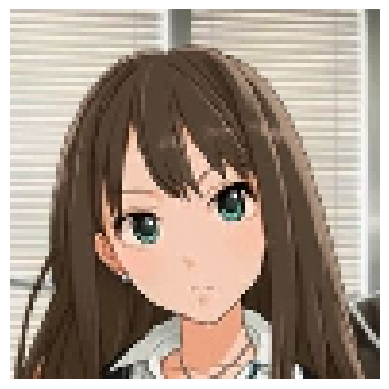

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 87.41 % confidence.
> suzumiya_haruhi : 1.62 % confidence.
> ryougi_shiki : 0.67 % confidence.
> hirasawa_yui : 0.63 % confidence.
> gawr_gura : 0.62 % confidence.


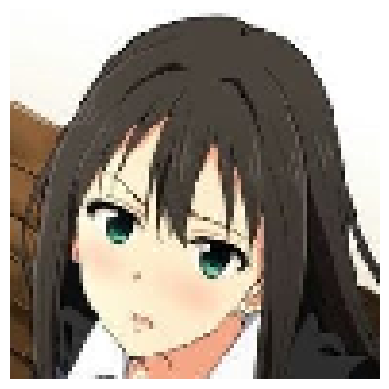

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 86.95 % confidence.
> kirito : 1.61 % confidence.
> suzumiya_haruhi : 1.14 % confidence.
> nakano_azusa : 0.94 % confidence.
> yukinoshita_yukino : 0.88 % confidence.


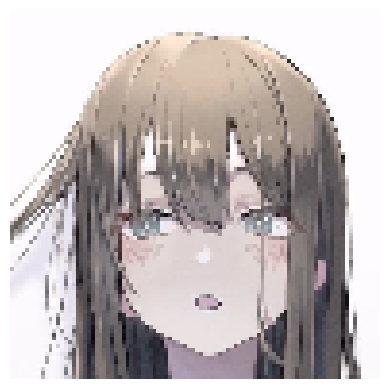

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 95.76 % confidence.
> mori_calliope : 0.27 % confidence.
> makise_kurisu : 0.21 % confidence.
> shishiro_botan : 0.16 % confidence.
> semiramis_(fate) : 0.16 % confidence.


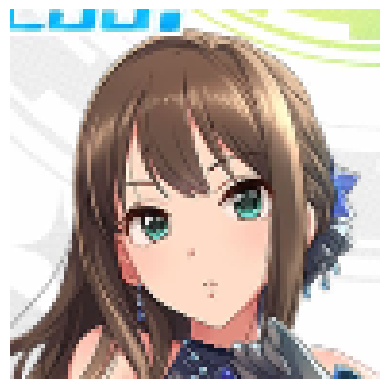

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 79.53 % confidence.
> gawr_gura : 1.56 % confidence.
> aegis_(persona) : 0.90 % confidence.
> tsushima_yoshiko : 0.66 % confidence.
> watson_amelia : 0.59 % confidence.


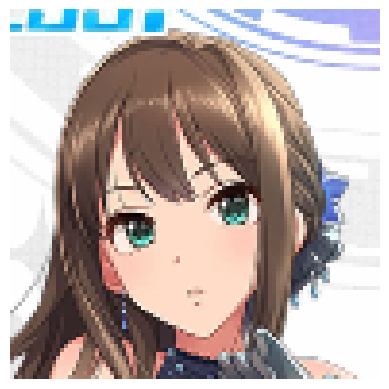

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 80.38 % confidence.
> satonaka_chie : 3.41 % confidence.
> tsushima_yoshiko : 1.03 % confidence.
> gawr_gura : 1.03 % confidence.
> shidare_hotaru : 0.90 % confidence.


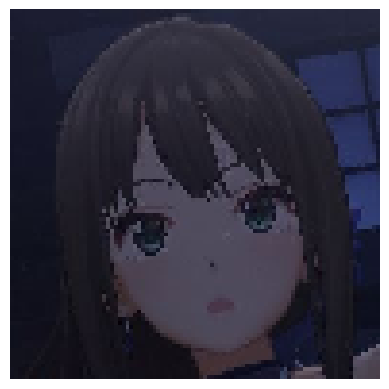

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 88.87 % confidence.
> nekomata_okayu : 0.99 % confidence.
> ouro_kronii : 0.76 % confidence.
> mori_calliope : 0.73 % confidence.
> karin_(blue_archive) : 0.53 % confidence.


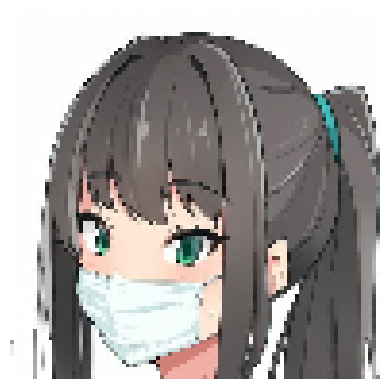

True Label: shibuya_rin
This image is likely belongs to:
> shibuya_rin : 99.82 % confidence.
> gawr_gura : 0.02 % confidence.
> nekomata_okayu : 0.02 % confidence.
> takanashi_rikka : 0.02 % confidence.
> shirogane_noel : 0.01 % confidence.


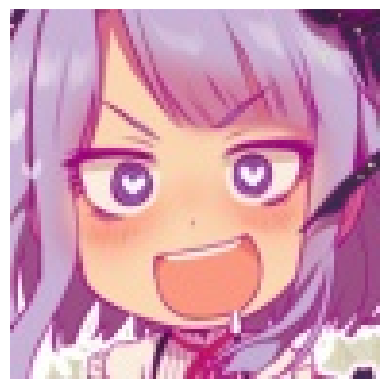

True Label: shidare_hotaru
This image is likely belongs to:
> chloe_von_einzbern : 7.67 % confidence.
> shidare_hotaru : 7.48 % confidence.
> nishikino_maki : 6.98 % confidence.
> sinon : 4.62 % confidence.
> gawr_gura : 4.48 % confidence.


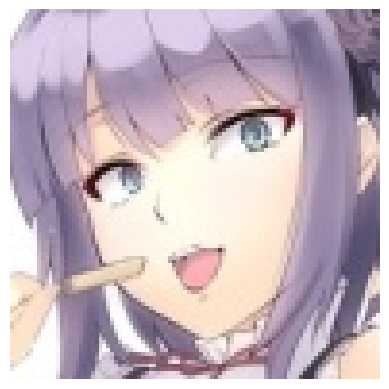

True Label: shidare_hotaru
This image is likely belongs to:
> nekomata_okayu : 10.95 % confidence.
> suzumiya_haruhi : 4.97 % confidence.
> nagato_yuki : 4.60 % confidence.
> ninomae_ina'nis : 4.56 % confidence.
> minato_aqua : 3.77 % confidence.


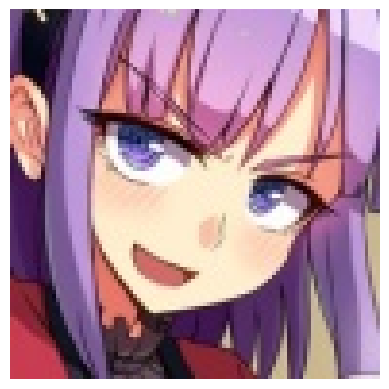

True Label: shidare_hotaru
This image is likely belongs to:
> shidare_hotaru : 8.72 % confidence.
> nakano_yotsuba : 7.16 % confidence.
> kiryu_coco : 5.39 % confidence.
> ninomae_ina'nis : 5.38 % confidence.
> aqua_(konosuba) : 4.84 % confidence.


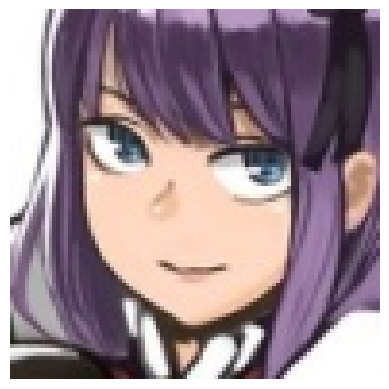

True Label: shidare_hotaru
This image is likely belongs to:
> takarada_rikka : 12.23 % confidence.
> isshiki_iroha : 7.86 % confidence.
> yuigahama_yui : 6.68 % confidence.
> nakano_azusa : 5.32 % confidence.
> ayanami_rei : 3.65 % confidence.


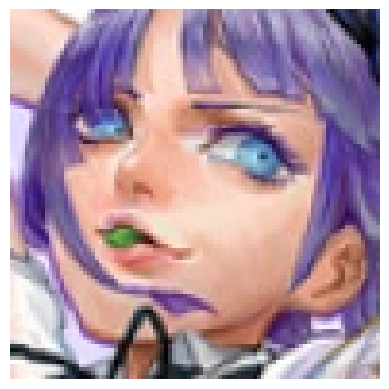

True Label: shidare_hotaru
This image is likely belongs to:
> d.va_(overwatch) : 11.64 % confidence.
> keqing_(genshin_impact) : 9.75 % confidence.
> aegis_(persona) : 6.16 % confidence.
> shidare_hotaru : 5.68 % confidence.
> aqua_(konosuba) : 5.54 % confidence.


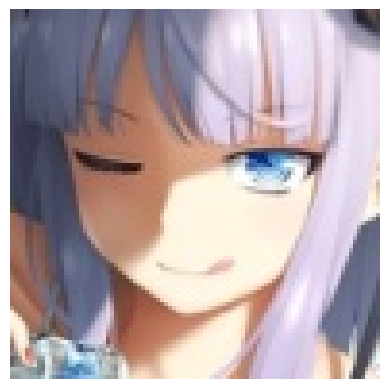

True Label: shidare_hotaru
This image is likely belongs to:
> meltlilith : 13.55 % confidence.
> suzuhara_lulu : 8.93 % confidence.
> unicorn_(azur_lane) : 4.06 % confidence.
> rem_rezero : 3.80 % confidence.
> c.c : 3.40 % confidence.


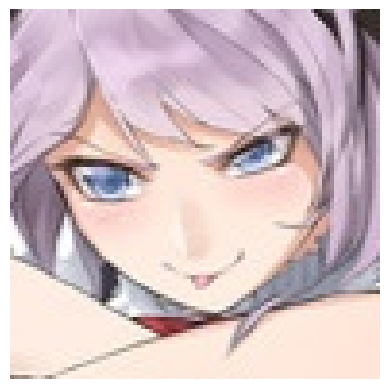

True Label: shidare_hotaru
This image is likely belongs to:
> aqua_(konosuba) : 9.63 % confidence.
> okita_souji_(fate) : 5.32 % confidence.
> shishiro_botan : 3.84 % confidence.
> xenovia_(high_school_dxd) : 3.65 % confidence.
> sinon : 3.49 % confidence.


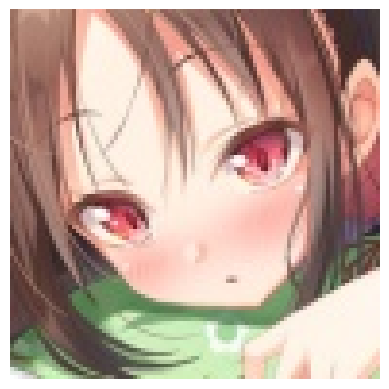

True Label: shinomiya_kaguya
This image is likely belongs to:
> cleveland_(azur_lane) : 9.83 % confidence.
> shirogane_noel : 7.90 % confidence.
> laffey_(azur_lane) : 7.71 % confidence.
> tsushima_yoshiko : 6.81 % confidence.
> ishtar_(fate_grand_order) : 5.26 % confidence.


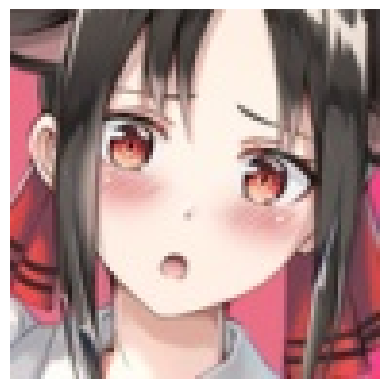

True Label: shinomiya_kaguya
This image is likely belongs to:
> shinomiya_kaguya : 20.60 % confidence.
> yukinoshita_yukino : 18.12 % confidence.
> ishtar_(fate_grand_order) : 5.10 % confidence.
> chitanda_eru : 4.57 % confidence.
> toosaka_rin : 4.10 % confidence.


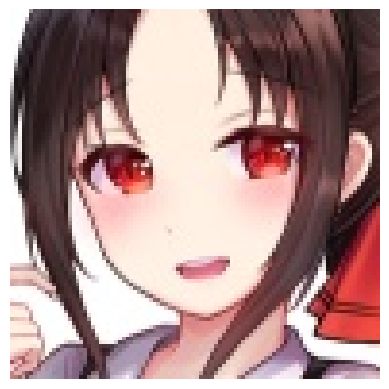

True Label: shinomiya_kaguya
This image is likely belongs to:
> shinomiya_kaguya : 67.38 % confidence.
> ishtar_(fate_grand_order) : 6.93 % confidence.
> taihou_(azur_lane) : 4.25 % confidence.
> megumin : 2.24 % confidence.
> tsushima_yoshiko : 1.84 % confidence.


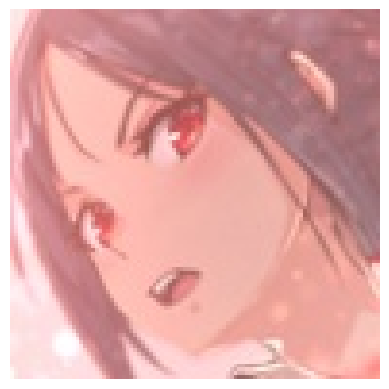

True Label: shinomiya_kaguya
This image is likely belongs to:
> dido_(azur_lane) : 20.70 % confidence.
> shinomiya_kaguya : 8.99 % confidence.
> rider : 4.19 % confidence.
> sengoku_nadeko : 4.11 % confidence.
> abigail_williams_(fate) : 3.72 % confidence.


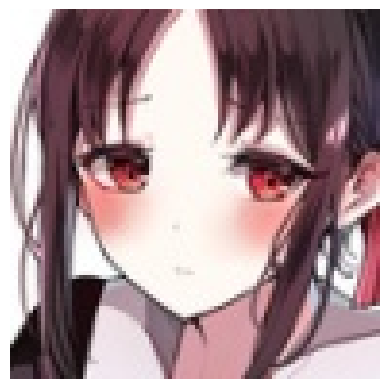

True Label: shinomiya_kaguya
This image is likely belongs to:
> shinomiya_kaguya : 57.90 % confidence.
> yukinoshita_yukino : 8.37 % confidence.
> taihou_(azur_lane) : 5.37 % confidence.
> ishtar_(fate_grand_order) : 4.03 % confidence.
> megumin : 3.73 % confidence.


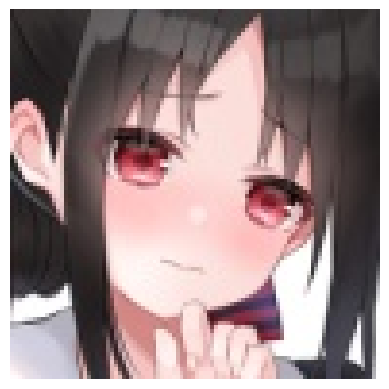

True Label: shinomiya_kaguya
This image is likely belongs to:
> shinomiya_kaguya : 12.54 % confidence.
> ookami_mio : 8.02 % confidence.
> tsushima_yoshiko : 6.68 % confidence.
> megumin : 5.65 % confidence.
> ishtar_(fate_grand_order) : 4.88 % confidence.


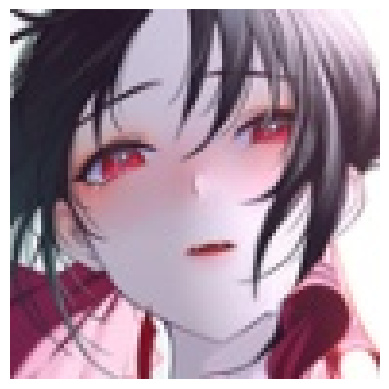

True Label: shinomiya_kaguya
This image is likely belongs to:
> shinomiya_kaguya : 32.37 % confidence.
> taihou_(azur_lane) : 5.77 % confidence.
> fubuki_(one-punch_man) : 4.33 % confidence.
> karin_(blue_archive) : 4.05 % confidence.
> ishtar_(fate_grand_order) : 3.85 % confidence.


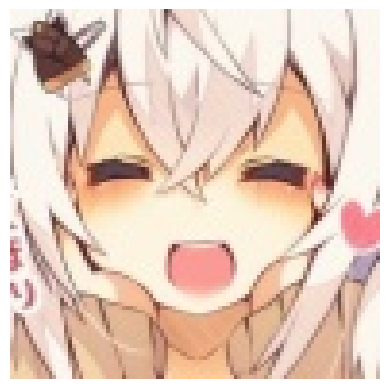

True Label: shirakami_fubuki
This image is likely belongs to:
> shirakami_fubuki : 14.02 % confidence.
> shishiro_botan : 13.78 % confidence.
> kiryu_coco : 6.13 % confidence.
> illyasviel_von_einzbern : 4.71 % confidence.
> super_sonico : 3.64 % confidence.


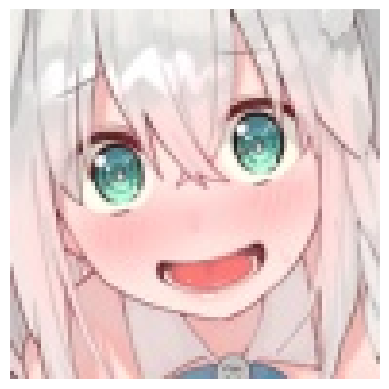

True Label: shirakami_fubuki
This image is likely belongs to:
> shirakami_fubuki : 19.27 % confidence.
> super_sonico : 12.71 % confidence.
> suzuhara_lulu : 9.05 % confidence.
> illyasviel_von_einzbern : 5.69 % confidence.
> fujiwara_chika : 3.50 % confidence.


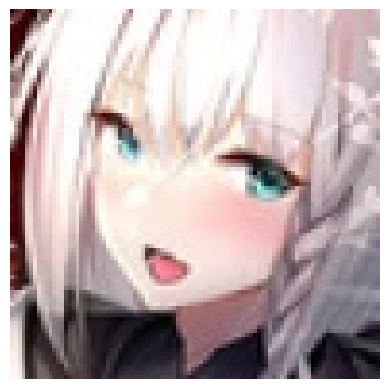

True Label: shirakami_fubuki
This image is likely belongs to:
> shirakami_fubuki : 8.76 % confidence.
> mori_calliope : 7.99 % confidence.
> ishtar_(fate_grand_order) : 5.12 % confidence.
> shishiro_botan : 5.05 % confidence.
> ninomae_ina'nis : 4.15 % confidence.


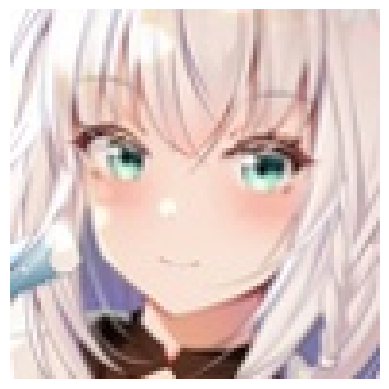

True Label: shirakami_fubuki
This image is likely belongs to:
> yukinoshita_yukino : 10.22 % confidence.
> shirakami_fubuki : 5.63 % confidence.
> chitanda_eru : 5.55 % confidence.
> kizuna_ai : 4.86 % confidence.
> toosaka_rin : 4.19 % confidence.


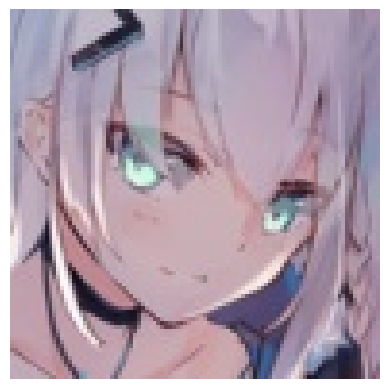

True Label: shirakami_fubuki
This image is likely belongs to:
> shirogane_noel : 16.86 % confidence.
> shirakami_fubuki : 14.77 % confidence.
> anastasia_(idolmaster) : 12.44 % confidence.
> keqing_(genshin_impact) : 8.58 % confidence.
> kizuna_ai : 6.06 % confidence.


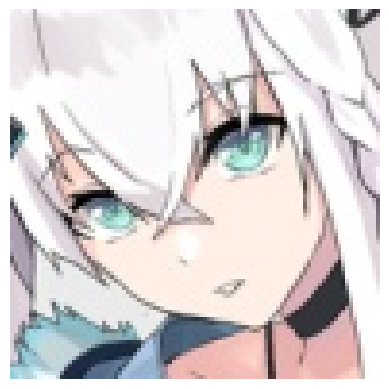

True Label: shirakami_fubuki
This image is likely belongs to:
> shirakami_fubuki : 17.77 % confidence.
> abigail_williams_(fate) : 4.34 % confidence.
> shuten_douji_(fate) : 3.55 % confidence.
> ichigo_(darling_in_the_franxx) : 3.53 % confidence.
> emilia_rezero : 3.30 % confidence.


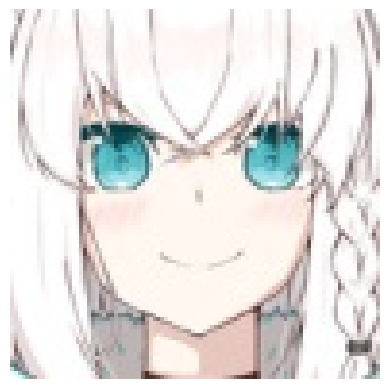

True Label: shirakami_fubuki
This image is likely belongs to:
> zero_two_(darling_in_the_franxx) : 16.44 % confidence.
> kizuna_ai : 8.67 % confidence.
> takimoto_hifumi : 8.38 % confidence.
> yukinoshita_yukino : 6.56 % confidence.
> shirogane_noel : 5.26 % confidence.


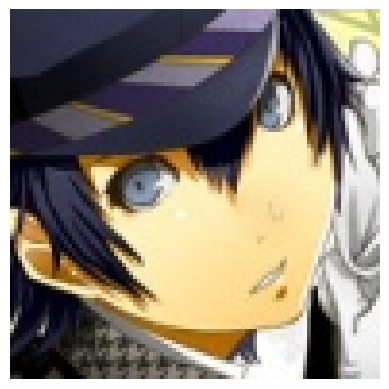

True Label: shirogane_naoto
This image is likely belongs to:
> shirogane_naoto : 12.85 % confidence.
> atago_(azur_lane) : 7.29 % confidence.
> takao_(azur_lane) : 6.26 % confidence.
> enterprise_(azur_lane) : 5.34 % confidence.
> albedo : 4.33 % confidence.


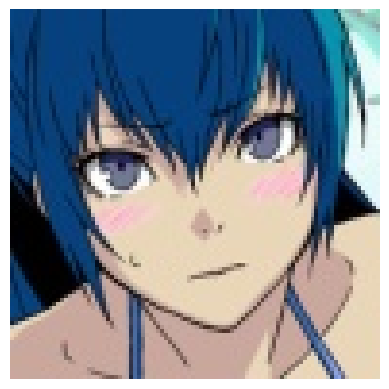

True Label: shirogane_naoto
This image is likely belongs to:
> hanekawa_tsubasa : 18.05 % confidence.
> senjougahara_hitagi : 6.32 % confidence.
> yukinoshita_yukino : 4.82 % confidence.
> tsushima_yoshiko : 4.20 % confidence.
> matou_sakura : 3.46 % confidence.


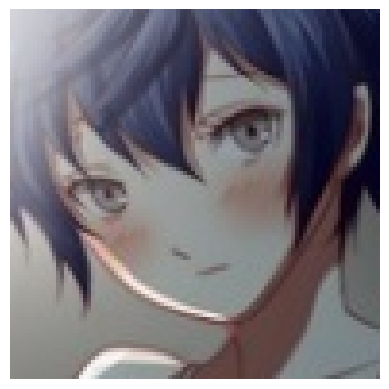

True Label: shirogane_naoto
This image is likely belongs to:
> fubuki_(one-punch_man) : 9.32 % confidence.
> xenovia_(high_school_dxd) : 7.30 % confidence.
> taihou_(azur_lane) : 5.34 % confidence.
> shirogane_naoto : 4.89 % confidence.
> jonathan_joestar : 4.30 % confidence.


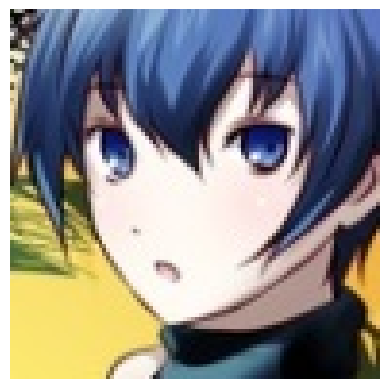

True Label: shirogane_naoto
This image is likely belongs to:
> xenovia_(high_school_dxd) : 10.61 % confidence.
> tsushima_yoshiko : 10.33 % confidence.
> ayanami_rei : 7.47 % confidence.
> shirogane_naoto : 7.27 % confidence.
> kanbaru_suruga : 7.19 % confidence.


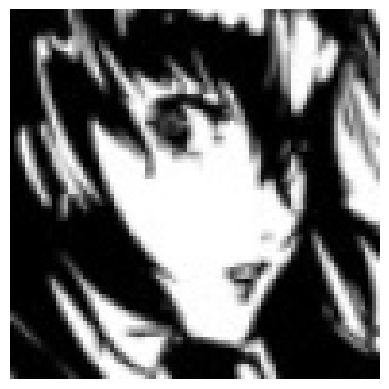

True Label: shirogane_naoto
This image is likely belongs to:
> kaname_madoka : 9.96 % confidence.
> senjougahara_hitagi : 7.84 % confidence.
> shirogane_naoto : 7.16 % confidence.
> suzuhara_lulu : 6.40 % confidence.
> anastasia_(idolmaster) : 5.35 % confidence.


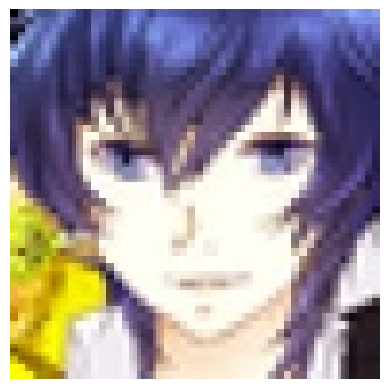

True Label: shirogane_naoto
This image is likely belongs to:
> shirogane_naoto : 69.51 % confidence.
> kanbaru_suruga : 7.38 % confidence.
> jonathan_joestar : 5.68 % confidence.
> katsuragi_misato : 3.00 % confidence.
> takao_(azur_lane) : 2.22 % confidence.


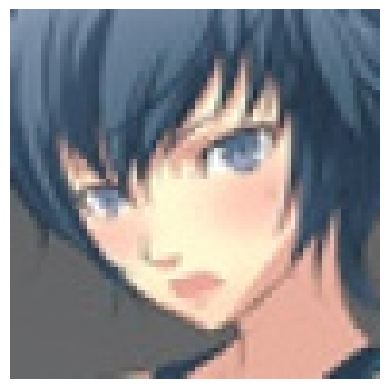

True Label: shirogane_naoto
This image is likely belongs to:
> xenovia_(high_school_dxd) : 16.38 % confidence.
> ayanami_rei : 13.50 % confidence.
> kirito : 8.31 % confidence.
> rem_rezero : 5.22 % confidence.
> meltlilith : 5.17 % confidence.


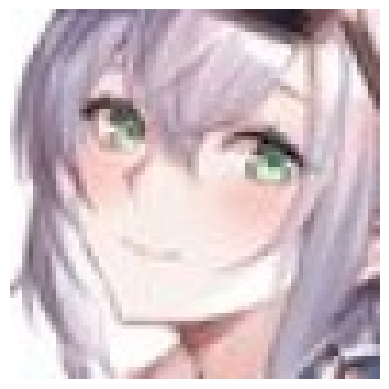

True Label: shirogane_noel
This image is likely belongs to:
> toujou_nozomi : 29.62 % confidence.
> shirogane_noel : 7.75 % confidence.
> keqing_(genshin_impact) : 4.50 % confidence.
> shirakami_fubuki : 3.75 % confidence.
> nekomata_okayu : 3.42 % confidence.


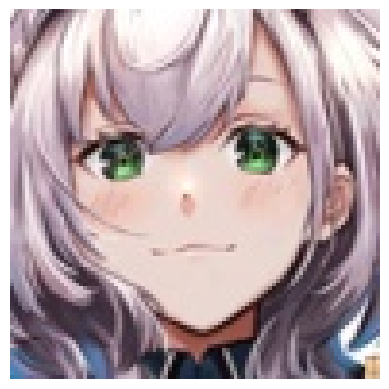

True Label: shirogane_noel
This image is likely belongs to:
> shirogane_noel : 66.40 % confidence.
> tokoyami_towa : 9.29 % confidence.
> nekomata_okayu : 4.29 % confidence.
> shirakami_fubuki : 1.69 % confidence.
> nishikino_maki : 1.48 % confidence.


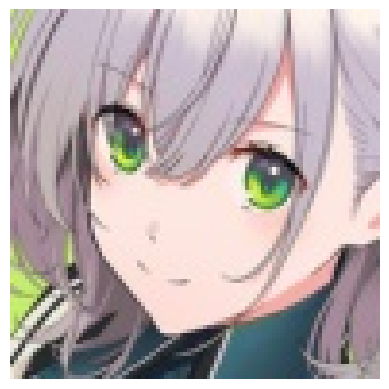

True Label: shirogane_noel
This image is likely belongs to:
> tokoyami_towa : 33.90 % confidence.
> nekomata_okayu : 14.14 % confidence.
> hatsune_miku : 2.36 % confidence.
> isshiki_iroha : 2.18 % confidence.
> minato_aqua : 2.01 % confidence.


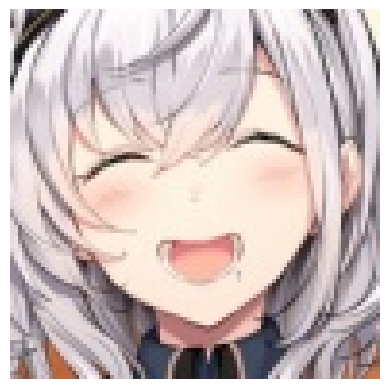

True Label: shirogane_noel
This image is likely belongs to:
> shirogane_noel : 15.93 % confidence.
> shishiro_botan : 6.24 % confidence.
> ishtar_(fate_grand_order) : 4.53 % confidence.
> ninomae_ina'nis : 4.07 % confidence.
> asuna_(sao) : 3.49 % confidence.


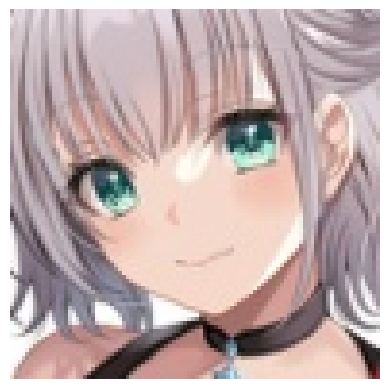

True Label: shirogane_noel
This image is likely belongs to:
> ishtar_(fate_grand_order) : 9.14 % confidence.
> tsushima_yoshiko : 6.35 % confidence.
> toosaka_rin : 5.01 % confidence.
> shinomiya_kaguya : 4.74 % confidence.
> shirogane_noel : 4.00 % confidence.


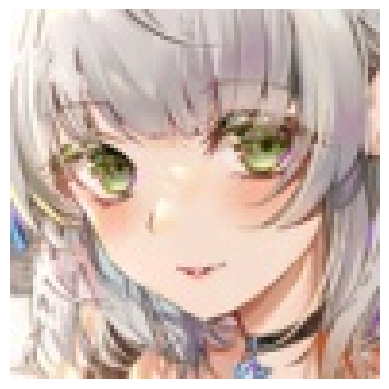

True Label: shirogane_noel
This image is likely belongs to:
> ishtar_(fate_grand_order) : 11.55 % confidence.
> formidable_(azur_lane) : 10.64 % confidence.
> shirogane_noel : 6.94 % confidence.
> laffey_(azur_lane) : 6.25 % confidence.
> emilia_rezero : 5.32 % confidence.


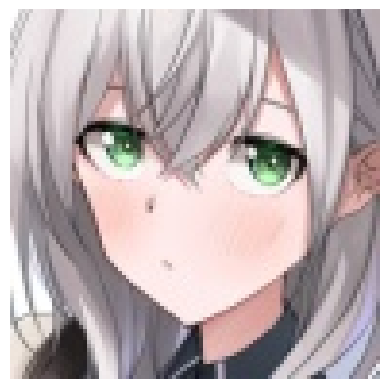

True Label: shirogane_noel
This image is likely belongs to:
> shirogane_noel : 18.76 % confidence.
> shirakami_fubuki : 13.96 % confidence.
> nekomata_okayu : 11.94 % confidence.
> ouro_kronii : 4.89 % confidence.
> utsumi_erise : 3.52 % confidence.


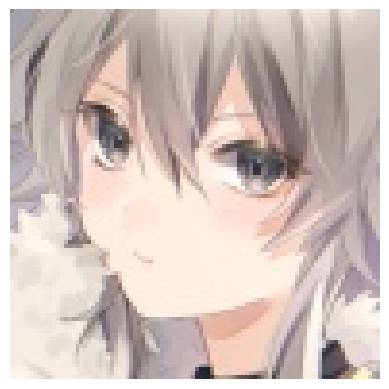

True Label: shishiro_botan
This image is likely belongs to:
> yukinoshita_yukino : 21.39 % confidence.
> anastasia_(idolmaster) : 5.02 % confidence.
> utsumi_erise : 4.79 % confidence.
> sakurajima_mai : 4.51 % confidence.
> hayasaka_ai : 4.48 % confidence.


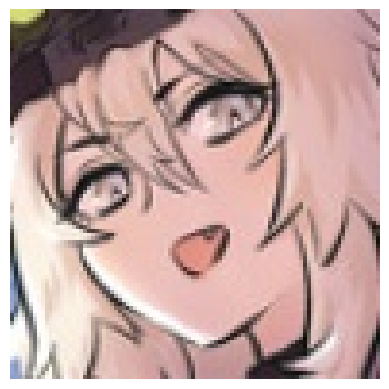

True Label: shishiro_botan
This image is likely belongs to:
> sinon : 12.44 % confidence.
> lancer : 6.86 % confidence.
> kanbaru_suruga : 6.48 % confidence.
> jonathan_joestar : 6.06 % confidence.
> hanekawa_tsubasa : 5.55 % confidence.


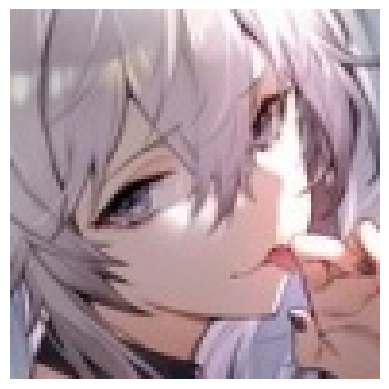

True Label: shishiro_botan
This image is likely belongs to:
> sinon : 7.28 % confidence.
> usada_pekora : 4.45 % confidence.
> suzuhara_lulu : 3.78 % confidence.
> st_ar-15_(girls_frontline) : 3.65 % confidence.
> karna_(fate) : 2.90 % confidence.


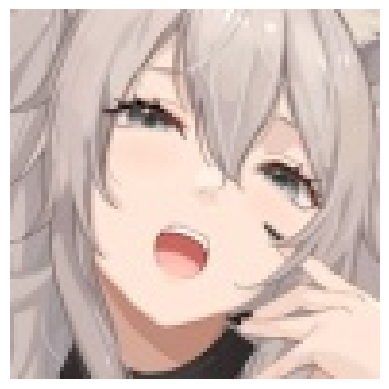

True Label: shishiro_botan
This image is likely belongs to:
> shishiro_botan : 22.59 % confidence.
> paimon_(genshin_impact) : 14.66 % confidence.
> cleveland_(azur_lane) : 10.30 % confidence.
> raphtalia : 8.60 % confidence.
> shirakami_fubuki : 4.50 % confidence.


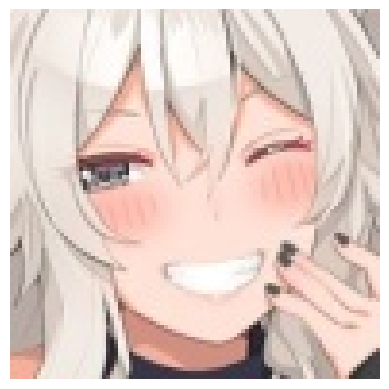

True Label: shishiro_botan
This image is likely belongs to:
> shirakami_fubuki : 19.85 % confidence.
> takanashi_rikka : 9.16 % confidence.
> shishiro_botan : 8.36 % confidence.
> shirogane_noel : 4.32 % confidence.
> dido_(azur_lane) : 2.15 % confidence.


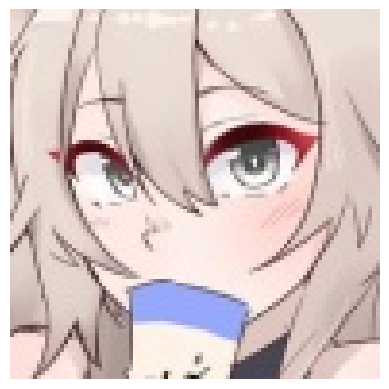

True Label: shishiro_botan
This image is likely belongs to:
> anastasia_(idolmaster) : 22.03 % confidence.
> nagato_yuki : 13.49 % confidence.
> yukinoshita_yukino : 11.26 % confidence.
> sakurajima_mai : 5.29 % confidence.
> kirito : 3.61 % confidence.


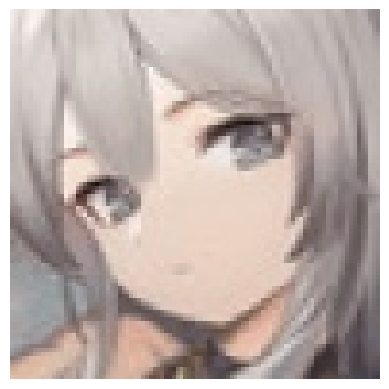

True Label: shishiro_botan
This image is likely belongs to:
> nekomata_okayu : 5.71 % confidence.
> nishikino_maki : 4.28 % confidence.
> laffey_(azur_lane) : 4.25 % confidence.
> ryougi_shiki : 4.15 % confidence.
> karin_(blue_archive) : 3.27 % confidence.


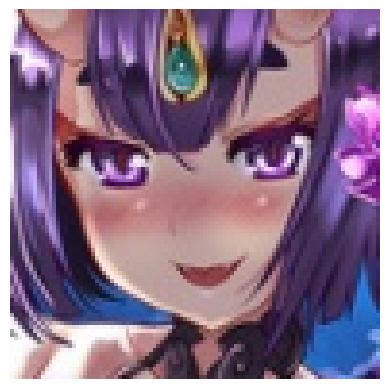

True Label: shuten_douji_(fate)
This image is likely belongs to:
> shuten_douji_(fate) : 18.09 % confidence.
> rem_rezero : 7.87 % confidence.
> shirogane_noel : 6.85 % confidence.
> tokoyami_towa : 3.71 % confidence.
> mei_(pokemon) : 3.34 % confidence.


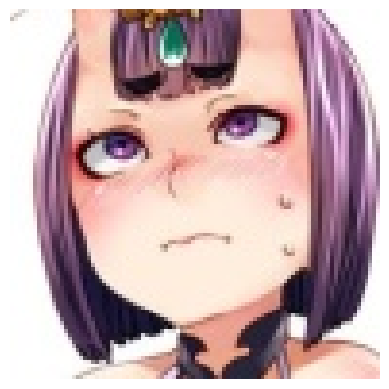

True Label: shuten_douji_(fate)
This image is likely belongs to:
> shuten_douji_(fate) : 25.60 % confidence.
> gawr_gura : 8.06 % confidence.
> shibuya_rin : 7.35 % confidence.
> shidare_hotaru : 3.77 % confidence.
> ninomae_ina'nis : 2.94 % confidence.


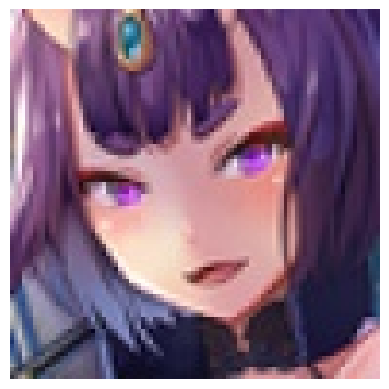

True Label: shuten_douji_(fate)
This image is likely belongs to:
> ookami_mio : 6.95 % confidence.
> taihou_(azur_lane) : 6.88 % confidence.
> toosaka_rin : 6.34 % confidence.
> ishtar_(fate_grand_order) : 5.55 % confidence.
> tsushima_yoshiko : 2.51 % confidence.


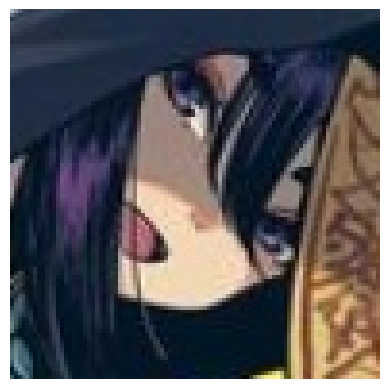

True Label: shuten_douji_(fate)
This image is likely belongs to:
> albedo : 10.58 % confidence.
> semiramis_(fate) : 8.15 % confidence.
> shuten_douji_(fate) : 8.15 % confidence.
> waver_velvet : 5.65 % confidence.
> komi_shouko : 4.50 % confidence.


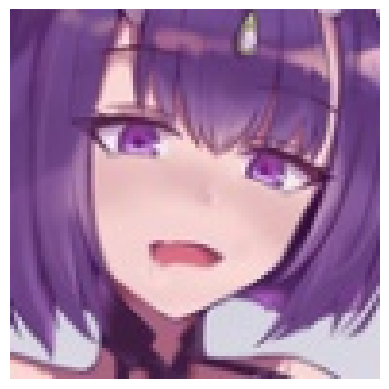

True Label: shuten_douji_(fate)
This image is likely belongs to:
> shuten_douji_(fate) : 21.84 % confidence.
> ram_rezero : 8.79 % confidence.
> nakano_yotsuba : 4.06 % confidence.
> nekomata_okayu : 4.03 % confidence.
> rem_rezero : 3.97 % confidence.


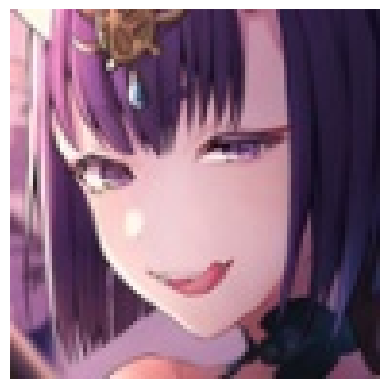

True Label: shuten_douji_(fate)
This image is likely belongs to:
> ishtar_(fate_grand_order) : 26.25 % confidence.
> semiramis_(fate) : 7.76 % confidence.
> shinomiya_kaguya : 5.10 % confidence.
> shuten_douji_(fate) : 4.87 % confidence.
> tsushima_yoshiko : 3.83 % confidence.


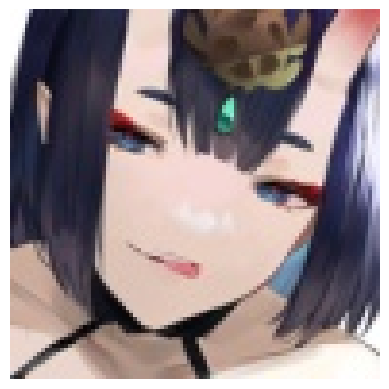

True Label: shuten_douji_(fate)
This image is likely belongs to:
> shuten_douji_(fate) : 79.85 % confidence.
> fubuki_(one-punch_man) : 1.79 % confidence.
> waver_velvet : 1.44 % confidence.
> takanashi_rikka : 1.34 % confidence.
> shinomiya_kaguya : 1.32 % confidence.


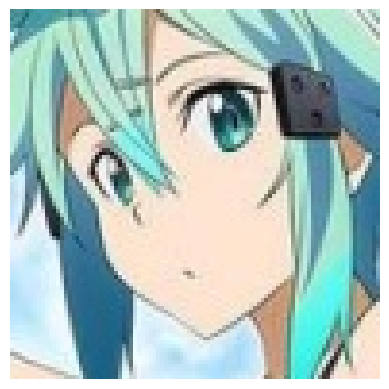

True Label: sinon
This image is likely belongs to:
> sinon : 9.88 % confidence.
> senjougahara_hitagi : 6.72 % confidence.
> nishikino_maki : 5.13 % confidence.
> fujibayashi_kyou : 4.80 % confidence.
> suzumiya_haruhi : 4.62 % confidence.


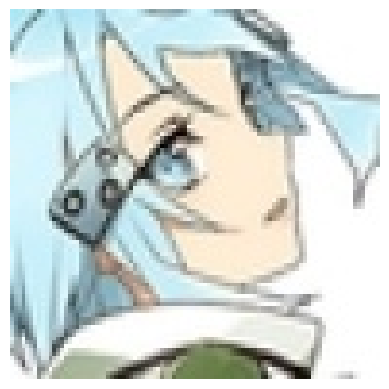

True Label: sinon
This image is likely belongs to:
> sinon : 17.78 % confidence.
> lancer : 11.81 % confidence.
> aegis_(persona) : 7.25 % confidence.
> giorno_giovanna : 4.29 % confidence.
> ichigo_(darling_in_the_franxx) : 4.04 % confidence.


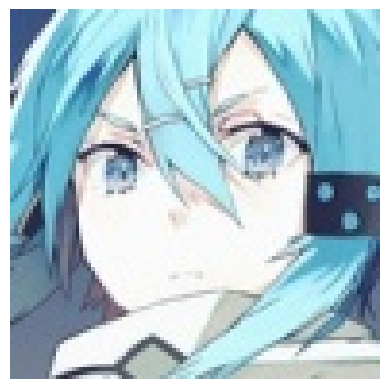

True Label: sinon
This image is likely belongs to:
> sinon : 17.36 % confidence.
> ichigo_(darling_in_the_franxx) : 7.76 % confidence.
> xenovia_(high_school_dxd) : 5.97 % confidence.
> hatsune_miku : 4.32 % confidence.
> hanekawa_tsubasa : 4.06 % confidence.


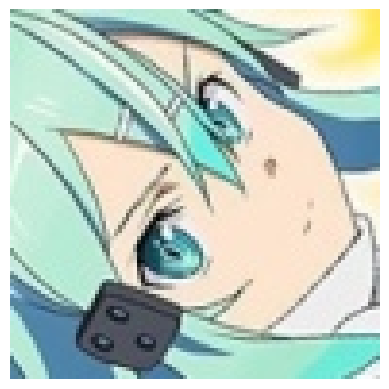

True Label: sinon
This image is likely belongs to:
> sinon : 22.09 % confidence.
> hatsune_miku : 6.88 % confidence.
> oshino_shinobu : 3.39 % confidence.
> paimon_(genshin_impact) : 3.08 % confidence.
> ichigo_(darling_in_the_franxx) : 2.61 % confidence.


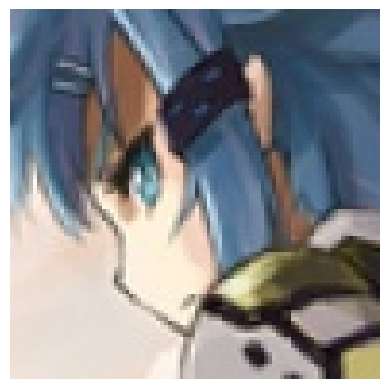

True Label: sinon
This image is likely belongs to:
> albedo : 9.98 % confidence.
> ichigo_(darling_in_the_franxx) : 6.60 % confidence.
> kirito : 6.12 % confidence.
> sinon : 3.51 % confidence.
> st_ar-15_(girls_frontline) : 3.46 % confidence.


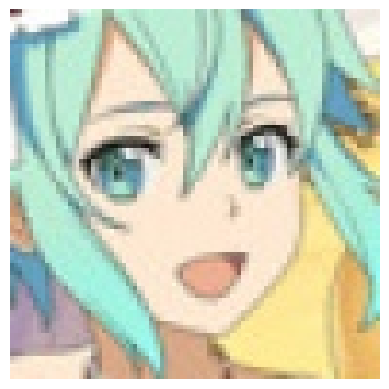

True Label: sinon
This image is likely belongs to:
> sinon : 20.98 % confidence.
> aqua_(konosuba) : 16.53 % confidence.
> astolfo_(fate) : 8.48 % confidence.
> hatsune_miku : 5.34 % confidence.
> nami_(one_piece) : 2.96 % confidence.


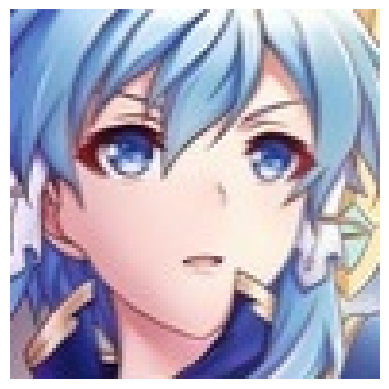

True Label: sinon
This image is likely belongs to:
> usada_pekora : 9.82 % confidence.
> xenovia_(high_school_dxd) : 6.11 % confidence.
> nishikino_maki : 4.20 % confidence.
> aqua_(konosuba) : 4.20 % confidence.
> hatsune_miku : 3.61 % confidence.


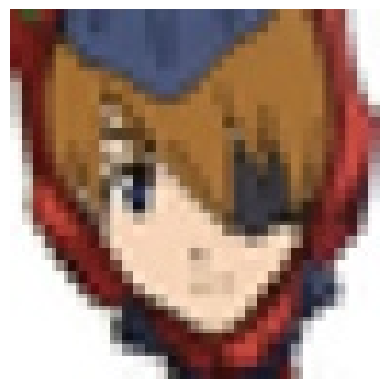

True Label: souryuu_asuka_langley
This image is likely belongs to:
> kirito : 11.21 % confidence.
> nagato_yuki : 9.05 % confidence.
> nakano_azusa : 8.27 % confidence.
> hatsune_miku : 6.50 % confidence.
> satonaka_chie : 5.87 % confidence.


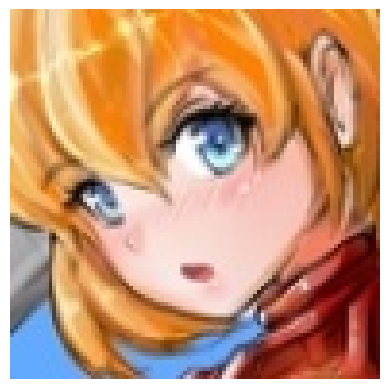

True Label: souryuu_asuka_langley
This image is likely belongs to:
> nishikino_maki : 8.78 % confidence.
> miyazono_kawori : 8.24 % confidence.
> isshiki_iroha : 7.00 % confidence.
> nakano_itsuki : 5.91 % confidence.
> raphtalia : 5.86 % confidence.


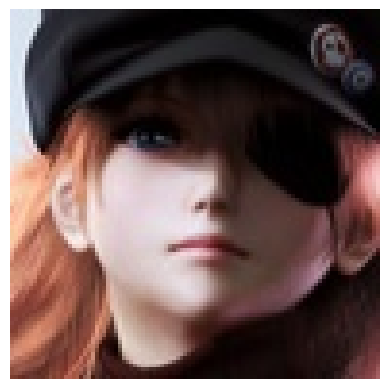

True Label: souryuu_asuka_langley
This image is likely belongs to:
> d.va_(overwatch) : 57.10 % confidence.
> jonathan_joestar : 10.34 % confidence.
> takamaki_anne : 4.81 % confidence.
> sengoku_nadeko : 3.42 % confidence.
> giorno_giovanna : 3.41 % confidence.


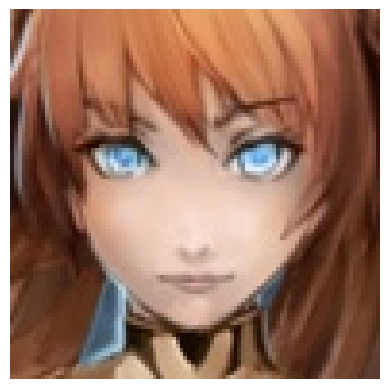

True Label: souryuu_asuka_langley
This image is likely belongs to:
> yuigahama_yui : 26.21 % confidence.
> nami_(one_piece) : 9.65 % confidence.
> isshiki_iroha : 6.82 % confidence.
> nakano_nino : 6.16 % confidence.
> nakano_itsuki : 6.14 % confidence.


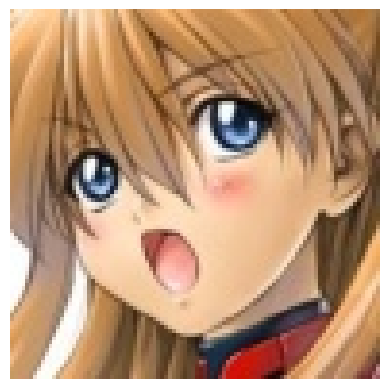

True Label: souryuu_asuka_langley
This image is likely belongs to:
> takamaki_anne : 9.42 % confidence.
> misaka_mikoto : 6.09 % confidence.
> asia_argento : 5.68 % confidence.
> aegis_(persona) : 4.54 % confidence.
> miyazono_kawori : 4.25 % confidence.


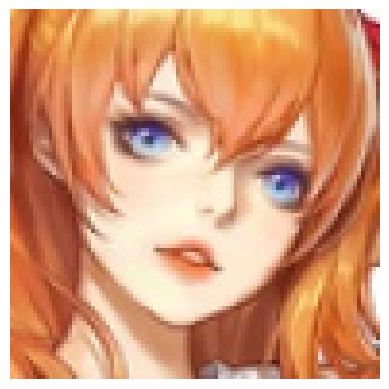

True Label: souryuu_asuka_langley
This image is likely belongs to:
> miyazono_kawori : 18.80 % confidence.
> nami_(one_piece) : 11.65 % confidence.
> kiryu_coco : 11.28 % confidence.
> aegis_(persona) : 7.62 % confidence.
> nakano_itsuki : 6.03 % confidence.


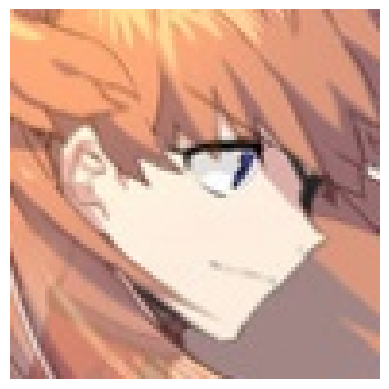

True Label: souryuu_asuka_langley
This image is likely belongs to:
> atago_(azur_lane) : 13.07 % confidence.
> ouro_kronii : 9.37 % confidence.
> komi_shouko : 7.83 % confidence.
> ryougi_shiki : 4.84 % confidence.
> takanashi_rikka : 3.10 % confidence.


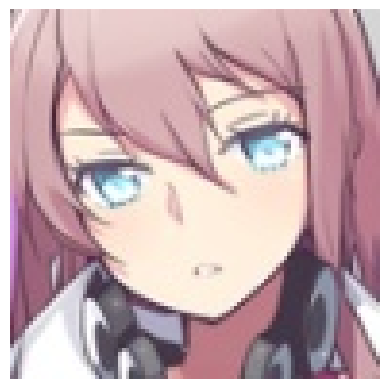

True Label: st_ar-15_(girls_frontline)
This image is likely belongs to:
> fujibayashi_kyou : 8.16 % confidence.
> nishikino_maki : 5.19 % confidence.
> senjougahara_hitagi : 3.72 % confidence.
> rias_gremory : 3.50 % confidence.
> suzumiya_haruhi : 2.96 % confidence.


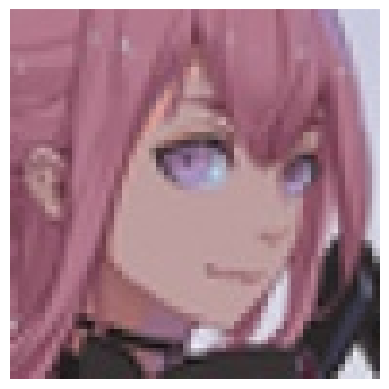

True Label: st_ar-15_(girls_frontline)
This image is likely belongs to:
> abigail_williams_(fate) : 15.44 % confidence.
> mori_calliope : 13.77 % confidence.
> kiryu_coco : 8.49 % confidence.
> nakano_miku : 6.53 % confidence.
> bremerton_(azur_lane) : 5.33 % confidence.


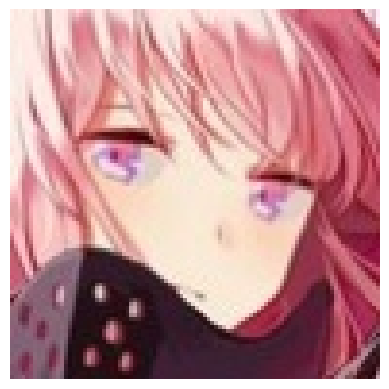

True Label: st_ar-15_(girls_frontline)
This image is likely belongs to:
> st_ar-15_(girls_frontline) : 24.89 % confidence.
> mori_calliope : 8.67 % confidence.
> shidare_hotaru : 4.47 % confidence.
> gilgamesh : 4.26 % confidence.
> semiramis_(fate) : 4.23 % confidence.


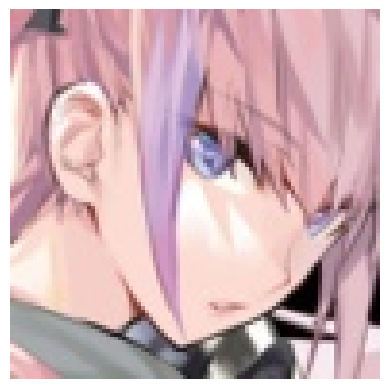

True Label: st_ar-15_(girls_frontline)
This image is likely belongs to:
> nakano_miku : 11.88 % confidence.
> st_ar-15_(girls_frontline) : 10.11 % confidence.
> hayasaka_ai : 5.80 % confidence.
> unicorn_(azur_lane) : 4.37 % confidence.
> rem_rezero : 3.63 % confidence.


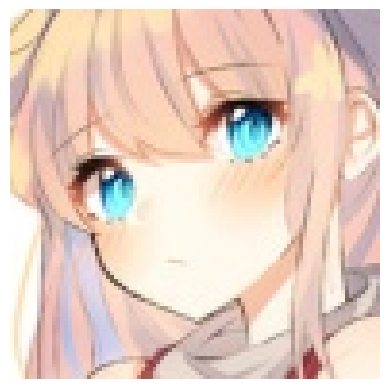

True Label: st_ar-15_(girls_frontline)
This image is likely belongs to:
> suzuhara_lulu : 19.40 % confidence.
> nakano_itsuki : 14.51 % confidence.
> hayasaka_ai : 9.48 % confidence.
> kizuna_ai : 9.33 % confidence.
> nakano_miku : 6.31 % confidence.


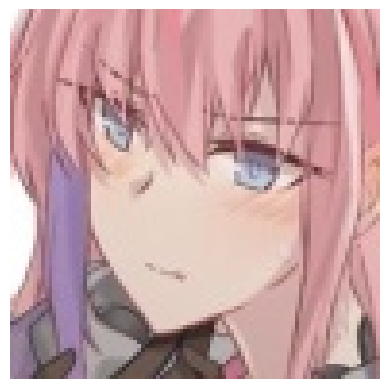

True Label: st_ar-15_(girls_frontline)
This image is likely belongs to:
> st_ar-15_(girls_frontline) : 39.63 % confidence.
> souryuu_asuka_langley : 5.48 % confidence.
> nakano_nino : 4.62 % confidence.
> nakano_itsuki : 3.01 % confidence.
> ouro_kronii : 2.90 % confidence.


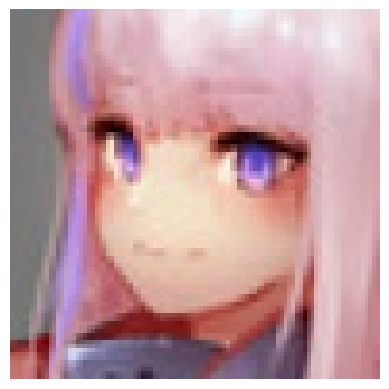

True Label: st_ar-15_(girls_frontline)
This image is likely belongs to:
> mori_calliope : 7.81 % confidence.
> emilia_rezero : 5.78 % confidence.
> illyasviel_von_einzbern : 5.72 % confidence.
> oshino_shinobu : 4.19 % confidence.
> irisviel_von_einzbern : 3.37 % confidence.


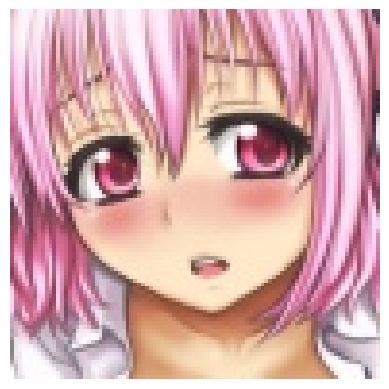

True Label: super_sonico
This image is likely belongs to:
> super_sonico : 9.72 % confidence.
> arcueid_brunestud : 5.63 % confidence.
> laffey_(azur_lane) : 5.40 % confidence.
> watson_amelia : 3.92 % confidence.
> hayasaka_ai : 3.18 % confidence.


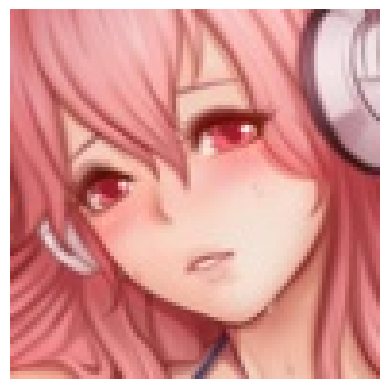

True Label: super_sonico
This image is likely belongs to:
> laffey_(azur_lane) : 7.98 % confidence.
> okita_souji_(fate) : 6.02 % confidence.
> sakurauchi_riko : 5.53 % confidence.
> shidare_hotaru : 4.21 % confidence.
> nami_(one_piece) : 3.90 % confidence.


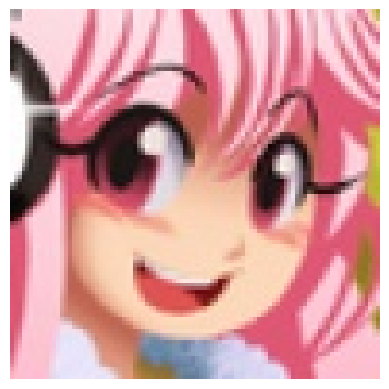

True Label: super_sonico
This image is likely belongs to:
> fujibayashi_kyou : 18.09 % confidence.
> hatsune_miku : 6.98 % confidence.
> katsuragi_misato : 6.48 % confidence.
> sinon : 5.18 % confidence.
> aqua_(konosuba) : 4.25 % confidence.


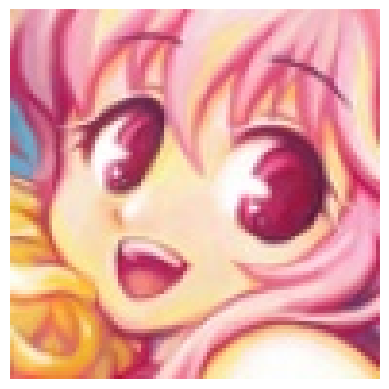

True Label: super_sonico
This image is likely belongs to:
> super_sonico : 22.36 % confidence.
> chloe_von_einzbern : 5.12 % confidence.
> giorno_giovanna : 4.78 % confidence.
> zero_two_(darling_in_the_franxx) : 4.77 % confidence.
> takamaki_anne : 3.86 % confidence.


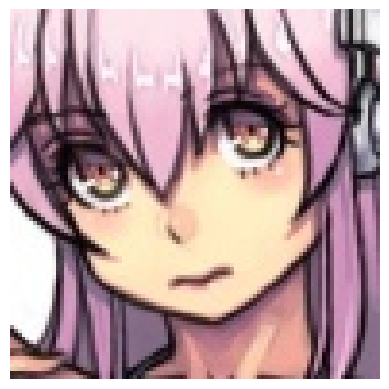

True Label: super_sonico
This image is likely belongs to:
> c.c : 8.32 % confidence.
> lancer : 7.55 % confidence.
> sinon : 5.65 % confidence.
> ayanami_rei : 4.91 % confidence.
> shirogane_naoto : 4.85 % confidence.


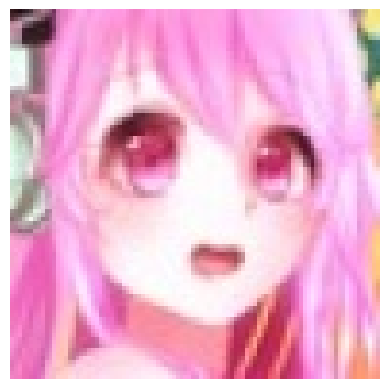

True Label: super_sonico
This image is likely belongs to:
> super_sonico : 44.23 % confidence.
> illyasviel_von_einzbern : 8.17 % confidence.
> laffey_(azur_lane) : 3.08 % confidence.
> platelet_(hataraku_saibou) : 2.41 % confidence.
> miyazono_kawori : 2.38 % confidence.


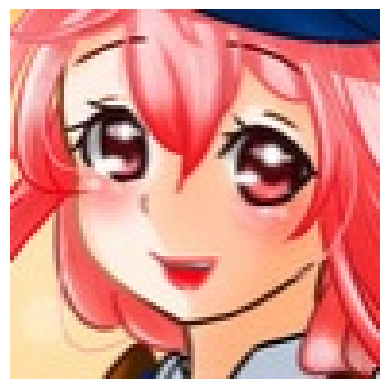

True Label: super_sonico
This image is likely belongs to:
> super_sonico : 5.23 % confidence.
> jonathan_joestar : 5.10 % confidence.
> takamaki_anne : 4.09 % confidence.
> bremerton_(azur_lane) : 3.72 % confidence.
> nico_robin : 3.58 % confidence.


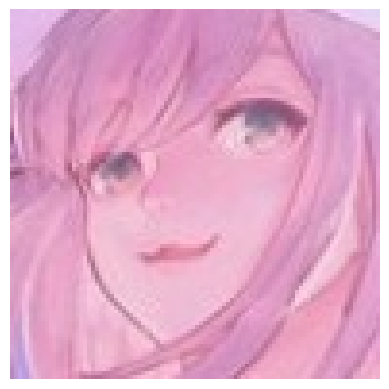

True Label: suzuhara_lulu
This image is likely belongs to:
> mash_kyrielight : 17.58 % confidence.
> mori_calliope : 6.97 % confidence.
> suzuhara_lulu : 6.46 % confidence.
> zero_two_(darling_in_the_franxx) : 5.92 % confidence.
> kaname_madoka : 4.33 % confidence.


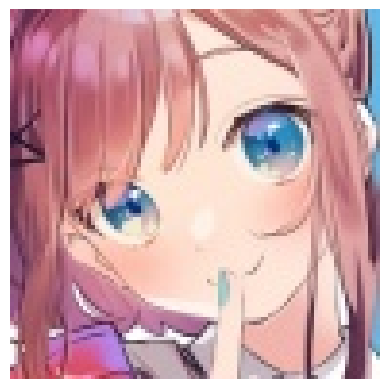

True Label: suzuhara_lulu
This image is likely belongs to:
> astolfo_(fate) : 16.51 % confidence.
> nakano_itsuki : 4.87 % confidence.
> aqua_(konosuba) : 4.46 % confidence.
> sinon : 3.62 % confidence.
> mei_(pokemon) : 3.31 % confidence.


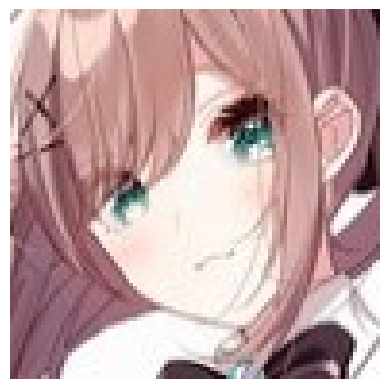

True Label: suzuhara_lulu
This image is likely belongs to:
> suzuhara_lulu : 20.60 % confidence.
> kizuna_ai : 11.12 % confidence.
> toujou_nozomi : 8.29 % confidence.
> ram_rezero : 4.13 % confidence.
> mash_kyrielight : 3.82 % confidence.


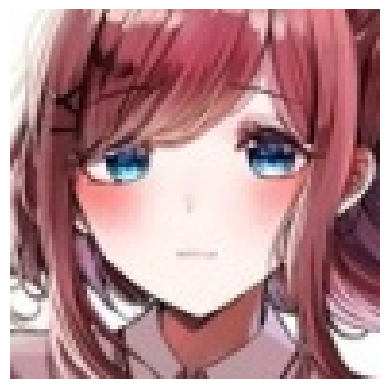

True Label: suzuhara_lulu
This image is likely belongs to:
> suzuhara_lulu : 15.32 % confidence.
> toujou_nozomi : 9.70 % confidence.
> kizuna_ai : 9.29 % confidence.
> nakano_nino : 9.03 % confidence.
> tokoyami_towa : 6.27 % confidence.


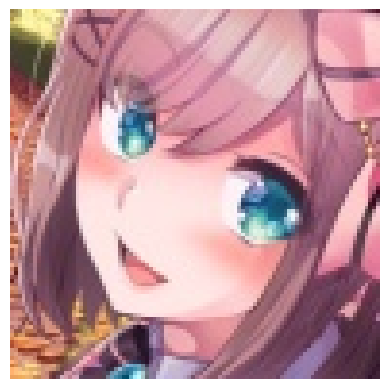

True Label: suzuhara_lulu
This image is likely belongs to:
> suzuhara_lulu : 52.16 % confidence.
> utsumi_erise : 7.91 % confidence.
> nakano_itsuki : 5.41 % confidence.
> kizuna_ai : 4.95 % confidence.
> nakano_nino : 2.61 % confidence.


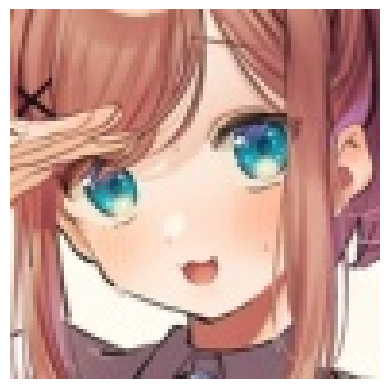

True Label: suzuhara_lulu
This image is likely belongs to:
> fujiwara_chika : 6.86 % confidence.
> watson_amelia : 6.82 % confidence.
> nakano_nino : 6.47 % confidence.
> nishikino_maki : 4.48 % confidence.
> mei_(pokemon) : 4.39 % confidence.


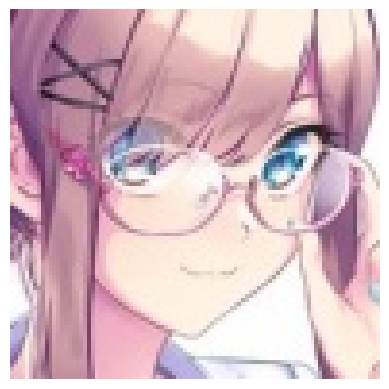

True Label: suzuhara_lulu
This image is likely belongs to:
> nakano_miku : 11.25 % confidence.
> enterprise_(azur_lane) : 10.90 % confidence.
> suzuhara_lulu : 9.79 % confidence.
> utsumi_erise : 5.75 % confidence.
> takimoto_hifumi : 3.90 % confidence.


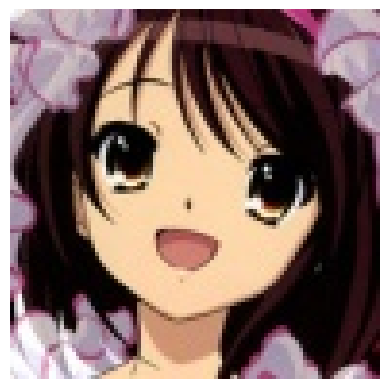

True Label: suzumiya_haruhi
This image is likely belongs to:
> suzumiya_haruhi : 14.05 % confidence.
> hanekawa_tsubasa : 8.19 % confidence.
> satonaka_chie : 5.12 % confidence.
> furukawa_nagisa : 4.65 % confidence.
> nakano_azusa : 4.39 % confidence.


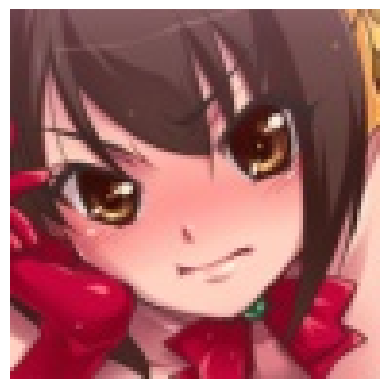

True Label: suzumiya_haruhi
This image is likely belongs to:
> megumin : 8.63 % confidence.
> nishikino_maki : 8.39 % confidence.
> tsushima_yoshiko : 4.30 % confidence.
> ishtar_(fate_grand_order) : 3.61 % confidence.
> atago_(azur_lane) : 3.40 % confidence.


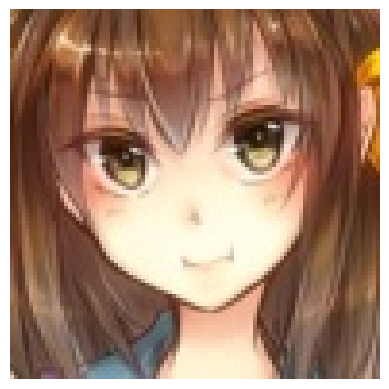

True Label: suzumiya_haruhi
This image is likely belongs to:
> satonaka_chie : 8.43 % confidence.
> misaka_mikoto : 4.71 % confidence.
> aisaka_taiga : 4.57 % confidence.
> sakurajima_mai : 4.32 % confidence.
> tsushima_yoshiko : 3.10 % confidence.


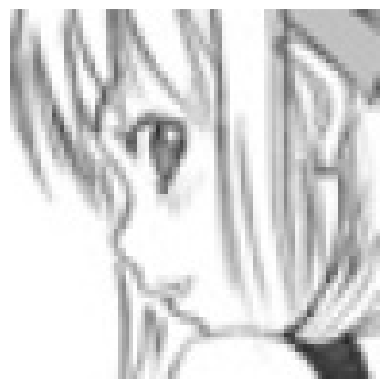

True Label: suzumiya_haruhi
This image is likely belongs to:
> souryuu_asuka_langley : 4.25 % confidence.
> irisviel_von_einzbern : 4.22 % confidence.
> albedo : 4.04 % confidence.
> semiramis_(fate) : 3.29 % confidence.
> gilgamesh : 2.97 % confidence.


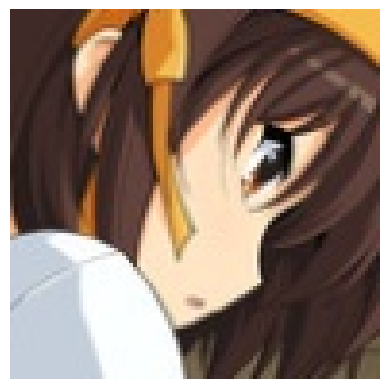

True Label: suzumiya_haruhi
This image is likely belongs to:
> hirasawa_yui : 14.01 % confidence.
> albedo : 9.10 % confidence.
> kirito : 8.68 % confidence.
> kanbaru_suruga : 7.81 % confidence.
> oshino_ougi : 6.44 % confidence.


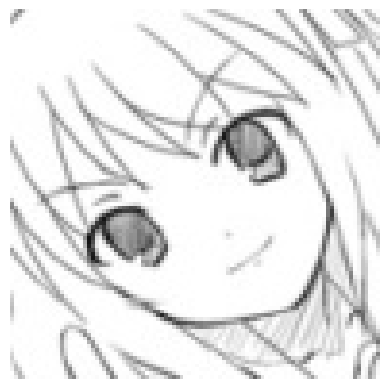

True Label: suzumiya_haruhi
This image is likely belongs to:
> takagi-san : 6.02 % confidence.
> suzumiya_haruhi : 5.58 % confidence.
> satonaka_chie : 2.37 % confidence.
> nakano_yotsuba : 2.37 % confidence.
> shirakami_fubuki : 2.33 % confidence.


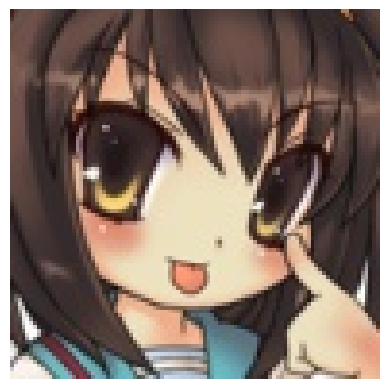

True Label: suzumiya_haruhi
This image is likely belongs to:
> ishtar_(fate_grand_order) : 10.37 % confidence.
> suzumiya_haruhi : 8.72 % confidence.
> nakano_azusa : 6.10 % confidence.
> megumin : 4.37 % confidence.
> furukawa_nagisa : 3.30 % confidence.


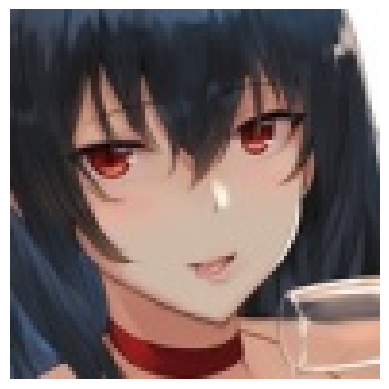

True Label: taihou_(azur_lane)
This image is likely belongs to:
> tsushima_yoshiko : 10.18 % confidence.
> fubuki_(one-punch_man) : 6.42 % confidence.
> shinomiya_kaguya : 6.19 % confidence.
> karin_(blue_archive) : 5.24 % confidence.
> yukinoshita_yukino : 3.77 % confidence.


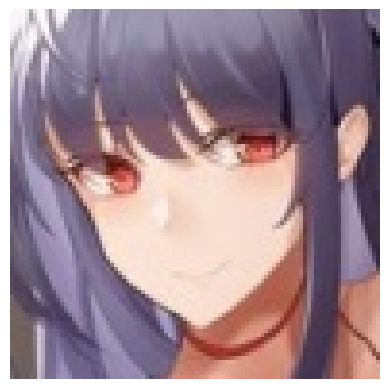

True Label: taihou_(azur_lane)
This image is likely belongs to:
> taihou_(azur_lane) : 6.85 % confidence.
> atago_(azur_lane) : 4.75 % confidence.
> semiramis_(fate) : 4.05 % confidence.
> katsuragi_misato : 3.50 % confidence.
> hyuuga_hinata : 2.83 % confidence.


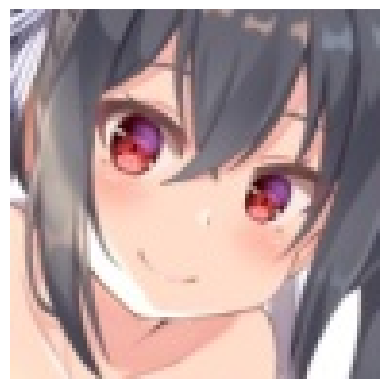

True Label: taihou_(azur_lane)
This image is likely belongs to:
> taihou_(azur_lane) : 13.65 % confidence.
> yukinoshita_yukino : 11.47 % confidence.
> shinomiya_kaguya : 11.19 % confidence.
> keqing_(genshin_impact) : 4.67 % confidence.
> ookami_mio : 3.53 % confidence.


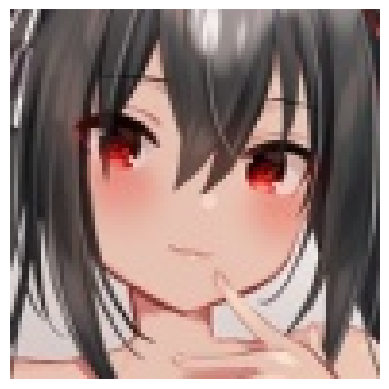

True Label: taihou_(azur_lane)
This image is likely belongs to:
> ichigo_(darling_in_the_franxx) : 9.87 % confidence.
> taihou_(azur_lane) : 8.41 % confidence.
> shuten_douji_(fate) : 4.35 % confidence.
> takanashi_rikka : 4.23 % confidence.
> ayanami_rei : 3.71 % confidence.


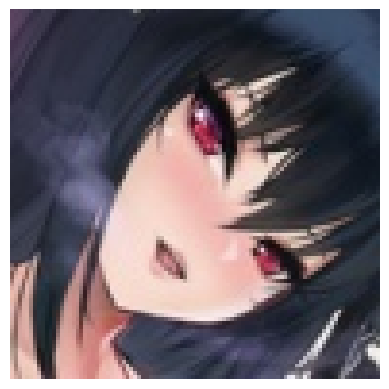

True Label: taihou_(azur_lane)
This image is likely belongs to:
> xenovia_(high_school_dxd) : 16.79 % confidence.
> hatsune_miku : 10.22 % confidence.
> takanashi_rikka : 9.93 % confidence.
> taihou_(azur_lane) : 4.44 % confidence.
> fubuki_(one-punch_man) : 4.36 % confidence.


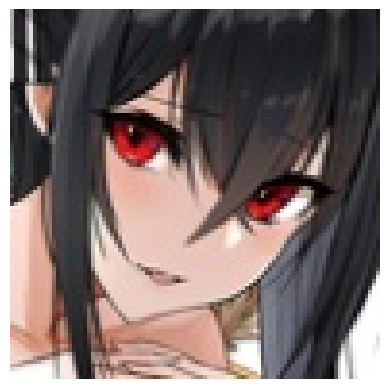

True Label: taihou_(azur_lane)
This image is likely belongs to:
> taihou_(azur_lane) : 18.08 % confidence.
> ookami_mio : 15.71 % confidence.
> kirito : 4.79 % confidence.
> shinomiya_kaguya : 4.74 % confidence.
> yukinoshita_yukino : 4.41 % confidence.


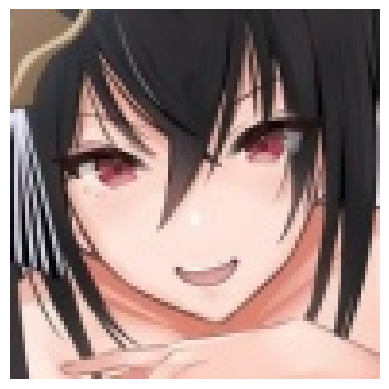

True Label: taihou_(azur_lane)
This image is likely belongs to:
> taihou_(azur_lane) : 14.19 % confidence.
> oshino_ougi : 9.12 % confidence.
> keqing_(genshin_impact) : 8.68 % confidence.
> ayanami_rei : 7.03 % confidence.
> xenovia_(high_school_dxd) : 6.17 % confidence.


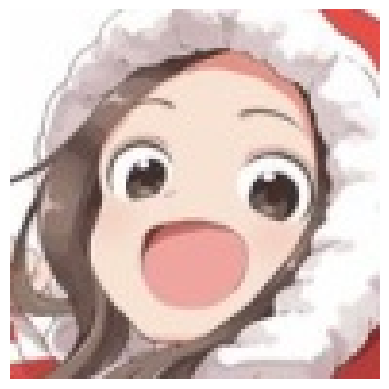

True Label: takagi-san
This image is likely belongs to:
> takagi-san : 19.90 % confidence.
> paimon_(genshin_impact) : 15.44 % confidence.
> gawr_gura : 5.11 % confidence.
> platelet_(hataraku_saibou) : 4.68 % confidence.
> irisviel_von_einzbern : 3.23 % confidence.


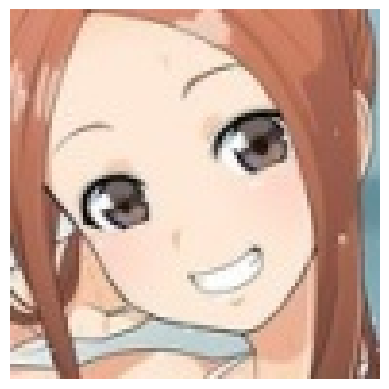

True Label: takagi-san
This image is likely belongs to:
> takagi-san : 19.61 % confidence.
> asuna_(sao) : 5.66 % confidence.
> nami_(one_piece) : 4.22 % confidence.
> platelet_(hataraku_saibou) : 3.21 % confidence.
> suzumiya_haruhi : 3.01 % confidence.


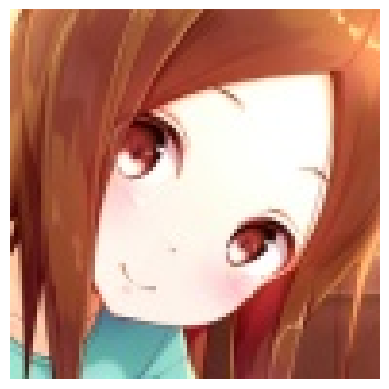

True Label: takagi-san
This image is likely belongs to:
> takagi-san : 38.20 % confidence.
> abigail_williams_(fate) : 4.97 % confidence.
> illyasviel_von_einzbern : 3.09 % confidence.
> toosaka_rin : 2.96 % confidence.
> ninomae_ina'nis : 2.77 % confidence.


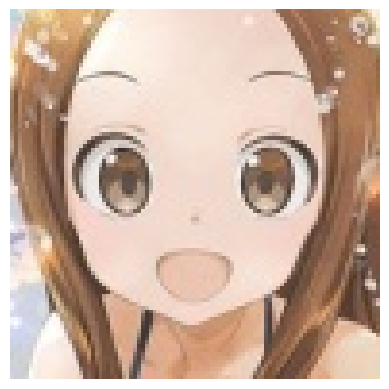

True Label: takagi-san
This image is likely belongs to:
> takagi-san : 56.39 % confidence.
> abigail_williams_(fate) : 10.77 % confidence.
> ninomae_ina'nis : 10.48 % confidence.
> asuna_(sao) : 6.85 % confidence.
> cleveland_(azur_lane) : 1.87 % confidence.


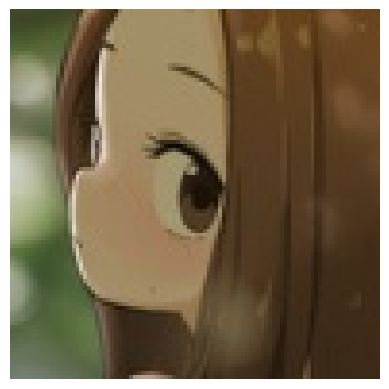

True Label: takagi-san
This image is likely belongs to:
> takagi-san : 81.27 % confidence.
> nakano_yotsuba : 1.74 % confidence.
> chloe_von_einzbern : 1.06 % confidence.
> platelet_(hataraku_saibou) : 1.06 % confidence.
> waver_velvet : 0.98 % confidence.


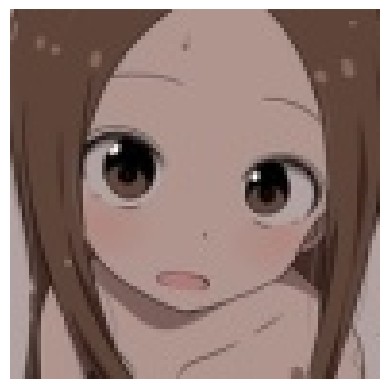

True Label: takagi-san
This image is likely belongs to:
> takagi-san : 42.38 % confidence.
> abigail_williams_(fate) : 5.23 % confidence.
> kizuna_ai : 2.09 % confidence.
> super_sonico : 2.01 % confidence.
> fujiwara_chika : 1.92 % confidence.


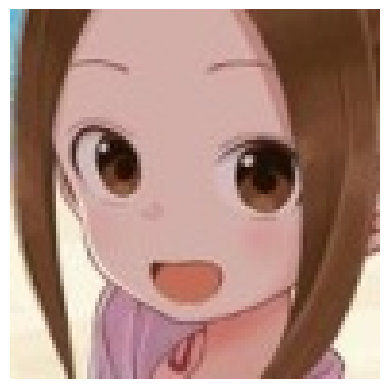

True Label: takagi-san
This image is likely belongs to:
> takagi-san : 87.79 % confidence.
> nakano_yotsuba : 1.82 % confidence.
> fujiwara_chika : 0.69 % confidence.
> platelet_(hataraku_saibou) : 0.69 % confidence.
> asuna_(sao) : 0.67 % confidence.


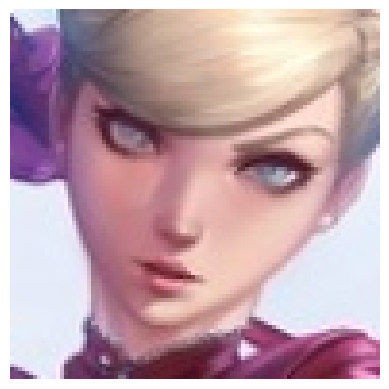

True Label: takamaki_anne
This image is likely belongs to:
> gilgamesh : 26.89 % confidence.
> takamaki_anne : 20.86 % confidence.
> giorno_giovanna : 12.53 % confidence.
> aegis_(persona) : 12.36 % confidence.
> d.va_(overwatch) : 2.09 % confidence.


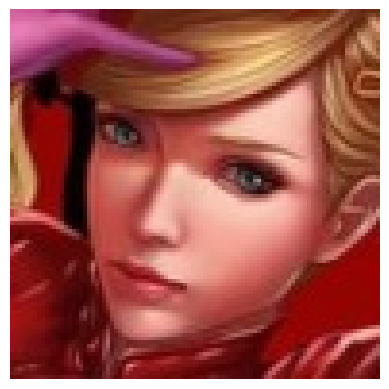

True Label: takamaki_anne
This image is likely belongs to:
> takamaki_anne : 25.84 % confidence.
> giorno_giovanna : 5.53 % confidence.
> gilgamesh : 5.37 % confidence.
> aegis_(persona) : 4.60 % confidence.
> nami_(one_piece) : 4.49 % confidence.


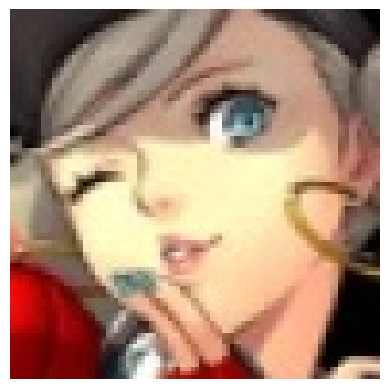

True Label: takamaki_anne
This image is likely belongs to:
> takamaki_anne : 13.69 % confidence.
> giorno_giovanna : 8.80 % confidence.
> abigail_williams_(fate) : 7.52 % confidence.
> kamado_nezuko : 7.45 % confidence.
> lancer : 3.39 % confidence.


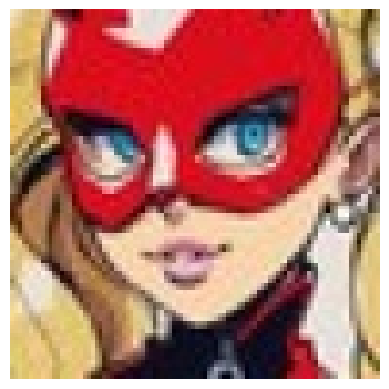

True Label: takamaki_anne
This image is likely belongs to:
> platelet_(hataraku_saibou) : 17.85 % confidence.
> takamaki_anne : 11.71 % confidence.
> sakura_futaba : 10.44 % confidence.
> sengoku_nadeko : 7.37 % confidence.
> shidare_hotaru : 4.15 % confidence.


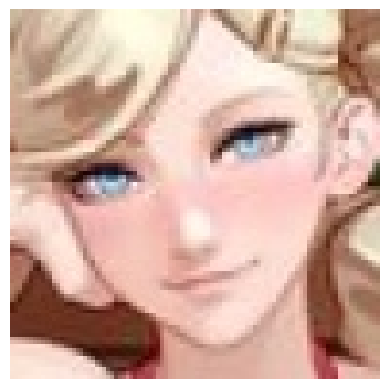

True Label: takamaki_anne
This image is likely belongs to:
> takamaki_anne : 26.52 % confidence.
> miyazono_kawori : 7.14 % confidence.
> gilgamesh : 6.86 % confidence.
> nami_(one_piece) : 5.24 % confidence.
> watson_amelia : 4.49 % confidence.


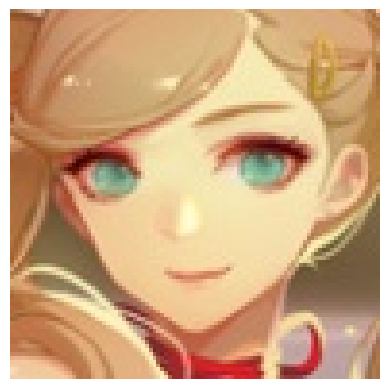

True Label: takamaki_anne
This image is likely belongs to:
> illyasviel_von_einzbern : 20.25 % confidence.
> takamaki_anne : 11.31 % confidence.
> abigail_williams_(fate) : 4.89 % confidence.
> formidable_(azur_lane) : 4.10 % confidence.
> super_sonico : 3.65 % confidence.


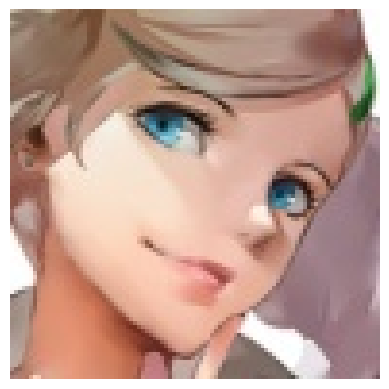

True Label: takamaki_anne
This image is likely belongs to:
> takamaki_anne : 28.32 % confidence.
> giorno_giovanna : 5.17 % confidence.
> d.va_(overwatch) : 4.36 % confidence.
> aegis_(persona) : 4.02 % confidence.
> sakurajima_mai : 2.76 % confidence.


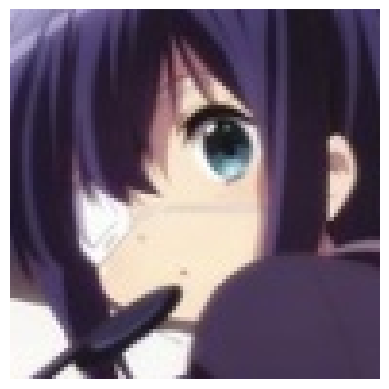

True Label: takanashi_rikka
This image is likely belongs to:
> takanashi_rikka : 17.23 % confidence.
> ryougi_shiki : 16.59 % confidence.
> shibuya_rin : 6.72 % confidence.
> rias_gremory : 3.25 % confidence.
> fujibayashi_kyou : 2.58 % confidence.


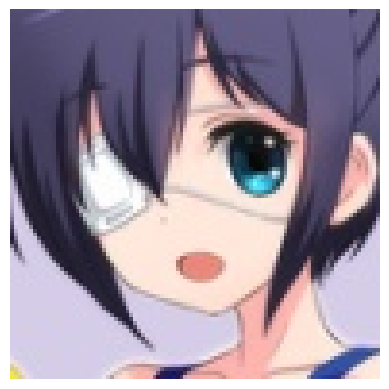

True Label: takanashi_rikka
This image is likely belongs to:
> takanashi_rikka : 29.05 % confidence.
> nakano_azusa : 26.77 % confidence.
> kirito : 4.27 % confidence.
> nagato_yuki : 3.98 % confidence.
> anastasia_(idolmaster) : 3.82 % confidence.


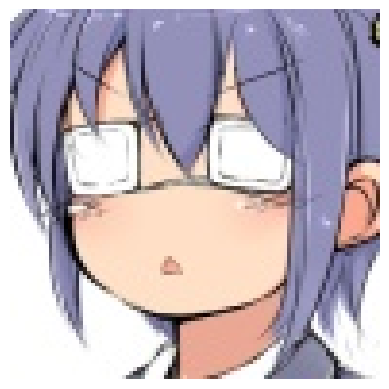

True Label: takanashi_rikka
This image is likely belongs to:
> takanashi_rikka : 8.71 % confidence.
> unicorn_(azur_lane) : 5.23 % confidence.
> makise_kurisu : 4.96 % confidence.
> nakano_azusa : 4.41 % confidence.
> rem_rezero : 3.87 % confidence.


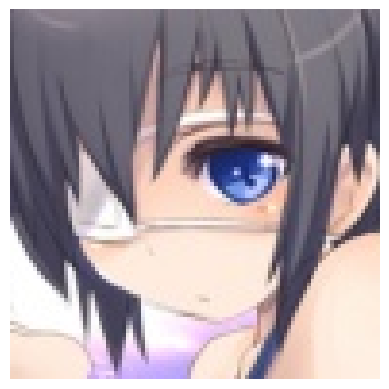

True Label: takanashi_rikka
This image is likely belongs to:
> meltlilith : 22.63 % confidence.
> takanashi_rikka : 14.45 % confidence.
> nagato_yuki : 6.10 % confidence.
> hayasaka_ai : 3.50 % confidence.
> kirito : 3.30 % confidence.


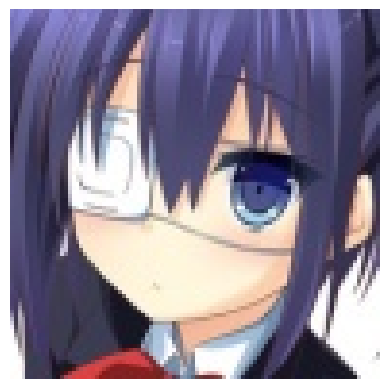

True Label: takanashi_rikka
This image is likely belongs to:
> takanashi_rikka : 17.61 % confidence.
> makise_kurisu : 17.42 % confidence.
> yukinoshita_yukino : 10.91 % confidence.
> kirito : 6.01 % confidence.
> nagato_yuki : 4.22 % confidence.


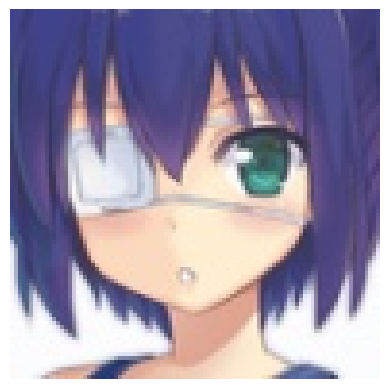

True Label: takanashi_rikka
This image is likely belongs to:
> takanashi_rikka : 73.79 % confidence.
> nagato_yuki : 4.16 % confidence.
> rem_rezero : 2.89 % confidence.
> aisaka_taiga : 1.34 % confidence.
> hatsune_miku : 0.97 % confidence.


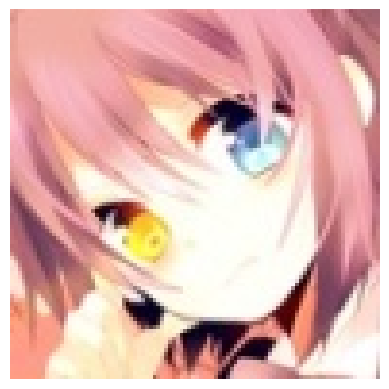

True Label: takanashi_rikka
This image is likely belongs to:
> kizuna_ai : 18.29 % confidence.
> nakano_itsuki : 6.98 % confidence.
> takanashi_rikka : 6.88 % confidence.
> suzuhara_lulu : 4.46 % confidence.
> mash_kyrielight : 4.00 % confidence.


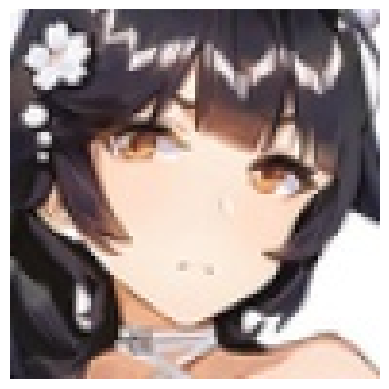

True Label: takao_(azur_lane)
This image is likely belongs to:
> fubuki_(one-punch_man) : 17.63 % confidence.
> takao_(azur_lane) : 13.73 % confidence.
> hanekawa_tsubasa : 6.53 % confidence.
> atago_(azur_lane) : 5.43 % confidence.
> jonathan_joestar : 3.97 % confidence.


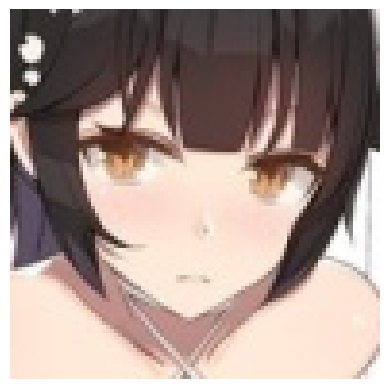

True Label: takao_(azur_lane)
This image is likely belongs to:
> atago_(azur_lane) : 16.93 % confidence.
> takao_(azur_lane) : 7.74 % confidence.
> taihou_(azur_lane) : 4.41 % confidence.
> karin_(blue_archive) : 3.96 % confidence.
> komi_shouko : 3.44 % confidence.


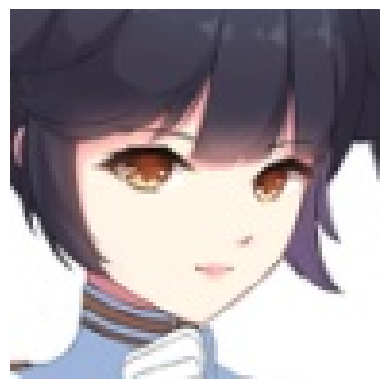

True Label: takao_(azur_lane)
This image is likely belongs to:
> takao_(azur_lane) : 17.13 % confidence.
> shuten_douji_(fate) : 7.43 % confidence.
> nagato_yuki : 4.72 % confidence.
> ichigo_(darling_in_the_franxx) : 3.94 % confidence.
> atago_(azur_lane) : 3.75 % confidence.


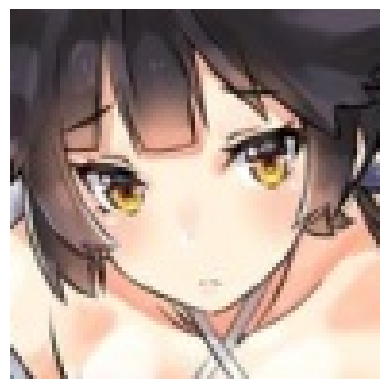

True Label: takao_(azur_lane)
This image is likely belongs to:
> cleveland_(azur_lane) : 11.29 % confidence.
> isshiki_iroha : 7.63 % confidence.
> sakurajima_mai : 6.28 % confidence.
> toujou_nozomi : 5.00 % confidence.
> unicorn_(azur_lane) : 3.86 % confidence.


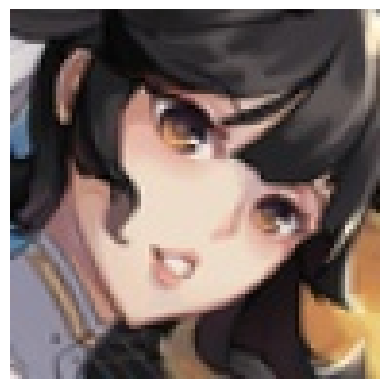

True Label: takao_(azur_lane)
This image is likely belongs to:
> ookami_mio : 10.60 % confidence.
> takao_(azur_lane) : 8.62 % confidence.
> ishtar_(fate_grand_order) : 8.12 % confidence.
> atago_(azur_lane) : 7.54 % confidence.
> d.va_(overwatch) : 6.72 % confidence.


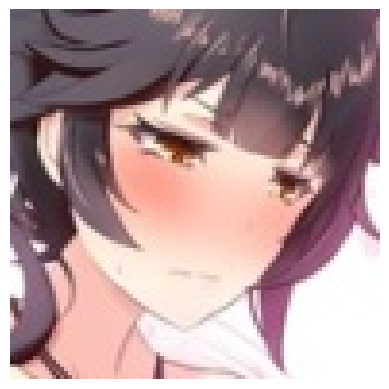

True Label: takao_(azur_lane)
This image is likely belongs to:
> takao_(azur_lane) : 42.75 % confidence.
> ishtar_(fate_grand_order) : 10.18 % confidence.
> komi_shouko : 4.93 % confidence.
> atago_(azur_lane) : 4.42 % confidence.
> megumin : 2.03 % confidence.


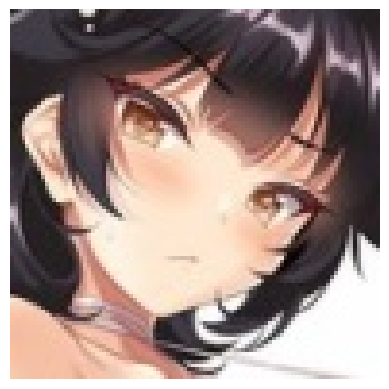

True Label: takao_(azur_lane)
This image is likely belongs to:
> takao_(azur_lane) : 19.55 % confidence.
> fubuki_(one-punch_man) : 6.70 % confidence.
> kanbaru_suruga : 5.31 % confidence.
> atago_(azur_lane) : 5.25 % confidence.
> shinomiya_kaguya : 4.80 % confidence.


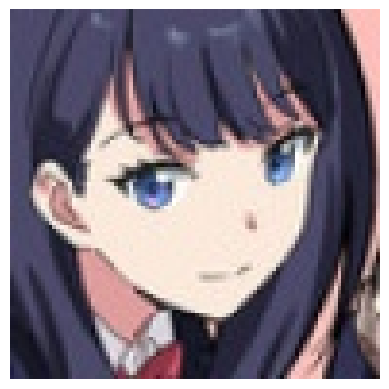

True Label: takarada_rikka
This image is likely belongs to:
> takarada_rikka : 40.92 % confidence.
> megumin : 7.29 % confidence.
> toosaka_rin : 2.39 % confidence.
> ouro_kronii : 2.14 % confidence.
> yukinoshita_yukino : 1.98 % confidence.


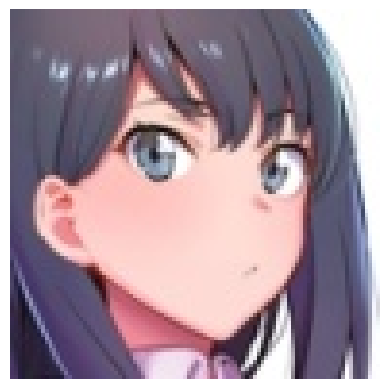

True Label: takarada_rikka
This image is likely belongs to:
> yukinoshita_yukino : 19.53 % confidence.
> takarada_rikka : 6.47 % confidence.
> sakurajima_mai : 3.43 % confidence.
> megumin : 2.86 % confidence.
> nakano_azusa : 2.55 % confidence.


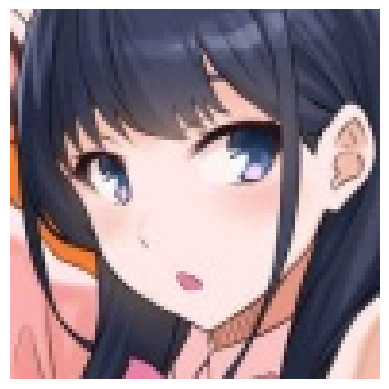

True Label: takarada_rikka
This image is likely belongs to:
> sakurajima_mai : 13.73 % confidence.
> yukinoshita_yukino : 5.32 % confidence.
> takarada_rikka : 4.77 % confidence.
> senjougahara_hitagi : 4.41 % confidence.
> suzumiya_haruhi : 3.71 % confidence.


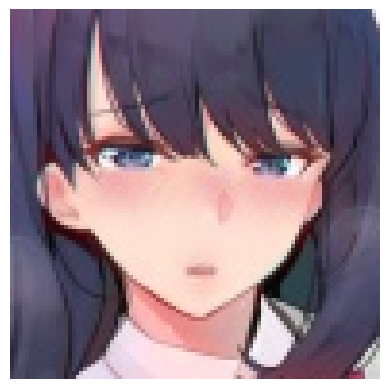

True Label: takarada_rikka
This image is likely belongs to:
> matou_sakura : 12.19 % confidence.
> takao_(azur_lane) : 7.18 % confidence.
> keqing_(genshin_impact) : 5.60 % confidence.
> takimoto_hifumi : 5.25 % confidence.
> tsushima_yoshiko : 3.66 % confidence.


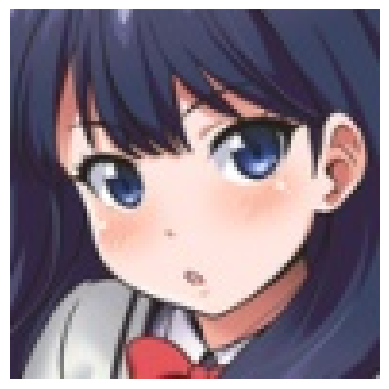

True Label: takarada_rikka
This image is likely belongs to:
> takarada_rikka : 11.78 % confidence.
> toosaka_rin : 4.87 % confidence.
> tsushima_yoshiko : 3.88 % confidence.
> sakurajima_mai : 3.84 % confidence.
> nishikino_maki : 3.35 % confidence.


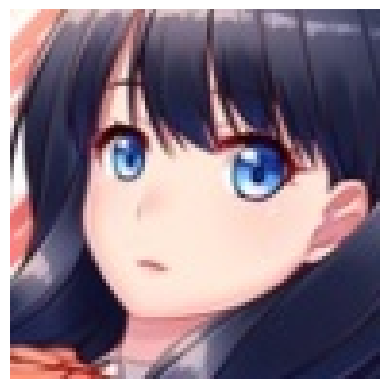

True Label: takarada_rikka
This image is likely belongs to:
> misaka_mikoto : 5.54 % confidence.
> usada_pekora : 5.48 % confidence.
> ninomae_ina'nis : 5.45 % confidence.
> utsumi_erise : 5.43 % confidence.
> takimoto_hifumi : 5.08 % confidence.


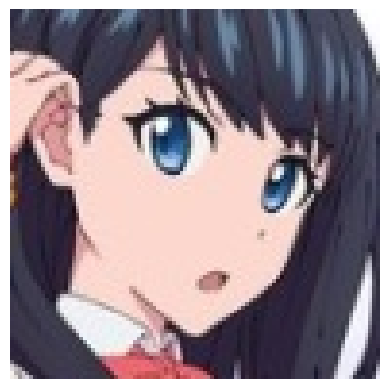

True Label: takarada_rikka
This image is likely belongs to:
> takarada_rikka : 43.29 % confidence.
> chitanda_eru : 7.22 % confidence.
> nakano_azusa : 4.11 % confidence.
> yukinoshita_yukino : 4.11 % confidence.
> shibuya_rin : 3.58 % confidence.


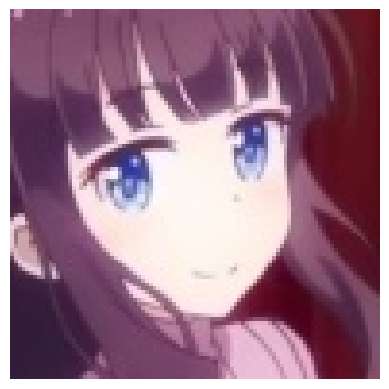

True Label: takimoto_hifumi
This image is likely belongs to:
> takimoto_hifumi : 82.51 % confidence.
> toosaka_rin : 1.73 % confidence.
> utsumi_erise : 1.62 % confidence.
> ninomae_ina'nis : 1.23 % confidence.
> chitanda_eru : 0.89 % confidence.


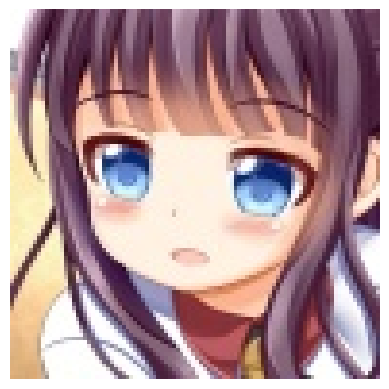

True Label: takimoto_hifumi
This image is likely belongs to:
> gawr_gura : 9.16 % confidence.
> suzumiya_haruhi : 7.21 % confidence.
> shirogane_noel : 6.88 % confidence.
> takimoto_hifumi : 6.01 % confidence.
> shidare_hotaru : 5.40 % confidence.


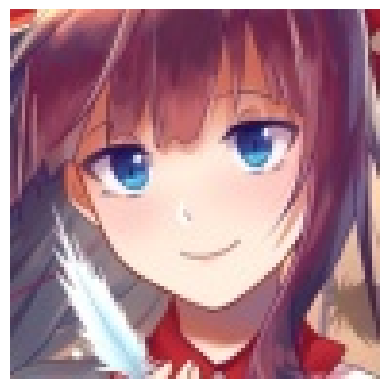

True Label: takimoto_hifumi
This image is likely belongs to:
> megumin : 9.27 % confidence.
> yukinoshita_yukino : 5.85 % confidence.
> shibuya_rin : 4.60 % confidence.
> souryuu_asuka_langley : 4.46 % confidence.
> suzumiya_haruhi : 4.17 % confidence.


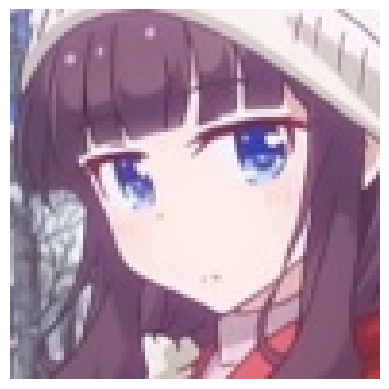

True Label: takimoto_hifumi
This image is likely belongs to:
> mei_(pokemon) : 13.81 % confidence.
> megumin : 5.16 % confidence.
> platelet_(hataraku_saibou) : 4.49 % confidence.
> lancer : 3.75 % confidence.
> fujibayashi_kyou : 3.72 % confidence.


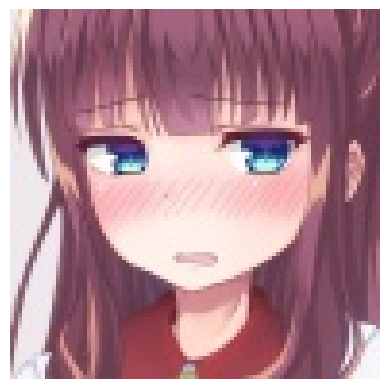

True Label: takimoto_hifumi
This image is likely belongs to:
> takimoto_hifumi : 81.27 % confidence.
> utsumi_erise : 3.09 % confidence.
> fujiwara_chika : 2.41 % confidence.
> zero_two_(darling_in_the_franxx) : 2.40 % confidence.
> dido_(azur_lane) : 1.56 % confidence.


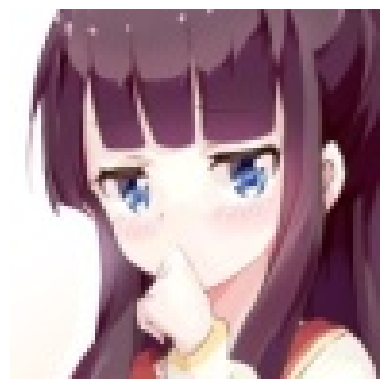

True Label: takimoto_hifumi
This image is likely belongs to:
> ninomae_ina'nis : 8.45 % confidence.
> minato_aqua : 7.14 % confidence.
> takimoto_hifumi : 5.13 % confidence.
> hyuuga_hinata : 4.28 % confidence.
> nekomata_okayu : 2.96 % confidence.


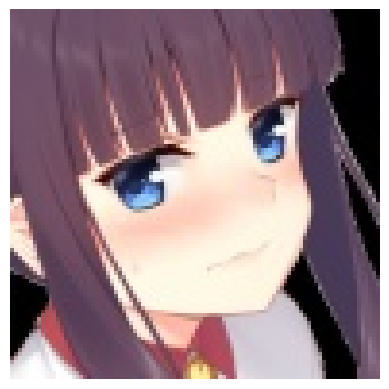

True Label: takimoto_hifumi
This image is likely belongs to:
> takimoto_hifumi : 67.72 % confidence.
> nakano_nino : 5.69 % confidence.
> zero_two_(darling_in_the_franxx) : 2.72 % confidence.
> ninomae_ina'nis : 1.88 % confidence.
> fujiwara_chika : 1.86 % confidence.


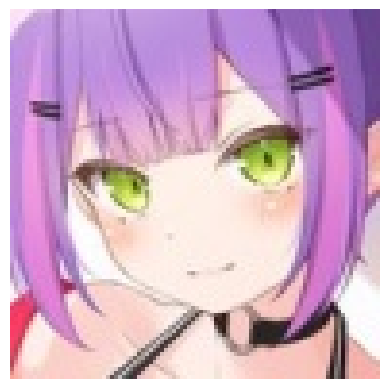

True Label: tokoyami_towa
This image is likely belongs to:
> minato_aqua : 23.81 % confidence.
> tokoyami_towa : 13.83 % confidence.
> nakano_nino : 6.36 % confidence.
> raphtalia : 3.99 % confidence.
> isshiki_iroha : 3.23 % confidence.


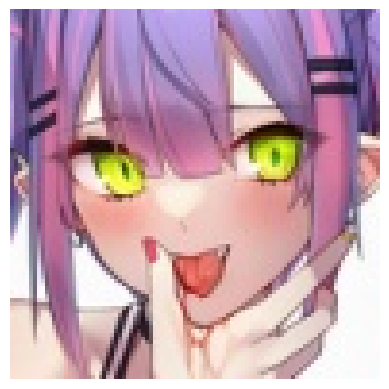

True Label: tokoyami_towa
This image is likely belongs to:
> tokoyami_towa : 5.23 % confidence.
> ookami_mio : 4.81 % confidence.
> nagato_yuki : 4.75 % confidence.
> megumin : 4.72 % confidence.
> raphtalia : 4.46 % confidence.


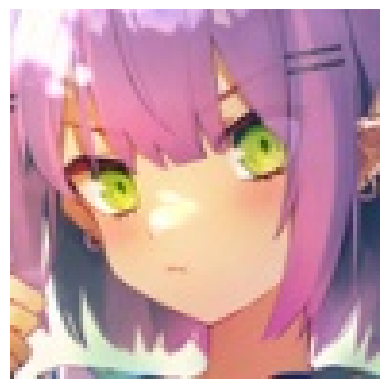

True Label: tokoyami_towa
This image is likely belongs to:
> tokoyami_towa : 13.48 % confidence.
> rem_rezero : 10.82 % confidence.
> suzuhara_lulu : 7.85 % confidence.
> minato_aqua : 7.25 % confidence.
> nekomata_okayu : 5.67 % confidence.


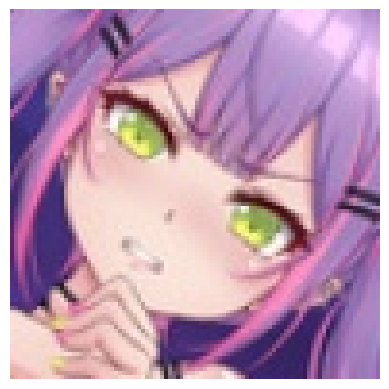

True Label: tokoyami_towa
This image is likely belongs to:
> tokoyami_towa : 28.67 % confidence.
> matou_sakura : 5.52 % confidence.
> chitanda_eru : 4.44 % confidence.
> toosaka_rin : 3.50 % confidence.
> ouro_kronii : 2.86 % confidence.


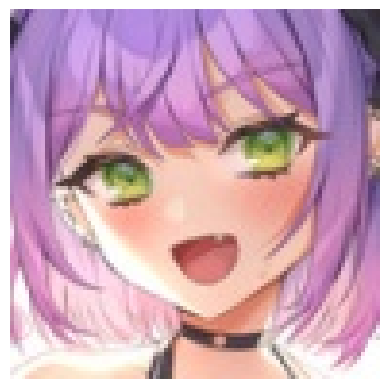

True Label: tokoyami_towa
This image is likely belongs to:
> tokoyami_towa : 9.08 % confidence.
> nekomata_okayu : 6.70 % confidence.
> minato_aqua : 5.13 % confidence.
> satonaka_chie : 4.03 % confidence.
> shirogane_noel : 3.66 % confidence.


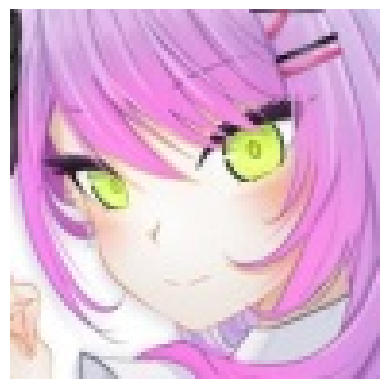

True Label: tokoyami_towa
This image is likely belongs to:
> tokoyami_towa : 57.87 % confidence.
> nekomata_okayu : 28.83 % confidence.
> mash_kyrielight : 2.14 % confidence.
> kaname_madoka : 1.37 % confidence.
> furukawa_nagisa : 0.85 % confidence.


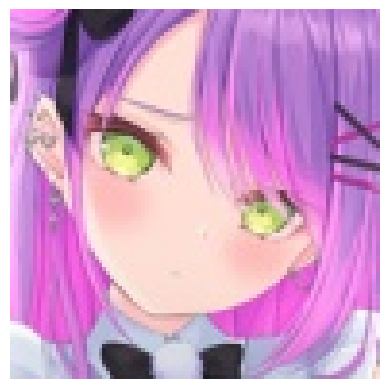

True Label: tokoyami_towa
This image is likely belongs to:
> tokoyami_towa : 67.65 % confidence.
> nakano_nino : 4.31 % confidence.
> suzuhara_lulu : 2.23 % confidence.
> minato_aqua : 1.96 % confidence.
> ram_rezero : 1.60 % confidence.


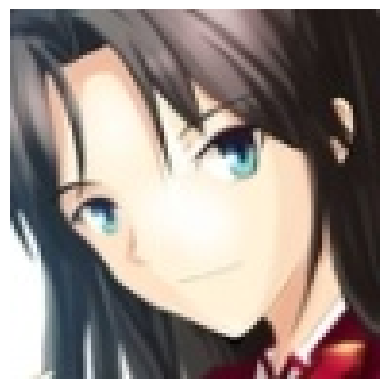

True Label: toosaka_rin
This image is likely belongs to:
> ishtar_(fate_grand_order) : 20.33 % confidence.
> yukinoshita_yukino : 12.60 % confidence.
> toosaka_rin : 5.73 % confidence.
> shinomiya_kaguya : 3.69 % confidence.
> atago_(azur_lane) : 3.47 % confidence.


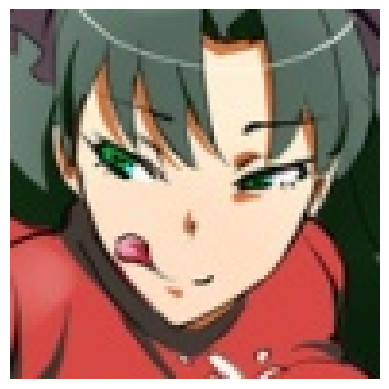

True Label: toosaka_rin
This image is likely belongs to:
> kanbaru_suruga : 13.07 % confidence.
> nakano_azusa : 5.69 % confidence.
> hatsune_miku : 5.60 % confidence.
> oshino_ougi : 4.21 % confidence.
> kirito : 4.01 % confidence.


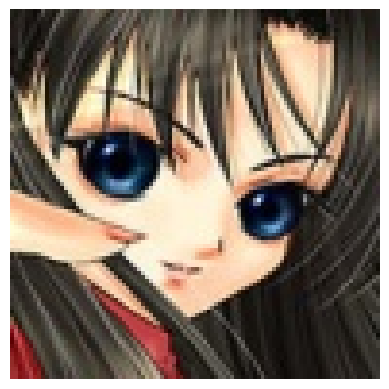

True Label: toosaka_rin
This image is likely belongs to:
> aisaka_taiga : 9.79 % confidence.
> yui_(angel_beats!) : 5.56 % confidence.
> nagato_yuki : 4.39 % confidence.
> sakurajima_mai : 2.44 % confidence.
> misaka_mikoto : 2.38 % confidence.


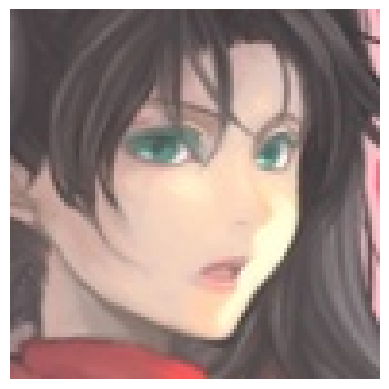

True Label: toosaka_rin
This image is likely belongs to:
> fubuki_(one-punch_man) : 12.42 % confidence.
> taihou_(azur_lane) : 10.23 % confidence.
> toosaka_rin : 8.48 % confidence.
> semiramis_(fate) : 6.24 % confidence.
> megumin : 5.43 % confidence.


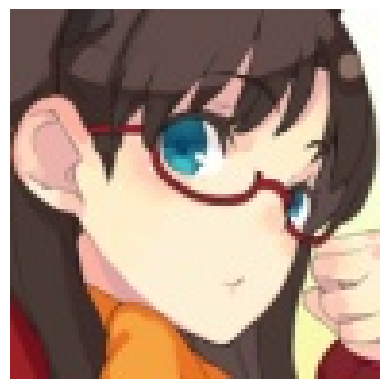

True Label: toosaka_rin
This image is likely belongs to:
> hanekawa_tsubasa : 22.47 % confidence.
> sengoku_nadeko : 7.97 % confidence.
> toosaka_rin : 5.33 % confidence.
> takarada_rikka : 5.32 % confidence.
> takamaki_anne : 4.97 % confidence.


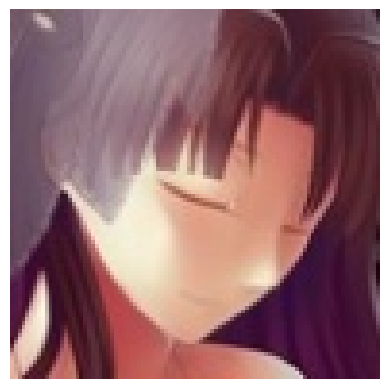

True Label: toosaka_rin
This image is likely belongs to:
> shinomiya_kaguya : 11.47 % confidence.
> fubuki_(one-punch_man) : 10.93 % confidence.
> karin_(blue_archive) : 8.16 % confidence.
> yukinoshita_yukino : 5.05 % confidence.
> taihou_(azur_lane) : 4.58 % confidence.


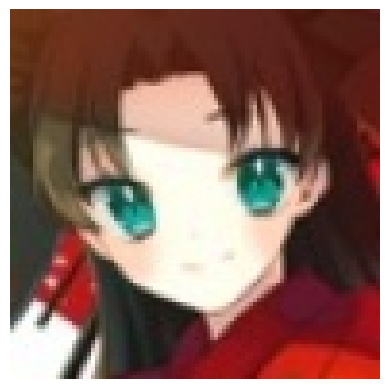

True Label: toosaka_rin
This image is likely belongs to:
> toosaka_rin : 41.69 % confidence.
> megumin : 6.15 % confidence.
> aisaka_taiga : 3.58 % confidence.
> tsushima_yoshiko : 3.57 % confidence.
> nagato_yuki : 2.79 % confidence.


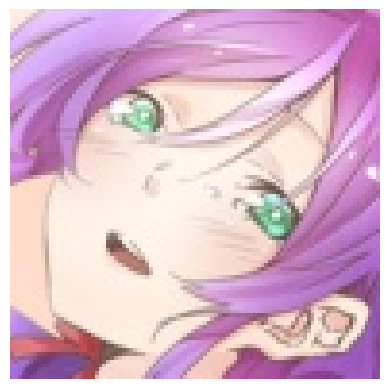

True Label: toujou_nozomi
This image is likely belongs to:
> tokoyami_towa : 11.23 % confidence.
> nekomata_okayu : 9.08 % confidence.
> mash_kyrielight : 8.43 % confidence.
> nishikino_maki : 4.93 % confidence.
> keqing_(genshin_impact) : 4.78 % confidence.


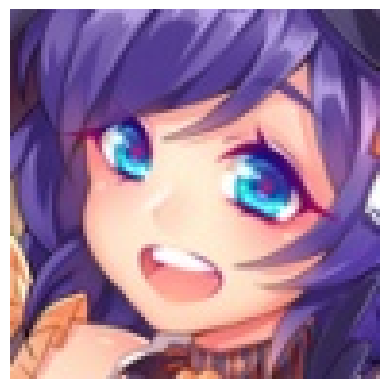

True Label: toujou_nozomi
This image is likely belongs to:
> toujou_nozomi : 11.06 % confidence.
> ookami_mio : 5.51 % confidence.
> toosaka_rin : 4.28 % confidence.
> mei_(pokemon) : 3.47 % confidence.
> nagato_yuki : 3.26 % confidence.


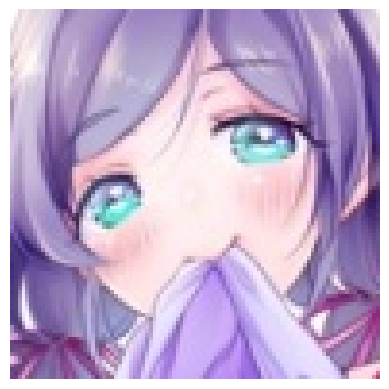

True Label: toujou_nozomi
This image is likely belongs to:
> kizuna_ai : 38.41 % confidence.
> toujou_nozomi : 23.22 % confidence.
> shibuya_rin : 4.31 % confidence.
> suzuhara_lulu : 2.50 % confidence.
> mei_(pokemon) : 2.33 % confidence.


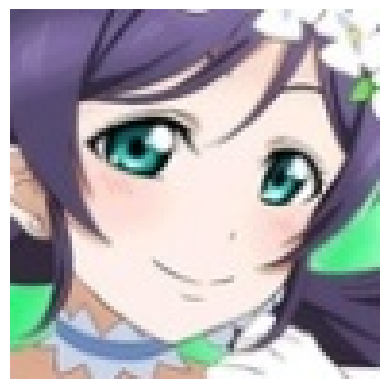

True Label: toujou_nozomi
This image is likely belongs to:
> takamaki_anne : 12.62 % confidence.
> toujou_nozomi : 8.37 % confidence.
> yukinoshita_yukino : 5.47 % confidence.
> kizuna_ai : 3.98 % confidence.
> anastasia_(idolmaster) : 3.82 % confidence.


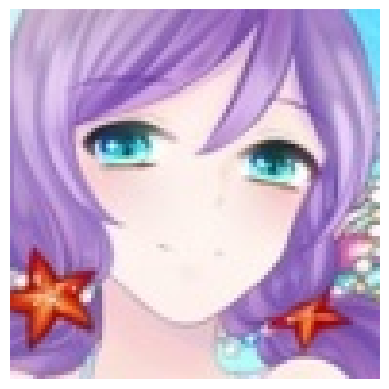

True Label: toujou_nozomi
This image is likely belongs to:
> shidare_hotaru : 8.81 % confidence.
> toujou_nozomi : 7.67 % confidence.
> tokoyami_towa : 6.97 % confidence.
> zero_two_(darling_in_the_franxx) : 6.37 % confidence.
> nakano_nino : 4.99 % confidence.


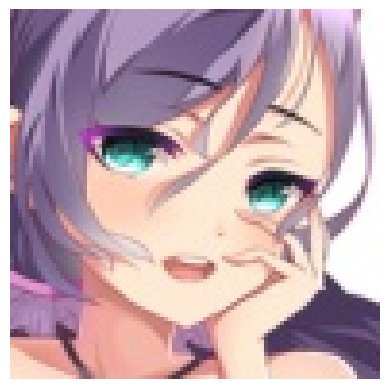

True Label: toujou_nozomi
This image is likely belongs to:
> toujou_nozomi : 14.93 % confidence.
> takanashi_rikka : 9.55 % confidence.
> aisaka_taiga : 5.48 % confidence.
> illyasviel_von_einzbern : 4.23 % confidence.
> utsumi_erise : 3.11 % confidence.


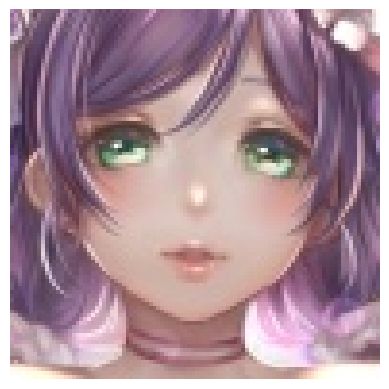

True Label: toujou_nozomi
This image is likely belongs to:
> toujou_nozomi : 30.68 % confidence.
> nishikino_maki : 5.60 % confidence.
> watson_amelia : 4.28 % confidence.
> tsushima_yoshiko : 4.06 % confidence.
> kaname_madoka : 2.89 % confidence.


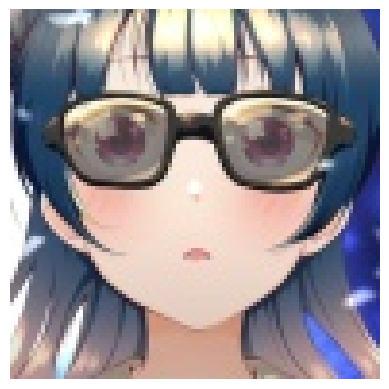

True Label: tsushima_yoshiko
This image is likely belongs to:
> chloe_von_einzbern : 13.95 % confidence.
> unicorn_(azur_lane) : 8.78 % confidence.
> rem_rezero : 6.59 % confidence.
> takao_(azur_lane) : 6.25 % confidence.
> takimoto_hifumi : 5.92 % confidence.


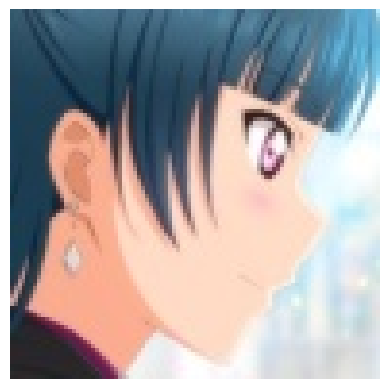

True Label: tsushima_yoshiko
This image is likely belongs to:
> xenovia_(high_school_dxd) : 22.15 % confidence.
> rem_rezero : 8.14 % confidence.
> shirogane_naoto : 8.00 % confidence.
> nagato_yuki : 6.05 % confidence.
> meltlilith : 5.77 % confidence.


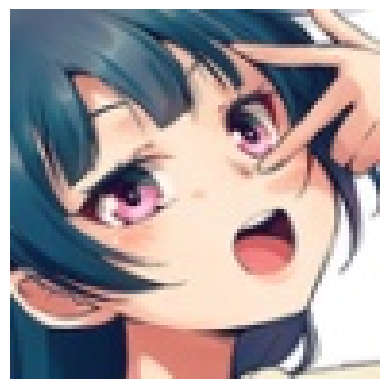

True Label: tsushima_yoshiko
This image is likely belongs to:
> tsushima_yoshiko : 14.04 % confidence.
> nakano_azusa : 5.36 % confidence.
> takarada_rikka : 4.36 % confidence.
> toosaka_rin : 4.31 % confidence.
> furukawa_nagisa : 2.82 % confidence.


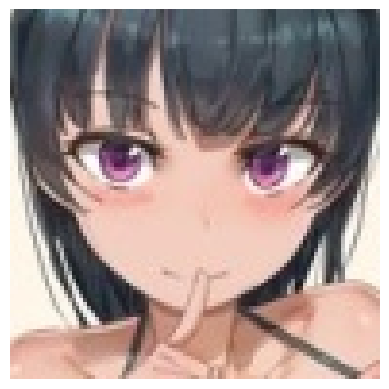

True Label: tsushima_yoshiko
This image is likely belongs to:
> ishtar_(fate_grand_order) : 15.50 % confidence.
> tsushima_yoshiko : 9.92 % confidence.
> shinomiya_kaguya : 9.64 % confidence.
> nakano_azusa : 3.80 % confidence.
> taihou_(azur_lane) : 3.50 % confidence.


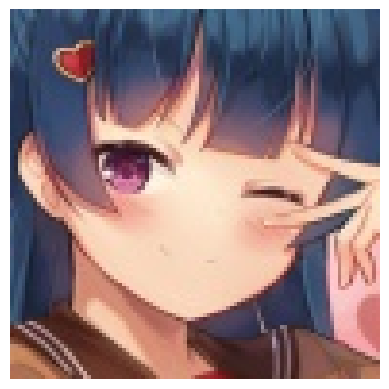

True Label: tsushima_yoshiko
This image is likely belongs to:
> matou_sakura : 36.58 % confidence.
> rem_rezero : 5.84 % confidence.
> nakano_itsuki : 4.58 % confidence.
> st_ar-15_(girls_frontline) : 3.20 % confidence.
> belfast_(azur_lane) : 2.71 % confidence.


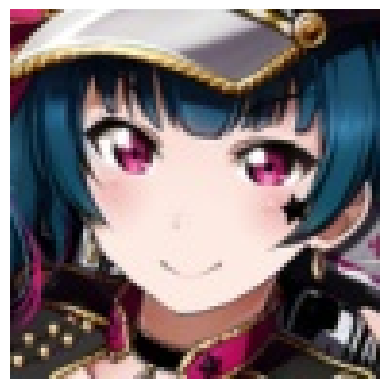

True Label: tsushima_yoshiko
This image is likely belongs to:
> ishtar_(fate_grand_order) : 25.24 % confidence.
> tsushima_yoshiko : 15.02 % confidence.
> toujou_nozomi : 4.04 % confidence.
> kochou_shinobu : 3.83 % confidence.
> toosaka_rin : 3.31 % confidence.


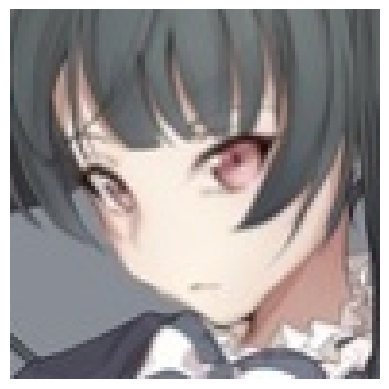

True Label: tsushima_yoshiko
This image is likely belongs to:
> ayanami_rei : 8.82 % confidence.
> gilgamesh : 6.70 % confidence.
> takao_(azur_lane) : 5.23 % confidence.
> keqing_(genshin_impact) : 4.33 % confidence.
> fujibayashi_kyou : 4.23 % confidence.


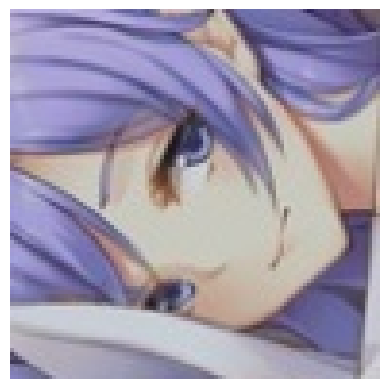

True Label: unicorn_(azur_lane)
This image is likely belongs to:
> xenovia_(high_school_dxd) : 10.65 % confidence.
> sinon : 6.71 % confidence.
> kirito : 5.77 % confidence.
> usada_pekora : 5.33 % confidence.
> ayanami_rei : 5.14 % confidence.


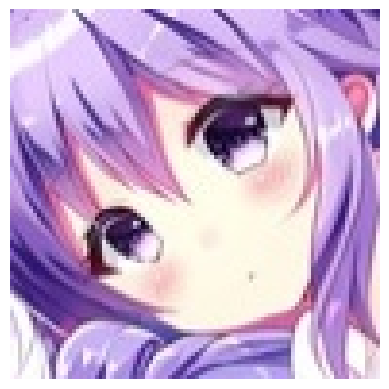

True Label: unicorn_(azur_lane)
This image is likely belongs to:
> nakano_miku : 16.57 % confidence.
> nishikino_maki : 6.62 % confidence.
> rem_rezero : 5.80 % confidence.
> unicorn_(azur_lane) : 5.22 % confidence.
> mash_kyrielight : 3.39 % confidence.


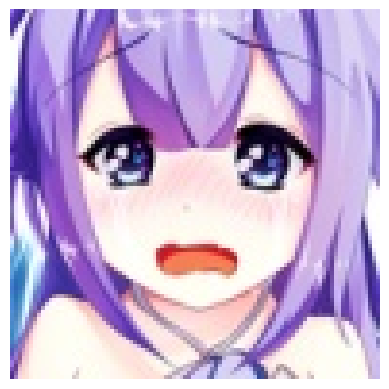

True Label: unicorn_(azur_lane)
This image is likely belongs to:
> unicorn_(azur_lane) : 22.47 % confidence.
> nekomata_okayu : 8.74 % confidence.
> suzuhara_lulu : 5.05 % confidence.
> toujou_nozomi : 3.50 % confidence.
> minato_aqua : 3.21 % confidence.


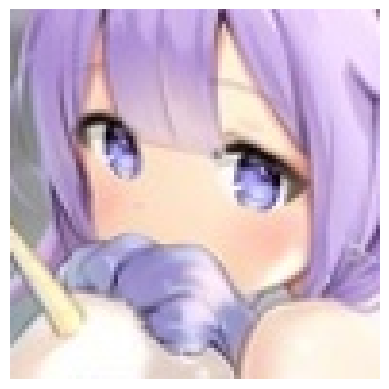

True Label: unicorn_(azur_lane)
This image is likely belongs to:
> unicorn_(azur_lane) : 19.23 % confidence.
> suzuhara_lulu : 5.83 % confidence.
> meltlilith : 4.50 % confidence.
> hayasaka_ai : 4.02 % confidence.
> st_ar-15_(girls_frontline) : 3.11 % confidence.


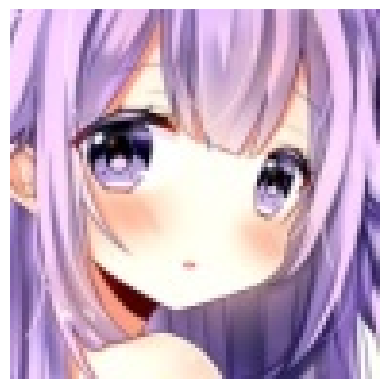

True Label: unicorn_(azur_lane)
This image is likely belongs to:
> nekomata_okayu : 9.42 % confidence.
> hayasaka_ai : 6.13 % confidence.
> unicorn_(azur_lane) : 5.10 % confidence.
> nakano_nino : 5.05 % confidence.
> okita_souji_(fate) : 4.44 % confidence.


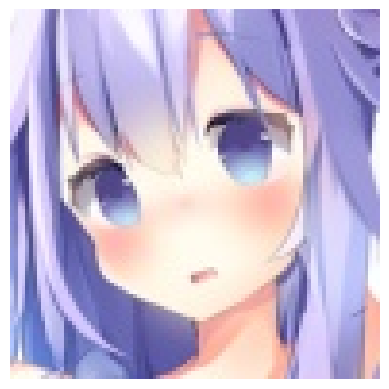

True Label: unicorn_(azur_lane)
This image is likely belongs to:
> hayasaka_ai : 24.22 % confidence.
> unicorn_(azur_lane) : 11.66 % confidence.
> suzuhara_lulu : 3.20 % confidence.
> anastasia_(idolmaster) : 3.03 % confidence.
> nakano_miku : 2.59 % confidence.


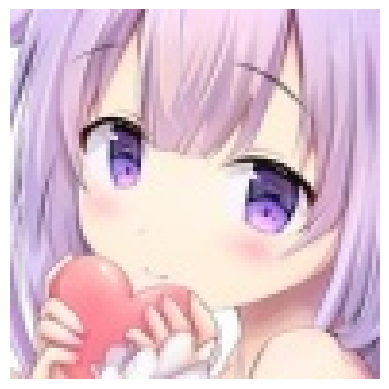

True Label: unicorn_(azur_lane)
This image is likely belongs to:
> fujiwara_chika : 6.59 % confidence.
> toujou_nozomi : 5.44 % confidence.
> unicorn_(azur_lane) : 5.37 % confidence.
> kizuna_ai : 5.21 % confidence.
> minato_aqua : 4.18 % confidence.


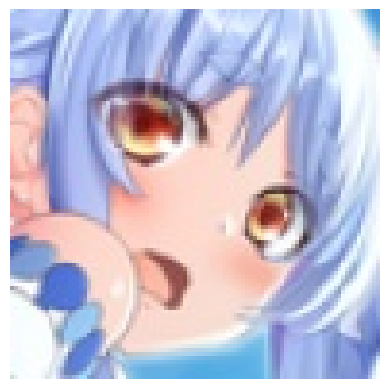

True Label: usada_pekora
This image is likely belongs to:
> fujibayashi_kyou : 7.56 % confidence.
> asia_argento : 6.42 % confidence.
> watson_amelia : 5.77 % confidence.
> suzumiya_haruhi : 4.77 % confidence.
> oshino_shinobu : 4.38 % confidence.


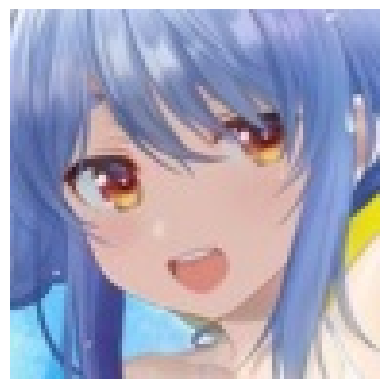

True Label: usada_pekora
This image is likely belongs to:
> fujibayashi_kyou : 16.27 % confidence.
> usada_pekora : 10.55 % confidence.
> meltlilith : 4.04 % confidence.
> gilgamesh : 3.07 % confidence.
> emilia_rezero : 2.70 % confidence.


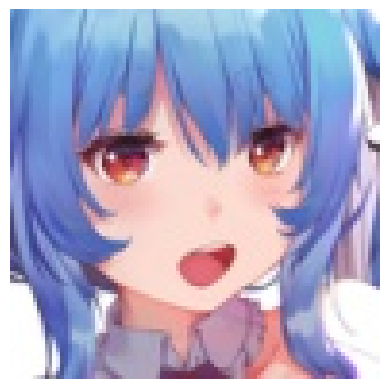

True Label: usada_pekora
This image is likely belongs to:
> usada_pekora : 8.28 % confidence.
> ayanami_rei : 7.15 % confidence.
> fujibayashi_kyou : 4.57 % confidence.
> aqua_(konosuba) : 4.14 % confidence.
> gawr_gura : 3.10 % confidence.


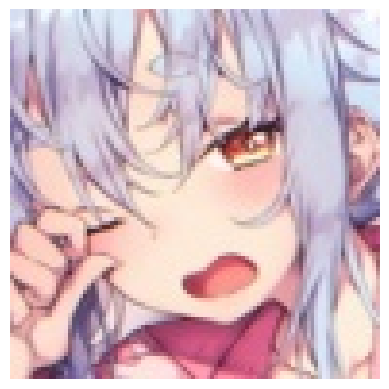

True Label: usada_pekora
This image is likely belongs to:
> sinon : 11.43 % confidence.
> lancer : 5.74 % confidence.
> shishiro_botan : 5.72 % confidence.
> shirakami_fubuki : 4.51 % confidence.
> ayanami_rei : 4.20 % confidence.


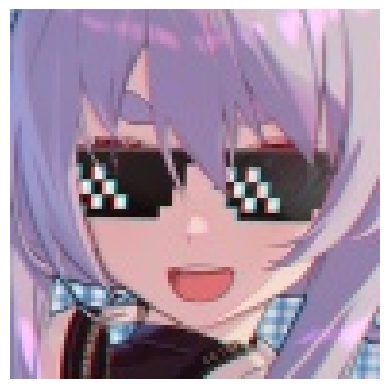

True Label: usada_pekora
This image is likely belongs to:
> nekomata_okayu : 10.93 % confidence.
> shirogane_noel : 5.63 % confidence.
> tokoyami_towa : 5.32 % confidence.
> aisaka_taiga : 3.79 % confidence.
> suzuhara_lulu : 3.02 % confidence.


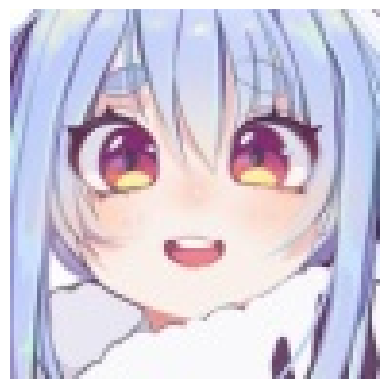

True Label: usada_pekora
This image is likely belongs to:
> super_sonico : 9.60 % confidence.
> illyasviel_von_einzbern : 7.03 % confidence.
> shidare_hotaru : 3.49 % confidence.
> usada_pekora : 3.41 % confidence.
> laffey_(azur_lane) : 3.29 % confidence.


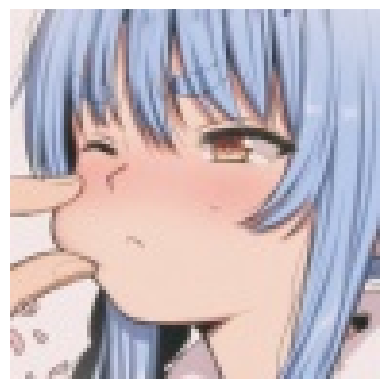

True Label: usada_pekora
This image is likely belongs to:
> chloe_von_einzbern : 4.86 % confidence.
> takarada_rikka : 4.13 % confidence.
> usada_pekora : 3.78 % confidence.
> hatsune_miku : 3.74 % confidence.
> fujibayashi_kyou : 3.71 % confidence.


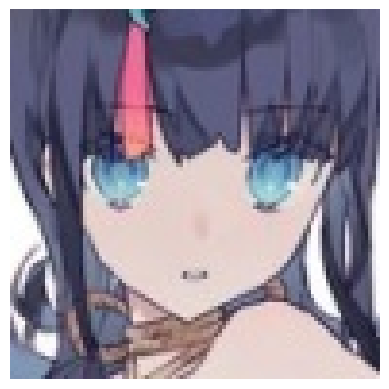

True Label: utsumi_erise
This image is likely belongs to:
> yukinoshita_yukino : 21.36 % confidence.
> utsumi_erise : 13.23 % confidence.
> takarada_rikka : 4.88 % confidence.
> atago_(azur_lane) : 4.68 % confidence.
> ookami_mio : 3.59 % confidence.


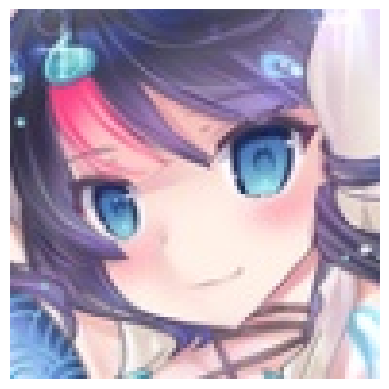

True Label: utsumi_erise
This image is likely belongs to:
> takamaki_anne : 14.91 % confidence.
> shirakami_fubuki : 10.89 % confidence.
> giorno_giovanna : 5.87 % confidence.
> utsumi_erise : 5.24 % confidence.
> suzuhara_lulu : 4.43 % confidence.


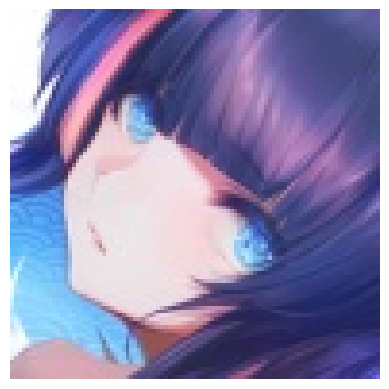

True Label: utsumi_erise
This image is likely belongs to:
> utsumi_erise : 26.76 % confidence.
> ookami_mio : 3.89 % confidence.
> takarada_rikka : 3.72 % confidence.
> usada_pekora : 3.57 % confidence.
> nishikino_maki : 2.60 % confidence.


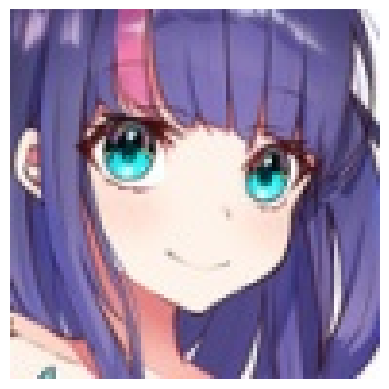

True Label: utsumi_erise
This image is likely belongs to:
> suzuhara_lulu : 11.47 % confidence.
> utsumi_erise : 9.74 % confidence.
> fujiwara_chika : 5.94 % confidence.
> nakano_itsuki : 5.87 % confidence.
> kizuna_ai : 4.75 % confidence.


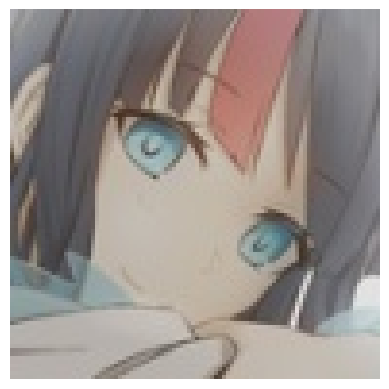

True Label: utsumi_erise
This image is likely belongs to:
> utsumi_erise : 16.29 % confidence.
> takanashi_rikka : 13.66 % confidence.
> suzuhara_lulu : 8.05 % confidence.
> meltlilith : 5.06 % confidence.
> fujiwara_chika : 3.61 % confidence.


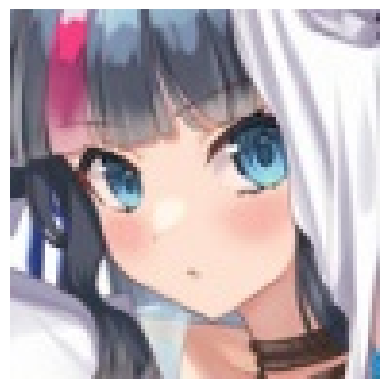

True Label: utsumi_erise
This image is likely belongs to:
> utsumi_erise : 53.39 % confidence.
> yukinoshita_yukino : 6.30 % confidence.
> nakano_miku : 3.55 % confidence.
> ouro_kronii : 2.73 % confidence.
> enterprise_(azur_lane) : 2.41 % confidence.


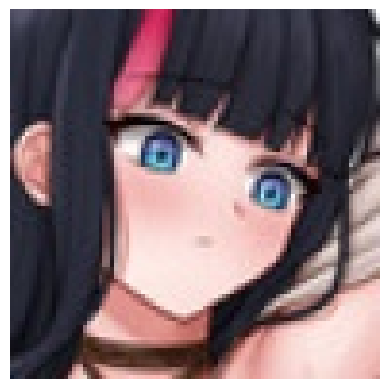

True Label: utsumi_erise
This image is likely belongs to:
> nakano_nino : 14.28 % confidence.
> zero_two_(darling_in_the_franxx) : 9.24 % confidence.
> takarada_rikka : 2.94 % confidence.
> hyuuga_hinata : 2.65 % confidence.
> toosaka_rin : 2.57 % confidence.


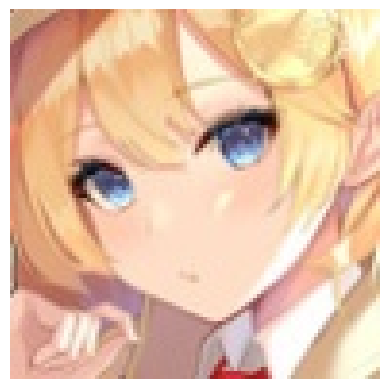

True Label: watson_amelia
This image is likely belongs to:
> cleveland_(azur_lane) : 17.68 % confidence.
> oshino_shinobu : 12.77 % confidence.
> nishikino_maki : 7.16 % confidence.
> raphtalia : 4.31 % confidence.
> isshiki_iroha : 4.27 % confidence.


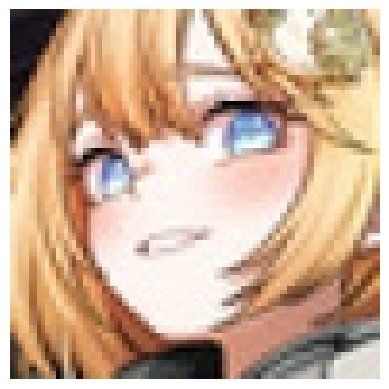

True Label: watson_amelia
This image is likely belongs to:
> aegis_(persona) : 7.25 % confidence.
> miyazono_kawori : 5.40 % confidence.
> okita_souji_(fate) : 5.39 % confidence.
> nami_(one_piece) : 3.71 % confidence.
> souryuu_asuka_langley : 3.43 % confidence.


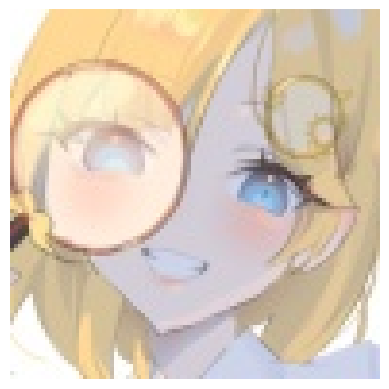

True Label: watson_amelia
This image is likely belongs to:
> unicorn_(azur_lane) : 8.15 % confidence.
> usada_pekora : 5.91 % confidence.
> abigail_williams_(fate) : 5.18 % confidence.
> laffey_(azur_lane) : 4.81 % confidence.
> watson_amelia : 4.73 % confidence.


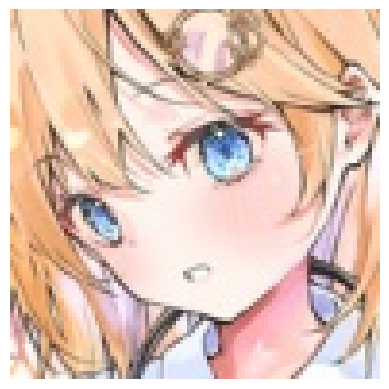

True Label: watson_amelia
This image is likely belongs to:
> watson_amelia : 9.64 % confidence.
> asia_argento : 5.69 % confidence.
> takamaki_anne : 5.00 % confidence.
> sinon : 4.92 % confidence.
> asuna_(sao) : 4.27 % confidence.


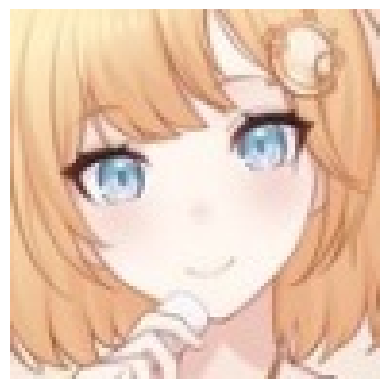

True Label: watson_amelia
This image is likely belongs to:
> watson_amelia : 10.47 % confidence.
> nishikino_maki : 5.40 % confidence.
> miyazono_kawori : 5.01 % confidence.
> asia_argento : 4.67 % confidence.
> nakano_nino : 3.23 % confidence.


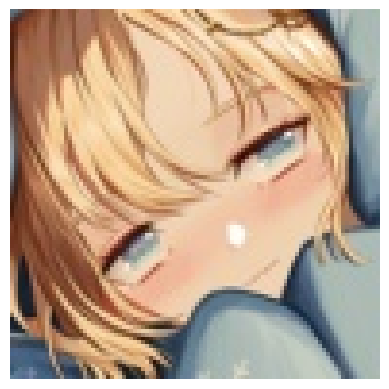

True Label: watson_amelia
This image is likely belongs to:
> watson_amelia : 9.07 % confidence.
> arcueid_brunestud : 8.39 % confidence.
> cleveland_(azur_lane) : 8.03 % confidence.
> aegis_(persona) : 6.24 % confidence.
> miyazono_kawori : 4.54 % confidence.


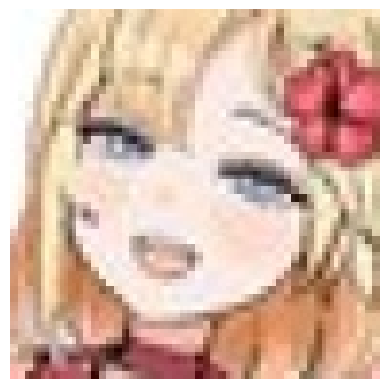

True Label: watson_amelia
This image is likely belongs to:
> oshino_shinobu : 21.88 % confidence.
> abigail_williams_(fate) : 7.45 % confidence.
> asuna_(sao) : 7.10 % confidence.
> kiryu_coco : 6.81 % confidence.
> watson_amelia : 4.04 % confidence.


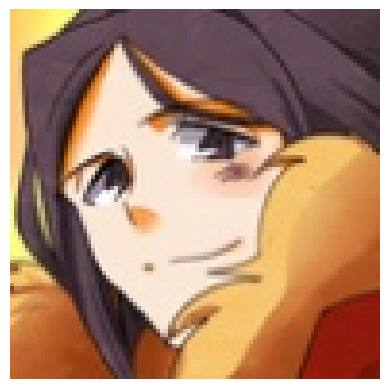

True Label: waver_velvet
This image is likely belongs to:
> sengoku_nadeko : 14.04 % confidence.
> takagi-san : 5.03 % confidence.
> abigail_williams_(fate) : 4.28 % confidence.
> waver_velvet : 3.93 % confidence.
> megumin : 3.74 % confidence.


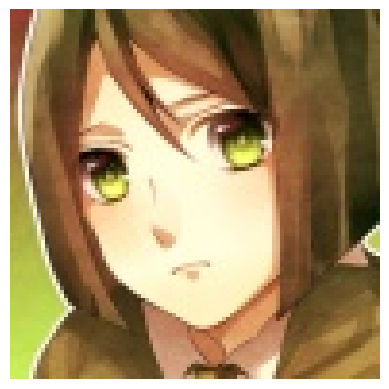

True Label: waver_velvet
This image is likely belongs to:
> sakurauchi_riko : 12.62 % confidence.
> waver_velvet : 10.86 % confidence.
> semiramis_(fate) : 8.19 % confidence.
> bremerton_(azur_lane) : 3.92 % confidence.
> nico_robin : 3.71 % confidence.


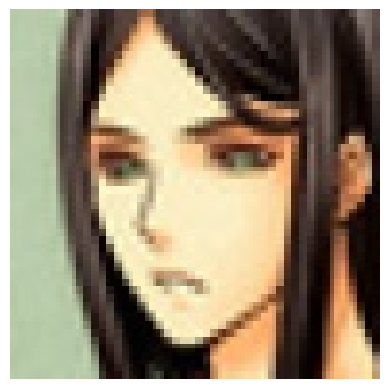

True Label: waver_velvet
This image is likely belongs to:
> nico_robin : 41.05 % confidence.
> rider : 6.92 % confidence.
> waver_velvet : 4.81 % confidence.
> lancer : 4.42 % confidence.
> shinomiya_kaguya : 3.20 % confidence.


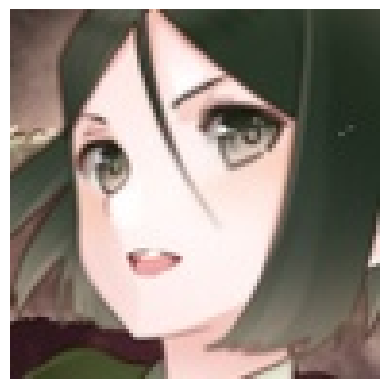

True Label: waver_velvet
This image is likely belongs to:
> waver_velvet : 48.92 % confidence.
> ichigo_(darling_in_the_franxx) : 12.37 % confidence.
> sakurauchi_riko : 2.59 % confidence.
> kirito : 2.11 % confidence.
> takagi-san : 1.93 % confidence.


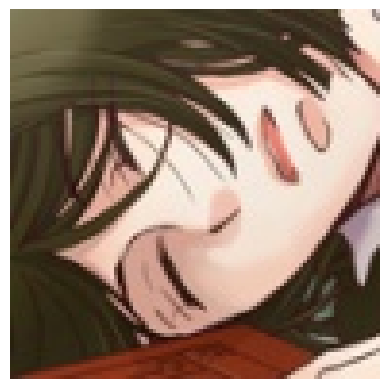

True Label: waver_velvet
This image is likely belongs to:
> fubuki_(one-punch_man) : 12.03 % confidence.
> kirito : 6.57 % confidence.
> oshino_ougi : 6.38 % confidence.
> karna_(fate) : 6.37 % confidence.
> albedo : 4.37 % confidence.


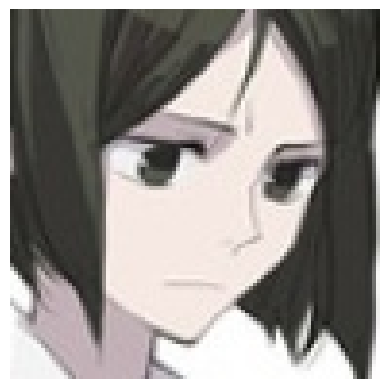

True Label: waver_velvet
This image is likely belongs to:
> waver_velvet : 17.08 % confidence.
> nico_robin : 11.99 % confidence.
> fubuki_(one-punch_man) : 5.12 % confidence.
> ookami_mio : 4.49 % confidence.
> hyuuga_hinata : 3.06 % confidence.


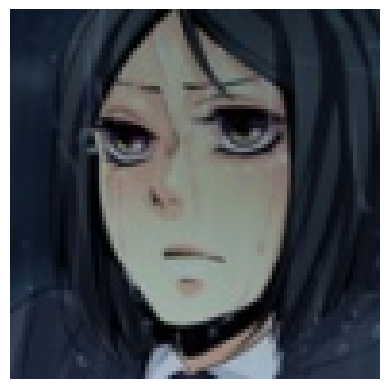

True Label: waver_velvet
This image is likely belongs to:
> waver_velvet : 22.09 % confidence.
> makise_kurisu : 7.38 % confidence.
> shuten_douji_(fate) : 6.80 % confidence.
> nami_(one_piece) : 3.49 % confidence.
> gawr_gura : 3.44 % confidence.


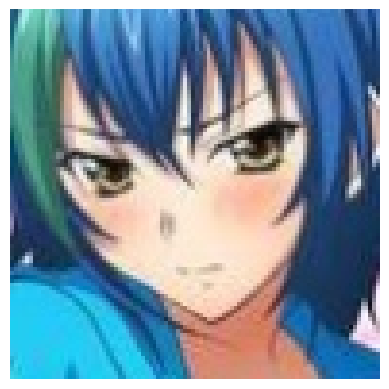

True Label: xenovia_(high_school_dxd)
This image is likely belongs to:
> xenovia_(high_school_dxd) : 29.35 % confidence.
> shirogane_naoto : 8.67 % confidence.
> kanbaru_suruga : 8.51 % confidence.
> ayanami_rei : 5.04 % confidence.
> fubuki_(one-punch_man) : 4.07 % confidence.


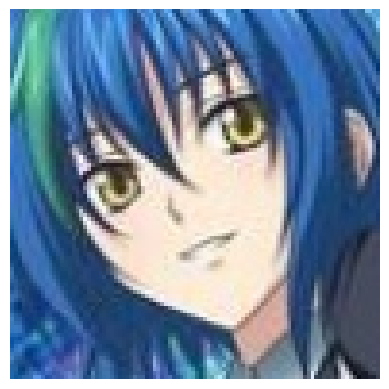

True Label: xenovia_(high_school_dxd)
This image is likely belongs to:
> xenovia_(high_school_dxd) : 93.03 % confidence.
> furukawa_nagisa : 0.63 % confidence.
> nishikino_maki : 0.51 % confidence.
> fujibayashi_kyou : 0.39 % confidence.
> nami_(one_piece) : 0.39 % confidence.


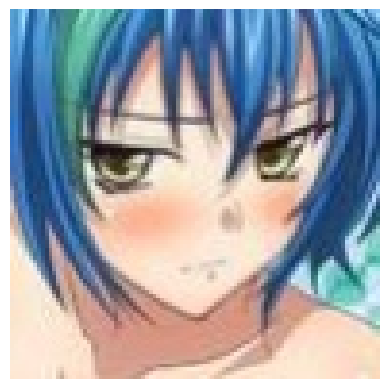

True Label: xenovia_(high_school_dxd)
This image is likely belongs to:
> xenovia_(high_school_dxd) : 20.10 % confidence.
> rem_rezero : 6.42 % confidence.
> shibuya_rin : 3.93 % confidence.
> nakano_yotsuba : 3.35 % confidence.
> suzumiya_haruhi : 3.03 % confidence.


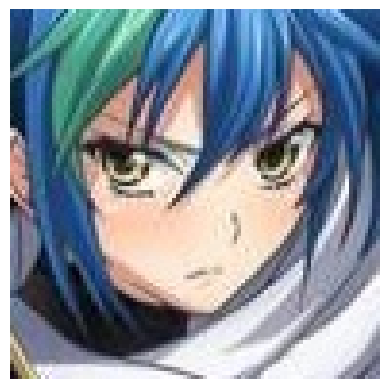

True Label: xenovia_(high_school_dxd)
This image is likely belongs to:
> xenovia_(high_school_dxd) : 53.09 % confidence.
> takanashi_rikka : 6.46 % confidence.
> ouro_kronii : 5.87 % confidence.
> shirakami_fubuki : 3.20 % confidence.
> okita_souji_(fate) : 3.01 % confidence.


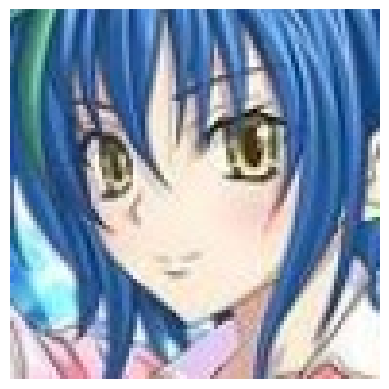

True Label: xenovia_(high_school_dxd)
This image is likely belongs to:
> xenovia_(high_school_dxd) : 57.46 % confidence.
> rem_rezero : 10.06 % confidence.
> anastasia_(idolmaster) : 5.13 % confidence.
> nishikino_maki : 2.07 % confidence.
> kirito : 1.59 % confidence.


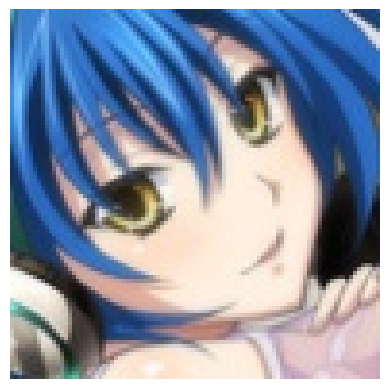

True Label: xenovia_(high_school_dxd)
This image is likely belongs to:
> xenovia_(high_school_dxd) : 24.42 % confidence.
> kanbaru_suruga : 11.35 % confidence.
> shirogane_naoto : 5.69 % confidence.
> ayanami_rei : 4.38 % confidence.
> sinon : 4.27 % confidence.


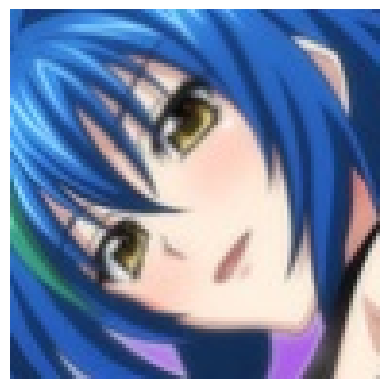

True Label: xenovia_(high_school_dxd)
This image is likely belongs to:
> xenovia_(high_school_dxd) : 55.07 % confidence.
> kanbaru_suruga : 3.59 % confidence.
> hatsune_miku : 3.37 % confidence.
> nishikino_maki : 3.02 % confidence.
> rias_gremory : 2.88 % confidence.


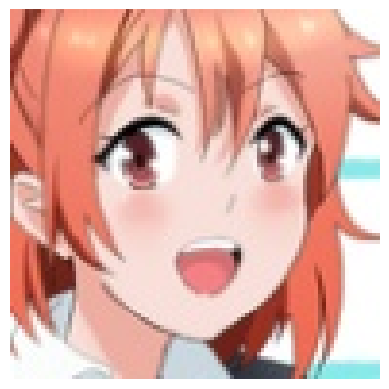

True Label: yuigahama_yui
This image is likely belongs to:
> misaka_mikoto : 26.38 % confidence.
> yuigahama_yui : 11.86 % confidence.
> isshiki_iroha : 4.79 % confidence.
> nami_(one_piece) : 3.83 % confidence.
> aqua_(konosuba) : 3.48 % confidence.


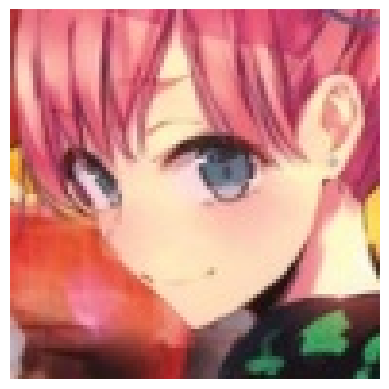

True Label: yuigahama_yui
This image is likely belongs to:
> nami_(one_piece) : 8.05 % confidence.
> belfast_(azur_lane) : 7.68 % confidence.
> aegis_(persona) : 7.03 % confidence.
> rem_rezero : 4.61 % confidence.
> miyazono_kawori : 4.57 % confidence.


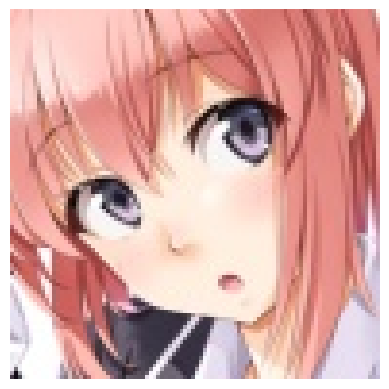

True Label: yuigahama_yui
This image is likely belongs to:
> yuigahama_yui : 18.74 % confidence.
> nakano_itsuki : 8.43 % confidence.
> nakano_nino : 8.12 % confidence.
> fujiwara_chika : 6.16 % confidence.
> utsumi_erise : 2.87 % confidence.


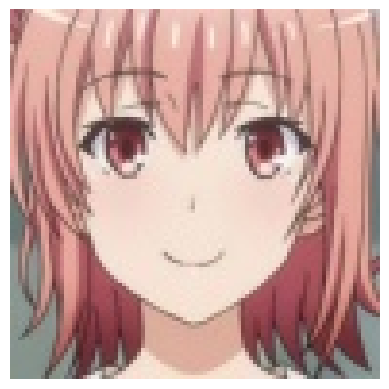

True Label: yuigahama_yui
This image is likely belongs to:
> yuigahama_yui : 10.87 % confidence.
> isshiki_iroha : 6.60 % confidence.
> nami_(one_piece) : 4.23 % confidence.
> matou_sakura : 4.11 % confidence.
> nakano_nino : 3.50 % confidence.


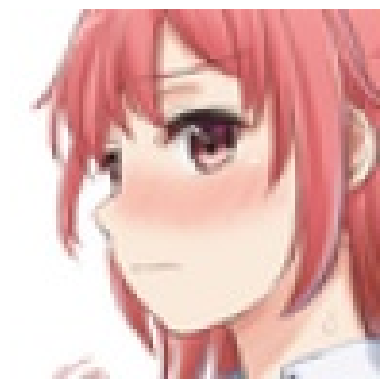

True Label: yuigahama_yui
This image is likely belongs to:
> yuigahama_yui : 17.66 % confidence.
> misaka_mikoto : 15.96 % confidence.
> rias_gremory : 3.13 % confidence.
> yukinoshita_yukino : 2.77 % confidence.
> souryuu_asuka_langley : 2.41 % confidence.


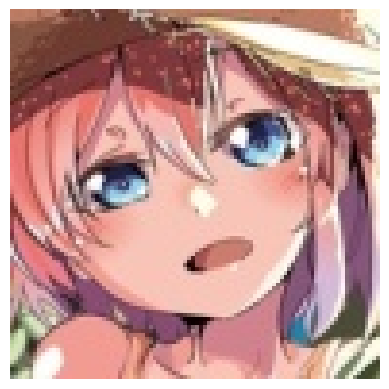

True Label: yuigahama_yui
This image is likely belongs to:
> mei_(pokemon) : 8.17 % confidence.
> platelet_(hataraku_saibou) : 7.20 % confidence.
> astolfo_(fate) : 3.44 % confidence.
> sinon : 3.31 % confidence.
> aqua_(konosuba) : 3.25 % confidence.


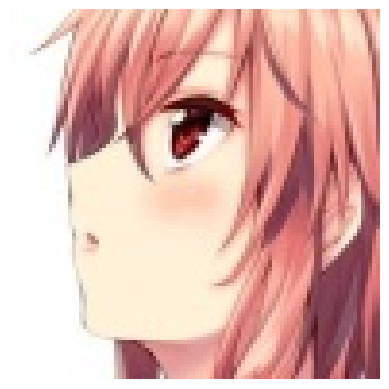

True Label: yuigahama_yui
This image is likely belongs to:
> nami_(one_piece) : 34.32 % confidence.
> yuigahama_yui : 6.09 % confidence.
> sakurauchi_riko : 4.39 % confidence.
> asuna_(sao) : 4.23 % confidence.
> misaka_mikoto : 3.57 % confidence.


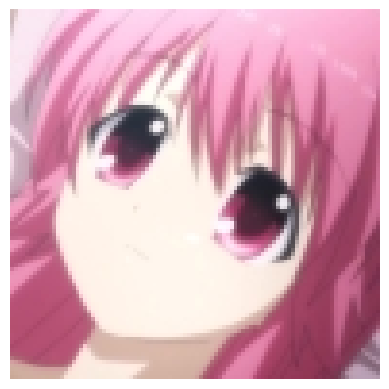

True Label: yui_(angel_beats!)
This image is likely belongs to:
> yui_(angel_beats!) : 23.68 % confidence.
> kaname_madoka : 19.67 % confidence.
> aisaka_taiga : 6.54 % confidence.
> mash_kyrielight : 5.91 % confidence.
> arcueid_brunestud : 4.01 % confidence.


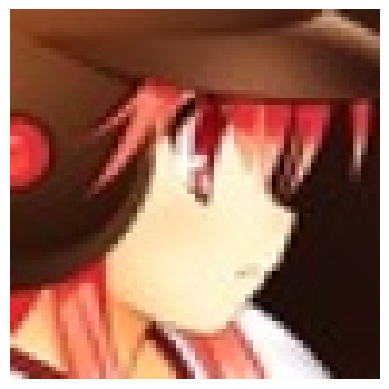

True Label: yui_(angel_beats!)
This image is likely belongs to:
> souryuu_asuka_langley : 10.66 % confidence.
> shirogane_naoto : 10.64 % confidence.
> aegis_(persona) : 7.84 % confidence.
> ryougi_shiki : 4.99 % confidence.
> fubuki_(one-punch_man) : 3.86 % confidence.


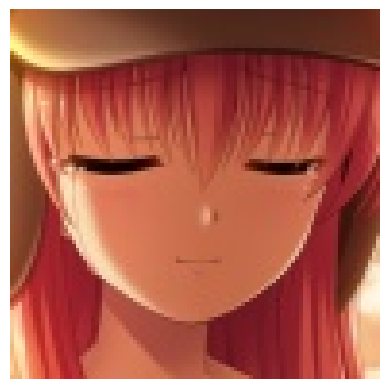

True Label: yui_(angel_beats!)
This image is likely belongs to:
> nakano_nino : 9.56 % confidence.
> matou_sakura : 4.99 % confidence.
> mori_calliope : 4.66 % confidence.
> bremerton_(azur_lane) : 4.17 % confidence.
> mei_(pokemon) : 3.79 % confidence.


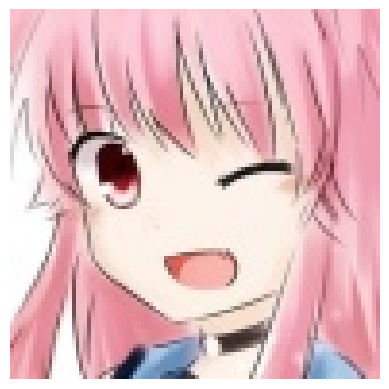

True Label: yui_(angel_beats!)
This image is likely belongs to:
> zero_two_(darling_in_the_franxx) : 8.46 % confidence.
> kizuna_ai : 6.95 % confidence.
> fujibayashi_kyou : 5.07 % confidence.
> yui_(angel_beats!) : 4.25 % confidence.
> shidare_hotaru : 3.85 % confidence.


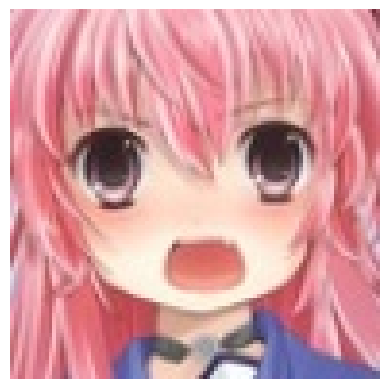

True Label: yui_(angel_beats!)
This image is likely belongs to:
> yui_(angel_beats!) : 54.56 % confidence.
> yuigahama_yui : 5.48 % confidence.
> super_sonico : 4.03 % confidence.
> aisaka_taiga : 2.68 % confidence.
> kaname_madoka : 1.79 % confidence.


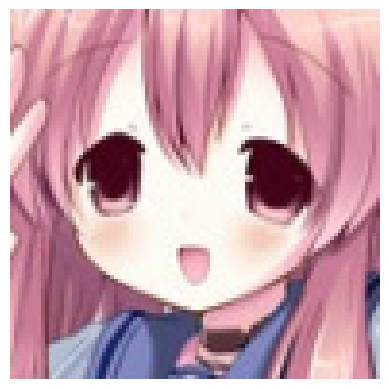

True Label: yui_(angel_beats!)
This image is likely belongs to:
> yui_(angel_beats!) : 22.56 % confidence.
> aisaka_taiga : 6.17 % confidence.
> oshino_ougi : 5.82 % confidence.
> matou_sakura : 3.91 % confidence.
> toosaka_rin : 3.63 % confidence.


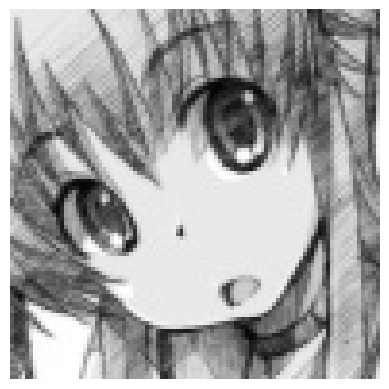

True Label: yui_(angel_beats!)
This image is likely belongs to:
> isshiki_iroha : 8.55 % confidence.
> asuna_(sao) : 7.31 % confidence.
> shidare_hotaru : 6.83 % confidence.
> furukawa_nagisa : 5.31 % confidence.
> semiramis_(fate) : 3.82 % confidence.


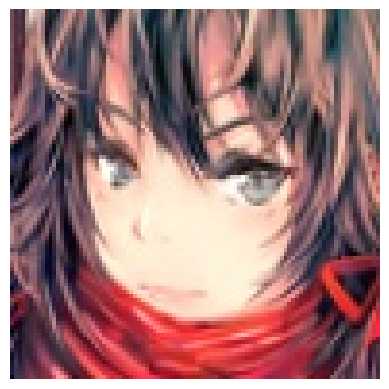

True Label: yukinoshita_yukino
This image is likely belongs to:
> sengoku_nadeko : 5.87 % confidence.
> yukinoshita_yukino : 4.75 % confidence.
> taihou_(azur_lane) : 4.37 % confidence.
> fubuki_(one-punch_man) : 3.68 % confidence.
> atago_(azur_lane) : 3.27 % confidence.


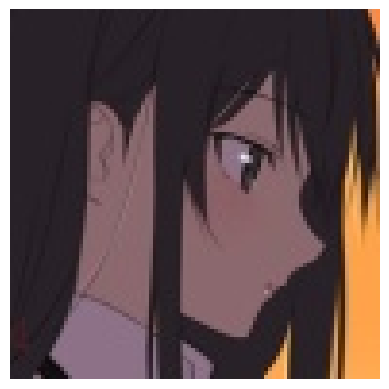

True Label: yukinoshita_yukino
This image is likely belongs to:
> albedo : 31.02 % confidence.
> waver_velvet : 6.15 % confidence.
> abigail_williams_(fate) : 4.93 % confidence.
> rider : 3.30 % confidence.
> nico_robin : 3.14 % confidence.


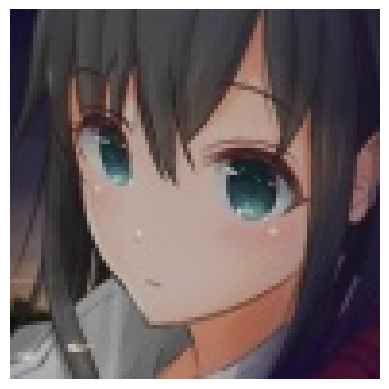

True Label: yukinoshita_yukino
This image is likely belongs to:
> ishtar_(fate_grand_order) : 14.29 % confidence.
> toosaka_rin : 6.47 % confidence.
> yukinoshita_yukino : 6.29 % confidence.
> shinomiya_kaguya : 4.67 % confidence.
> tsushima_yoshiko : 4.00 % confidence.


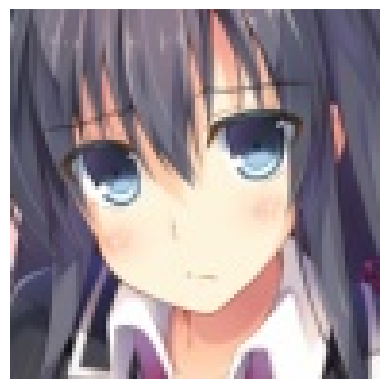

True Label: yukinoshita_yukino
This image is likely belongs to:
> yukinoshita_yukino : 28.38 % confidence.
> takimoto_hifumi : 8.27 % confidence.
> anastasia_(idolmaster) : 8.04 % confidence.
> utsumi_erise : 7.86 % confidence.
> st_ar-15_(girls_frontline) : 6.56 % confidence.


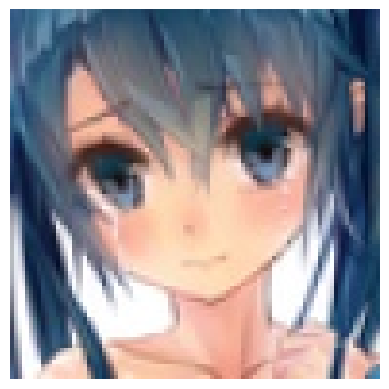

True Label: yukinoshita_yukino
This image is likely belongs to:
> yukinoshita_yukino : 17.03 % confidence.
> sakurajima_mai : 6.32 % confidence.
> nakano_azusa : 6.03 % confidence.
> karin_(blue_archive) : 5.22 % confidence.
> enterprise_(azur_lane) : 4.45 % confidence.


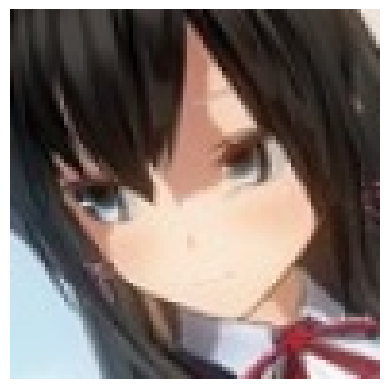

True Label: yukinoshita_yukino
This image is likely belongs to:
> shirakami_fubuki : 18.41 % confidence.
> shirogane_noel : 6.04 % confidence.
> laffey_(azur_lane) : 4.75 % confidence.
> makise_kurisu : 3.94 % confidence.
> shinomiya_kaguya : 3.55 % confidence.


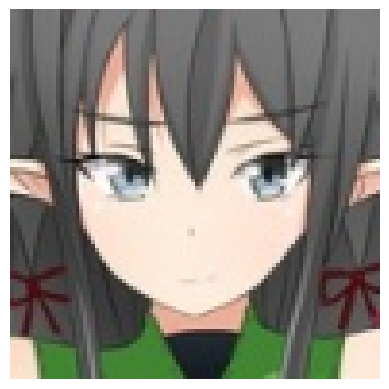

True Label: yukinoshita_yukino
This image is likely belongs to:
> yukinoshita_yukino : 11.22 % confidence.
> makise_kurisu : 7.63 % confidence.
> kirito : 6.93 % confidence.
> shishiro_botan : 6.10 % confidence.
> oshino_ougi : 4.95 % confidence.


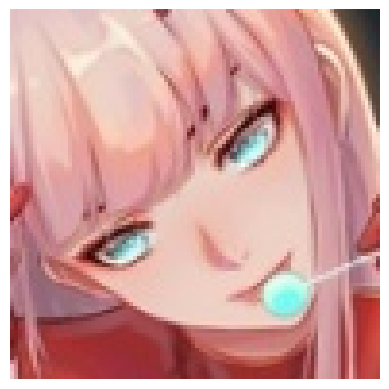

True Label: zero_two_(darling_in_the_franxx)
This image is likely belongs to:
> bremerton_(azur_lane) : 22.02 % confidence.
> astolfo_(fate) : 8.64 % confidence.
> okita_souji_(fate) : 8.39 % confidence.
> mori_calliope : 5.81 % confidence.
> kiryu_coco : 4.87 % confidence.


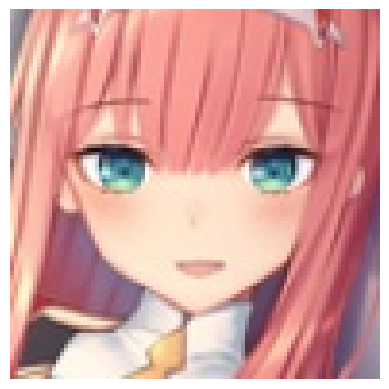

True Label: zero_two_(darling_in_the_franxx)
This image is likely belongs to:
> fujiwara_chika : 8.50 % confidence.
> kiryu_coco : 7.35 % confidence.
> emilia_rezero : 5.81 % confidence.
> zero_two_(darling_in_the_franxx) : 5.28 % confidence.
> illyasviel_von_einzbern : 5.00 % confidence.


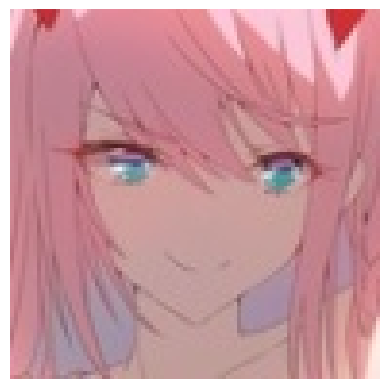

True Label: zero_two_(darling_in_the_franxx)
This image is likely belongs to:
> st_ar-15_(girls_frontline) : 6.85 % confidence.
> zero_two_(darling_in_the_franxx) : 6.27 % confidence.
> suzuhara_lulu : 4.66 % confidence.
> shidare_hotaru : 3.33 % confidence.
> nakano_nino : 3.30 % confidence.


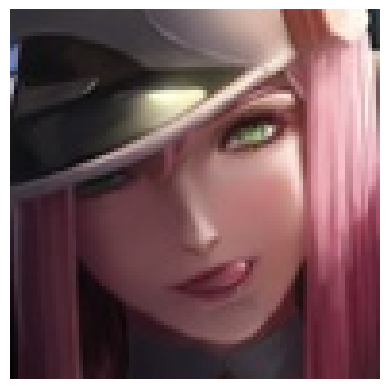

True Label: zero_two_(darling_in_the_franxx)
This image is likely belongs to:
> enterprise_(azur_lane) : 18.98 % confidence.
> nico_robin : 12.36 % confidence.
> albedo : 7.85 % confidence.
> takamaki_anne : 7.64 % confidence.
> semiramis_(fate) : 6.85 % confidence.


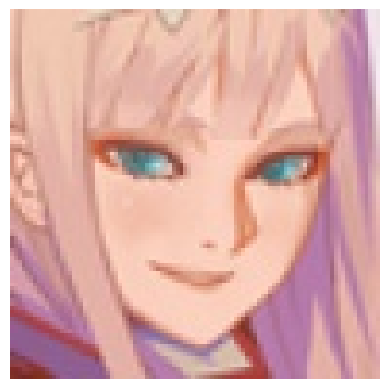

True Label: zero_two_(darling_in_the_franxx)
This image is likely belongs to:
> shishiro_botan : 9.64 % confidence.
> st_ar-15_(girls_frontline) : 7.93 % confidence.
> bremerton_(azur_lane) : 6.87 % confidence.
> nico_robin : 5.39 % confidence.
> zero_two_(darling_in_the_franxx) : 4.65 % confidence.


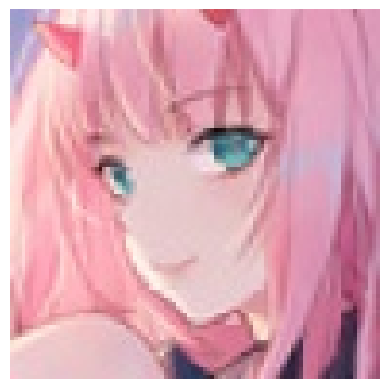

True Label: zero_two_(darling_in_the_franxx)
This image is likely belongs to:
> zero_two_(darling_in_the_franxx) : 17.12 % confidence.
> st_ar-15_(girls_frontline) : 8.67 % confidence.
> suzuhara_lulu : 6.88 % confidence.
> astolfo_(fate) : 4.07 % confidence.
> kizuna_ai : 3.96 % confidence.


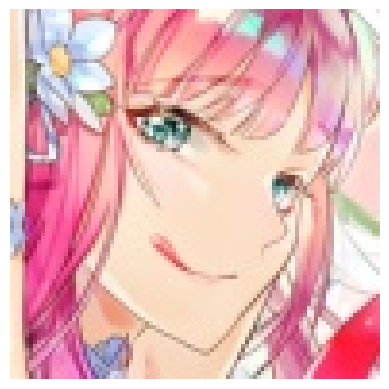

True Label: zero_two_(darling_in_the_franxx)
This image is likely belongs to:
> sinon : 25.49 % confidence.
> chloe_von_einzbern : 6.17 % confidence.
> lancer : 3.50 % confidence.
> nishikino_maki : 3.42 % confidence.
> rider : 2.93 % confidence.


In [37]:
scan_predict(test_data_dir)

In [ ]:
%cd GraphJigsaw

In [ ]:
!python train.py # GraphJigsaw training with a backbone model